In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import time

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
import torchvision.transforms as T

from torch.utils.data import DataLoader, Dataset
from mpl_toolkits.mplot3d import Axes3D

import torch_optimizer

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
#device = torch.device('cpu')

In [2]:
# utils
class Block(nn.Module):
    def __init__(self, in_c, out_c, stride=1):
        super(Block, self).__init__()
        self.conv = nn.Conv2d(in_c,
                              out_c,
                              3,
                              stride=stride,
                              padding=1,
                              bias=False)
        self.bn = nn.BatchNorm2d(out_c)

    def forward(self, x):
        return F.leaky_relu(self.bn(self.conv(x)))


class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv = nn.Sequential(
            Block(1, 16, 1),
            *[Block(16 * 2**i, (16 * 2**(i + 1)), 2) for i in range(4)],
            nn.AdaptiveAvgPool2d(1),
            #nn.Flatten()
        )
        #self.h1 = nn.Linear(2*2*256, 128, bias=False)
        self.h1 = nn.Linear(256, 128, bias=False)
        self.h2 = nn.Linear(128, 2, bias=False)
        self.h3 = nn.Linear(2, 10, bias=False)

    def forward(self, x):
        bs = x.shape[0]
        x = self.conv(x).view(bs, -1)
        x = self.h1(x)
        x = self.h2(x)
        
        x = self.h3(x)
        return x


class AverageMeter:
    """Computes and stores the average and current value"""

    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0.
        self.avg = 0.
        self.sum = 0.
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count


def trn_fn(model, device, trn_dl, criterion, optimizer, history=None):
    model.train()
    running_loss = AverageMeter()
    running_metric = AverageMeter()

    for idx, (xs, ys) in enumerate(trn_dl):
        batch_size = len(xs)
        xs, ys = xs.to(device), ys.to(device)
        
        # forward
        preds = model(xs)
        loss = criterion(preds, ys)
        running_loss.update(loss.item(), batch_size)

        # backward
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        

        # metric
        metric = (preds.argmax(1) == ys).float().mean().item()  # acc
        running_metric.update(metric, batch_size)

        # recoder for every iterations
        if history is not None:
            history['trn_losses_iter'].append(running_loss.avg)
            history['trn_metrics_iter'].append(running_metric.avg)

        # print
        if idx % 200 == 1 or idx == len(trn_dl)-1:
            print(
                f'[{idx:04d}/{len(trn_dl)-1:04d}]\t',
                f'Loss: {running_loss.avg:.6f} | ',
                f'ACC: {running_metric.avg:.6f}',
            )
            for name, layer in model.named_parameters():
                if 'h1' not in name:
                    continue
                history['weights'].append(to_numpy(layer.data))
                history['grads'].append(to_numpy(layer.grad))
    return running_loss.avg, running_metric.avg


def val_fn(model, device, vl_dl, criterion):
    model.eval()
    running_loss = AverageMeter()
    running_metric = AverageMeter()

    with torch.no_grad():
        for xs, ys in vl_dl:
            batch_size = len(xs)
            xs, ys = xs.to(device), ys.to(device)

            preds = model(xs)
            loss = criterion(preds, ys)
            running_loss.update(loss.item(), batch_size)

            # metric
            metric = (preds.argmax(1) == ys).float().mean().item()  # acc
            running_metric.update(metric, batch_size)

    print(
        f'validation:\t'
        f'Loss: {running_loss.avg:.6f} |',
        f'ACC: {running_metric.avg:.6f}',
    )
    return running_loss.avg, running_metric.avg


def to_numpy(x): return x.cpu().detach().numpy()


def train(model, epochs, lr, opt):
    history = {
        'trn_losses_iter': [],
        'trn_metrics_iter': [],
        'trn_losses': [],
        'trn_metrics': [],
        'val_losses': [],
        'val_metrics': [],
        'lrs': [],
        'weights': [],
        'grads': [],
    }

    criterion = nn.CrossEntropyLoss()
    optimizer = opt


    for epoch in range(epochs):
        start_time = time.time()
        print(f'Train Epoch: {epoch:03d}')
        trn_loss, trn_metric = trn_fn(model,
                                      device,
                                      trn_dl,
                                      criterion,
                                      optimizer,
                                      history=history
                                     )
        val_loss, val_metric = val_fn(model, device, val_dl, criterion)

        # calculate time
        end_time = time.time()
        m, s = divmod(int(end_time - start_time), 60)

        # record
        history['trn_losses'].append(trn_loss)
        history['trn_metrics'].append(trn_metric)
        history['val_losses'].append(val_loss)
        history['val_metrics'].append(val_metric)


        print(f'time: {m:.0f}:{s:.0f}\n')
    return model, history

In [3]:
epochs = 1
bs = 64
lr = 1e-3


trn_trans = T.Compose([
    T.RandomRotation(5),
    T.ToTensor(),
    T.Normalize([0.5, ], [0.5, ], ),
])
val_trans = T.Compose([
    T.ToTensor(),
    T.Normalize([0.5, ], [0.5, ], ),
])

trn_ds = torchvision.datasets.MNIST('.',
                                    download=True,
                                    train=True,
                                    transform=trn_trans)
val_ds = torchvision.datasets.MNIST('.',
                                    download=True,
                                    train=False,
                                    transform=val_trans)

trn_dl = DataLoader(trn_ds, batch_size=bs, shuffle=True, drop_last=True)
val_dl = DataLoader(val_ds, batch_size=bs)

In [4]:
model = Net().to(device)
optimizer = optim.Adam(
    model.parameters(),
    lr=lr,
    weight_decay=1e-6,
)
model, _ = train(model, epochs, lr, optimizer)

Train Epoch: 000
[0001/0936]	 Loss: 2.275758 |  ACC: 0.148438
[0201/0936]	 Loss: 1.120638 |  ACC: 0.549428
[0401/0936]	 Loss: 0.826210 |  ACC: 0.690026
[0601/0936]	 Loss: 0.682845 |  ACC: 0.765469
[0801/0936]	 Loss: 0.585045 |  ACC: 0.808194
[0936/0936]	 Loss: 0.538274 |  ACC: 0.827608
validation:	Loss: 0.194111 | ACC: 0.961500
time: 0:18



In [5]:
colors = [f'C{i}' for i in range(10)]

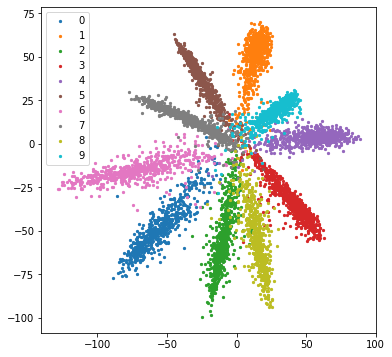

In [6]:
feats = []
ys_data = []

model.eval()

for i, (xs, ys) in enumerate(val_dl):
    bs = xs.shape[0]
    feat = model.conv(xs.to(device)).view(bs, -1)
    feat = model.h1(feat)
    feat = model.h2(feat)
    feats.append(feat.detach().cpu().numpy())
    ys_data.append(ys.detach().cpu().numpy())
    if i == 100:
        break
feats = np.concatenate(feats)
ys_data = np.concatenate(ys_data)

plt.figure(figsize=(6, 6))
for i in range(10):
    plt.scatter(feats[ys_data == i, 0],
                feats[ys_data == i, 1],
                c=colors[i],
                s=5,
                label=i)
plt.legend()
plt.show()

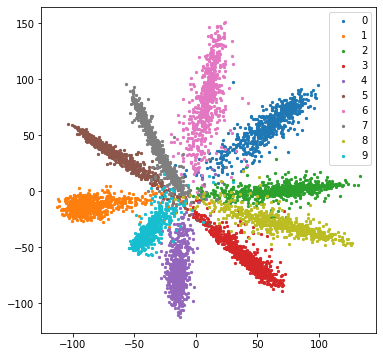

In [7]:
from sklearn.decomposition import PCA

feats = []
ys_data = []

model.eval()

for i, (xs, ys) in enumerate(val_dl):
    bs = xs.shape[0]
    feat = model.conv(xs.to(device)).view(bs, -1)
    feat = model.h1(feat)
    feat = model.h2(feat)
    feat = model.h3(feat)
    feats.append(feat.detach().cpu().numpy())
    ys_data.append(ys.detach().cpu().numpy())

    if i == 100:
        break

feats = np.concatenate(feats)
ys_data = np.concatenate(ys_data)

# PCA
pca = PCA(n_components=2)
pca.fit(feats)
feats_2d = pca.transform(feats)

plt.figure(figsize=(6, 6))
for i in range(10):
    plt.scatter(feats_2d[ys_data == i, 0],
                feats_2d[ys_data == i, 1],
                c=colors[i],
                s=5,
                label=i)
plt.legend()
plt.show()

In [8]:
def block(in_, out_, act=nn.ReLU):
    return nn.Sequential(
        nn.Linear(in_, out_, bias=False),
        nn.BatchNorm1d(out_),
        act(),
    )


class Net(nn.Module):
    def __init__(self, act=nn.ReLU):
        super(Net, self).__init__()
        self.h1 = block(784, 128, act)
        self.h2 = block(128, 128, act)
        self.h3 = block(128, 10, act)

    def forward(self, x):
        bs = len(x)
        x = self.h1(x.view(bs, -1))
        x = self.h2(x)

        x = self.h3(x)
        return x


def plot_gradient(grads):
    fig = plt.figure(figsize=(14, 6))
    titles = ['start', 'end']
    for i in [1, 2]:
        ax = fig.add_subplot(1, 2, i, projection="3d")
        a = grads[0 if i == 1 else -1].mean(0).reshape(28, 28)

        x = range(28)
        y = range(28)
        X, Y = np.meshgrid(x, y)
        Z = a[X, Y]

        ax = ax.plot_surface(X, Y, Z, cmap='coolwarm')
        fig.colorbar(ax, shrink=0.3, aspect=10)
        plt.title(titles[i - 1])
    plt.show()


def plot_hist(grads, weights):
    values = [grads, weights]
    titles = ['gradients', 'weights']

    fig = plt.figure(figsize=(14, 6))
    for j in [1, 2]:
        ax = fig.add_subplot(1, 2, j, projection="3d")
        value = values[j - 1]

        for i in range(len(value)):
            hist, bins = np.histogram(value[i], bins=100)
            xs = (bins[:-1] + bins[1:]) / 2
            ax.bar(xs, hist, zs=(2 * i), zdir='y', alpha=0.5, width=0.01)
        ax.set_xlabel('value')
        ax.set_ylabel('step')
        ax.set_zlabel('frequency')
        ax.set_xlim(-0.10, 0.10)
        ax.set_zlim(0, 4000)
        plt.title(titles[j - 1])
    plt.show()


def test_act_opt(recoder, act=nn.ReLU, opt=optim.Adam):
    print('activation: ', act.__name__)
    print('optimizer: ', opt.__name__)

    model = Net(act).to(device)
    optimizer = opt(
        model.parameters(),
        lr=lr,
        weight_decay=1e-6,
    )
    if opt.__name__ == 'SGD':
        optimizer = opt(
            model.parameters(),
            lr=lr,
            weight_decay=1e-6,
            momentum=0.95,
        )
    model, history = train(model, epochs, lr, optimizer)

    # plot
    weights = [w for w in history['weights'][::3]]  # skip bn weights and bias
    grads = [g for g in history['grads'][::3]]

    if len(grads) > 10:
        grads = grads[::3]
        weights = weights[::3]
    plot_gradient(grads)
    plot_hist(grads, weights)
    
    # calculate time
    val_ds = torchvision.datasets.MNIST('.',
                                        download=True,
                                        train=False,
                                        transform=val_trans)
    criterion = nn.CrossEntropyLoss()
    val_dl = DataLoader(val_ds, batch_size=1)
    model.eval()
    start_time = time.time()
    for xs, ys in val_dl:
        model(xs.to(device))
    end_time = time.time()
    m, s = divmod(int(end_time - start_time), 60)
    
    # optimizer, activation, loss, accuracy
    return recoder.append(
        pd.DataFrame([[
            opt.__name__, 
            act.__name__,
            f'{(end_time - start_time)/10: .4f}',
            history['val_losses'][-1],
            history['val_metrics'][-1]
        ]],
            columns=['optimizer', 'activation', 'time (ms)', 'loss', 'accuracy']))

activation:  Sigmoid
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.281101 |  ACC: 0.125000
[0201/0936]	 Loss: 1.992706 |  ACC: 0.728883
[0401/0936]	 Loss: 1.961988 |  ACC: 0.782261
[0601/0936]	 Loss: 1.944698 |  ACC: 0.804921
[0801/0936]	 Loss: 1.932499 |  ACC: 0.816572
[0936/0936]	 Loss: 1.925182 |  ACC: 0.823122
validation:	Loss: 1.864387 | ACC: 0.889900
time: 0:13



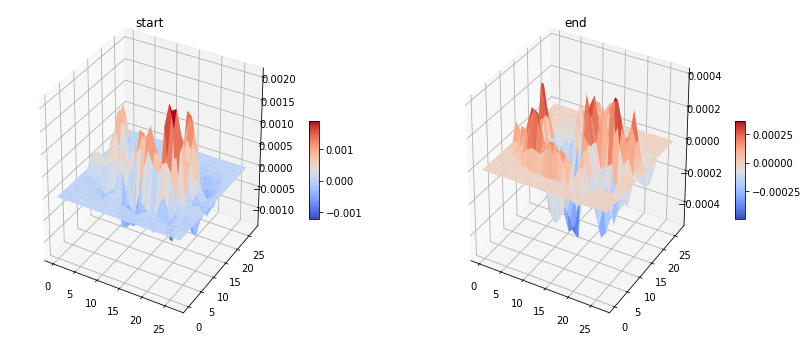

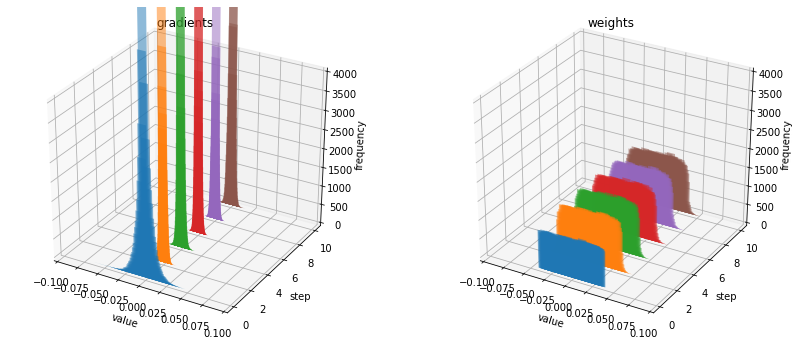

activation:  Tanh
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.423640 |  ACC: 0.109375
[0201/0936]	 Loss: 1.541326 |  ACC: 0.770730
[0401/0936]	 Loss: 1.458673 |  ACC: 0.811062
[0601/0936]	 Loss: 1.402484 |  ACC: 0.829838
[0801/0936]	 Loss: 1.358012 |  ACC: 0.842678
[0936/0936]	 Loss: 1.331951 |  ACC: 0.850420
validation:	Loss: 1.123766 | ACC: 0.922600
time: 0:13



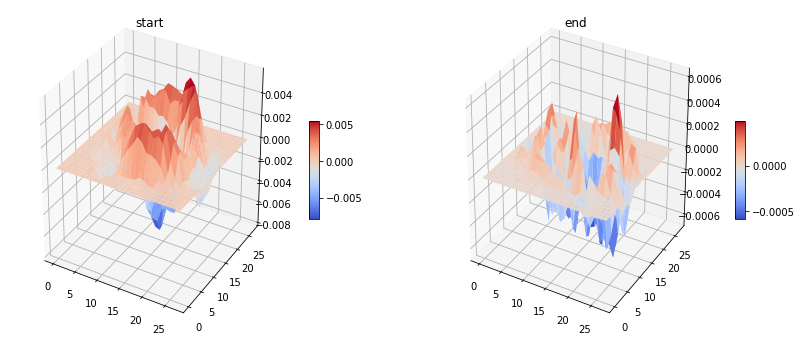

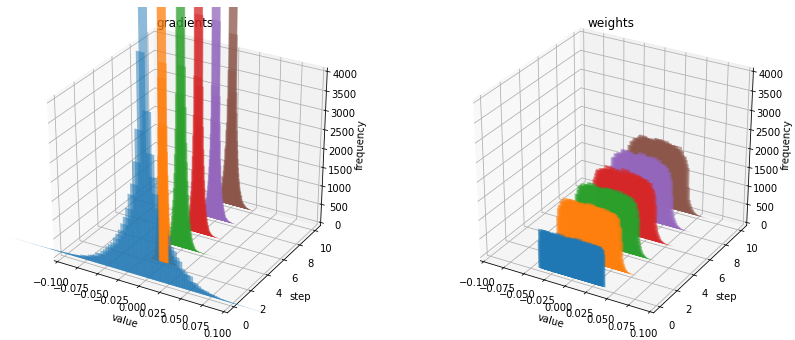

activation:  ReLU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.535008 |  ACC: 0.093750
[0201/0936]	 Loss: 0.917709 |  ACC: 0.806621
[0401/0936]	 Loss: 0.716721 |  ACC: 0.858947
[0601/0936]	 Loss: 0.605995 |  ACC: 0.883280
[0801/0936]	 Loss: 0.535994 |  ACC: 0.897327
[0936/0936]	 Loss: 0.500017 |  ACC: 0.904182
validation:	Loss: 0.197167 | ACC: 0.964600
time: 0:13



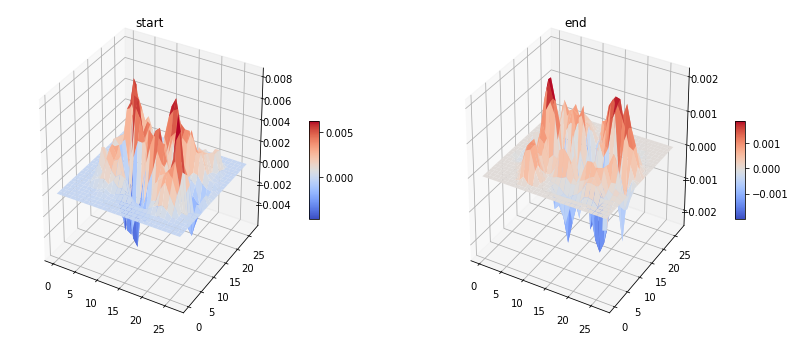

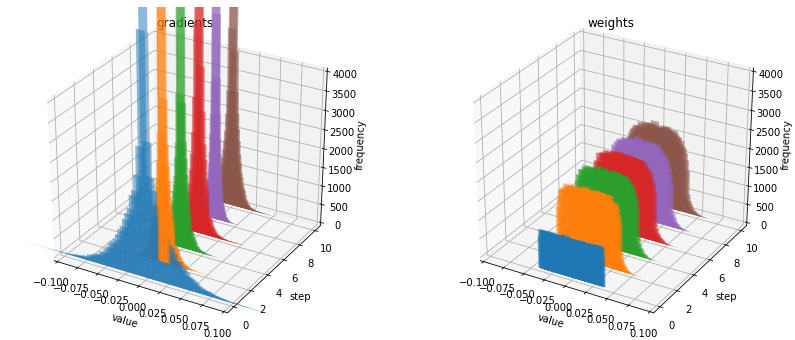

activation:  LeakyReLU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.512601 |  ACC: 0.062500
[0201/0936]	 Loss: 0.927855 |  ACC: 0.800433
[0401/0936]	 Loss: 0.722253 |  ACC: 0.855721
[0601/0936]	 Loss: 0.611299 |  ACC: 0.879931
[0801/0936]	 Loss: 0.540451 |  ACC: 0.894093
[0936/0936]	 Loss: 0.502568 |  ACC: 0.901648
validation:	Loss: 0.204616 | ACC: 0.962300
time: 0:13



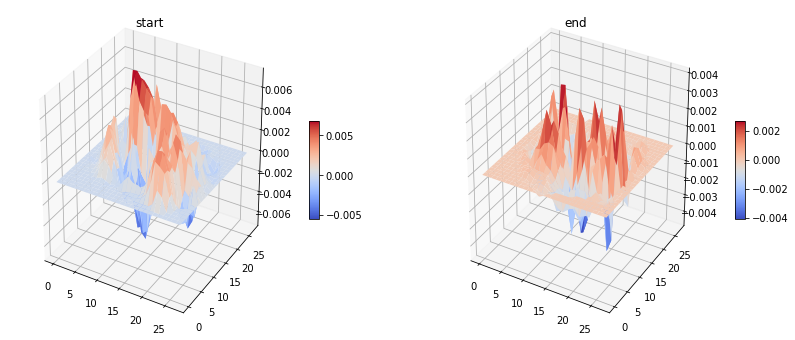

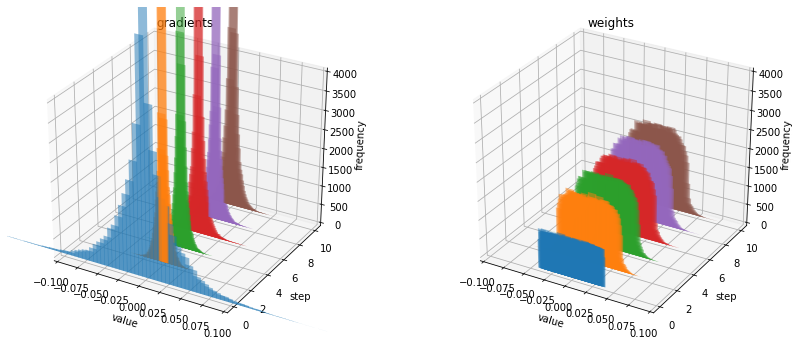

activation:  ReLU6
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.536829 |  ACC: 0.078125
[0201/0936]	 Loss: 0.904598 |  ACC: 0.810489
[0401/0936]	 Loss: 0.702203 |  ACC: 0.862679
[0601/0936]	 Loss: 0.595912 |  ACC: 0.884292
[0801/0936]	 Loss: 0.529059 |  ACC: 0.897873
[0936/0936]	 Loss: 0.495169 |  ACC: 0.903915
validation:	Loss: 0.209838 | ACC: 0.959800
time: 0:13



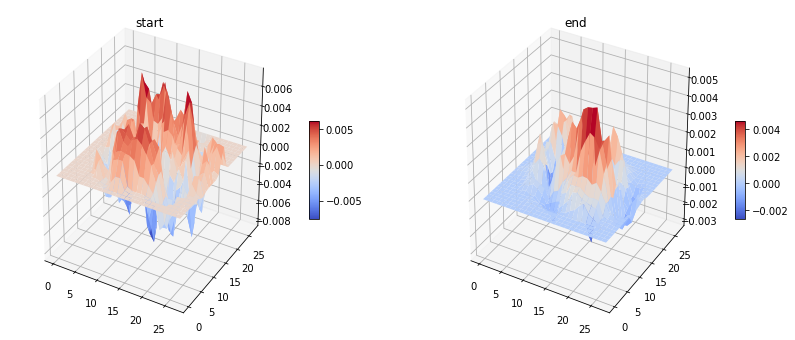

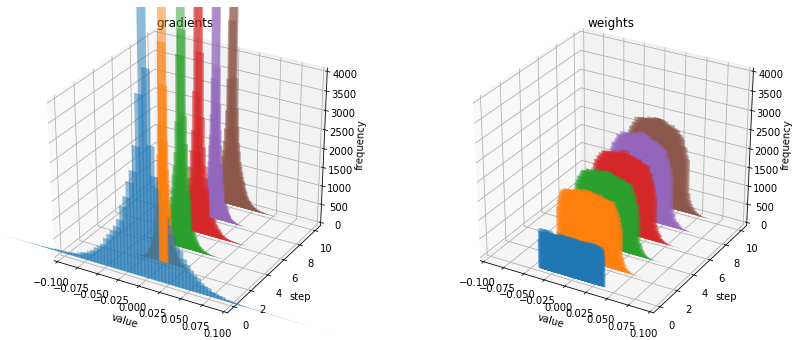

activation:  ELU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.600565 |  ACC: 0.093750
[0201/0936]	 Loss: 0.890825 |  ACC: 0.810721
[0401/0936]	 Loss: 0.726094 |  ACC: 0.850319
[0601/0936]	 Loss: 0.629450 |  ACC: 0.870717
[0801/0936]	 Loss: 0.564773 |  ACC: 0.883300
[0936/0936]	 Loss: 0.529549 |  ACC: 0.890625
validation:	Loss: 0.246859 | ACC: 0.953700
time: 0:13



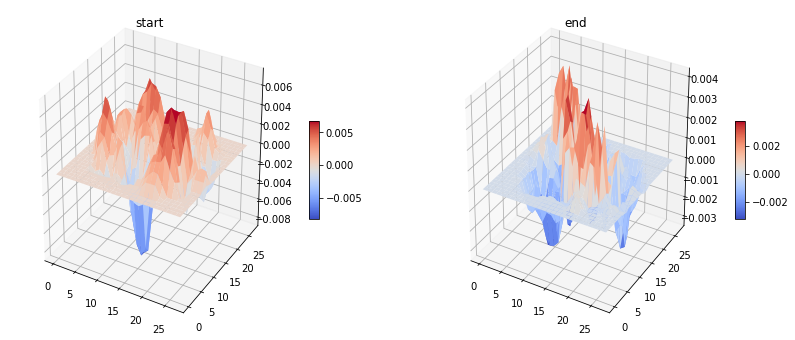

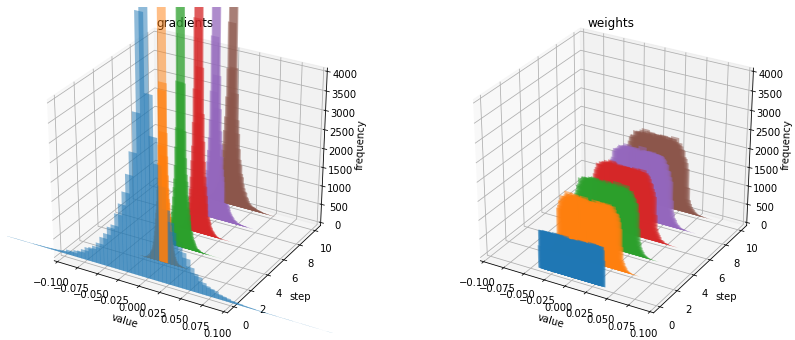

activation:  SELU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.899732 |  ACC: 0.062500
[0201/0936]	 Loss: 0.881713 |  ACC: 0.800433
[0401/0936]	 Loss: 0.738632 |  ACC: 0.836909
[0601/0936]	 Loss: 0.657244 |  ACC: 0.854314
[0801/0936]	 Loss: 0.601041 |  ACC: 0.865843
[0936/0936]	 Loss: 0.569582 |  ACC: 0.872615
validation:	Loss: 0.310888 | ACC: 0.936000
time: 0:13



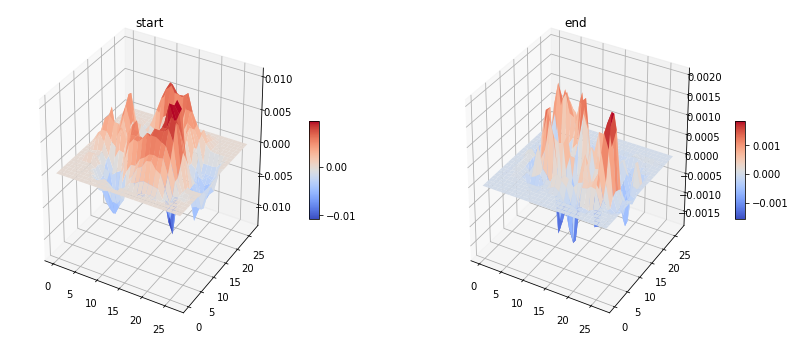

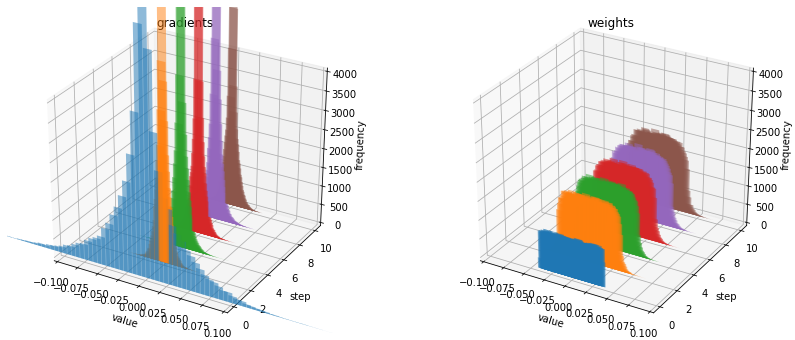

activation:  GELU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.561114 |  ACC: 0.078125
[0201/0936]	 Loss: 0.910425 |  ACC: 0.804301
[0401/0936]	 Loss: 0.700609 |  ACC: 0.860152
[0601/0936]	 Loss: 0.592869 |  ACC: 0.883565
[0801/0936]	 Loss: 0.520905 |  ACC: 0.898652
[0936/0936]	 Loss: 0.484959 |  ACC: 0.905833
validation:	Loss: 0.195083 | ACC: 0.964400
time: 0:13



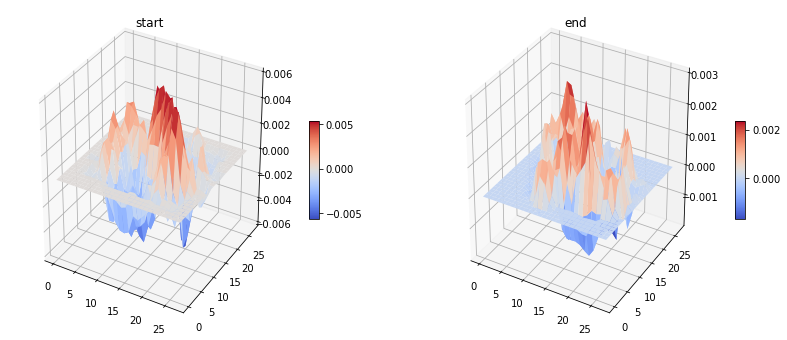

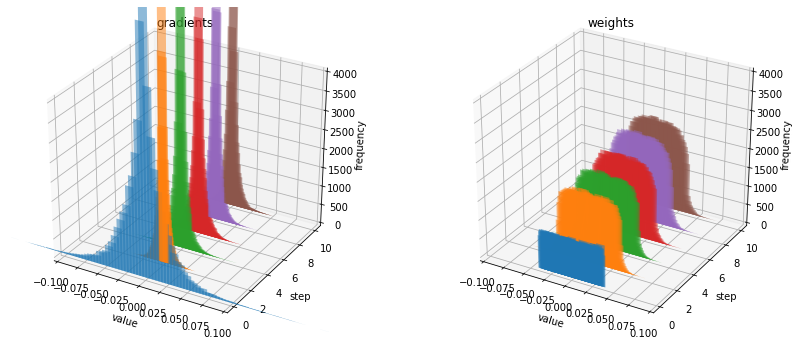

activation:  SiLU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.405292 |  ACC: 0.125000
[0201/0936]	 Loss: 0.920139 |  ACC: 0.814279
[0401/0936]	 Loss: 0.714831 |  ACC: 0.862912
[0601/0936]	 Loss: 0.606384 |  ACC: 0.883980
[0801/0936]	 Loss: 0.532815 |  ACC: 0.898399
[0936/0936]	 Loss: 0.495711 |  ACC: 0.905533
validation:	Loss: 0.198372 | ACC: 0.964700
time: 0:13



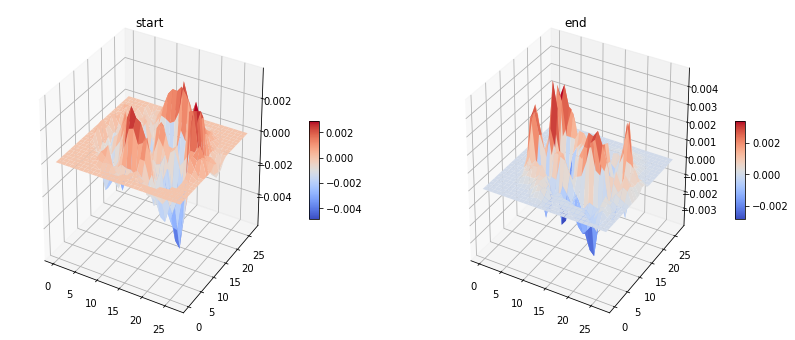

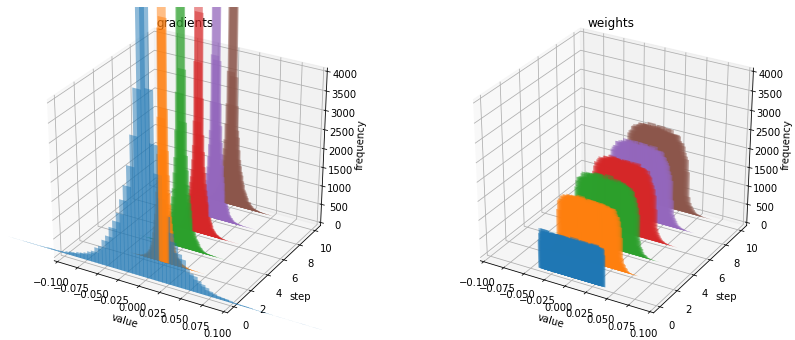

activation:  Hardswish
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.496444 |  ACC: 0.117188
[0201/0936]	 Loss: 0.948880 |  ACC: 0.804842
[0401/0936]	 Loss: 0.724296 |  ACC: 0.857432
[0601/0936]	 Loss: 0.610961 |  ACC: 0.881074
[0801/0936]	 Loss: 0.537822 |  ACC: 0.895106
[0936/0936]	 Loss: 0.501458 |  ACC: 0.901764
validation:	Loss: 0.201947 | ACC: 0.961900
time: 0:13



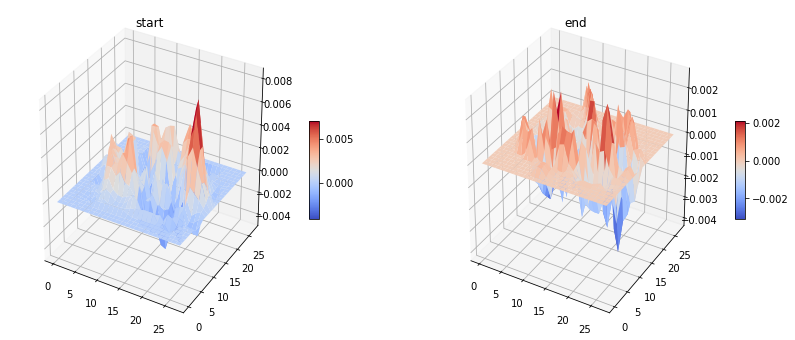

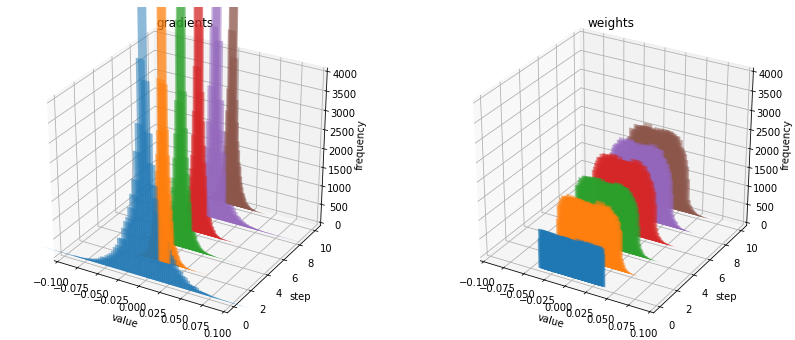

activation:  Mish
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.441587 |  ACC: 0.125000
[0201/0936]	 Loss: 0.878367 |  ACC: 0.811726
[0401/0936]	 Loss: 0.689087 |  ACC: 0.861824
[0601/0936]	 Loss: 0.586361 |  ACC: 0.884240
[0801/0936]	 Loss: 0.519727 |  ACC: 0.898340
[0936/0936]	 Loss: 0.486149 |  ACC: 0.904849
validation:	Loss: 0.206276 | ACC: 0.964800
time: 0:13



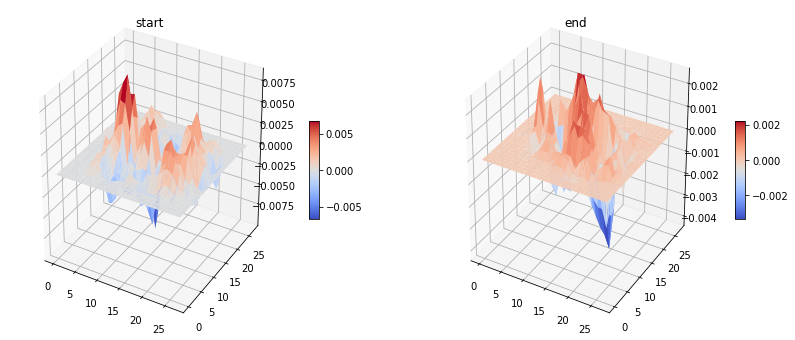

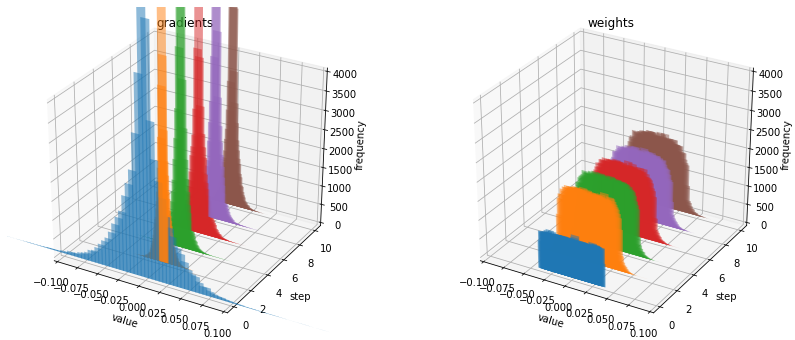

activation:  Sigmoid
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.237755 |  ACC: 0.250000
[0201/0936]	 Loss: 1.918001 |  ACC: 0.838954
[0401/0936]	 Loss: 1.885356 |  ACC: 0.856032
[0601/0936]	 Loss: 1.857064 |  ACC: 0.868096
[0801/0936]	 Loss: 1.830927 |  ACC: 0.878370
[0936/0936]	 Loss: 1.815234 |  ACC: 0.884005
validation:	Loss: 1.692942 | ACC: 0.932900
time: 0:13



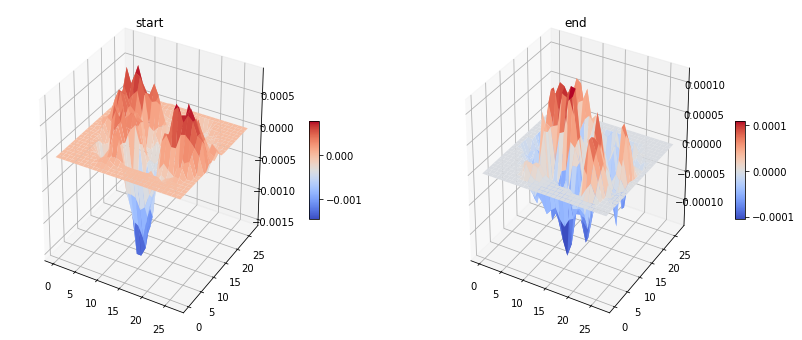

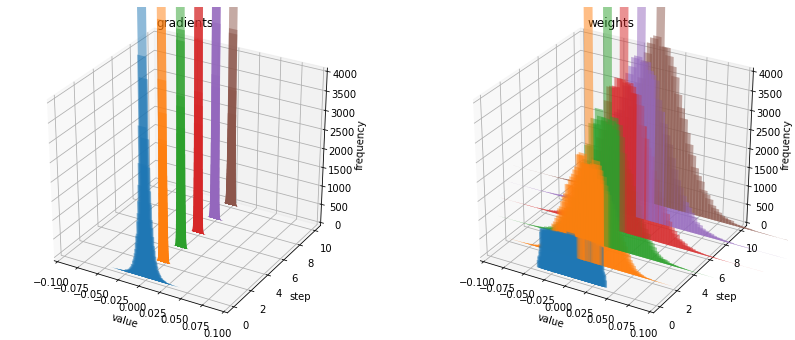

activation:  Tanh
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.289457 |  ACC: 0.195312
[0201/0936]	 Loss: 1.412832 |  ACC: 0.833540
[0401/0936]	 Loss: 1.325192 |  ACC: 0.861085
[0601/0936]	 Loss: 1.261375 |  ACC: 0.878815
[0801/0936]	 Loss: 1.214220 |  ACC: 0.889826
[0936/0936]	 Loss: 1.187184 |  ACC: 0.896578
validation:	Loss: 0.988431 | ACC: 0.942300
time: 0:13



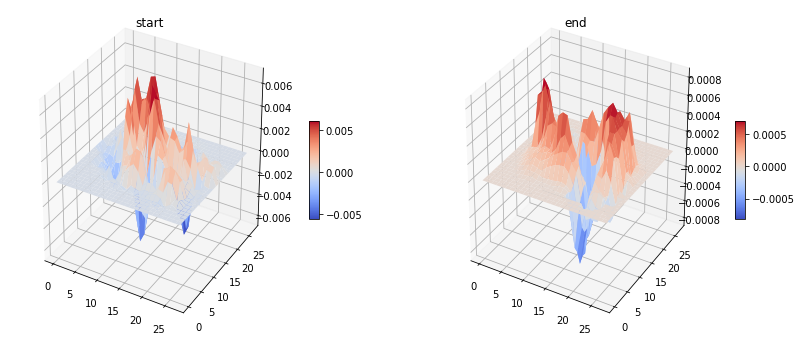

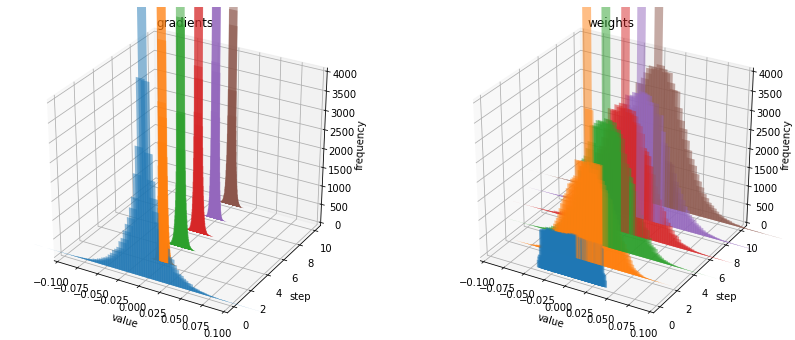

activation:  ReLU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.188060 |  ACC: 0.179688
[0201/0936]	 Loss: 0.725009 |  ACC: 0.879873
[0401/0936]	 Loss: 0.596079 |  ACC: 0.907610
[0601/0936]	 Loss: 0.515484 |  ACC: 0.921252
[0801/0936]	 Loss: 0.462962 |  ACC: 0.928558
[0936/0936]	 Loss: 0.434558 |  ACC: 0.932364
validation:	Loss: 0.181143 | ACC: 0.968800
time: 0:13



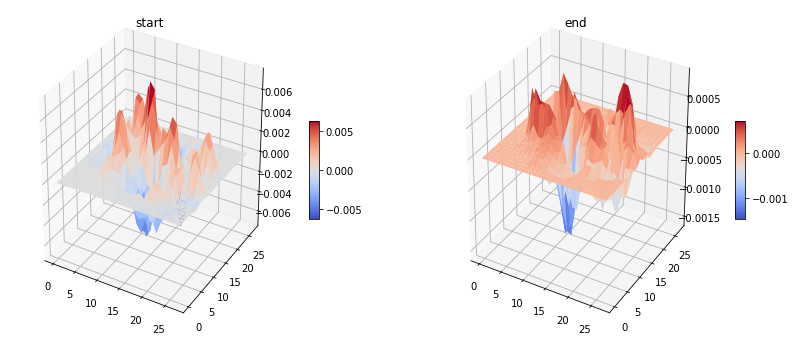

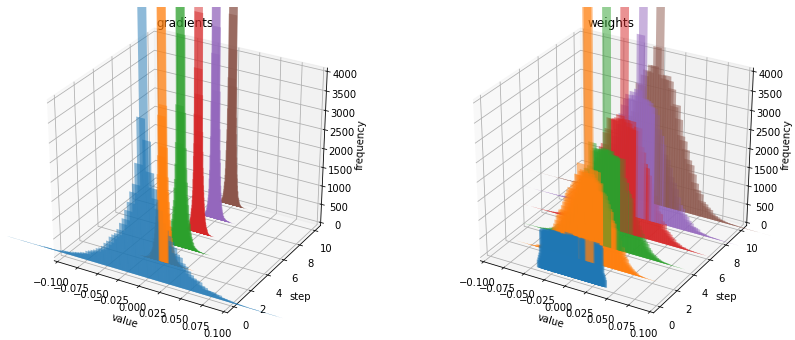

activation:  LeakyReLU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.375216 |  ACC: 0.140625
[0201/0936]	 Loss: 0.732791 |  ACC: 0.880337
[0401/0936]	 Loss: 0.597475 |  ACC: 0.908465
[0601/0936]	 Loss: 0.520511 |  ACC: 0.920733
[0801/0936]	 Loss: 0.464122 |  ACC: 0.929161
[0936/0936]	 Loss: 0.436693 |  ACC: 0.932747
validation:	Loss: 0.188907 | ACC: 0.971000
time: 0:13



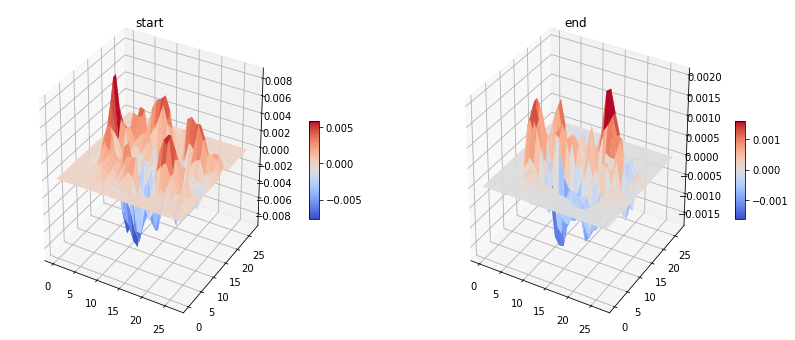

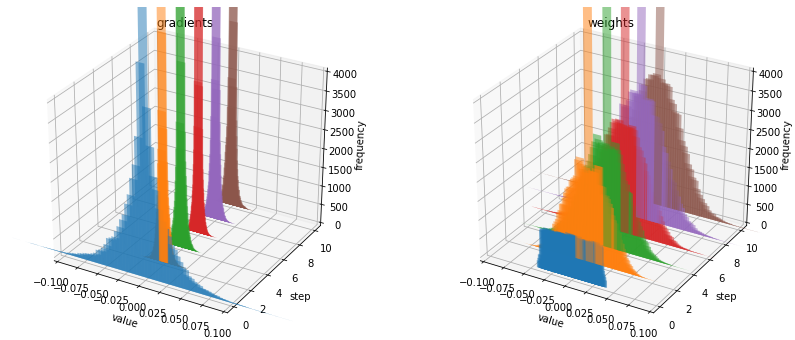

activation:  ReLU6
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.323375 |  ACC: 0.156250
[0201/0936]	 Loss: 0.723188 |  ACC: 0.883277
[0401/0936]	 Loss: 0.589621 |  ACC: 0.910564
[0601/0936]	 Loss: 0.512448 |  ACC: 0.922524
[0801/0936]	 Loss: 0.459313 |  ACC: 0.930214
[0936/0936]	 Loss: 0.431477 |  ACC: 0.933815
validation:	Loss: 0.204334 | ACC: 0.965000
time: 0:13



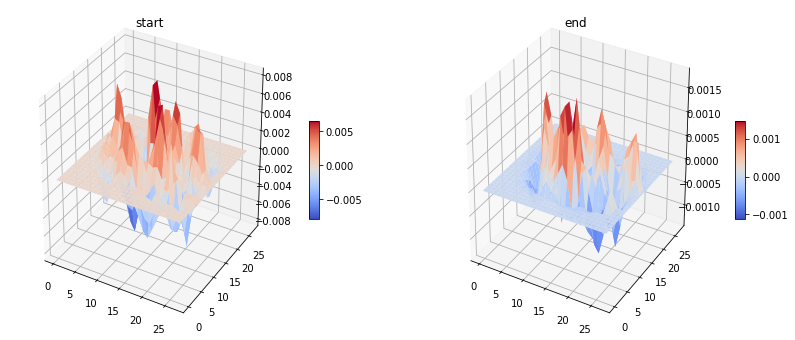

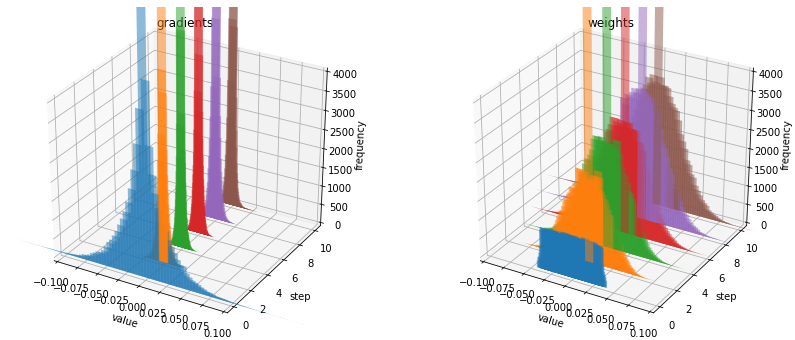

activation:  ELU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.225068 |  ACC: 0.234375
[0201/0936]	 Loss: 0.725369 |  ACC: 0.868889
[0401/0936]	 Loss: 0.610505 |  ACC: 0.893657
[0601/0936]	 Loss: 0.538560 |  ACC: 0.907937
[0801/0936]	 Loss: 0.487724 |  ACC: 0.915972
[0936/0936]	 Loss: 0.459716 |  ACC: 0.920391
validation:	Loss: 0.223779 | ACC: 0.963200
time: 0:13



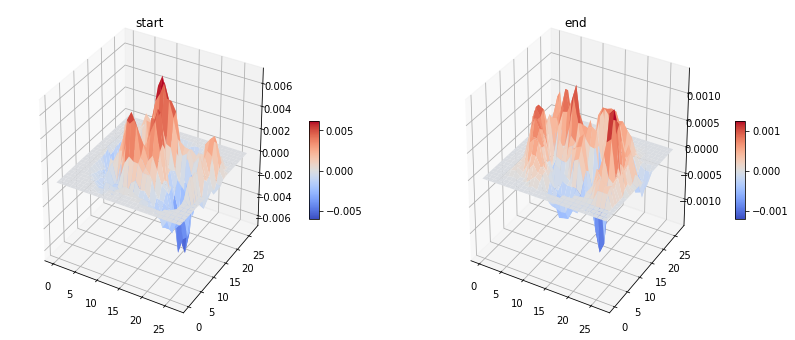

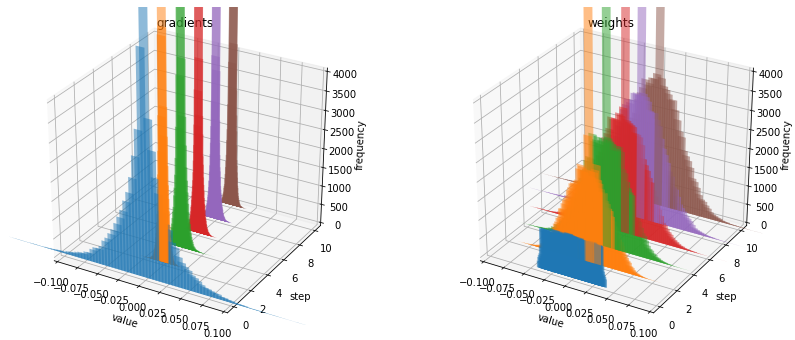

activation:  SELU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.526399 |  ACC: 0.203125
[0201/0936]	 Loss: 0.746313 |  ACC: 0.848855
[0401/0936]	 Loss: 0.624581 |  ACC: 0.877138
[0601/0936]	 Loss: 0.546046 |  ACC: 0.893869
[0801/0936]	 Loss: 0.492505 |  ACC: 0.904419
[0936/0936]	 Loss: 0.463404 |  ACC: 0.909552
validation:	Loss: 0.227035 | ACC: 0.956400
time: 0:13



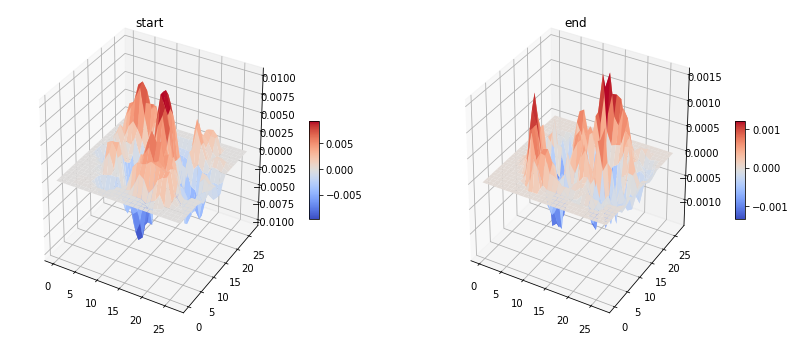

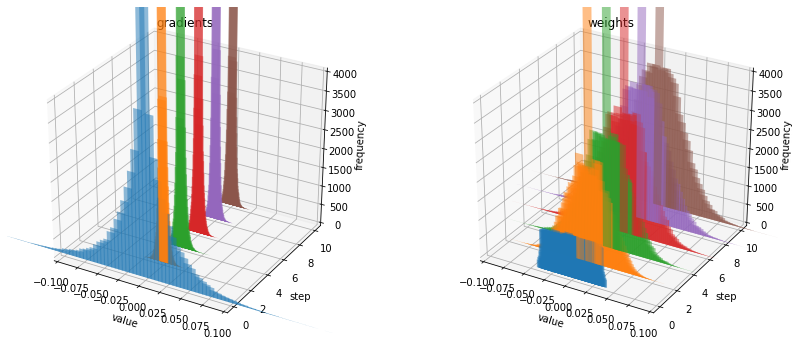

activation:  GELU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.437619 |  ACC: 0.164062
[0201/0936]	 Loss: 0.699305 |  ACC: 0.881807
[0401/0936]	 Loss: 0.569227 |  ACC: 0.910759
[0601/0936]	 Loss: 0.496327 |  ACC: 0.923510
[0801/0936]	 Loss: 0.443213 |  ACC: 0.931733
[0936/0936]	 Loss: 0.415952 |  ACC: 0.935316
validation:	Loss: 0.174995 | ACC: 0.970800
time: 0:13



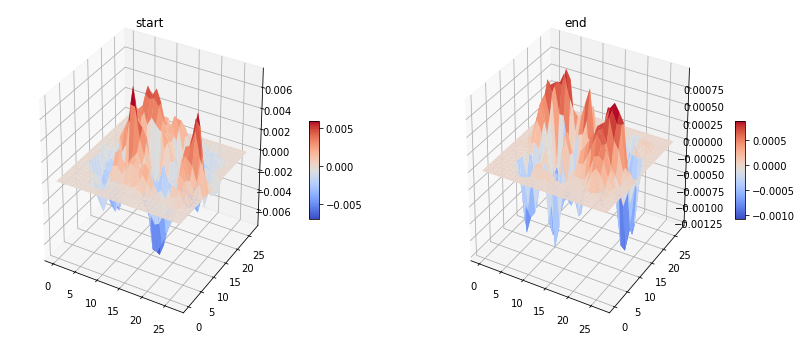

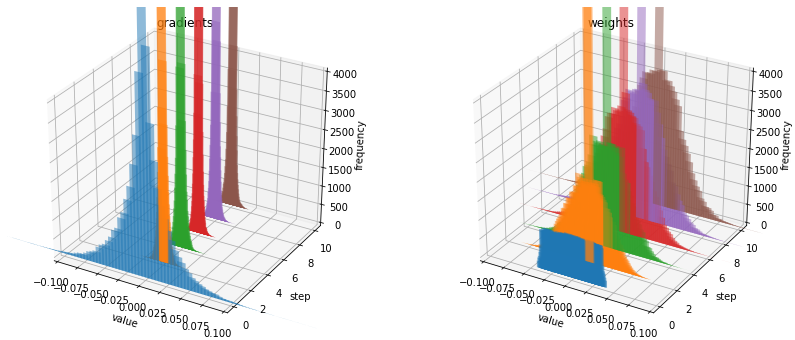

activation:  SiLU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.197762 |  ACC: 0.242188
[0201/0936]	 Loss: 0.741513 |  ACC: 0.881033
[0401/0936]	 Loss: 0.606933 |  ACC: 0.910059
[0601/0936]	 Loss: 0.529263 |  ACC: 0.921875
[0801/0936]	 Loss: 0.475378 |  ACC: 0.928655
[0936/0936]	 Loss: 0.447109 |  ACC: 0.931980
validation:	Loss: 0.207579 | ACC: 0.968500
time: 0:13



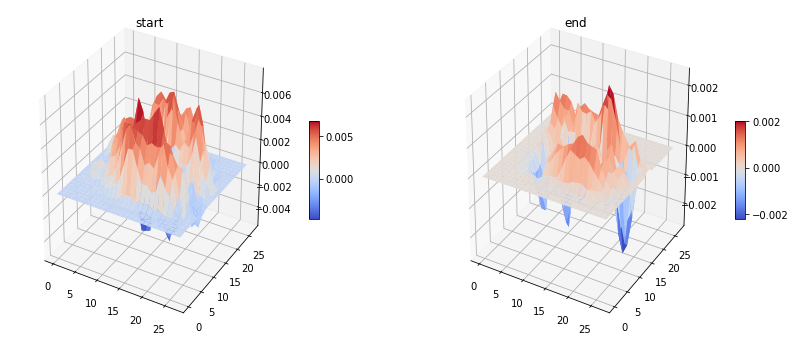

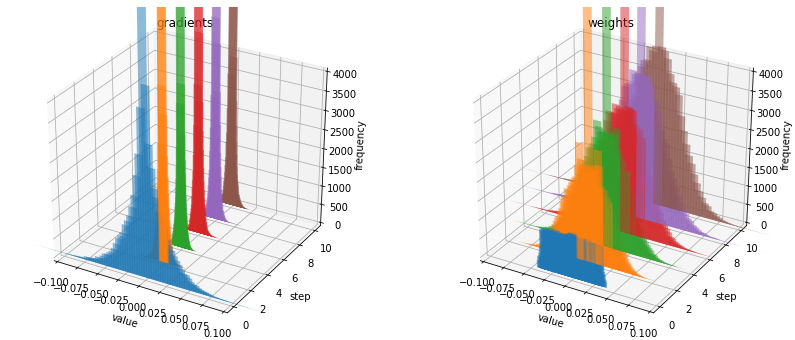

activation:  Hardswish
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.240306 |  ACC: 0.210938
[0201/0936]	 Loss: 0.749018 |  ACC: 0.884669
[0401/0936]	 Loss: 0.619944 |  ACC: 0.908427
[0601/0936]	 Loss: 0.541597 |  ACC: 0.919695
[0801/0936]	 Loss: 0.483742 |  ACC: 0.928460
[0936/0936]	 Loss: 0.454986 |  ACC: 0.932047
validation:	Loss: 0.206795 | ACC: 0.967100
time: 0:13



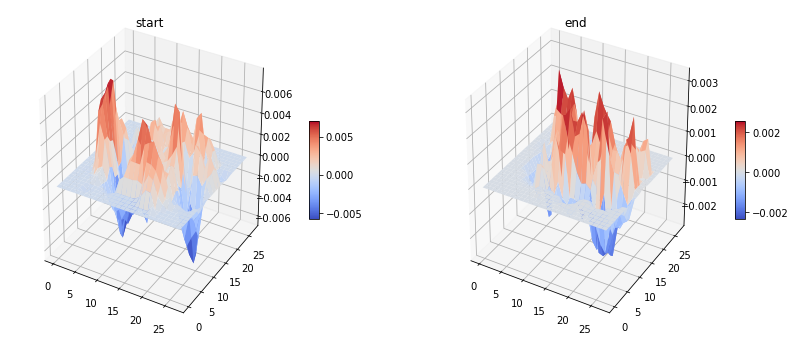

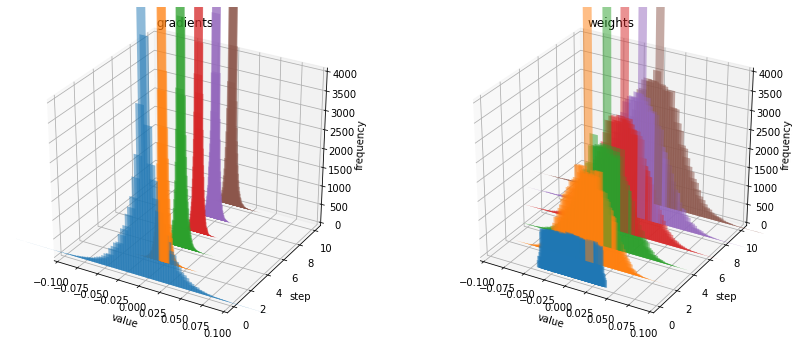

activation:  Mish
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.470907 |  ACC: 0.156250
[0201/0936]	 Loss: 0.706063 |  ACC: 0.882658
[0401/0936]	 Loss: 0.580435 |  ACC: 0.909010
[0601/0936]	 Loss: 0.507059 |  ACC: 0.921044
[0801/0936]	 Loss: 0.455364 |  ACC: 0.928908
[0936/0936]	 Loss: 0.428223 |  ACC: 0.932898
validation:	Loss: 0.186021 | ACC: 0.968200
time: 0:13



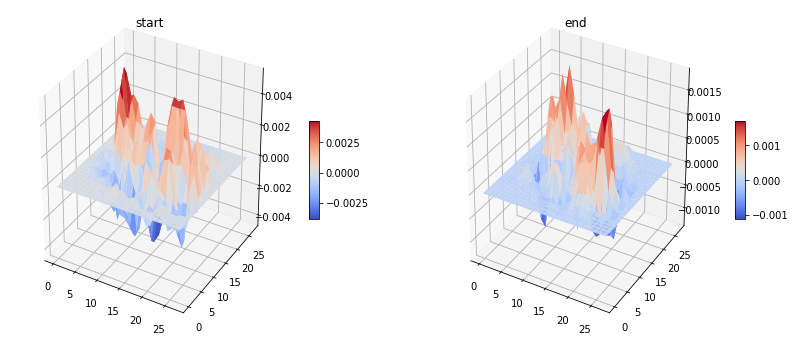

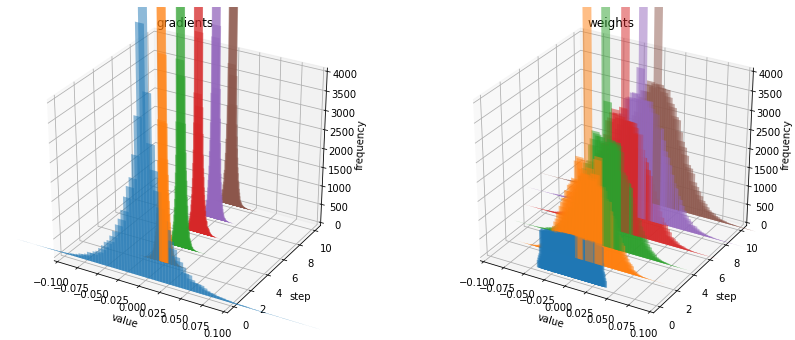

activation:  Sigmoid
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.251223 |  ACC: 0.203125
[0201/0936]	 Loss: 1.919947 |  ACC: 0.838567
[0401/0936]	 Loss: 1.886177 |  ACC: 0.858675
[0601/0936]	 Loss: 1.857880 |  ACC: 0.869394
[0801/0936]	 Loss: 1.831724 |  ACC: 0.879988
[0936/0936]	 Loss: 1.815851 |  ACC: 0.886189
validation:	Loss: 1.701898 | ACC: 0.934600
time: 0:13



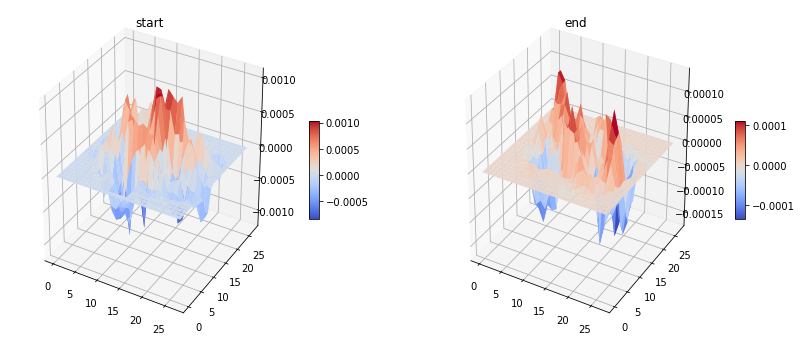

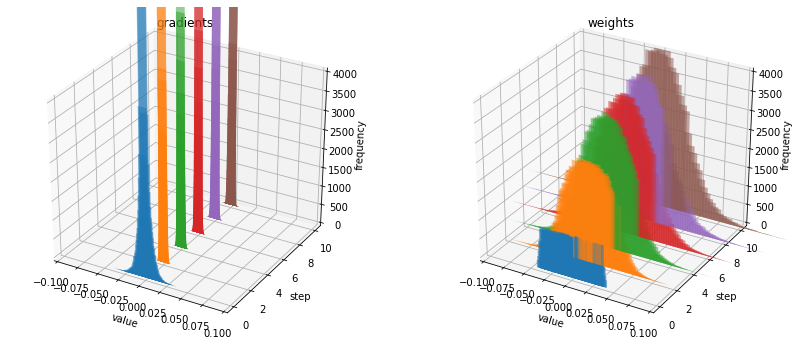

activation:  Tanh
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.385614 |  ACC: 0.179688
[0201/0936]	 Loss: 1.422956 |  ACC: 0.833308
[0401/0936]	 Loss: 1.330268 |  ACC: 0.863845
[0601/0936]	 Loss: 1.267127 |  ACC: 0.879464
[0801/0936]	 Loss: 1.218625 |  ACC: 0.890079
[0936/0936]	 Loss: 1.191300 |  ACC: 0.896345
validation:	Loss: 0.994305 | ACC: 0.947900
time: 0:13



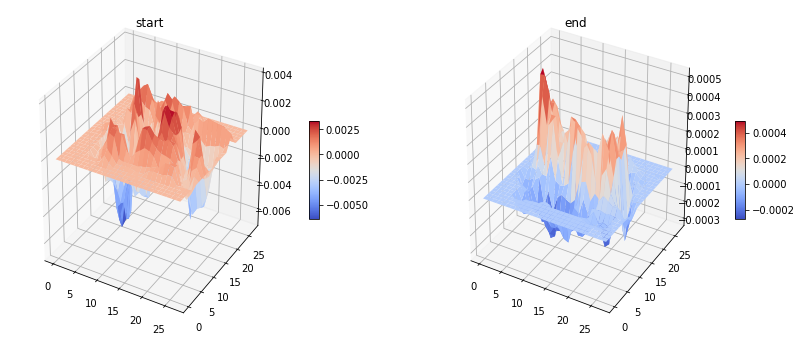

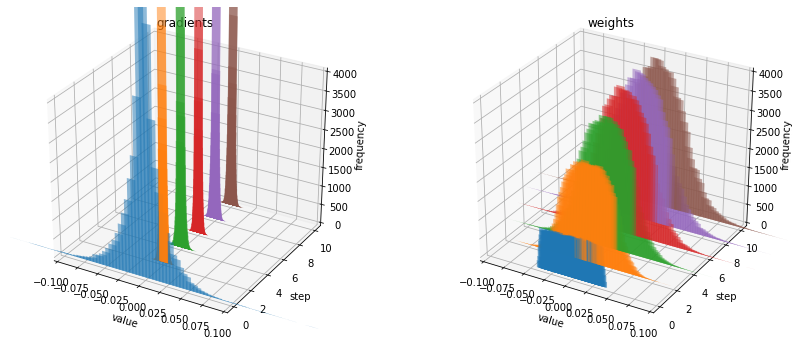

activation:  ReLU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.205589 |  ACC: 0.226562
[0201/0936]	 Loss: 0.715477 |  ACC: 0.881498
[0401/0936]	 Loss: 0.582148 |  ACC: 0.910914
[0601/0936]	 Loss: 0.508988 |  ACC: 0.921901
[0801/0936]	 Loss: 0.458255 |  ACC: 0.928713
[0936/0936]	 Loss: 0.429307 |  ACC: 0.933031
validation:	Loss: 0.181319 | ACC: 0.971200
time: 0:13



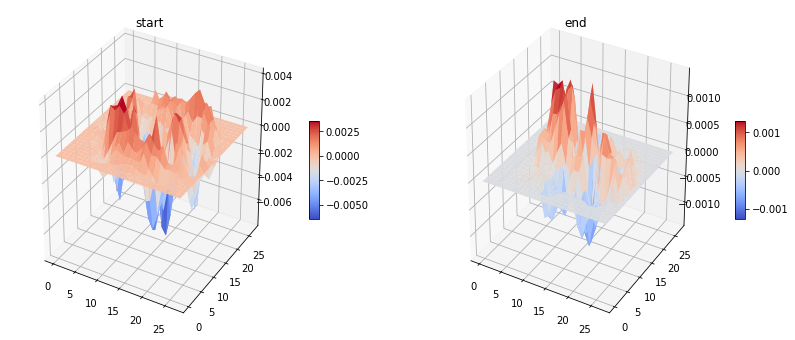

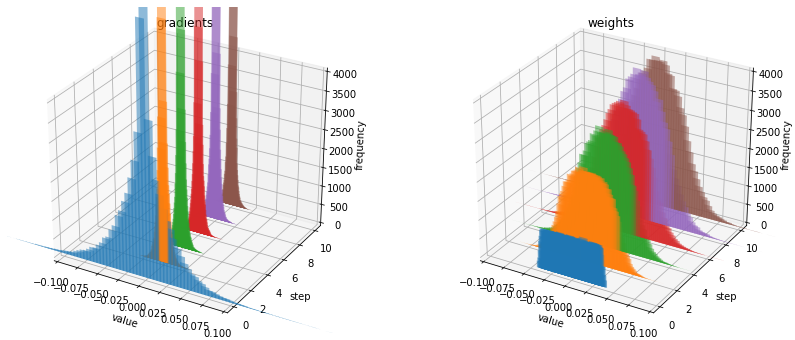

activation:  LeakyReLU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.315048 |  ACC: 0.226562
[0201/0936]	 Loss: 0.735174 |  ACC: 0.877088
[0401/0936]	 Loss: 0.598688 |  ACC: 0.906755
[0601/0936]	 Loss: 0.520274 |  ACC: 0.919799
[0801/0936]	 Loss: 0.463860 |  ACC: 0.928538
[0936/0936]	 Loss: 0.434407 |  ACC: 0.932631
validation:	Loss: 0.180343 | ACC: 0.970600
time: 0:13



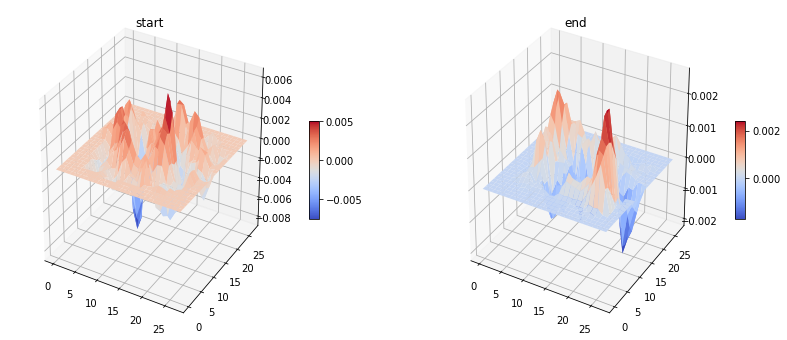

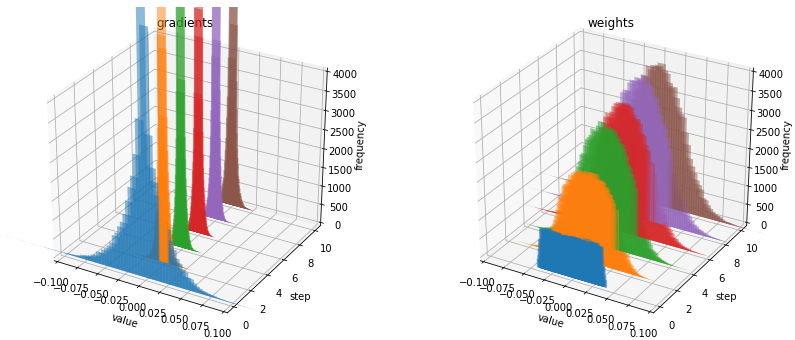

activation:  ReLU6
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.428201 |  ACC: 0.148438
[0201/0936]	 Loss: 0.726534 |  ACC: 0.879641
[0401/0936]	 Loss: 0.590475 |  ACC: 0.910564
[0601/0936]	 Loss: 0.516027 |  ACC: 0.921460
[0801/0936]	 Loss: 0.459788 |  ACC: 0.929882
[0936/0936]	 Loss: 0.430150 |  ACC: 0.934232
validation:	Loss: 0.204268 | ACC: 0.970300
time: 0:13



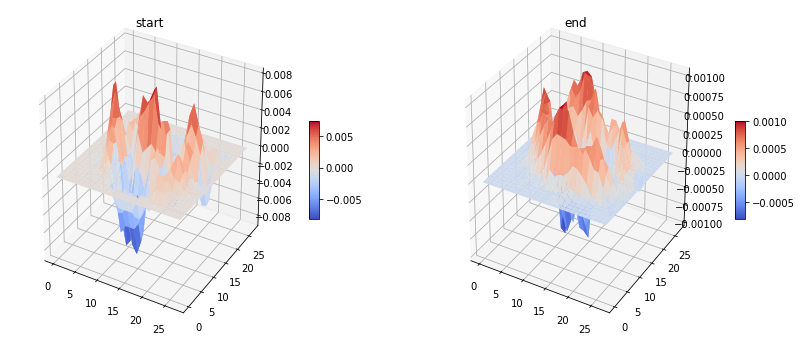

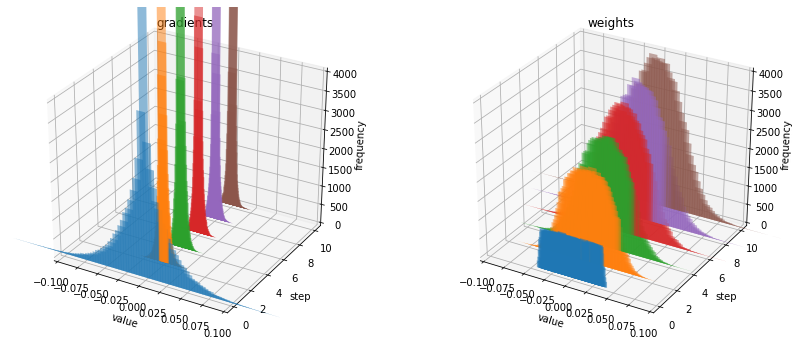

activation:  ELU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.154897 |  ACC: 0.203125
[0201/0936]	 Loss: 0.734053 |  ACC: 0.866259
[0401/0936]	 Loss: 0.612851 |  ACC: 0.894590
[0601/0936]	 Loss: 0.537065 |  ACC: 0.909780
[0801/0936]	 Loss: 0.486579 |  ACC: 0.918095
[0936/0936]	 Loss: 0.457593 |  ACC: 0.922842
validation:	Loss: 0.230778 | ACC: 0.958900
time: 0:13



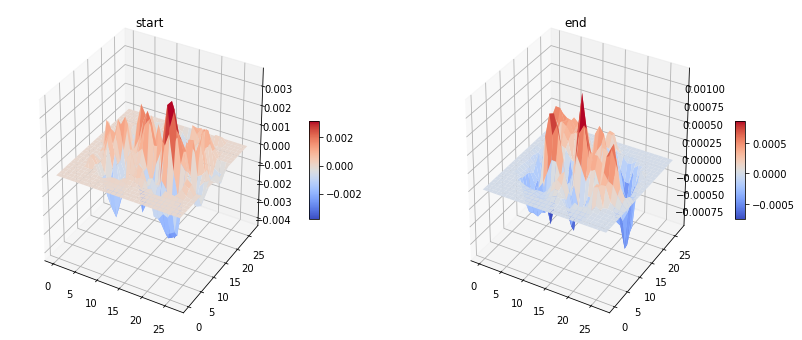

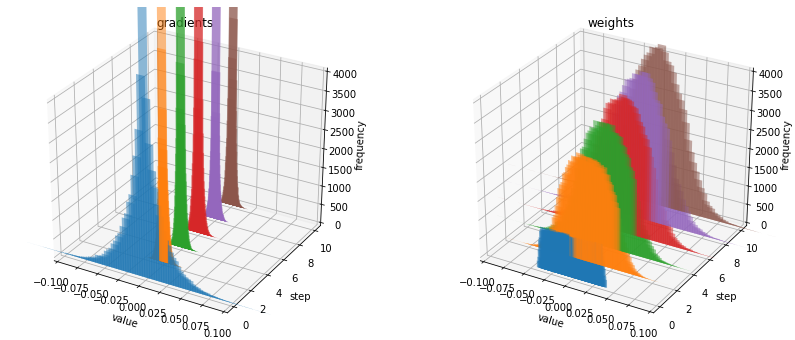

activation:  SELU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.332220 |  ACC: 0.265625
[0201/0936]	 Loss: 0.724294 |  ACC: 0.856668
[0401/0936]	 Loss: 0.612546 |  ACC: 0.881724
[0601/0936]	 Loss: 0.535923 |  ACC: 0.897244
[0801/0936]	 Loss: 0.484252 |  ACC: 0.906659
[0936/0936]	 Loss: 0.457790 |  ACC: 0.910686
validation:	Loss: 0.225597 | ACC: 0.956100
time: 0:13



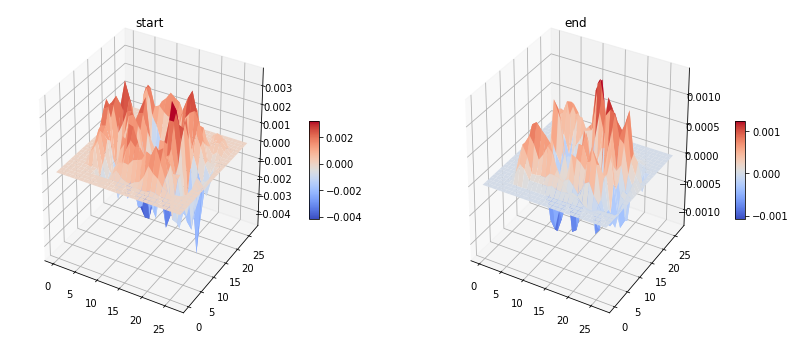

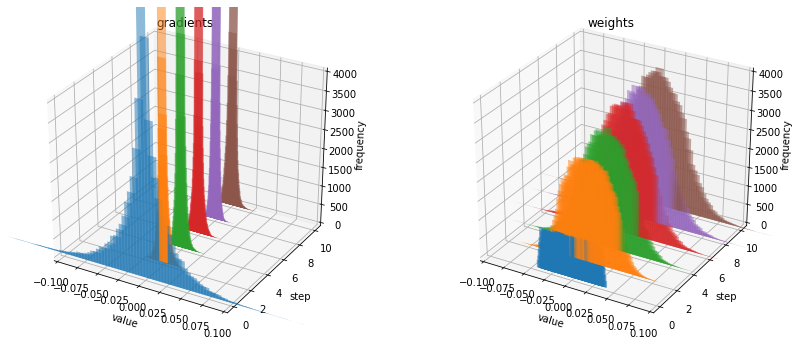

activation:  GELU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.279834 |  ACC: 0.218750
[0201/0936]	 Loss: 0.684641 |  ACC: 0.890857
[0401/0936]	 Loss: 0.564142 |  ACC: 0.912780
[0601/0936]	 Loss: 0.491952 |  ACC: 0.924730
[0801/0936]	 Loss: 0.442259 |  ACC: 0.931324
[0936/0936]	 Loss: 0.414440 |  ACC: 0.935649
validation:	Loss: 0.180769 | ACC: 0.970100
time: 0:13



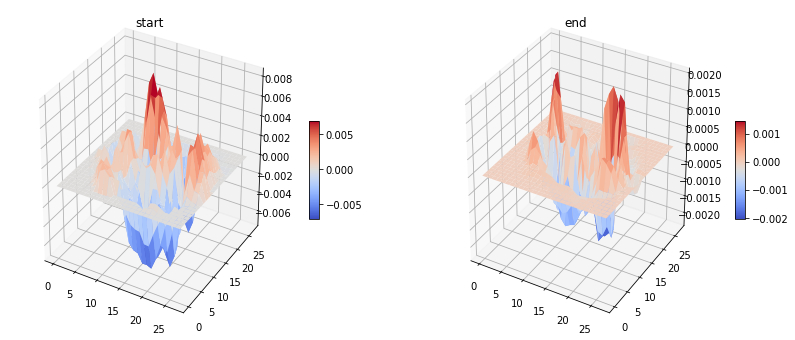

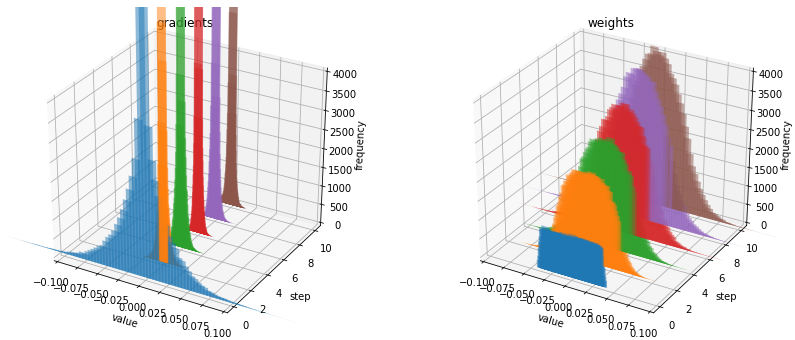

activation:  SiLU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.348724 |  ACC: 0.148438
[0201/0936]	 Loss: 0.750385 |  ACC: 0.883586
[0401/0936]	 Loss: 0.612873 |  ACC: 0.910020
[0601/0936]	 Loss: 0.534715 |  ACC: 0.922109
[0801/0936]	 Loss: 0.479957 |  ACC: 0.928947
[0936/0936]	 Loss: 0.450059 |  ACC: 0.932964
validation:	Loss: 0.184358 | ACC: 0.971400
time: 0:14



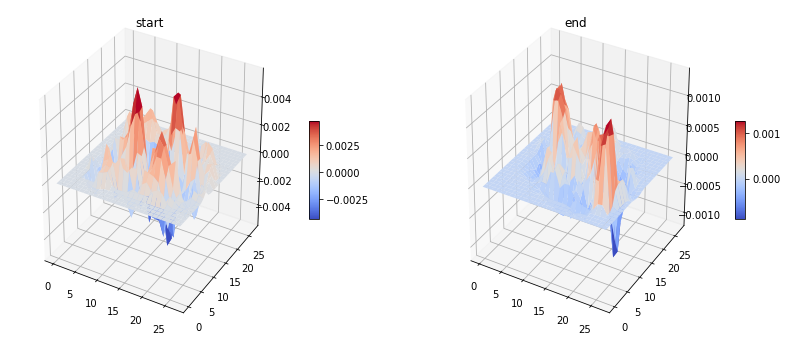

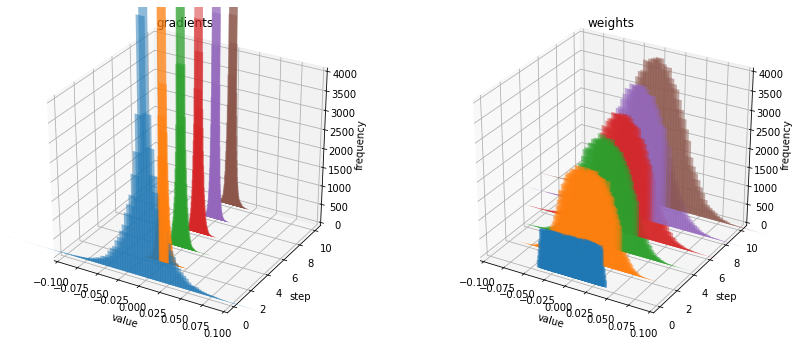

activation:  Hardswish
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.359571 |  ACC: 0.171875
[0201/0936]	 Loss: 0.772381 |  ACC: 0.874226
[0401/0936]	 Loss: 0.628013 |  ACC: 0.903451
[0601/0936]	 Loss: 0.544336 |  ACC: 0.917073
[0801/0936]	 Loss: 0.487779 |  ACC: 0.925674
[0936/0936]	 Loss: 0.458011 |  ACC: 0.929512
validation:	Loss: 0.203014 | ACC: 0.970400
time: 0:13



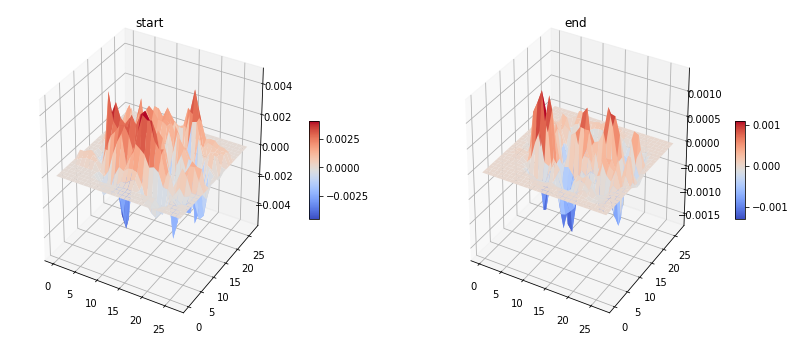

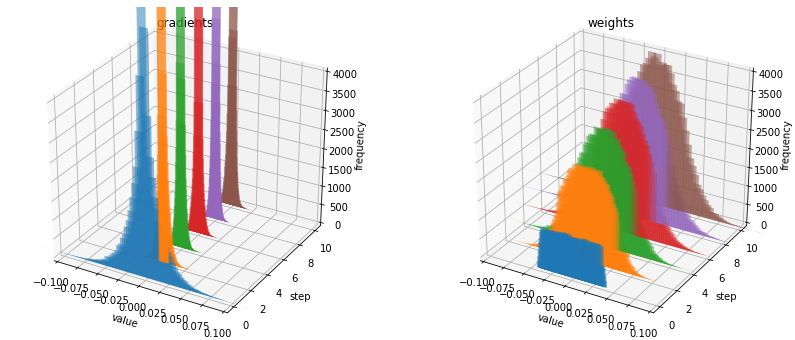

activation:  Mish
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.440053 |  ACC: 0.132812
[0201/0936]	 Loss: 0.708539 |  ACC: 0.879409
[0401/0936]	 Loss: 0.583997 |  ACC: 0.907727
[0601/0936]	 Loss: 0.510562 |  ACC: 0.920655
[0801/0936]	 Loss: 0.459782 |  ACC: 0.928285
[0936/0936]	 Loss: 0.432946 |  ACC: 0.932014
validation:	Loss: 0.190237 | ACC: 0.968100
time: 0:13



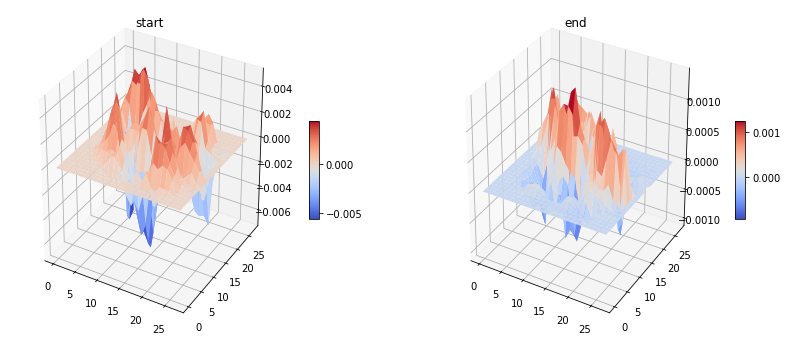

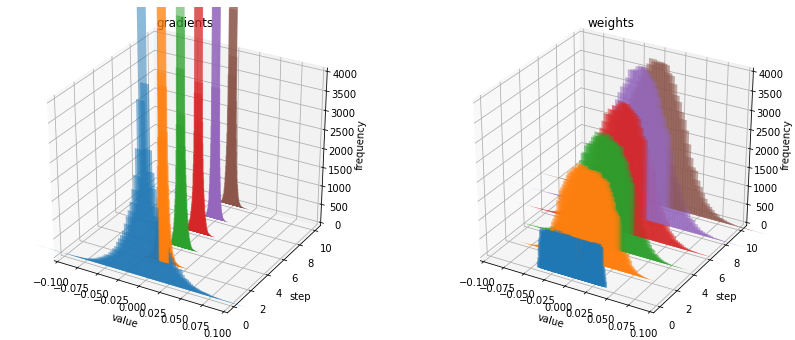

activation:  Sigmoid
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.322017 |  ACC: 0.078125


C:\Users\user\anaconda3\lib\site-packages\pytorch_ranger\ranger.py:172: UserWarning: This overload of addcmul_ is deprecated:
	addcmul_(Number value, Tensor tensor1, Tensor tensor2)
Consider using one of the following signatures instead:
	addcmul_(Tensor tensor1, Tensor tensor2, *, Number value) (Triggered internally at  ..\torch\csrc\utils\python_arg_parser.cpp:1025.)
  exp_avg_sq.mul_(beta2).addcmul_(1 - beta2, grad, grad)


[0201/0936]	 Loss: 2.016846 |  ACC: 0.679455
[0401/0936]	 Loss: 1.974468 |  ACC: 0.762399
[0601/0936]	 Loss: 1.953112 |  ACC: 0.796434
[0801/0936]	 Loss: 1.937595 |  ACC: 0.815695
[0936/0936]	 Loss: 1.928466 |  ACC: 0.825390
validation:	Loss: 1.859077 | ACC: 0.908700
time: 0:13



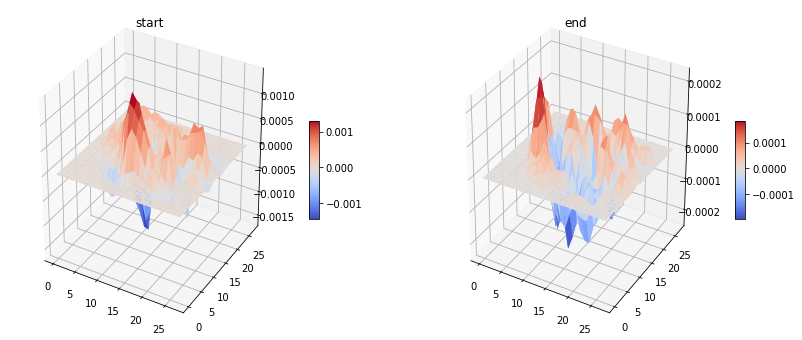

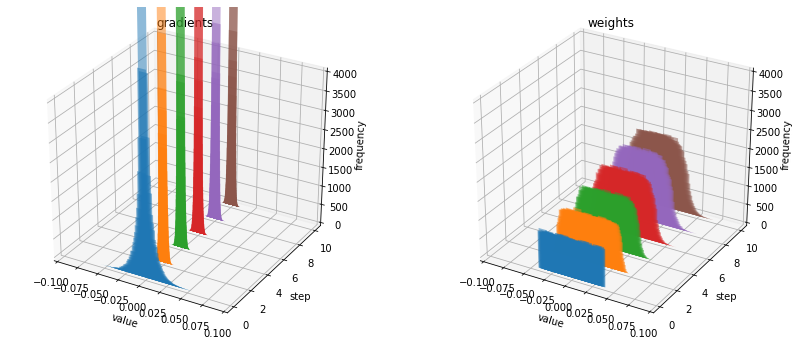

activation:  Tanh
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.329125 |  ACC: 0.164062
[0201/0936]	 Loss: 1.674527 |  ACC: 0.663134
[0401/0936]	 Loss: 1.565892 |  ACC: 0.753887
[0601/0936]	 Loss: 1.507288 |  ACC: 0.791762
[0801/0936]	 Loss: 1.463242 |  ACC: 0.815422
[0936/0936]	 Loss: 1.437247 |  ACC: 0.827575
validation:	Loss: 1.245777 | ACC: 0.918800
time: 0:13



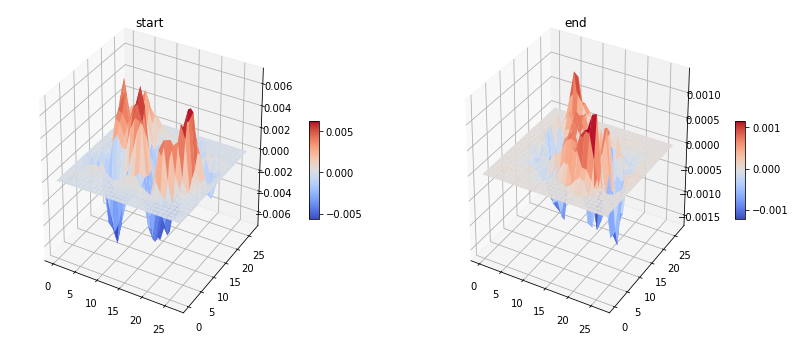

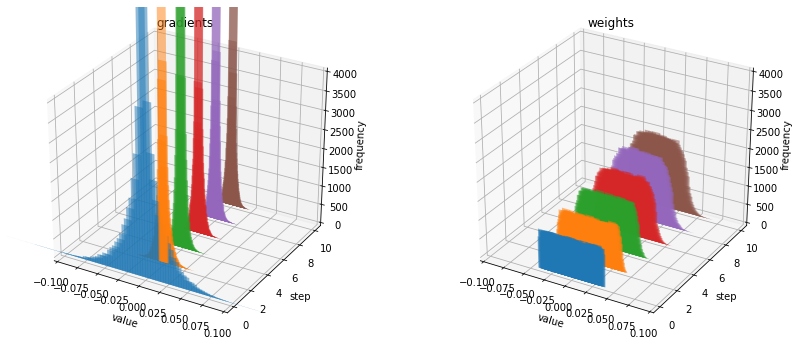

activation:  ReLU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.635721 |  ACC: 0.054688
[0201/0936]	 Loss: 1.417099 |  ACC: 0.621132
[0401/0936]	 Loss: 1.102066 |  ACC: 0.753226
[0601/0936]	 Loss: 0.955636 |  ACC: 0.806478
[0801/0936]	 Loss: 0.859170 |  ACC: 0.837165
[0936/0936]	 Loss: 0.810132 |  ACC: 0.851521
validation:	Loss: 0.406664 | ACC: 0.955900
time: 0:13



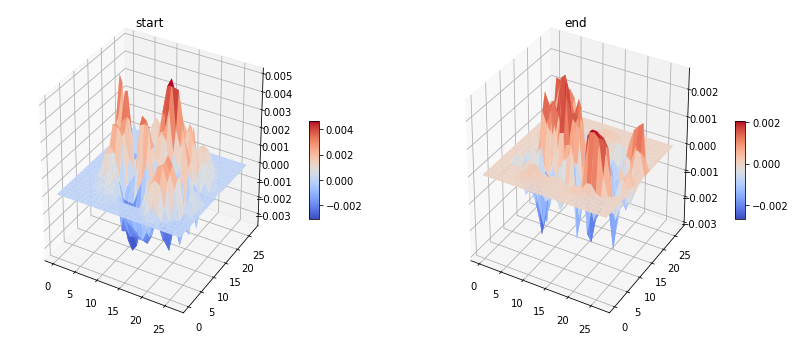

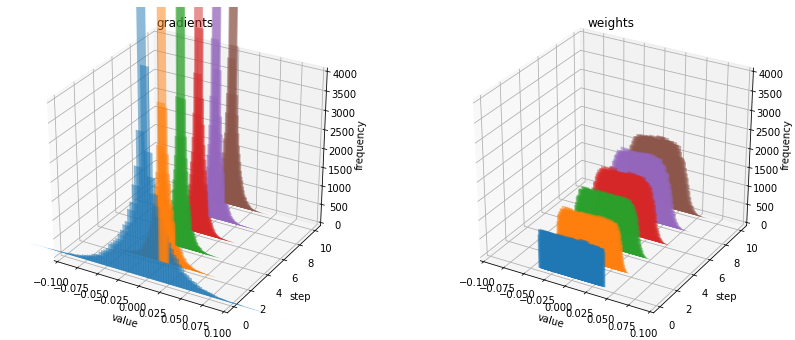

activation:  LeakyReLU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.367853 |  ACC: 0.148438
[0201/0936]	 Loss: 1.308762 |  ACC: 0.668394
[0401/0936]	 Loss: 1.045938 |  ACC: 0.778218
[0601/0936]	 Loss: 0.913754 |  ACC: 0.824076
[0801/0936]	 Loss: 0.826989 |  ACC: 0.850686
[0936/0936]	 Loss: 0.781438 |  ACC: 0.863194
validation:	Loss: 0.402292 | ACC: 0.958100
time: 0:14



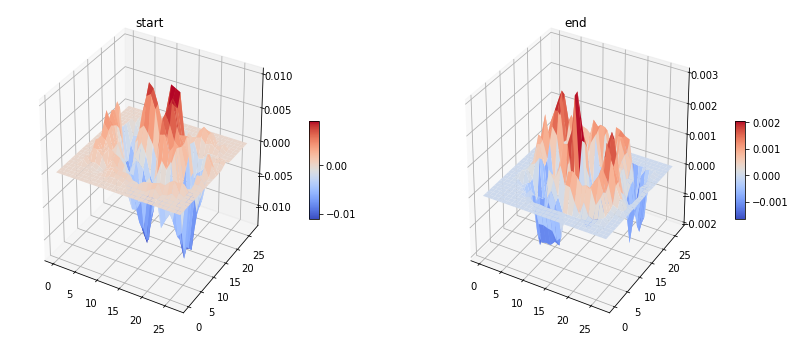

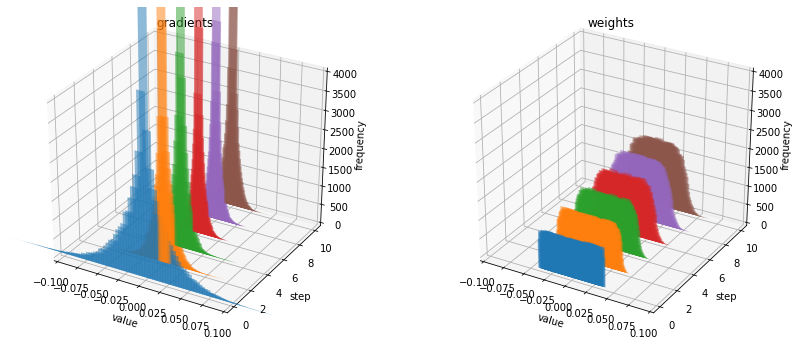

activation:  ReLU6
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.536760 |  ACC: 0.101562
[0201/0936]	 Loss: 1.453370 |  ACC: 0.609375
[0401/0936]	 Loss: 1.120277 |  ACC: 0.750389
[0601/0936]	 Loss: 0.966374 |  ACC: 0.805674
[0801/0936]	 Loss: 0.868861 |  ACC: 0.836561
[0936/0936]	 Loss: 0.817924 |  ACC: 0.851321
validation:	Loss: 0.410084 | ACC: 0.957700
time: 0:13



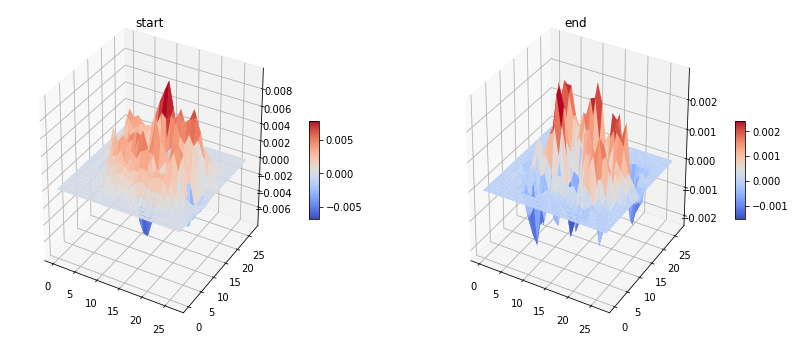

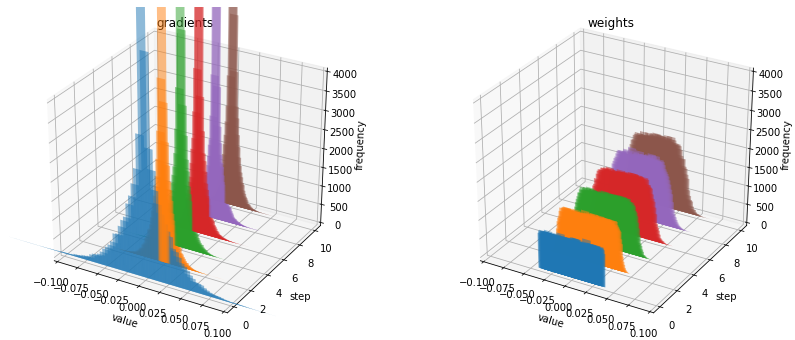

activation:  ELU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.532264 |  ACC: 0.085938
[0201/0936]	 Loss: 1.230352 |  ACC: 0.692218
[0401/0936]	 Loss: 0.999203 |  ACC: 0.784087
[0601/0936]	 Loss: 0.881869 |  ACC: 0.823894
[0801/0936]	 Loss: 0.802542 |  ACC: 0.848952
[0936/0936]	 Loss: 0.760510 |  ACC: 0.860993
validation:	Loss: 0.412494 | ACC: 0.953000
time: 0:13



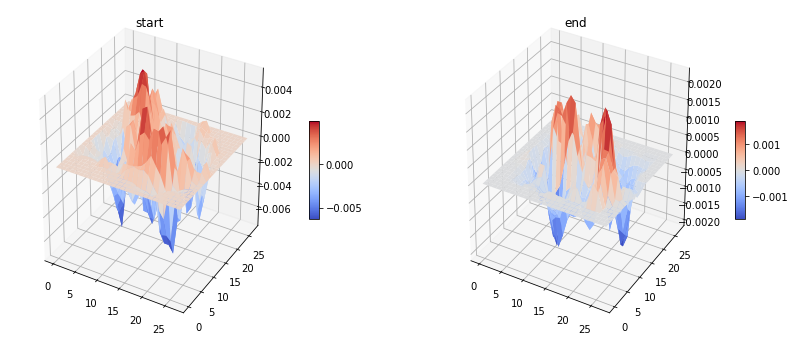

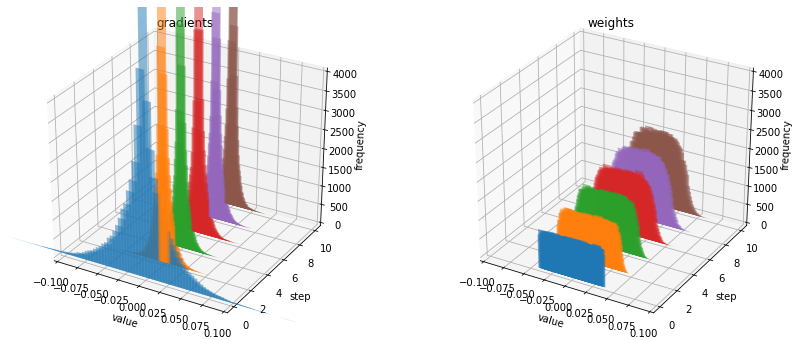

activation:  SELU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.731179 |  ACC: 0.054688
[0201/0936]	 Loss: 1.185326 |  ACC: 0.693301
[0401/0936]	 Loss: 0.973071 |  ACC: 0.777091
[0601/0936]	 Loss: 0.871232 |  ACC: 0.812240
[0801/0936]	 Loss: 0.801229 |  ACC: 0.833074
[0936/0936]	 Loss: 0.762352 |  ACC: 0.843817
validation:	Loss: 0.441969 | ACC: 0.934500
time: 0:13



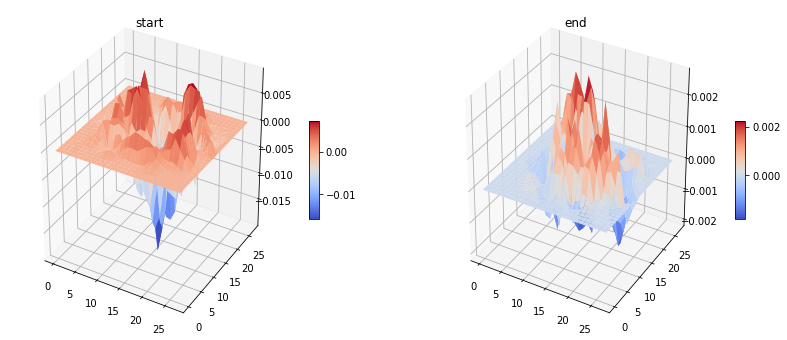

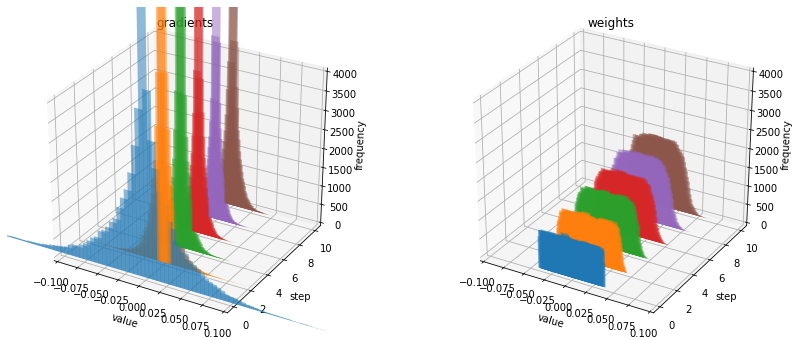

activation:  GELU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.425097 |  ACC: 0.132812
[0201/0936]	 Loss: 1.333248 |  ACC: 0.657642
[0401/0936]	 Loss: 1.036786 |  ACC: 0.777052
[0601/0936]	 Loss: 0.897004 |  ACC: 0.825581
[0801/0936]	 Loss: 0.807568 |  ACC: 0.852673
[0936/0936]	 Loss: 0.763101 |  ACC: 0.864928
validation:	Loss: 0.380670 | ACC: 0.961400
time: 0:14



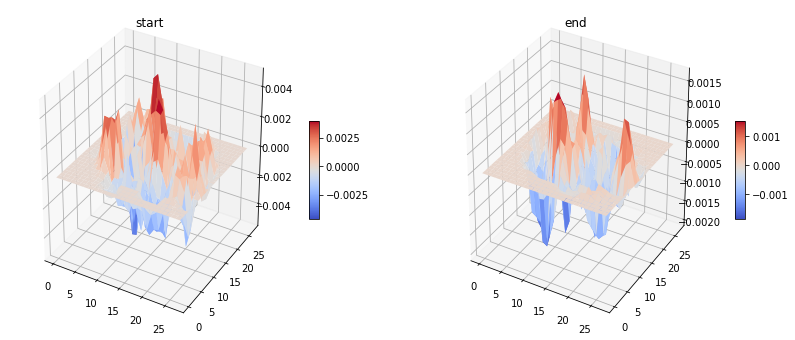

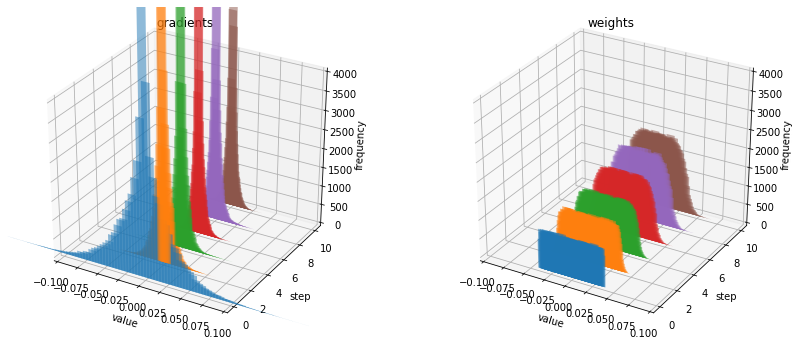

activation:  SiLU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.506390 |  ACC: 0.093750
[0201/0936]	 Loss: 1.351275 |  ACC: 0.659731
[0401/0936]	 Loss: 1.072551 |  ACC: 0.777635
[0601/0936]	 Loss: 0.939025 |  ACC: 0.825036
[0801/0936]	 Loss: 0.850271 |  ACC: 0.852673
[0936/0936]	 Loss: 0.804192 |  ACC: 0.864995
validation:	Loss: 0.424212 | ACC: 0.955300
time: 0:14



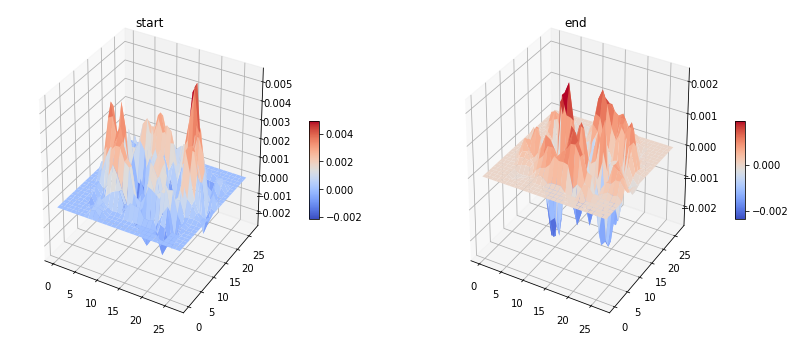

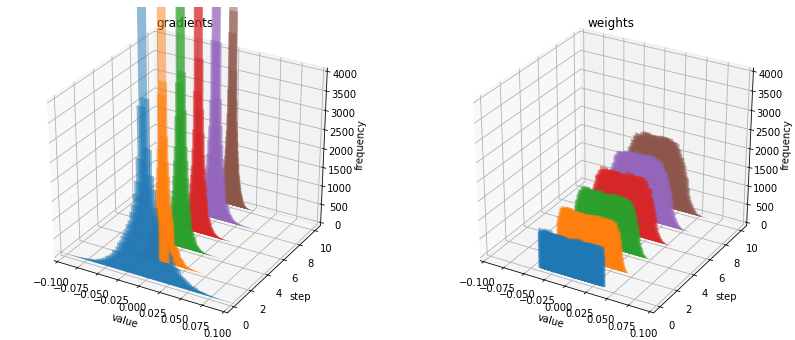

activation:  Hardswish
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.504464 |  ACC: 0.031250
[0201/0936]	 Loss: 1.360765 |  ACC: 0.656869
[0401/0936]	 Loss: 1.085583 |  ACC: 0.773243
[0601/0936]	 Loss: 0.949119 |  ACC: 0.821766
[0801/0936]	 Loss: 0.859113 |  ACC: 0.848815
[0936/0936]	 Loss: 0.811698 |  ACC: 0.861793
validation:	Loss: 0.404786 | ACC: 0.958800
time: 0:14



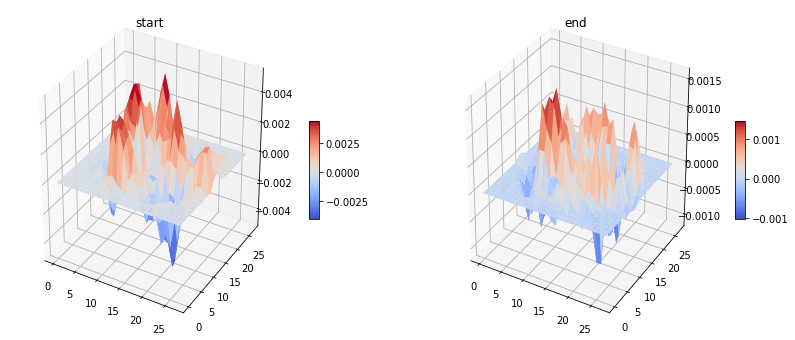

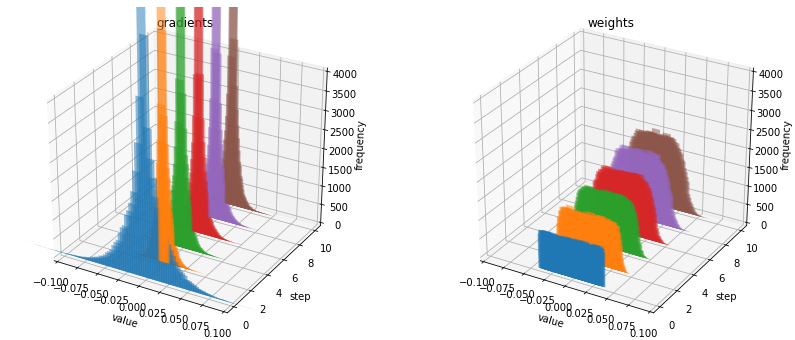

activation:  Mish
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.419097 |  ACC: 0.156250
[0201/0936]	 Loss: 1.259021 |  ACC: 0.682085
[0401/0936]	 Loss: 0.997714 |  ACC: 0.788246
[0601/0936]	 Loss: 0.872541 |  ACC: 0.831369
[0801/0936]	 Loss: 0.790262 |  ACC: 0.857427
[0936/0936]	 Loss: 0.747194 |  ACC: 0.869847
validation:	Loss: 0.397484 | ACC: 0.959500
time: 0:13



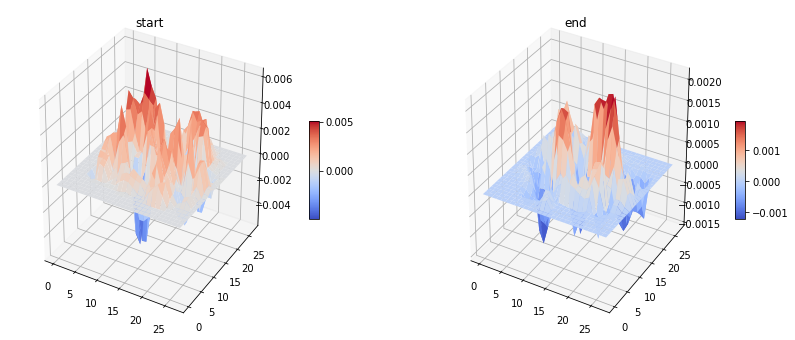

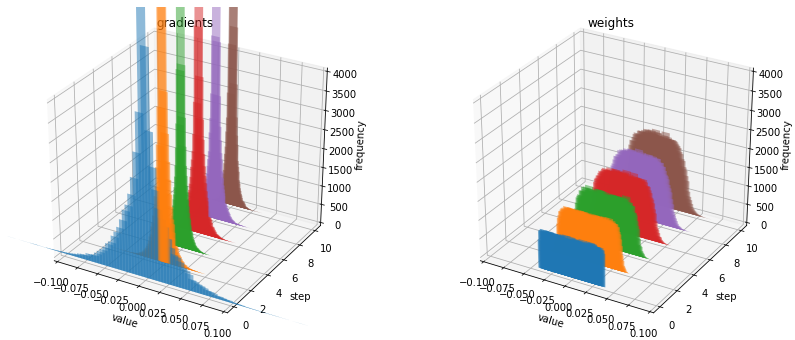

activation:  Sigmoid
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.237118 |  ACC: 0.218750
[0201/0936]	 Loss: 1.911698 |  ACC: 0.827351
[0401/0936]	 Loss: 1.864326 |  ACC: 0.846821
[0601/0936]	 Loss: 1.828548 |  ACC: 0.858129
[0801/0936]	 Loss: 1.799973 |  ACC: 0.866506
[0936/0936]	 Loss: 1.782925 |  ACC: 0.871848
validation:	Loss: 1.664963 | ACC: 0.917000
time: 0:13



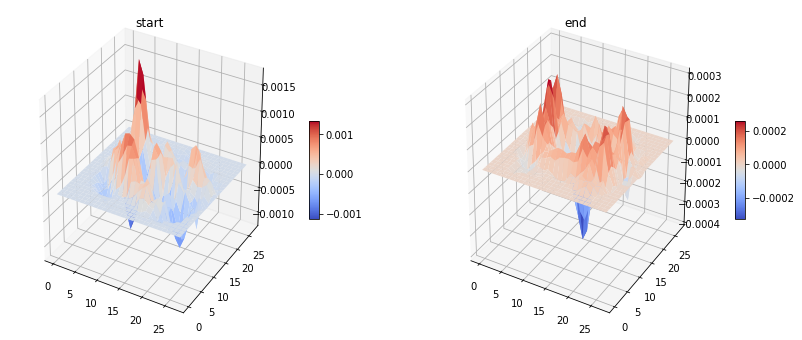

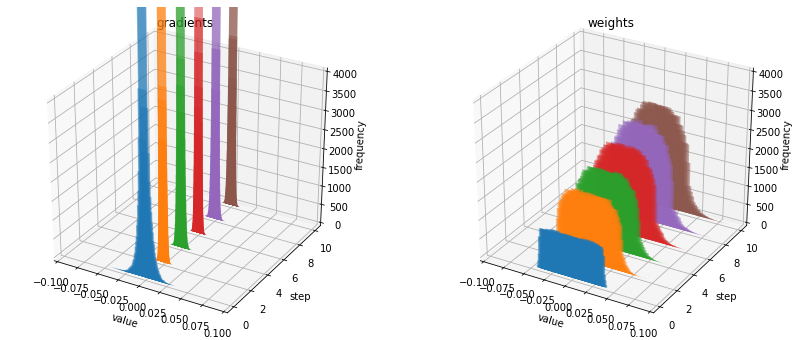

activation:  Tanh
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.234332 |  ACC: 0.210938
[0201/0936]	 Loss: 1.367495 |  ACC: 0.844833
[0401/0936]	 Loss: 1.253768 |  ACC: 0.871385
[0601/0936]	 Loss: 1.184907 |  ACC: 0.888159
[0801/0936]	 Loss: 1.140232 |  ACC: 0.898613
[0936/0936]	 Loss: 1.118343 |  ACC: 0.903699
validation:	Loss: 0.948784 | ACC: 0.948600
time: 0:13



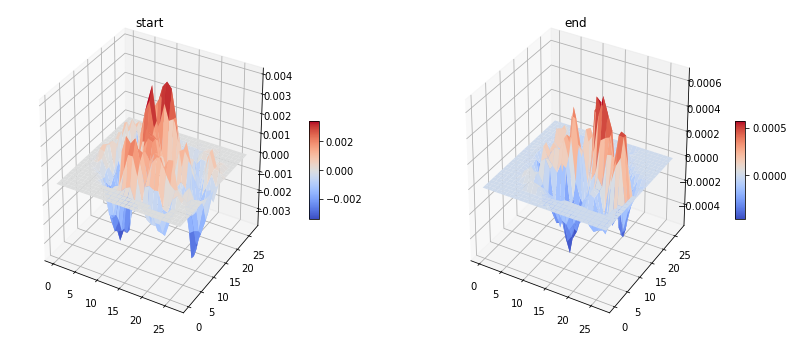

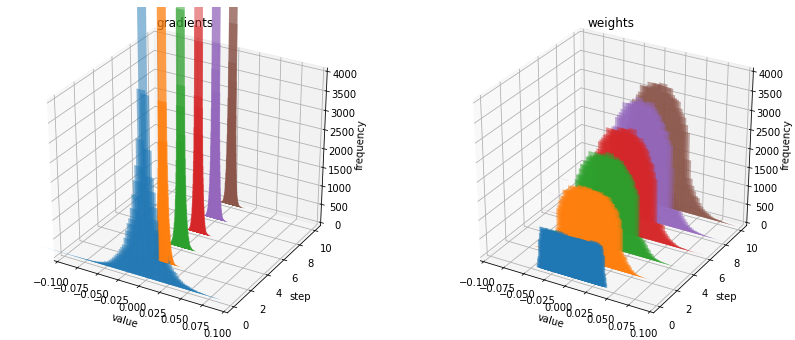

activation:  ReLU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.249005 |  ACC: 0.203125
[0201/0936]	 Loss: 0.703453 |  ACC: 0.877553
[0401/0936]	 Loss: 0.552535 |  ACC: 0.907572
[0601/0936]	 Loss: 0.467608 |  ACC: 0.921044
[0801/0936]	 Loss: 0.413567 |  ACC: 0.928947
[0936/0936]	 Loss: 0.385657 |  ACC: 0.932764
validation:	Loss: 0.149841 | ACC: 0.971800
time: 0:13



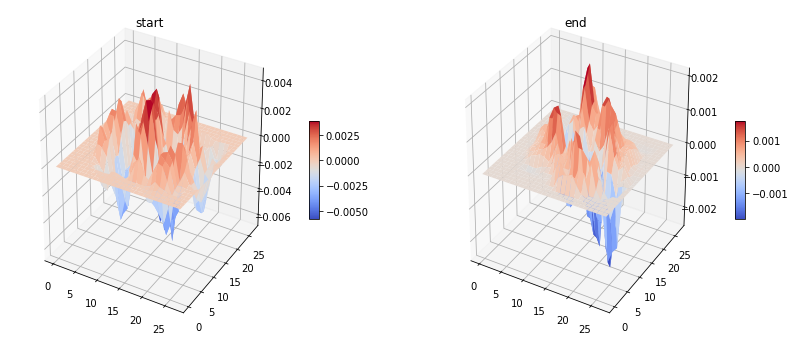

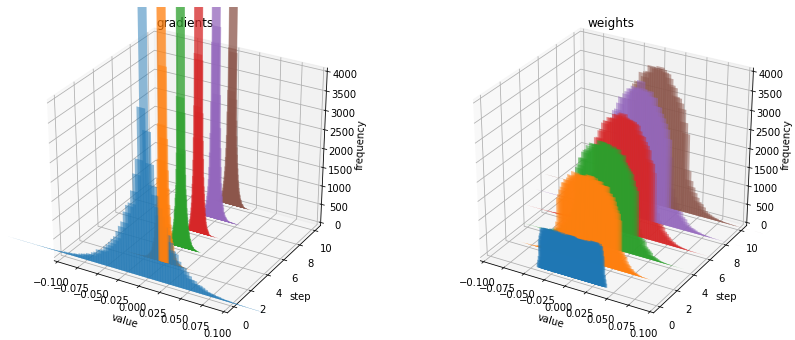

activation:  LeakyReLU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.263306 |  ACC: 0.203125
[0201/0936]	 Loss: 0.696621 |  ACC: 0.878171
[0401/0936]	 Loss: 0.551184 |  ACC: 0.906250
[0601/0936]	 Loss: 0.467256 |  ACC: 0.920681
[0801/0936]	 Loss: 0.414076 |  ACC: 0.928363
[0936/0936]	 Loss: 0.385063 |  ACC: 0.932781
validation:	Loss: 0.152996 | ACC: 0.971300
time: 0:13



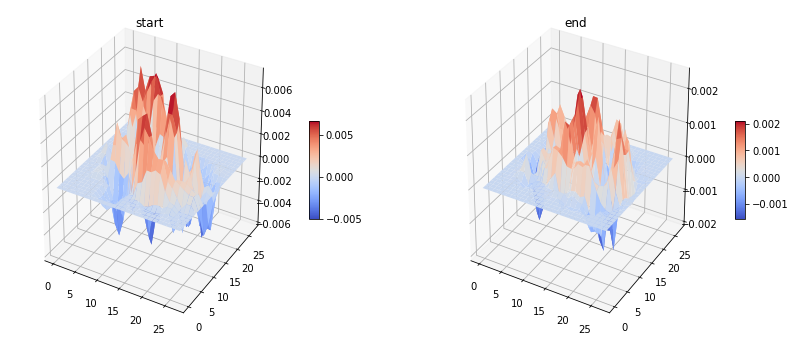

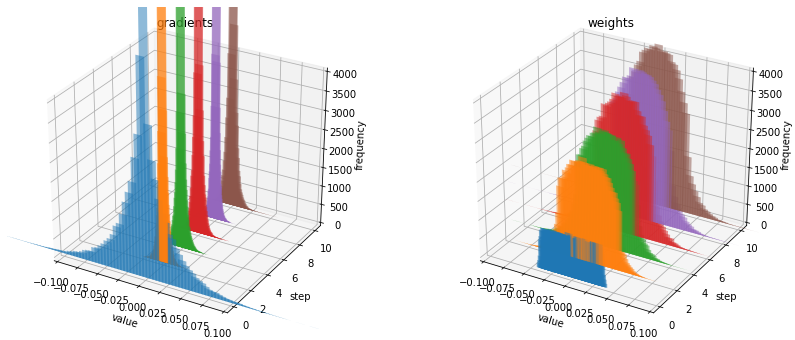

activation:  ReLU6
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.356833 |  ACC: 0.117188
[0201/0936]	 Loss: 0.716519 |  ACC: 0.874691
[0401/0936]	 Loss: 0.556881 |  ACC: 0.906950
[0601/0936]	 Loss: 0.470064 |  ACC: 0.921148
[0801/0936]	 Loss: 0.417640 |  ACC: 0.927895
[0936/0936]	 Loss: 0.390257 |  ACC: 0.932130
validation:	Loss: 0.146720 | ACC: 0.971300
time: 0:13



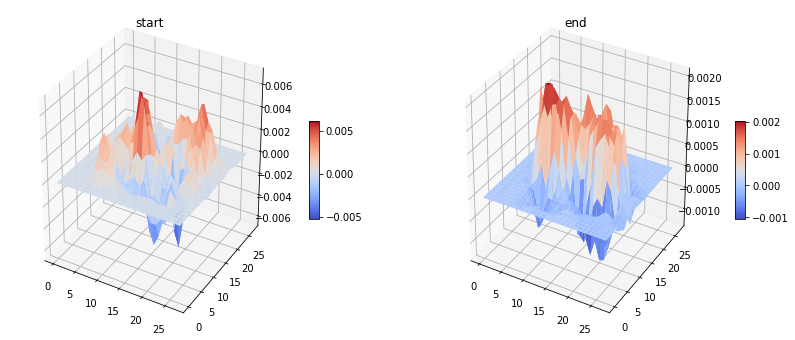

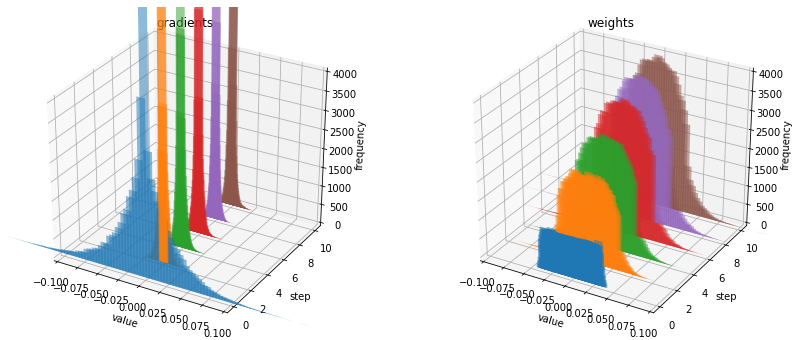

activation:  ELU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.334505 |  ACC: 0.195312
[0201/0936]	 Loss: 0.717591 |  ACC: 0.865099
[0401/0936]	 Loss: 0.595069 |  ACC: 0.888371
[0601/0936]	 Loss: 0.514896 |  ACC: 0.903395
[0801/0936]	 Loss: 0.458232 |  ACC: 0.913731
[0936/0936]	 Loss: 0.429699 |  ACC: 0.918340
validation:	Loss: 0.202958 | ACC: 0.960500
time: 0:13



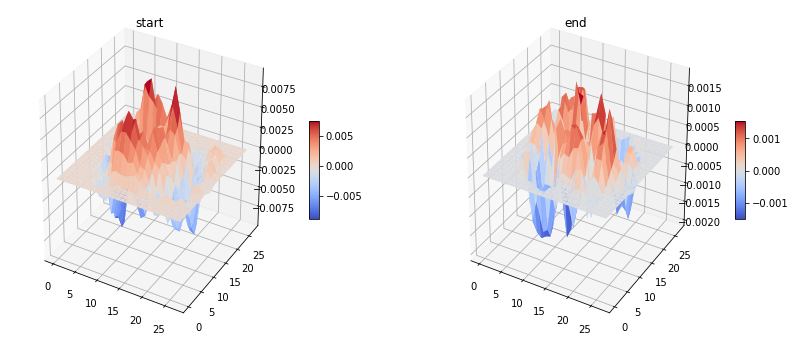

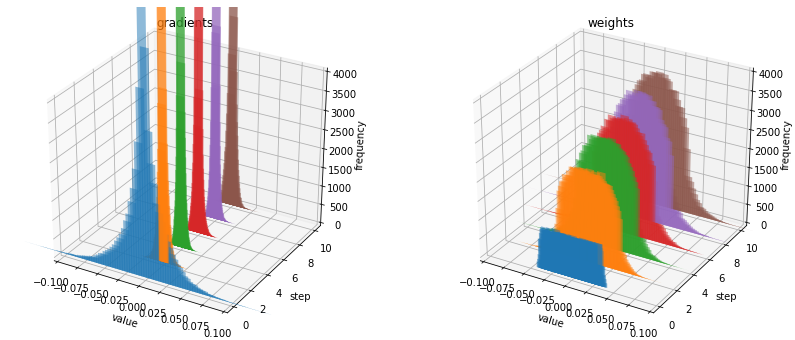

activation:  SELU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.252647 |  ACC: 0.210938
[0201/0936]	 Loss: 0.718183 |  ACC: 0.852491
[0401/0936]	 Loss: 0.600565 |  ACC: 0.877410
[0601/0936]	 Loss: 0.525566 |  ACC: 0.891014
[0801/0936]	 Loss: 0.470043 |  ACC: 0.901827
[0936/0936]	 Loss: 0.441590 |  ACC: 0.907117
validation:	Loss: 0.206599 | ACC: 0.951500
time: 0:13



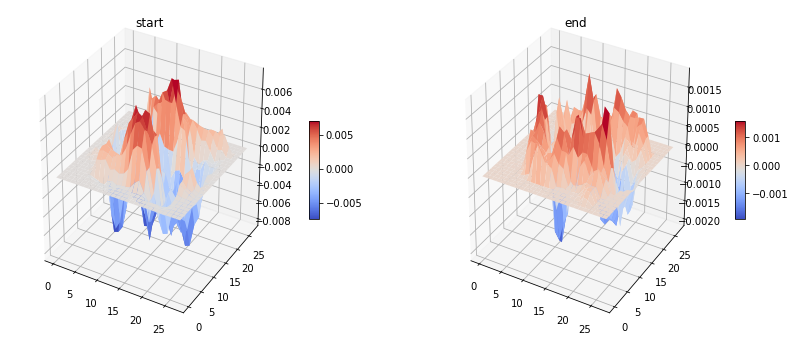

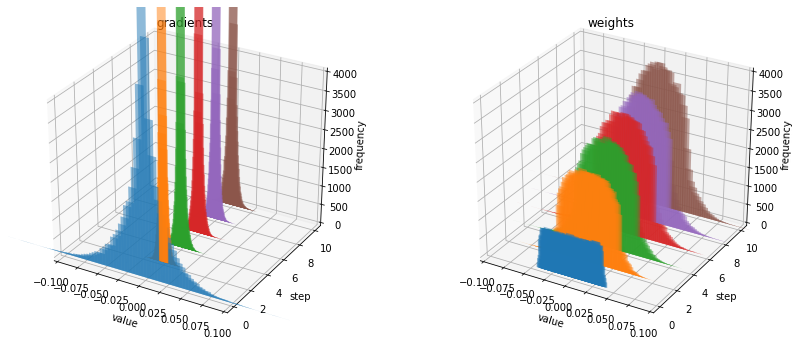

activation:  GELU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.283151 |  ACC: 0.179688
[0201/0936]	 Loss: 0.668426 |  ACC: 0.883973
[0401/0936]	 Loss: 0.526937 |  ACC: 0.911653
[0601/0936]	 Loss: 0.451546 |  ACC: 0.923718
[0801/0936]	 Loss: 0.399470 |  ACC: 0.931558
[0936/0936]	 Loss: 0.372637 |  ACC: 0.935649
validation:	Loss: 0.145852 | ACC: 0.970700
time: 0:14



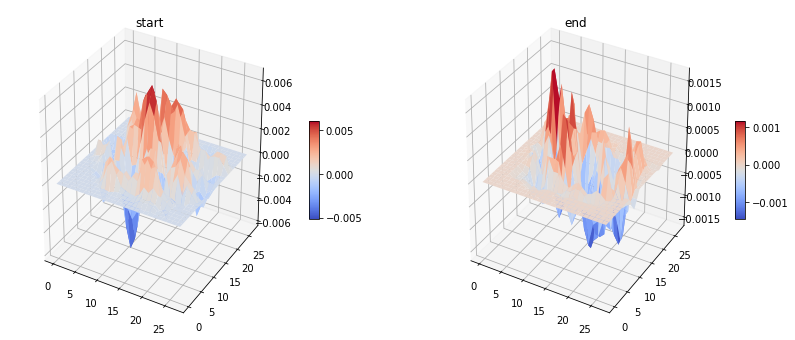

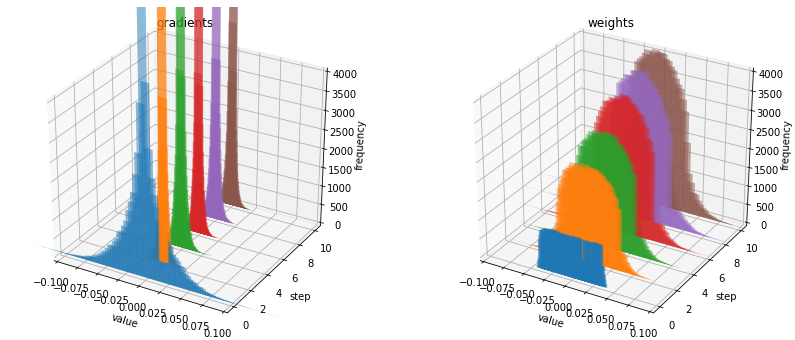

activation:  SiLU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.081176 |  ACC: 0.320312
[0201/0936]	 Loss: 0.699694 |  ACC: 0.885752
[0401/0936]	 Loss: 0.555168 |  ACC: 0.910642
[0601/0936]	 Loss: 0.475049 |  ACC: 0.921979
[0801/0936]	 Loss: 0.419932 |  ACC: 0.929064
[0936/0936]	 Loss: 0.391318 |  ACC: 0.932998
validation:	Loss: 0.161614 | ACC: 0.967800
time: 0:14



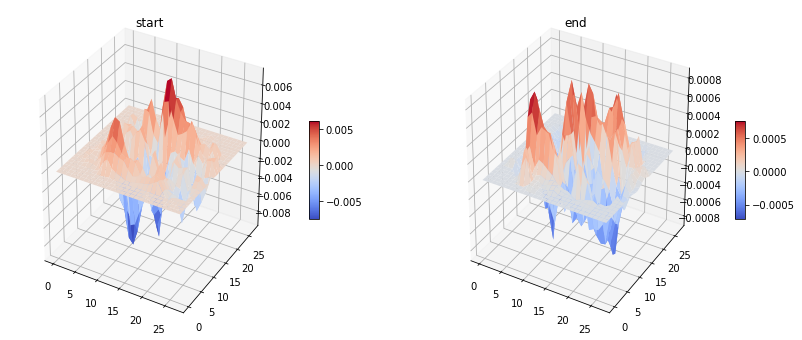

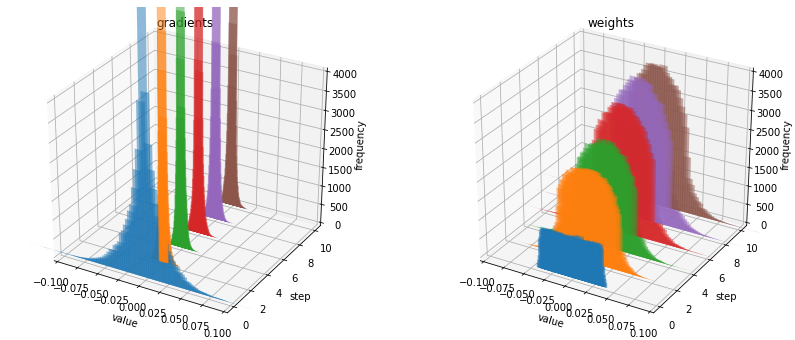

activation:  Hardswish
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.291731 |  ACC: 0.242188
[0201/0936]	 Loss: 0.727353 |  ACC: 0.874845
[0401/0936]	 Loss: 0.576107 |  ACC: 0.902130
[0601/0936]	 Loss: 0.494891 |  ACC: 0.914374
[0801/0936]	 Loss: 0.439086 |  ACC: 0.922343
[0936/0936]	 Loss: 0.410109 |  ACC: 0.926377
validation:	Loss: 0.174230 | ACC: 0.966200
time: 0:14



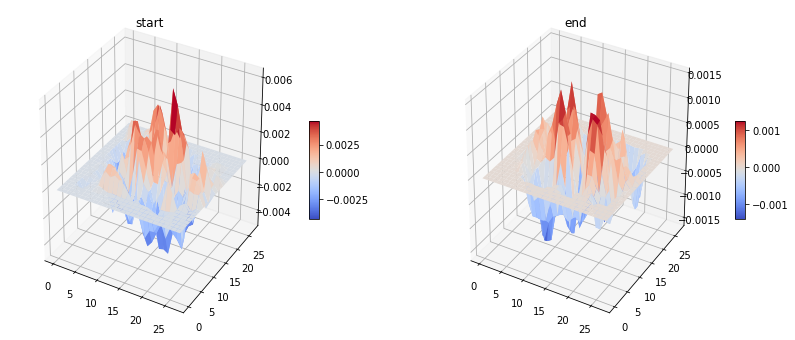

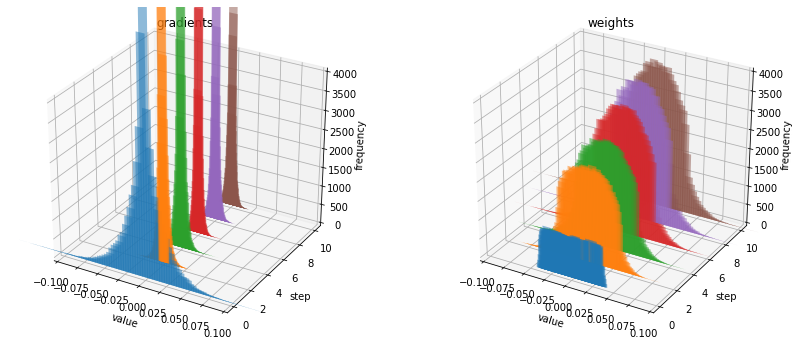

activation:  Mish
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.418192 |  ACC: 0.156250
[0201/0936]	 Loss: 0.671084 |  ACC: 0.882426
[0401/0936]	 Loss: 0.535703 |  ACC: 0.907960
[0601/0936]	 Loss: 0.459236 |  ACC: 0.920577
[0801/0936]	 Loss: 0.407566 |  ACC: 0.928850
[0936/0936]	 Loss: 0.381462 |  ACC: 0.932581
validation:	Loss: 0.155215 | ACC: 0.970400
time: 0:14



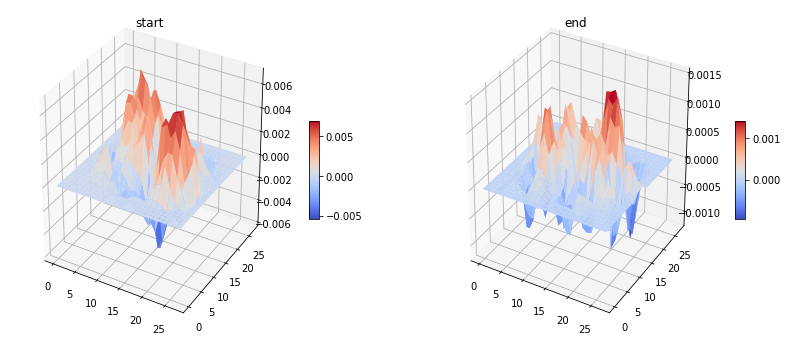

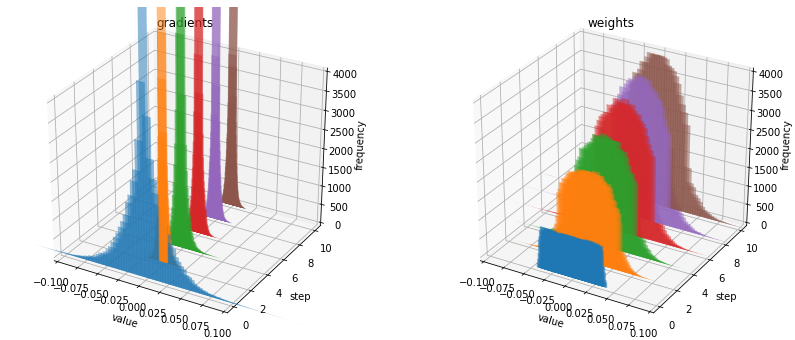

activation:  Sigmoid
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.183565 |  ACC: 0.226562
[0201/0936]	 Loss: 1.918460 |  ACC: 0.840114
[0401/0936]	 Loss: 1.886898 |  ACC: 0.858248
[0601/0936]	 Loss: 1.861298 |  ACC: 0.865526
[0801/0936]	 Loss: 1.838089 |  ACC: 0.875039
[0936/0936]	 Loss: 1.824361 |  ACC: 0.879486
validation:	Loss: 1.715210 | ACC: 0.925300
time: 0:13



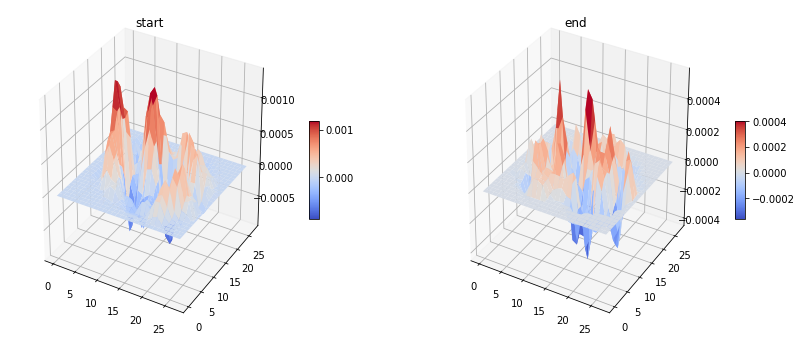

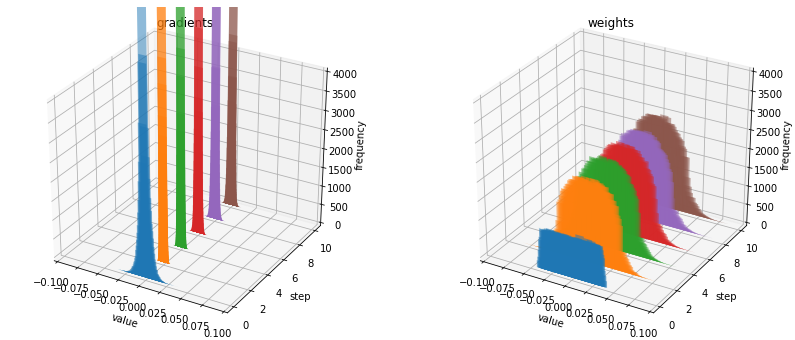

activation:  Tanh
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.235189 |  ACC: 0.226562
[0201/0936]	 Loss: 1.415025 |  ACC: 0.839186
[0401/0936]	 Loss: 1.327255 |  ACC: 0.866566
[0601/0936]	 Loss: 1.264532 |  ACC: 0.881151
[0801/0936]	 Loss: 1.214648 |  ACC: 0.891073
[0936/0936]	 Loss: 1.185176 |  ACC: 0.898012
validation:	Loss: 0.977741 | ACC: 0.948600
time: 0:13



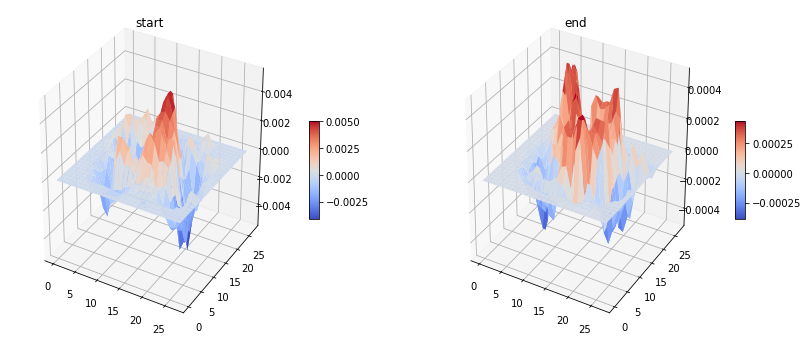

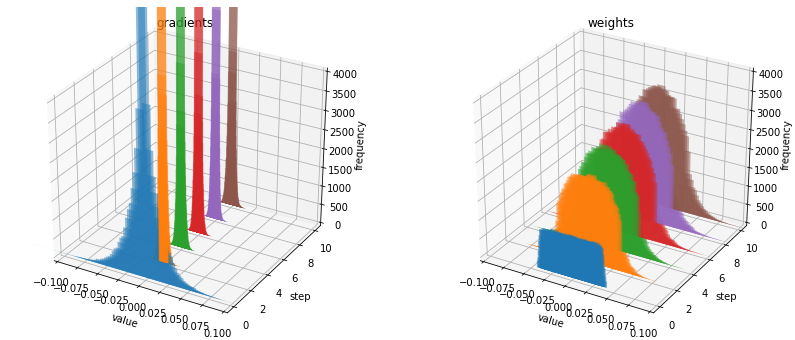

activation:  ReLU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.371185 |  ACC: 0.140625
[0201/0936]	 Loss: 0.733105 |  ACC: 0.877243
[0401/0936]	 Loss: 0.584857 |  ACC: 0.907066
[0601/0936]	 Loss: 0.497210 |  ACC: 0.918812
[0801/0936]	 Loss: 0.432202 |  ACC: 0.928070
[0936/0936]	 Loss: 0.402006 |  ACC: 0.931830
validation:	Loss: 0.146892 | ACC: 0.968400
time: 0:13



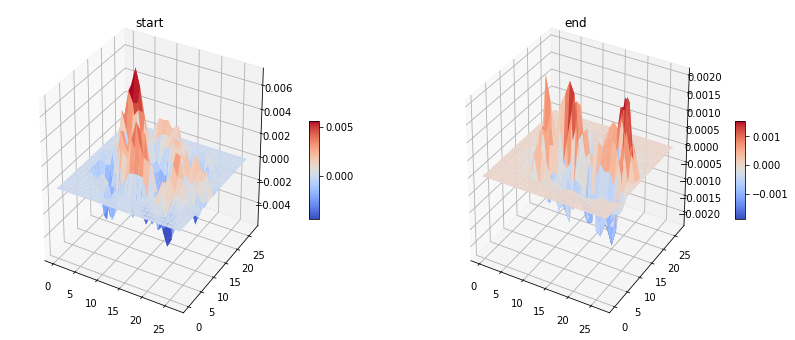

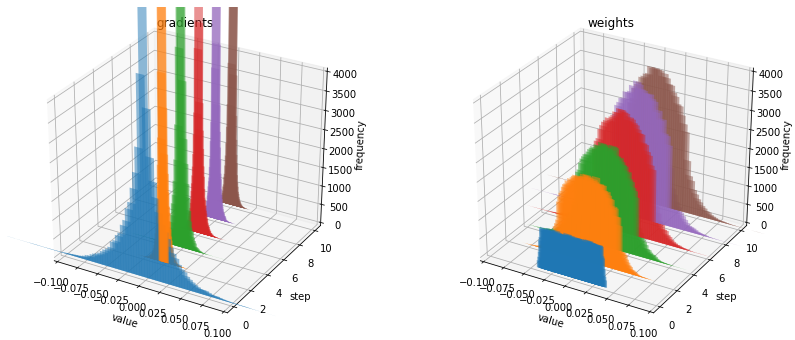

activation:  LeakyReLU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.207399 |  ACC: 0.179688
[0201/0936]	 Loss: 0.736231 |  ACC: 0.879950
[0401/0936]	 Loss: 0.586355 |  ACC: 0.909282
[0601/0936]	 Loss: 0.494462 |  ACC: 0.921979
[0801/0936]	 Loss: 0.432616 |  ACC: 0.929629
[0936/0936]	 Loss: 0.401747 |  ACC: 0.933064
validation:	Loss: 0.139681 | ACC: 0.971600
time: 0:13



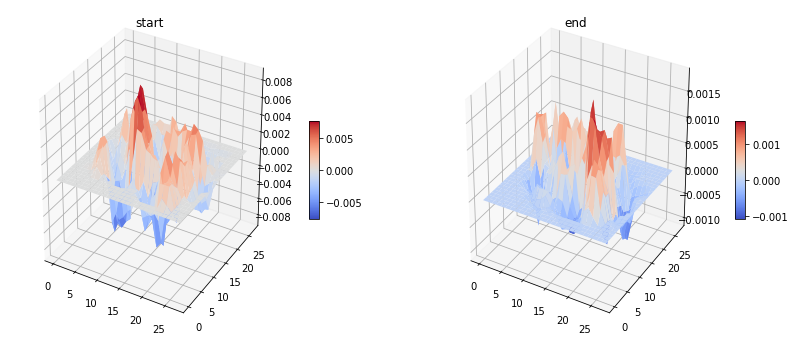

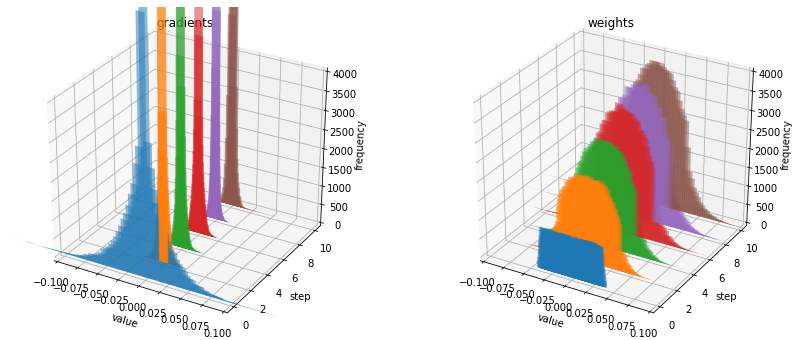

activation:  ReLU6
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.363822 |  ACC: 0.187500
[0201/0936]	 Loss: 0.740368 |  ACC: 0.875000
[0401/0936]	 Loss: 0.583381 |  ACC: 0.909398
[0601/0936]	 Loss: 0.495418 |  ACC: 0.921434
[0801/0936]	 Loss: 0.434153 |  ACC: 0.929161
[0936/0936]	 Loss: 0.401805 |  ACC: 0.933081
validation:	Loss: 0.144066 | ACC: 0.972300
time: 0:13



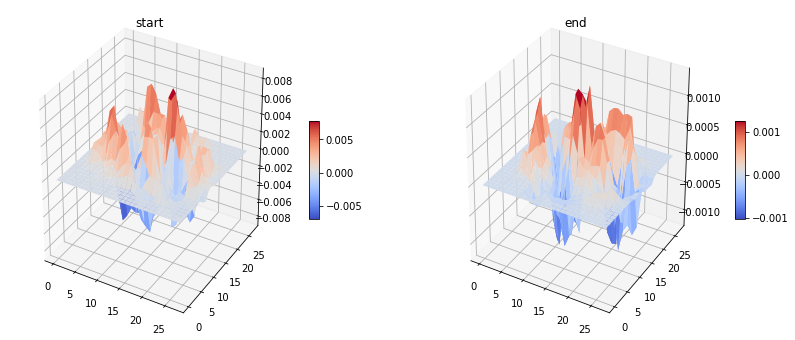

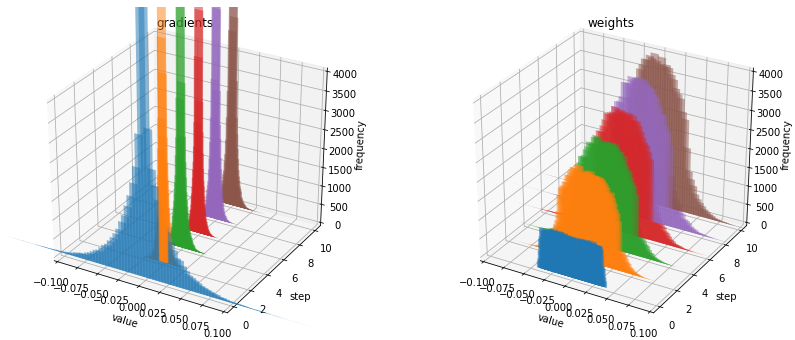

activation:  ELU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.240660 |  ACC: 0.226562
[0201/0936]	 Loss: 0.735101 |  ACC: 0.868348
[0401/0936]	 Loss: 0.604013 |  ACC: 0.894939
[0601/0936]	 Loss: 0.523969 |  ACC: 0.907678
[0801/0936]	 Loss: 0.464430 |  ACC: 0.915524
[0936/0936]	 Loss: 0.433048 |  ACC: 0.920007
validation:	Loss: 0.179802 | ACC: 0.962000
time: 0:13



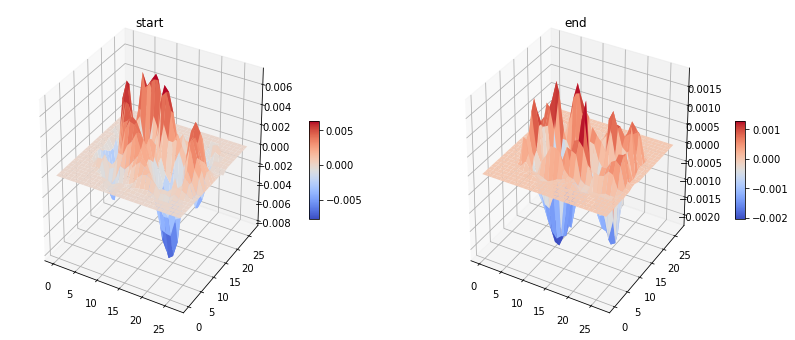

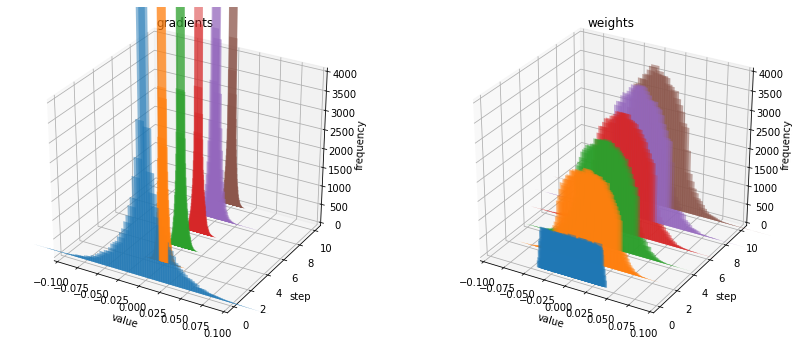

activation:  SELU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.659366 |  ACC: 0.156250
[0201/0936]	 Loss: 0.741542 |  ACC: 0.851485
[0401/0936]	 Loss: 0.622399 |  ACC: 0.875428
[0601/0936]	 Loss: 0.538425 |  ACC: 0.891430
[0801/0936]	 Loss: 0.478025 |  ACC: 0.902276
[0936/0936]	 Loss: 0.448566 |  ACC: 0.906934
validation:	Loss: 0.202322 | ACC: 0.955500
time: 0:13



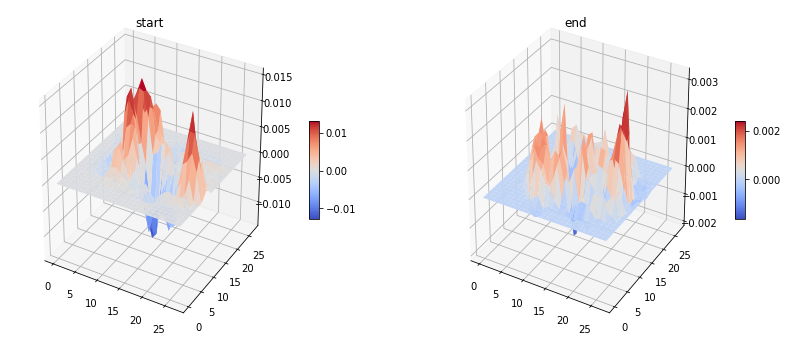

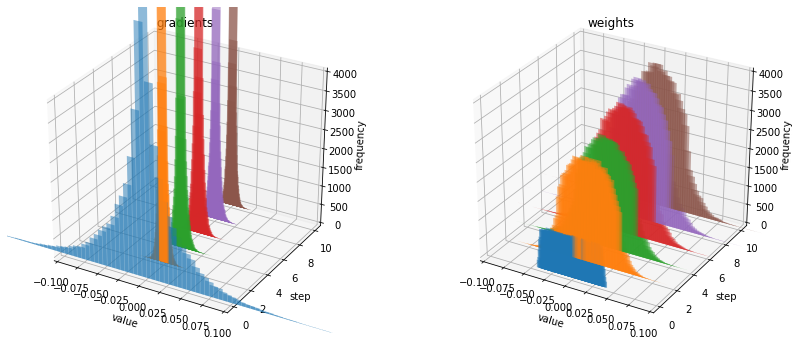

activation:  GELU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.289269 |  ACC: 0.187500
[0201/0936]	 Loss: 0.693499 |  ACC: 0.888537
[0401/0936]	 Loss: 0.554071 |  ACC: 0.914684
[0601/0936]	 Loss: 0.469882 |  ACC: 0.926417
[0801/0936]	 Loss: 0.411723 |  ACC: 0.933545
[0936/0936]	 Loss: 0.383145 |  ACC: 0.936783
validation:	Loss: 0.143992 | ACC: 0.969800
time: 0:13



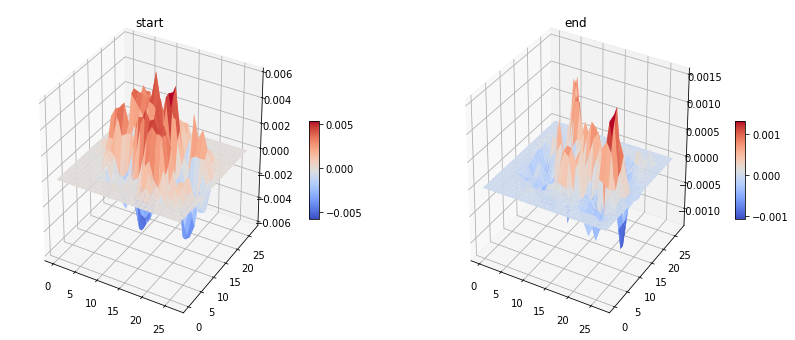

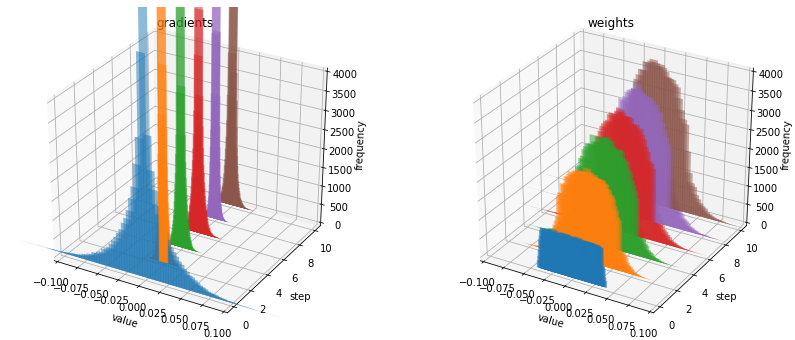

activation:  SiLU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.366345 |  ACC: 0.148438
[0201/0936]	 Loss: 0.748890 |  ACC: 0.880028
[0401/0936]	 Loss: 0.605092 |  ACC: 0.903801
[0601/0936]	 Loss: 0.506943 |  ACC: 0.918449
[0801/0936]	 Loss: 0.443079 |  ACC: 0.926298
[0936/0936]	 Loss: 0.411653 |  ACC: 0.929796
validation:	Loss: 0.144727 | ACC: 0.972100
time: 0:14



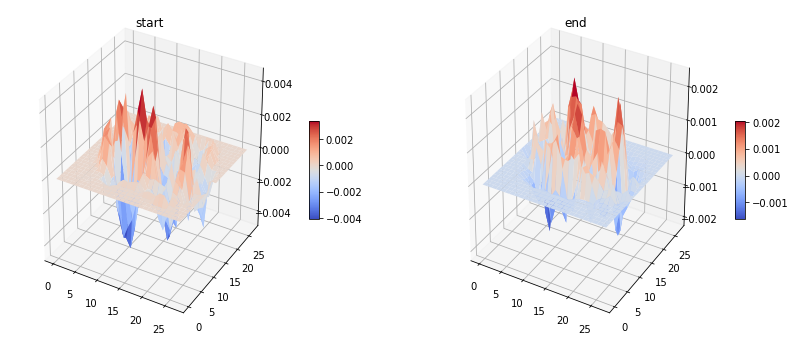

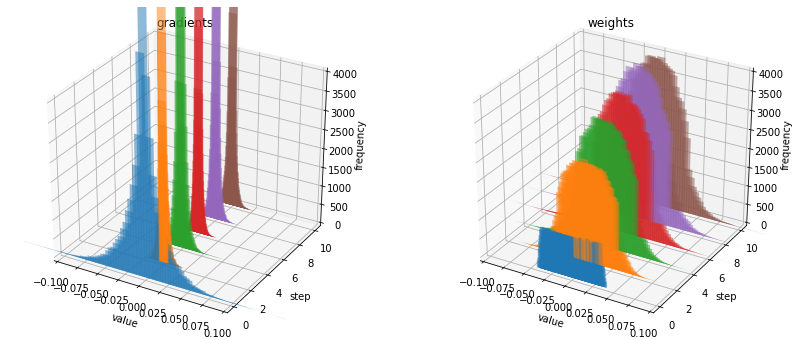

activation:  Hardswish
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.236839 |  ACC: 0.234375
[0201/0936]	 Loss: 0.757435 |  ACC: 0.883431
[0401/0936]	 Loss: 0.604369 |  ACC: 0.908116
[0601/0936]	 Loss: 0.509918 |  ACC: 0.919643
[0801/0936]	 Loss: 0.446152 |  ACC: 0.927330
[0936/0936]	 Loss: 0.414128 |  ACC: 0.931197
validation:	Loss: 0.163624 | ACC: 0.965500
time: 0:14



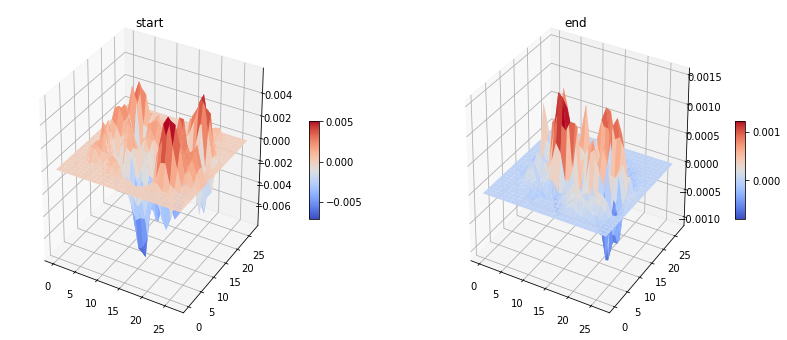

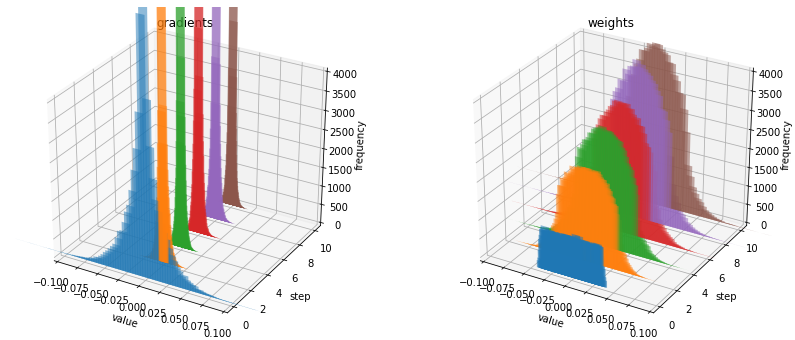

activation:  Mish
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.305696 |  ACC: 0.179688
[0201/0936]	 Loss: 0.711360 |  ACC: 0.878481
[0401/0936]	 Loss: 0.567313 |  ACC: 0.908349
[0601/0936]	 Loss: 0.485038 |  ACC: 0.920447
[0801/0936]	 Loss: 0.426217 |  ACC: 0.928402
[0936/0936]	 Loss: 0.395386 |  ACC: 0.932481
validation:	Loss: 0.150640 | ACC: 0.969700
time: 0:14



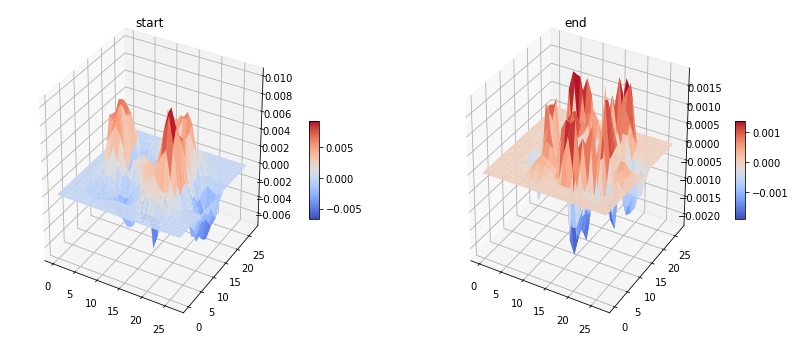

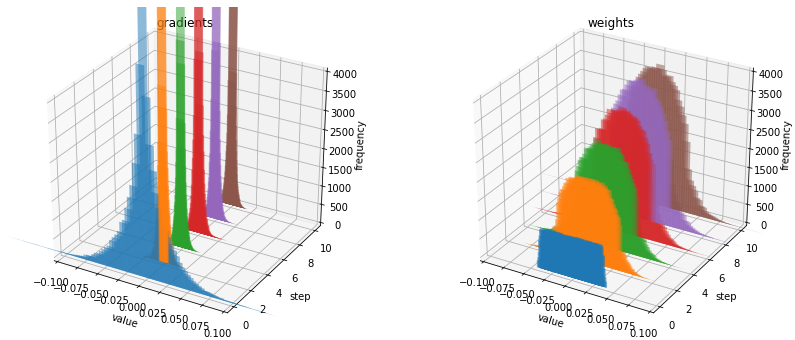

activation:  Sigmoid
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.289199 |  ACC: 0.109375
[0201/0936]	 Loss: 2.001217 |  ACC: 0.706528
[0401/0936]	 Loss: 1.961056 |  ACC: 0.778335
[0601/0936]	 Loss: 1.938336 |  ACC: 0.804817
[0801/0936]	 Loss: 1.919227 |  ACC: 0.823274
[0936/0936]	 Loss: 1.907013 |  ACC: 0.831644
validation:	Loss: 1.818108 | ACC: 0.899000
time: 0:14



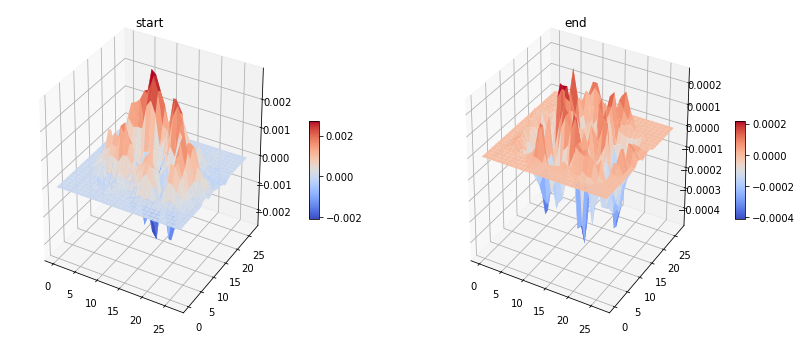

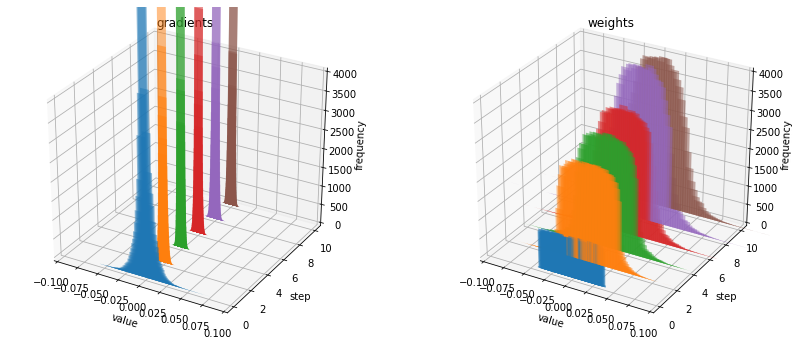

activation:  Tanh
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.397166 |  ACC: 0.140625
[0201/0936]	 Loss: 1.652710 |  ACC: 0.676207
[0401/0936]	 Loss: 1.538718 |  ACC: 0.763254
[0601/0936]	 Loss: 1.470735 |  ACC: 0.800898
[0801/0936]	 Loss: 1.415854 |  ACC: 0.824540
[0936/0936]	 Loss: 1.384317 |  ACC: 0.835729
validation:	Loss: 1.145474 | ACC: 0.929800
time: 0:14



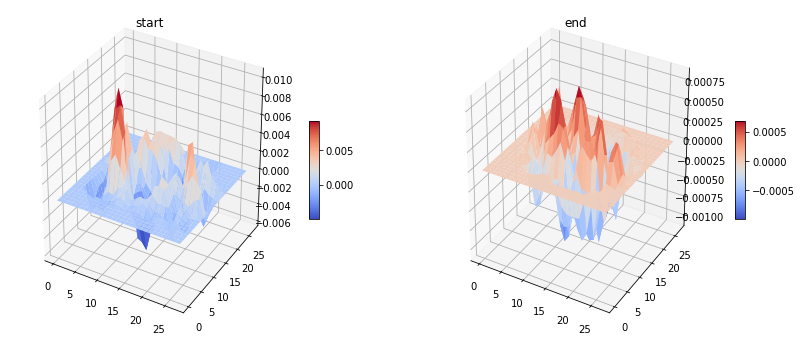

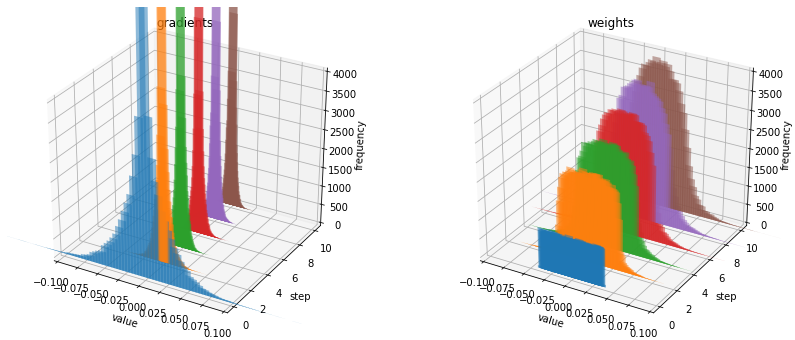

activation:  ReLU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.515588 |  ACC: 0.054688
[0201/0936]	 Loss: 1.252799 |  ACC: 0.699722
[0401/0936]	 Loss: 0.985522 |  ACC: 0.799013
[0601/0936]	 Loss: 0.843319 |  ACC: 0.841388
[0801/0936]	 Loss: 0.750137 |  ACC: 0.864674
[0936/0936]	 Loss: 0.700722 |  ACC: 0.876284
validation:	Loss: 0.332244 | ACC: 0.957400
time: 0:14



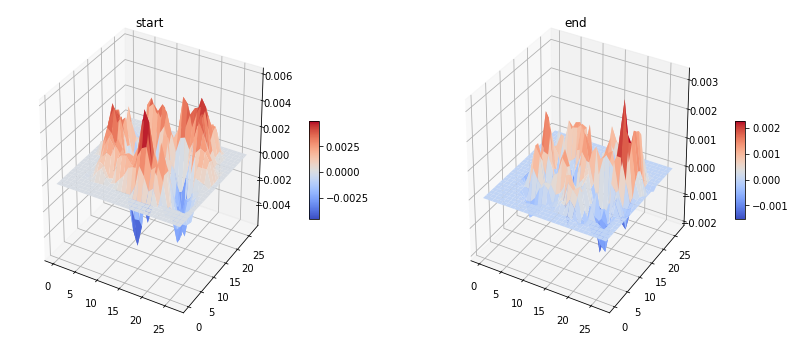

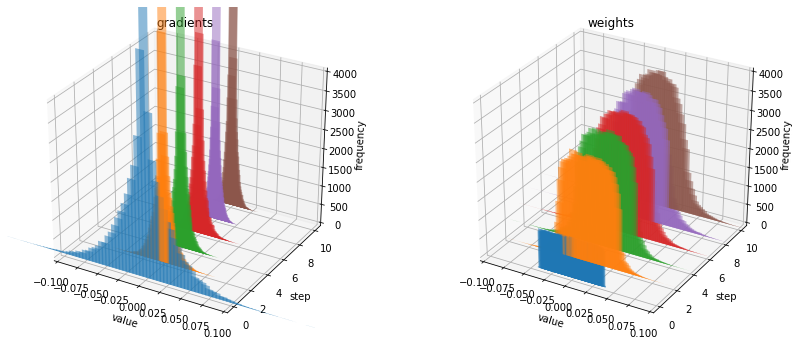

activation:  LeakyReLU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.541830 |  ACC: 0.085938
[0201/0936]	 Loss: 1.223476 |  ACC: 0.711943
[0401/0936]	 Loss: 0.971687 |  ACC: 0.805465
[0601/0936]	 Loss: 0.842518 |  ACC: 0.843620
[0801/0936]	 Loss: 0.754584 |  ACC: 0.866623
[0936/0936]	 Loss: 0.708169 |  ACC: 0.877168
validation:	Loss: 0.327312 | ACC: 0.960200
time: 0:15



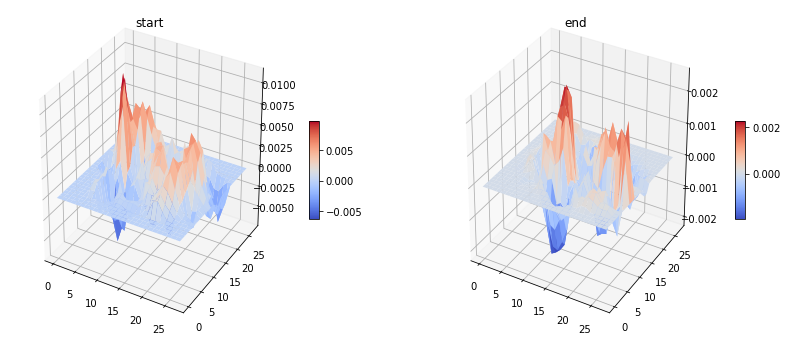

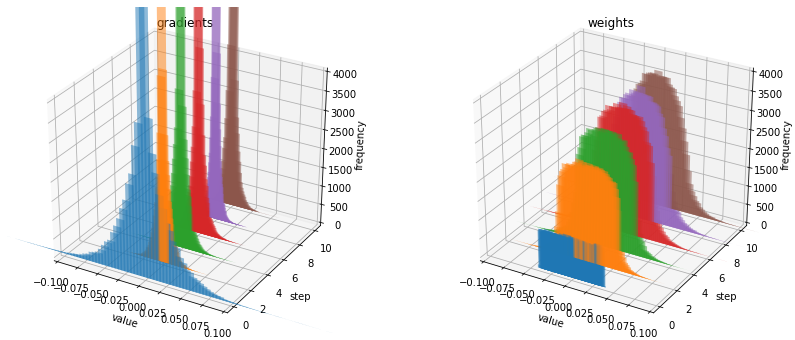

activation:  ReLU6
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.451960 |  ACC: 0.109375
[0201/0936]	 Loss: 1.230723 |  ACC: 0.708926
[0401/0936]	 Loss: 0.978573 |  ACC: 0.803871
[0601/0936]	 Loss: 0.846675 |  ACC: 0.843542
[0801/0936]	 Loss: 0.757221 |  ACC: 0.866895
[0936/0936]	 Loss: 0.708476 |  ACC: 0.877968
validation:	Loss: 0.317885 | ACC: 0.962800
time: 0:14



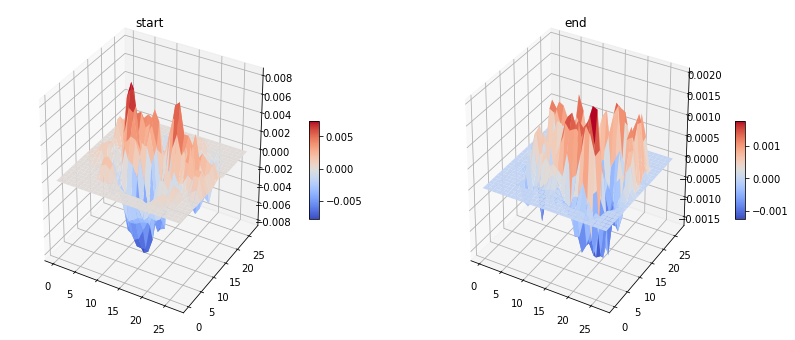

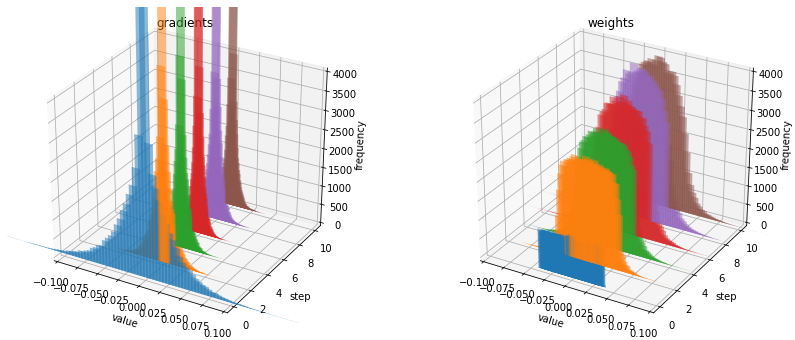

activation:  ELU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.670940 |  ACC: 0.117188
[0201/0936]	 Loss: 1.188841 |  ACC: 0.708385
[0401/0936]	 Loss: 0.959268 |  ACC: 0.793144
[0601/0936]	 Loss: 0.834454 |  ACC: 0.832408
[0801/0936]	 Loss: 0.752897 |  ACC: 0.854797
[0936/0936]	 Loss: 0.707021 |  ACC: 0.866662
validation:	Loss: 0.359312 | ACC: 0.942500
time: 0:14



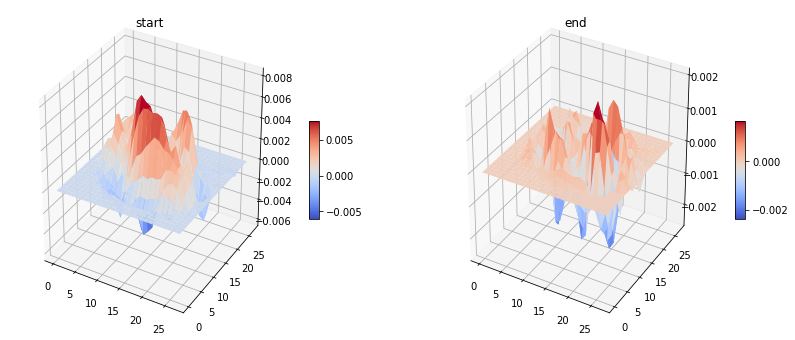

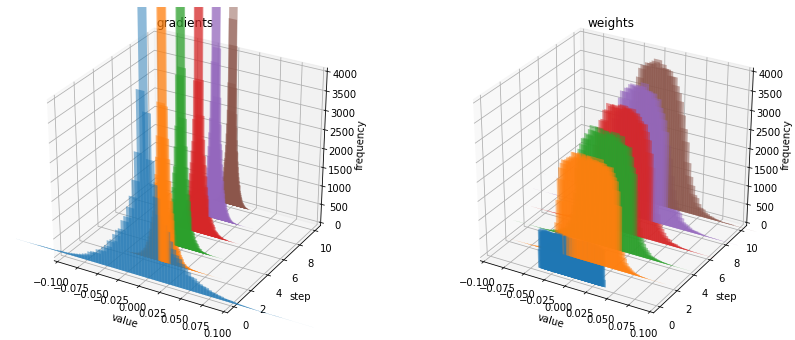

activation:  SELU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.793992 |  ACC: 0.093750
[0201/0936]	 Loss: 1.126321 |  ACC: 0.715424
[0401/0936]	 Loss: 0.928511 |  ACC: 0.789646
[0601/0936]	 Loss: 0.825299 |  ACC: 0.821948
[0801/0936]	 Loss: 0.748206 |  ACC: 0.844003
[0936/0936]	 Loss: 0.707825 |  ACC: 0.854339
validation:	Loss: 0.380232 | ACC: 0.932900
time: 0:14



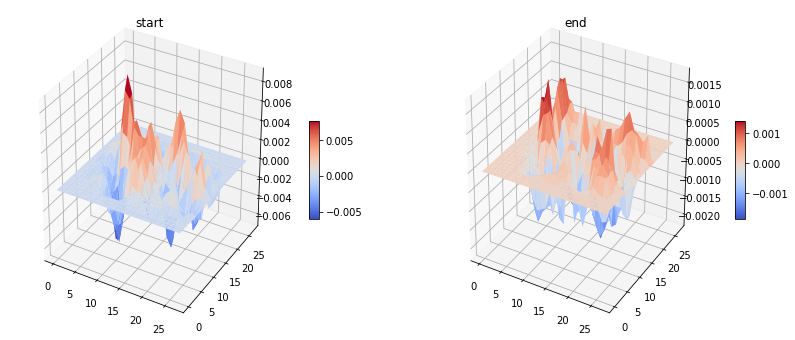

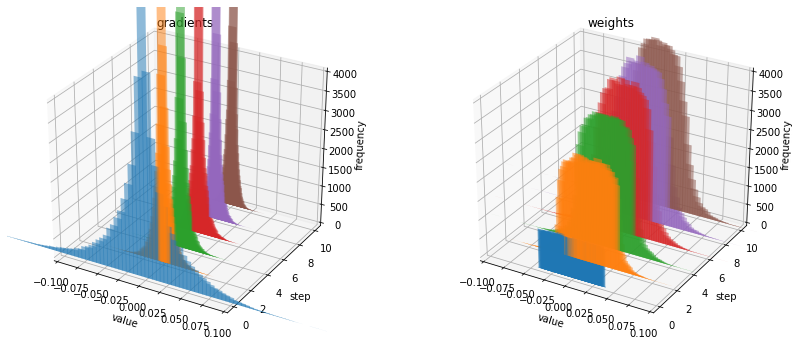

activation:  GELU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.548183 |  ACC: 0.093750
[0201/0936]	 Loss: 1.212067 |  ACC: 0.709932
[0401/0936]	 Loss: 0.952880 |  ACC: 0.806592
[0601/0936]	 Loss: 0.819486 |  ACC: 0.847825
[0801/0936]	 Loss: 0.729964 |  ACC: 0.870811
[0936/0936]	 Loss: 0.683591 |  ACC: 0.881604
validation:	Loss: 0.301028 | ACC: 0.961300
time: 0:14



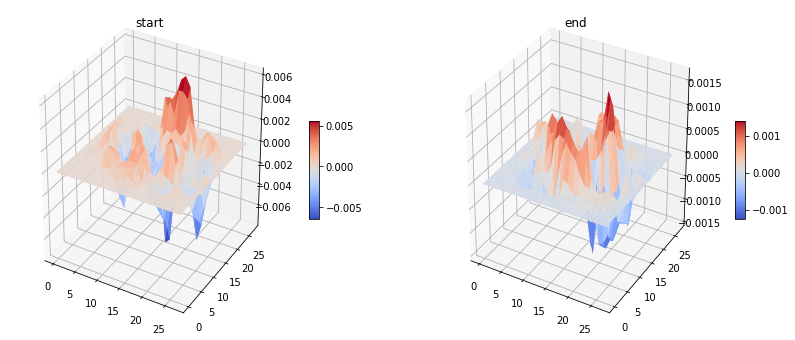

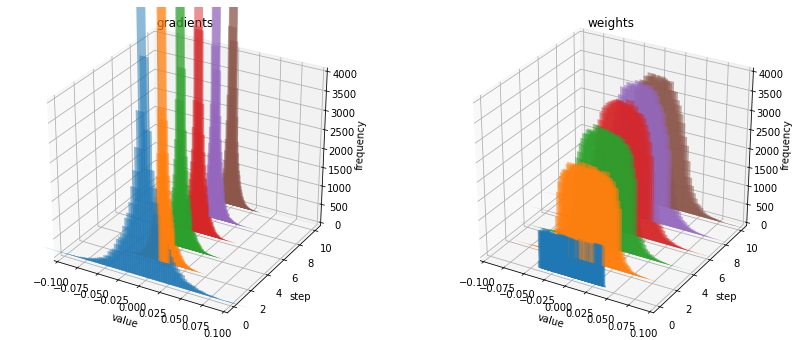

activation:  SiLU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.309809 |  ACC: 0.148438
[0201/0936]	 Loss: 1.203061 |  ACC: 0.724010
[0401/0936]	 Loss: 0.963973 |  ACC: 0.812811
[0601/0936]	 Loss: 0.832783 |  ACC: 0.851562
[0801/0936]	 Loss: 0.743989 |  ACC: 0.873266
[0936/0936]	 Loss: 0.697146 |  ACC: 0.883238
validation:	Loss: 0.306273 | ACC: 0.962100
time: 0:14



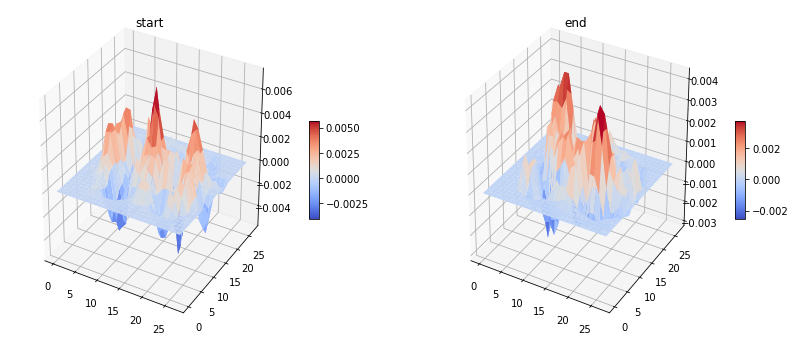

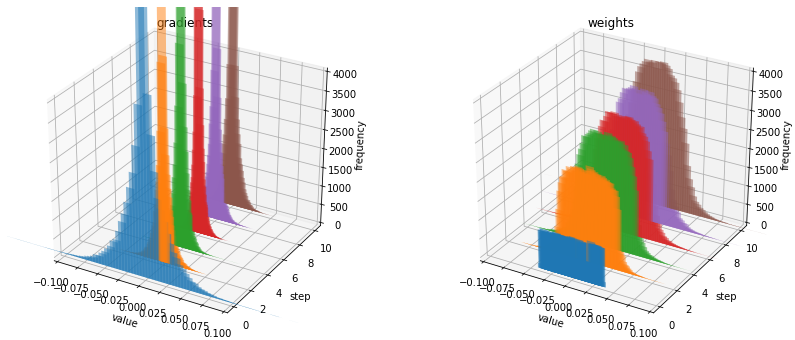

activation:  Hardswish
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.578225 |  ACC: 0.070312
[0201/0936]	 Loss: 1.255604 |  ACC: 0.705832
[0401/0936]	 Loss: 0.990487 |  ACC: 0.804338
[0601/0936]	 Loss: 0.858554 |  ACC: 0.844425
[0801/0936]	 Loss: 0.768754 |  ACC: 0.866759
[0936/0936]	 Loss: 0.721041 |  ACC: 0.877101
validation:	Loss: 0.308807 | ACC: 0.958800
time: 0:14



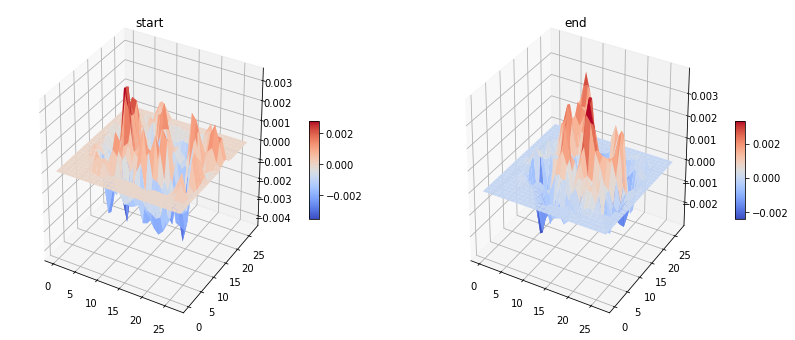

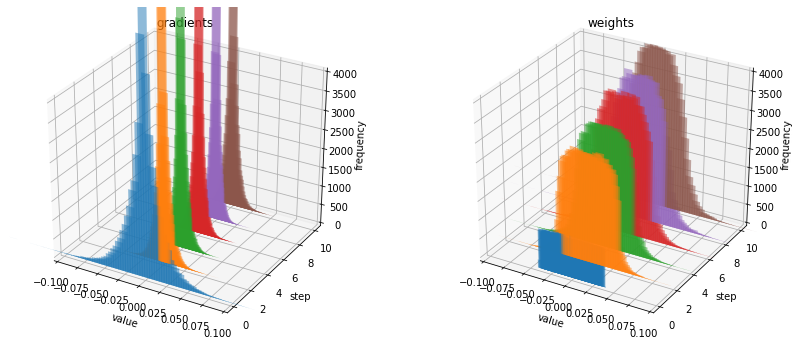

activation:  Mish
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.660091 |  ACC: 0.046875
[0201/0936]	 Loss: 1.176406 |  ACC: 0.723855
[0401/0936]	 Loss: 0.929703 |  ACC: 0.814288
[0601/0936]	 Loss: 0.804159 |  ACC: 0.851692
[0801/0936]	 Loss: 0.720161 |  ACC: 0.872798
[0936/0936]	 Loss: 0.674988 |  ACC: 0.883171
validation:	Loss: 0.306895 | ACC: 0.958400
time: 0:14



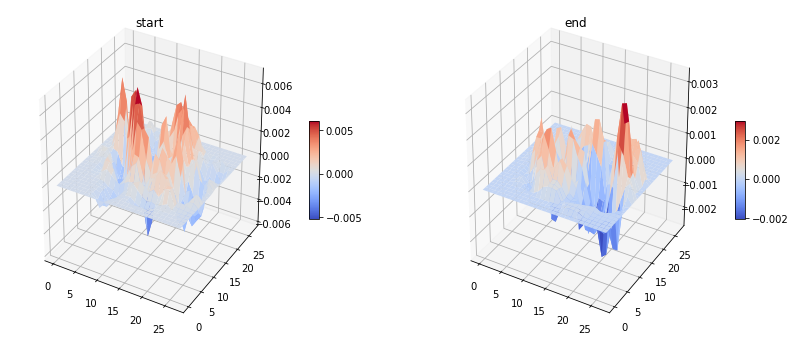

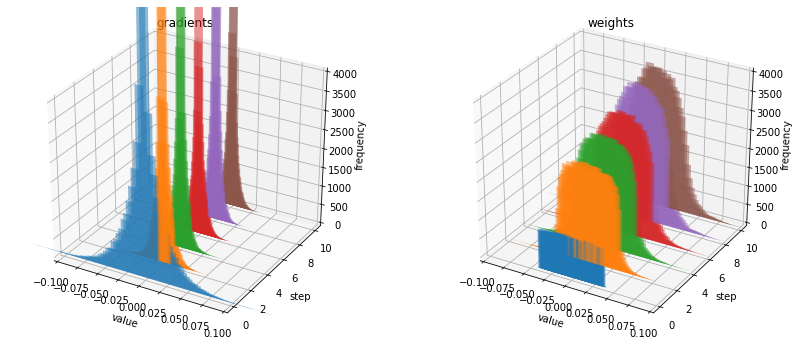

,optimizer,activation,time (ms),loss,accuracy
0,SGD,Sigmoid,0.6177,1.864387,0.8899
0,SGD,Tanh,0.6062,1.123766,0.9226
0,SGD,ReLU,0.6124,0.197167,0.9646
0,SGD,LeakyReLU,0.6133,0.204616,0.9623
0,SGD,ReLU6,0.6214,0.209838,0.9598
...,...,...,...,...,...
0,AdaMod,SELU,0.6070,0.380232,0.9329
0,AdaMod,GELU,0.5993,0.301028,0.9613
0,AdaMod,SiLU,0.6046,0.306273,0.9621
0,AdaMod,Hardswish,0.5966,0.308807,0.9588


In [9]:
activations = [
    nn.Sigmoid,
    nn.Tanh,
    
    nn.ReLU,
    nn.LeakyReLU,
    nn.ReLU6,
    nn.ELU,
    nn.SELU,
    nn.GELU,
    
    nn.SiLU,
    nn.Hardswish,
    nn.Mish,
]
optimizers = [
    optim.SGD,
    optim.Adam,
    optim.AdamW,
    torch_optimizer.Ranger,
    torch_optimizer.AdaBelief,
    torch_optimizer.AdaBound,
    torch_optimizer.AdaMod,
]

recoder = pd.DataFrame(columns=['optimizer', 'activation', 'time (ms)', 'loss', 'accuracy'])

for opt in optimizers:
    for act in activations:
        recoder = test_act_opt(recoder, act, opt)
        
recoder

In [10]:
recoder = recoder.sort_values('loss')
display(recoder.head(35))
display(recoder.tail(35))

,optimizer,activation,time (ms),loss,accuracy
0,AdaBound,LeakyReLU,0.5980,0.139681,0.9716
0,AdaBound,GELU,0.6362,0.143992,0.9698
0,AdaBound,ReLU6,0.6124,0.144066,0.9723
0,AdaBound,SiLU,0.6328,0.144727,0.9721
0,AdaBelief,GELU,0.6176,0.145852,0.9707
0,AdaBelief,ReLU6,0.6087,0.146720,0.9713
0,AdaBound,ReLU,0.6093,0.146892,0.9684
0,AdaBelief,ReLU,0.6112,0.149841,0.9718
0,AdaBound,Mish,0.6556,0.150640,0.9697
0,AdaBelief,LeakyReLU,0.6018,0.152996,0.9713


,optimizer,activation,time (ms),loss,accuracy
0,AdamW,ELU,0.6044,0.230778,0.9589
0,SGD,ELU,0.6129,0.246859,0.9537
0,AdaMod,GELU,0.5993,0.301028,0.9613
0,AdaMod,SiLU,0.6046,0.306273,0.9621
0,AdaMod,Mish,0.6132,0.306895,0.9584
0,AdaMod,Hardswish,0.5966,0.308807,0.9588
0,SGD,SELU,0.6107,0.310888,0.9360
0,AdaMod,ReLU6,0.6258,0.317885,0.9628
0,AdaMod,LeakyReLU,0.6066,0.327312,0.9602
0,AdaMod,ReLU,0.6426,0.332244,0.9574


In [11]:
recoder = recoder.sort_values('accuracy', ascending=False)
display(recoder.head(35))
display(recoder.tail(35))

,optimizer,activation,time (ms),loss,accuracy
0,AdaBound,ReLU6,0.6124,0.144066,0.9723
0,AdaBound,SiLU,0.6328,0.144727,0.9721
0,AdaBelief,ReLU,0.6112,0.149841,0.9718
0,AdaBound,LeakyReLU,0.5980,0.139681,0.9716
0,AdamW,SiLU,0.6283,0.184358,0.9714
0,AdaBelief,ReLU6,0.6087,0.146720,0.9713
0,AdaBelief,LeakyReLU,0.6018,0.152996,0.9713
0,AdamW,ReLU,0.6075,0.181319,0.9712
0,Adam,LeakyReLU,0.5986,0.188907,0.9710
0,Adam,GELU,0.6069,0.174995,0.9708


,optimizer,activation,time (ms),loss,accuracy
0,SGD,ReLU6,0.6214,0.209838,0.9598
0,Ranger,Mish,0.5970,0.397484,0.9595
0,AdamW,ELU,0.6044,0.230778,0.9589
0,Ranger,Hardswish,0.6043,0.404786,0.9588
0,AdaMod,Hardswish,0.5966,0.308807,0.9588
0,AdaMod,Mish,0.6132,0.306895,0.9584
0,Ranger,LeakyReLU,0.6144,0.402292,0.9581
0,Ranger,ReLU6,0.6179,0.410084,0.9577
0,AdaMod,ReLU,0.6426,0.332244,0.9574
0,Adam,SELU,0.6111,0.227035,0.9564


activation:  Sigmoid
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.376106 |  ACC: 0.062500
[0201/0936]	 Loss: 1.998849 |  ACC: 0.717512
[0401/0936]	 Loss: 1.966156 |  ACC: 0.775381
[0601/0936]	 Loss: 1.947937 |  ACC: 0.799860
[0801/0936]	 Loss: 1.935159 |  ACC: 0.811662
[0936/0936]	 Loss: 1.927707 |  ACC: 0.818303
validation:	Loss: 1.869808 | ACC: 0.880100
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 1.877294 |  ACC: 0.859375
[0201/0936]	 Loss: 1.871837 |  ACC: 0.857287
[0401/0936]	 Loss: 1.865355 |  ACC: 0.860580
[0601/0936]	 Loss: 1.859330 |  ACC: 0.860387
[0801/0936]	 Loss: 1.853720 |  ACC: 0.862142
[0936/0936]	 Loss: 1.849974 |  ACC: 0.862777
validation:	Loss: 1.810387 | ACC: 0.894700
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 1.815917 |  ACC: 0.898438
[0201/0936]	 Loss: 1.818573 |  ACC: 0.871983
[0401/0936]	 Loss: 1.814089 |  ACC: 0.871852
[0601/0936]	 Loss: 1.808320 |  ACC: 0.875908
[0801/0936]	 Loss: 1.803459 |  ACC: 0.876968
[0936/0936]	 Loss: 1.800418 |  ACC: 0

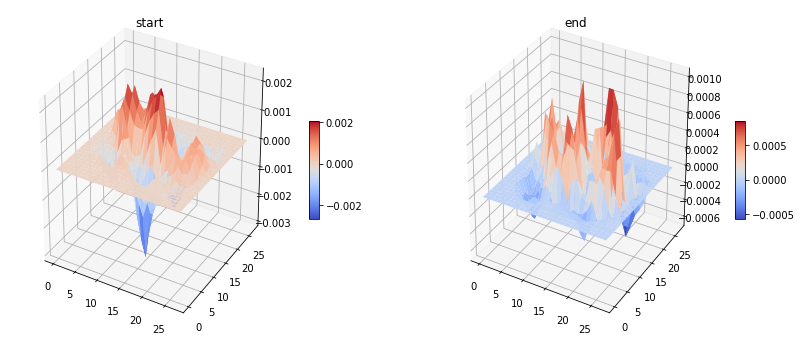

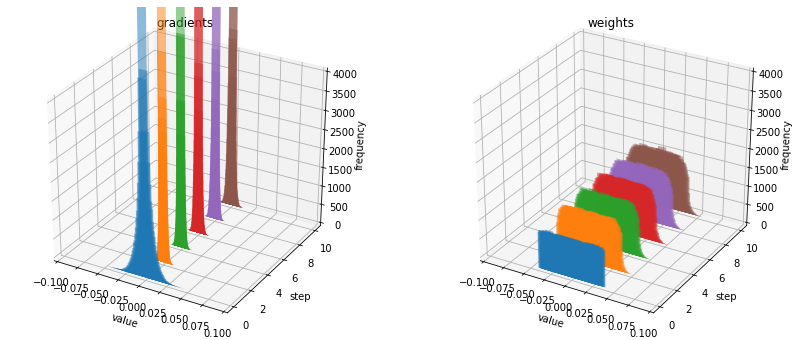

activation:  Tanh
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.478664 |  ACC: 0.117188
[0201/0936]	 Loss: 1.545711 |  ACC: 0.769261
[0401/0936]	 Loss: 1.461552 |  ACC: 0.813122
[0601/0936]	 Loss: 1.405696 |  ACC: 0.831629
[0801/0936]	 Loss: 1.360051 |  ACC: 0.844880
[0936/0936]	 Loss: 1.333722 |  ACC: 0.851721
validation:	Loss: 1.126536 | ACC: 0.921900
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 1.118399 |  ACC: 0.945312
[0201/0936]	 Loss: 1.140020 |  ACC: 0.905012
[0401/0936]	 Loss: 1.122326 |  ACC: 0.908465
[0601/0936]	 Loss: 1.106120 |  ACC: 0.913206
[0801/0936]	 Loss: 1.092592 |  ACC: 0.916615
[0936/0936]	 Loss: 1.085512 |  ACC: 0.917573
validation:	Loss: 0.999144 | ACC: 0.944900
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 1.018202 |  ACC: 0.937500
[0201/0936]	 Loss: 1.019573 |  ACC: 0.935798
[0401/0936]	 Loss: 1.014173 |  ACC: 0.936489
[0601/0936]	 Loss: 1.008508 |  ACC: 0.937396
[0801/0936]	 Loss: 1.003946 |  ACC: 0.938240
[0936/0936]	 Loss: 1.000819 |  ACC: 0.93

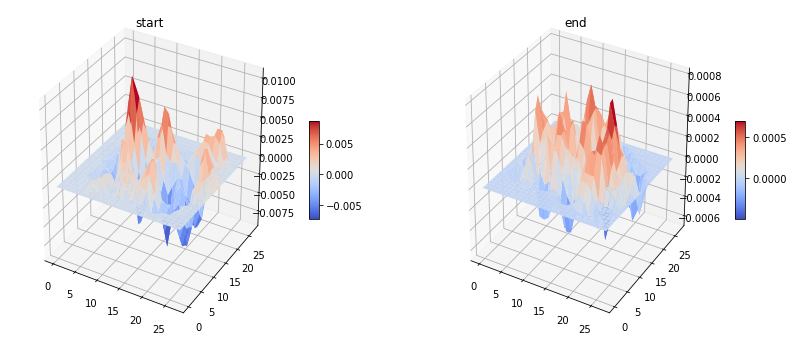

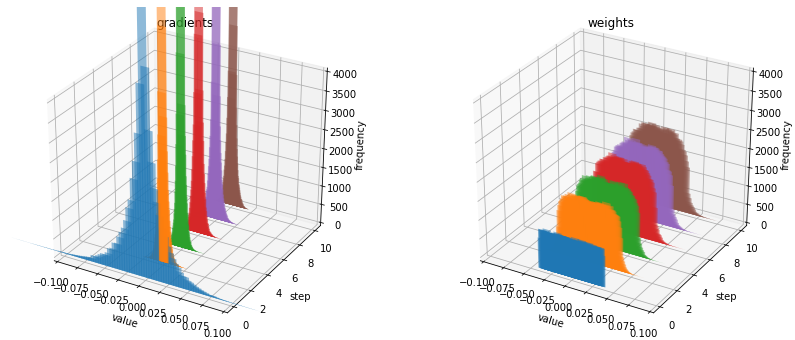

activation:  ReLU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.339164 |  ACC: 0.125000
[0201/0936]	 Loss: 0.907787 |  ACC: 0.809329
[0401/0936]	 Loss: 0.702716 |  ACC: 0.861785
[0601/0936]	 Loss: 0.598012 |  ACC: 0.884577
[0801/0936]	 Loss: 0.527439 |  ACC: 0.898808
[0936/0936]	 Loss: 0.494052 |  ACC: 0.905066
validation:	Loss: 0.202515 | ACC: 0.963000
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.295429 |  ACC: 0.929688
[0201/0936]	 Loss: 0.237414 |  ACC: 0.956838
[0401/0936]	 Loss: 0.233591 |  ACC: 0.954874
[0601/0936]	 Loss: 0.227133 |  ACC: 0.954734
[0801/0936]	 Loss: 0.219497 |  ACC: 0.955755
[0936/0936]	 Loss: 0.214304 |  ACC: 0.956393
validation:	Loss: 0.133365 | ACC: 0.971800
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.216272 |  ACC: 0.960938
[0201/0936]	 Loss: 0.164943 |  ACC: 0.965424
[0401/0936]	 Loss: 0.163956 |  ACC: 0.964513
[0601/0936]	 Loss: 0.159957 |  ACC: 0.965376
[0801/0936]	 Loss: 0.157472 |  ACC: 0.966412
[0936/0936]	 Loss: 0.157320 |  ACC: 0.96

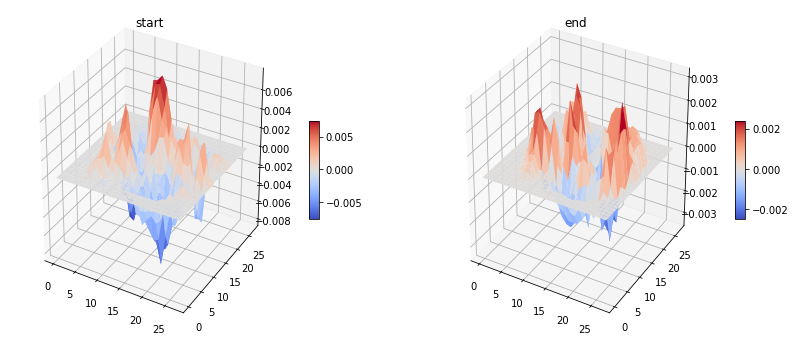

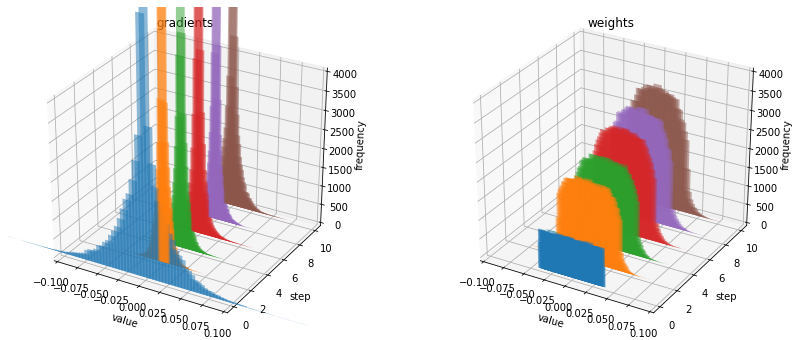

activation:  LeakyReLU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.474430 |  ACC: 0.109375
[0201/0936]	 Loss: 0.905047 |  ACC: 0.811494
[0401/0936]	 Loss: 0.706109 |  ACC: 0.862523
[0601/0936]	 Loss: 0.597410 |  ACC: 0.886135
[0801/0936]	 Loss: 0.528882 |  ACC: 0.899567
[0936/0936]	 Loss: 0.494044 |  ACC: 0.905733
validation:	Loss: 0.195338 | ACC: 0.964600
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.215016 |  ACC: 0.968750
[0201/0936]	 Loss: 0.256226 |  ACC: 0.950572
[0401/0936]	 Loss: 0.239244 |  ACC: 0.953436
[0601/0936]	 Loss: 0.228914 |  ACC: 0.954345
[0801/0936]	 Loss: 0.222562 |  ACC: 0.954995
[0936/0936]	 Loss: 0.217694 |  ACC: 0.955626
validation:	Loss: 0.131444 | ACC: 0.973300
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.110942 |  ACC: 0.976562
[0201/0936]	 Loss: 0.166241 |  ACC: 0.966507
[0401/0936]	 Loss: 0.166640 |  ACC: 0.964863
[0601/0936]	 Loss: 0.163397 |  ACC: 0.964909
[0801/0936]	 Loss: 0.159579 |  ACC: 0.965555
[0936/0936]	 Loss: 0.158448 |  ACC:

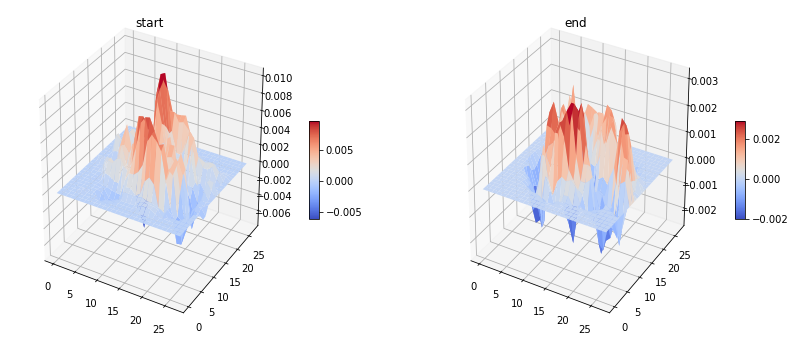

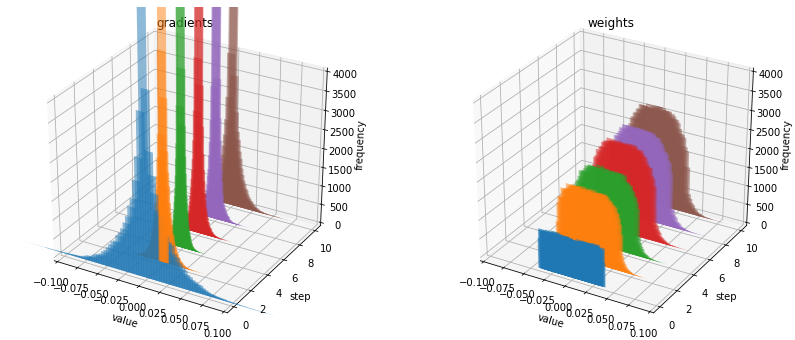

activation:  ReLU6
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.581007 |  ACC: 0.078125
[0201/0936]	 Loss: 0.927315 |  ACC: 0.802522
[0401/0936]	 Loss: 0.714591 |  ACC: 0.859919
[0601/0936]	 Loss: 0.608157 |  ACC: 0.882553
[0801/0936]	 Loss: 0.537806 |  ACC: 0.896392
[0936/0936]	 Loss: 0.501854 |  ACC: 0.902982
validation:	Loss: 0.208619 | ACC: 0.960700
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.244384 |  ACC: 0.953125
[0201/0936]	 Loss: 0.260834 |  ACC: 0.949103
[0401/0936]	 Loss: 0.245580 |  ACC: 0.952114
[0601/0936]	 Loss: 0.235461 |  ACC: 0.953540
[0801/0936]	 Loss: 0.227302 |  ACC: 0.954684
[0936/0936]	 Loss: 0.224721 |  ACC: 0.954826
validation:	Loss: 0.140207 | ACC: 0.971200
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.151368 |  ACC: 0.984375
[0201/0936]	 Loss: 0.171697 |  ACC: 0.967126
[0401/0936]	 Loss: 0.172915 |  ACC: 0.966224
[0601/0936]	 Loss: 0.171203 |  ACC: 0.965817
[0801/0936]	 Loss: 0.168344 |  ACC: 0.966276
[0936/0936]	 Loss: 0.167541 |  ACC: 0.9

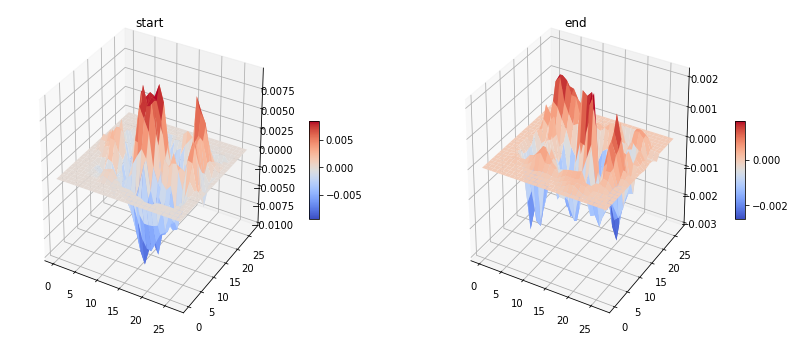

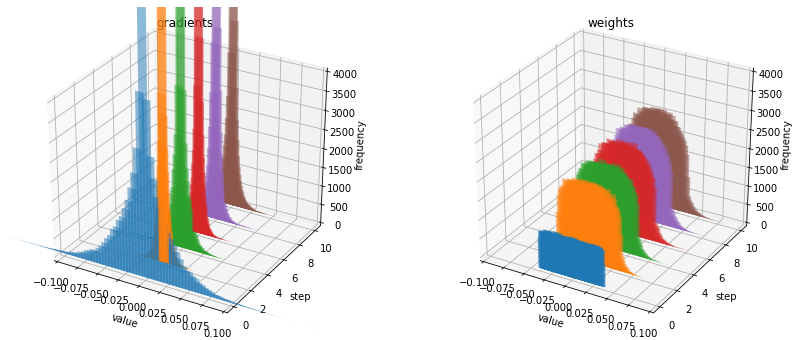

activation:  SELU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.723869 |  ACC: 0.125000
[0201/0936]	 Loss: 0.864467 |  ACC: 0.803605
[0401/0936]	 Loss: 0.730085 |  ACC: 0.837803
[0601/0936]	 Loss: 0.650998 |  ACC: 0.855871
[0801/0936]	 Loss: 0.592471 |  ACC: 0.868941
[0936/0936]	 Loss: 0.558605 |  ACC: 0.876217
validation:	Loss: 0.297700 | ACC: 0.934500
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.287634 |  ACC: 0.945312
[0201/0936]	 Loss: 0.323670 |  ACC: 0.926284
[0401/0936]	 Loss: 0.311824 |  ACC: 0.927006
[0601/0936]	 Loss: 0.297490 |  ACC: 0.930259
[0801/0936]	 Loss: 0.286630 |  ACC: 0.932337
[0936/0936]	 Loss: 0.280887 |  ACC: 0.933364
validation:	Loss: 0.183787 | ACC: 0.955900
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.236584 |  ACC: 0.914062
[0201/0936]	 Loss: 0.223391 |  ACC: 0.947092
[0401/0936]	 Loss: 0.220604 |  ACC: 0.946362
[0601/0936]	 Loss: 0.217411 |  ACC: 0.946506
[0801/0936]	 Loss: 0.214056 |  ACC: 0.946891
[0936/0936]	 Loss: 0.211575 |  ACC: 0.94

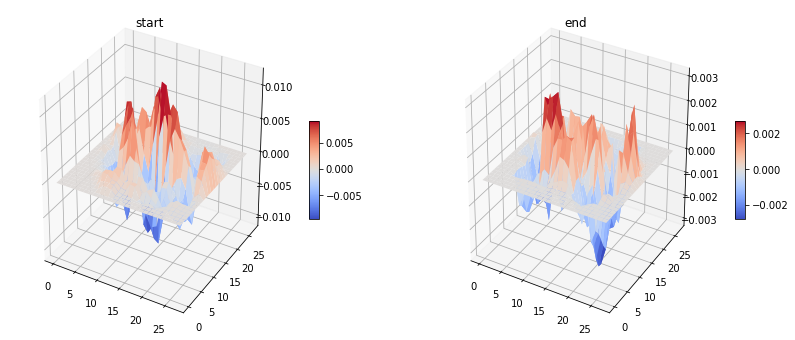

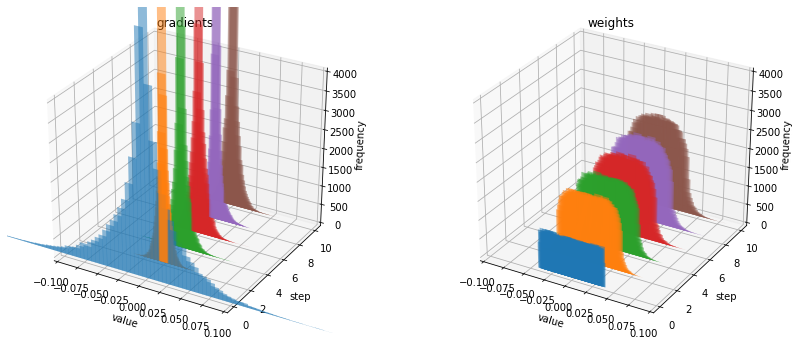

activation:  GELU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.505326 |  ACC: 0.101562
[0201/0936]	 Loss: 0.900587 |  ACC: 0.807317
[0401/0936]	 Loss: 0.696138 |  ACC: 0.860697
[0601/0936]	 Loss: 0.587766 |  ACC: 0.885045
[0801/0936]	 Loss: 0.516460 |  ACC: 0.900210
[0936/0936]	 Loss: 0.481563 |  ACC: 0.907017
validation:	Loss: 0.190002 | ACC: 0.965400
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.255843 |  ACC: 0.968750
[0201/0936]	 Loss: 0.240959 |  ACC: 0.953821
[0401/0936]	 Loss: 0.226202 |  ACC: 0.955690
[0601/0936]	 Loss: 0.219331 |  ACC: 0.955928
[0801/0936]	 Loss: 0.213330 |  ACC: 0.956749
[0936/0936]	 Loss: 0.209294 |  ACC: 0.957144
validation:	Loss: 0.129649 | ACC: 0.973100
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.201272 |  ACC: 0.960938
[0201/0936]	 Loss: 0.156533 |  ACC: 0.968518
[0401/0936]	 Loss: 0.156323 |  ACC: 0.967040
[0601/0936]	 Loss: 0.153459 |  ACC: 0.967556
[0801/0936]	 Loss: 0.151418 |  ACC: 0.967873
[0936/0936]	 Loss: 0.149817 |  ACC: 0.96

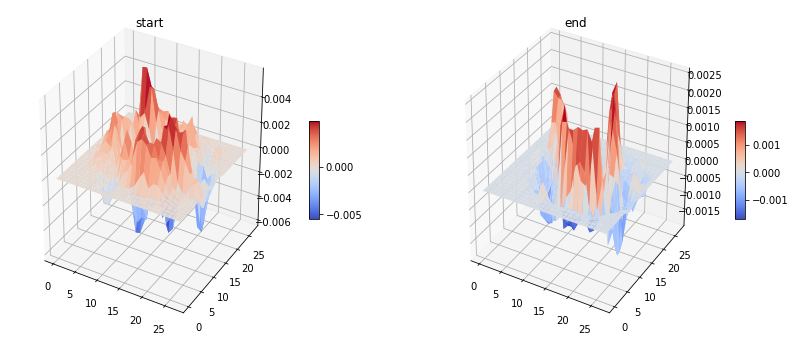

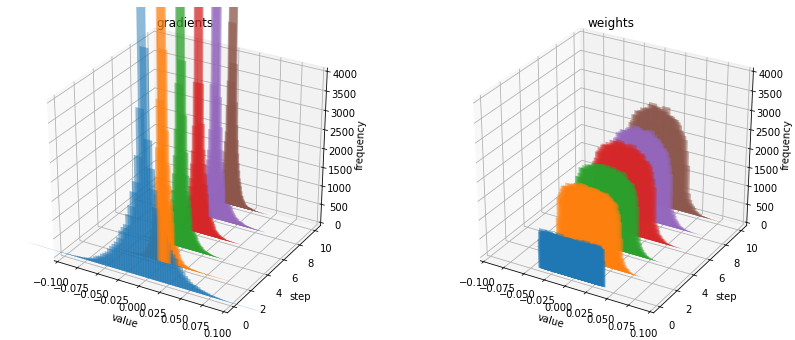

activation:  SiLU
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.441905 |  ACC: 0.109375
[0201/0936]	 Loss: 0.926326 |  ACC: 0.808942
[0401/0936]	 Loss: 0.716637 |  ACC: 0.859608
[0601/0936]	 Loss: 0.604573 |  ACC: 0.883825
[0801/0936]	 Loss: 0.531543 |  ACC: 0.897600
[0936/0936]	 Loss: 0.494234 |  ACC: 0.904783
validation:	Loss: 0.196066 | ACC: 0.964200
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.264954 |  ACC: 0.945312
[0201/0936]	 Loss: 0.238138 |  ACC: 0.954749
[0401/0936]	 Loss: 0.235276 |  ACC: 0.953786
[0601/0936]	 Loss: 0.226162 |  ACC: 0.954475
[0801/0936]	 Loss: 0.218678 |  ACC: 0.955229
[0936/0936]	 Loss: 0.214898 |  ACC: 0.955693
validation:	Loss: 0.132225 | ACC: 0.972200
time: 0:12

Train Epoch: 002
[0001/0936]	 Loss: 0.108386 |  ACC: 0.984375
[0201/0936]	 Loss: 0.172561 |  ACC: 0.962407
[0401/0936]	 Loss: 0.165822 |  ACC: 0.964241
[0601/0936]	 Loss: 0.162424 |  ACC: 0.964857
[0801/0936]	 Loss: 0.160234 |  ACC: 0.964639
[0936/0936]	 Loss: 0.158710 |  ACC: 0.96

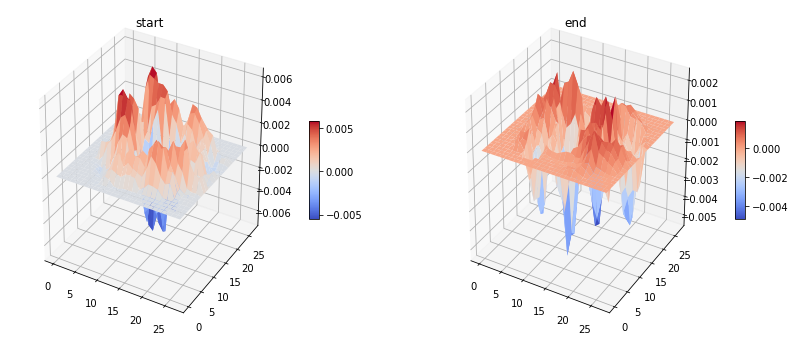

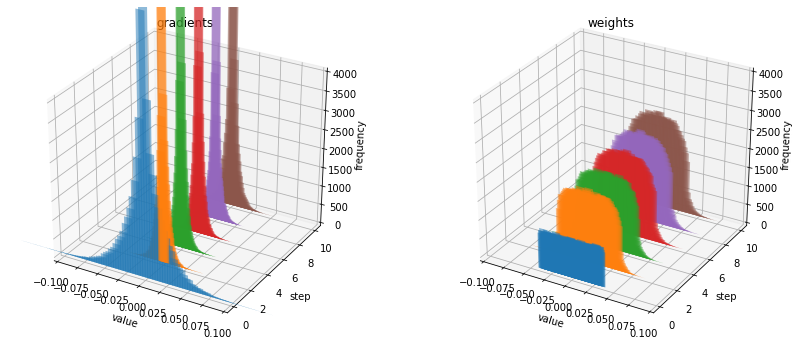

activation:  Hardswish
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.353161 |  ACC: 0.117188
[0201/0936]	 Loss: 0.936810 |  ACC: 0.803914
[0401/0936]	 Loss: 0.720487 |  ACC: 0.858675
[0601/0936]	 Loss: 0.605688 |  ACC: 0.883150
[0801/0936]	 Loss: 0.532368 |  ACC: 0.896820
[0936/0936]	 Loss: 0.497336 |  ACC: 0.903248
validation:	Loss: 0.201089 | ACC: 0.963400
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.245357 |  ACC: 0.929688
[0201/0936]	 Loss: 0.243013 |  ACC: 0.951733
[0401/0936]	 Loss: 0.232824 |  ACC: 0.953086
[0601/0936]	 Loss: 0.227811 |  ACC: 0.953592
[0801/0936]	 Loss: 0.220004 |  ACC: 0.954664
[0936/0936]	 Loss: 0.217550 |  ACC: 0.954376
validation:	Loss: 0.134774 | ACC: 0.971500
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.124140 |  ACC: 0.968750
[0201/0936]	 Loss: 0.168683 |  ACC: 0.966043
[0401/0936]	 Loss: 0.166632 |  ACC: 0.965330
[0601/0936]	 Loss: 0.166986 |  ACC: 0.964208
[0801/0936]	 Loss: 0.166660 |  ACC: 0.963392
[0936/0936]	 Loss: 0.163549 |  ACC:

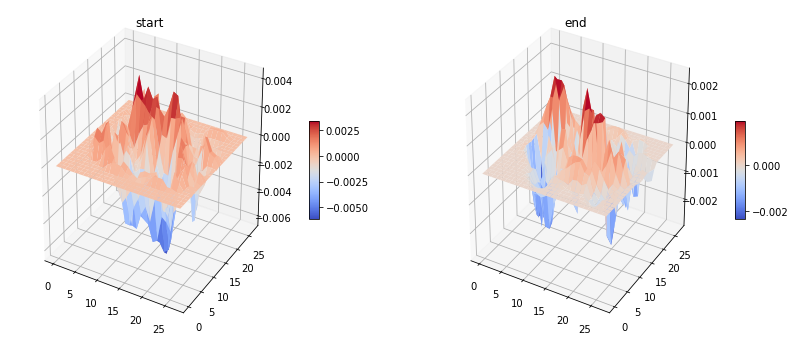

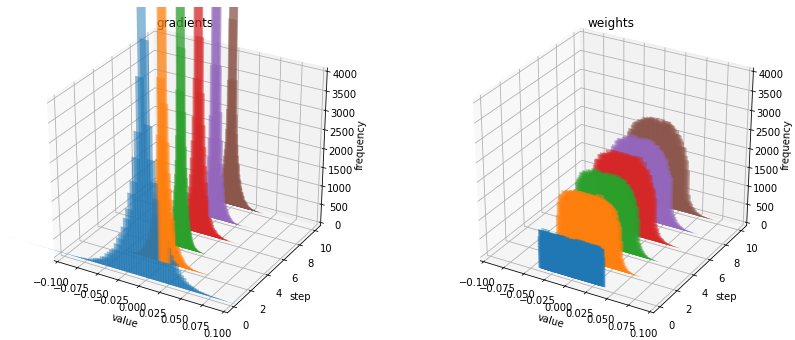

activation:  Mish
optimizer:  SGD
Train Epoch: 000
[0001/0936]	 Loss: 2.406403 |  ACC: 0.179688
[0201/0936]	 Loss: 0.847501 |  ACC: 0.828357
[0401/0936]	 Loss: 0.664494 |  ACC: 0.872318
[0601/0936]	 Loss: 0.565409 |  ACC: 0.892883
[0801/0936]	 Loss: 0.503155 |  ACC: 0.904360
[0936/0936]	 Loss: 0.472267 |  ACC: 0.909668
validation:	Loss: 0.199872 | ACC: 0.966300
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.311800 |  ACC: 0.914062
[0201/0936]	 Loss: 0.241613 |  ACC: 0.952584
[0401/0936]	 Loss: 0.229479 |  ACC: 0.954641
[0601/0936]	 Loss: 0.222368 |  ACC: 0.955253
[0801/0936]	 Loss: 0.215164 |  ACC: 0.956086
[0936/0936]	 Loss: 0.211987 |  ACC: 0.956377
validation:	Loss: 0.129655 | ACC: 0.973300
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.220799 |  ACC: 0.921875
[0201/0936]	 Loss: 0.164306 |  ACC: 0.966197
[0401/0936]	 Loss: 0.164866 |  ACC: 0.964591
[0601/0936]	 Loss: 0.162586 |  ACC: 0.965324
[0801/0936]	 Loss: 0.161158 |  ACC: 0.964990
[0936/0936]	 Loss: 0.158937 |  ACC: 0.96

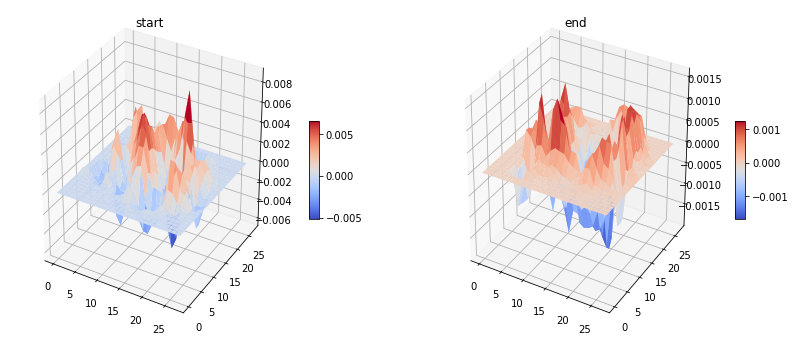

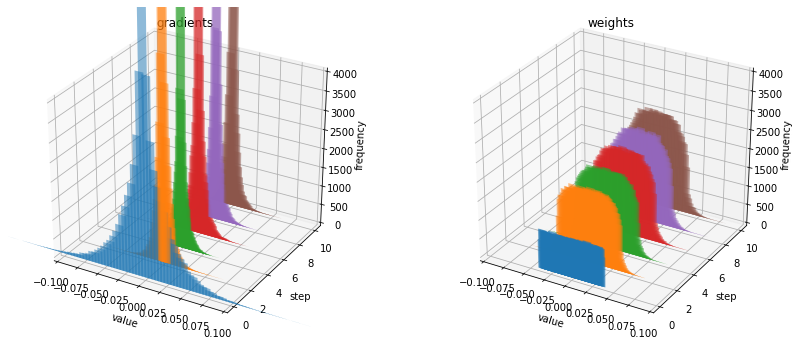

activation:  Sigmoid
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.221847 |  ACC: 0.273438
[0201/0936]	 Loss: 1.917461 |  ACC: 0.838877
[0401/0936]	 Loss: 1.884924 |  ACC: 0.855955
[0601/0936]	 Loss: 1.855995 |  ACC: 0.869238
[0801/0936]	 Loss: 1.830105 |  ACC: 0.880163
[0936/0936]	 Loss: 1.814256 |  ACC: 0.885956
validation:	Loss: 1.697302 | ACC: 0.932900
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 1.713920 |  ACC: 0.898438
[0201/0936]	 Loss: 1.692353 |  ACC: 0.929842
[0401/0936]	 Loss: 1.680188 |  ACC: 0.930698
[0601/0936]	 Loss: 1.669254 |  ACC: 0.931842
[0801/0936]	 Loss: 1.658572 |  ACC: 0.934110
[0936/0936]	 Loss: 1.652533 |  ACC: 0.935332
validation:	Loss: 1.603357 | ACC: 0.951500
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 1.619264 |  ACC: 0.937500
[0201/0936]	 Loss: 1.602475 |  ACC: 0.946782
[0401/0936]	 Loss: 1.596756 |  ACC: 0.948189
[0601/0936]	 Loss: 1.592281 |  ACC: 0.948012
[0801/0936]	 Loss: 1.588133 |  ACC: 0.948897
[0936/0936]	 Loss: 1.585141 |  ACC: 

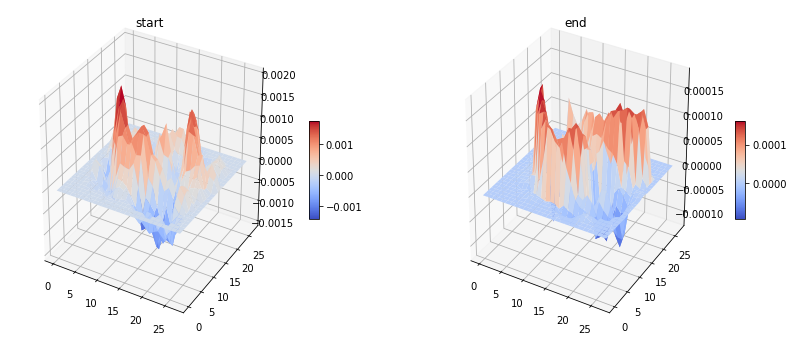

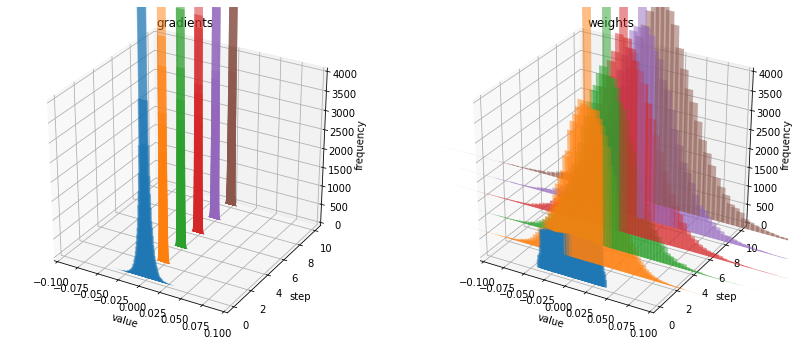

activation:  Tanh
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.344457 |  ACC: 0.210938
[0201/0936]	 Loss: 1.422405 |  ACC: 0.836711
[0401/0936]	 Loss: 1.332780 |  ACC: 0.862484
[0601/0936]	 Loss: 1.269074 |  ACC: 0.878478
[0801/0936]	 Loss: 1.220276 |  ACC: 0.890255
[0936/0936]	 Loss: 1.193219 |  ACC: 0.896111
validation:	Loss: 0.999667 | ACC: 0.943600
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.973375 |  ACC: 0.953125
[0201/0936]	 Loss: 0.998941 |  ACC: 0.938274
[0401/0936]	 Loss: 0.989321 |  ACC: 0.939910
[0601/0936]	 Loss: 0.979537 |  ACC: 0.941705
[0801/0936]	 Loss: 0.970204 |  ACC: 0.944163
[0936/0936]	 Loss: 0.965512 |  ACC: 0.944670
validation:	Loss: 0.911782 | ACC: 0.960700
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.916780 |  ACC: 0.984375
[0201/0936]	 Loss: 0.921414 |  ACC: 0.953280
[0401/0936]	 Loss: 0.917491 |  ACC: 0.954991
[0601/0936]	 Loss: 0.916133 |  ACC: 0.953566
[0801/0936]	 Loss: 0.912436 |  ACC: 0.954021
[0936/0936]	 Loss: 0.910117 |  ACC: 0.9

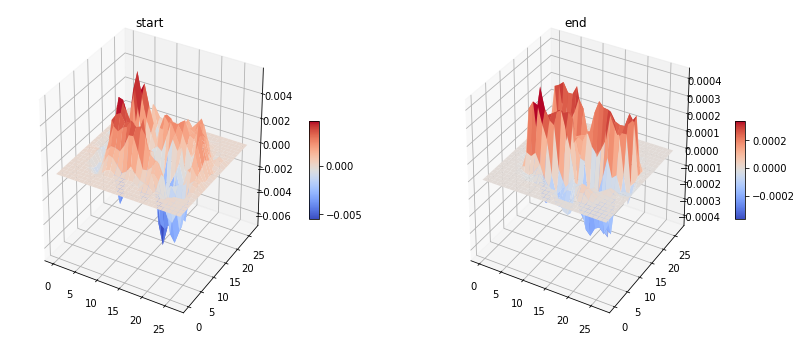

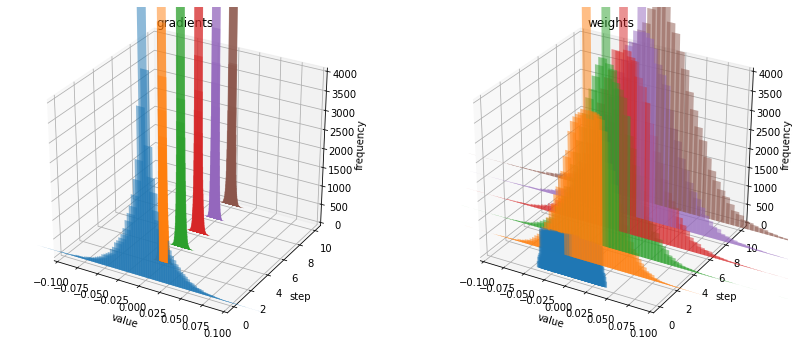

activation:  ReLU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.434196 |  ACC: 0.125000
[0201/0936]	 Loss: 0.740329 |  ACC: 0.877321
[0401/0936]	 Loss: 0.599681 |  ACC: 0.908349
[0601/0936]	 Loss: 0.519927 |  ACC: 0.921564
[0801/0936]	 Loss: 0.464818 |  ACC: 0.929941
[0936/0936]	 Loss: 0.436252 |  ACC: 0.933998
validation:	Loss: 0.180654 | ACC: 0.970300
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.343302 |  ACC: 0.929688
[0201/0936]	 Loss: 0.222377 |  ACC: 0.964032
[0401/0936]	 Loss: 0.214455 |  ACC: 0.963542
[0601/0936]	 Loss: 0.205273 |  ACC: 0.964000
[0801/0936]	 Loss: 0.197655 |  ACC: 0.964561
[0936/0936]	 Loss: 0.193840 |  ACC: 0.964581
validation:	Loss: 0.113493 | ACC: 0.977000
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.135314 |  ACC: 0.976562
[0201/0936]	 Loss: 0.145234 |  ACC: 0.970374
[0401/0936]	 Loss: 0.141788 |  ACC: 0.969877
[0601/0936]	 Loss: 0.137367 |  ACC: 0.970152
[0801/0936]	 Loss: 0.135588 |  ACC: 0.970659
[0936/0936]	 Loss: 0.134089 |  ACC: 0.9

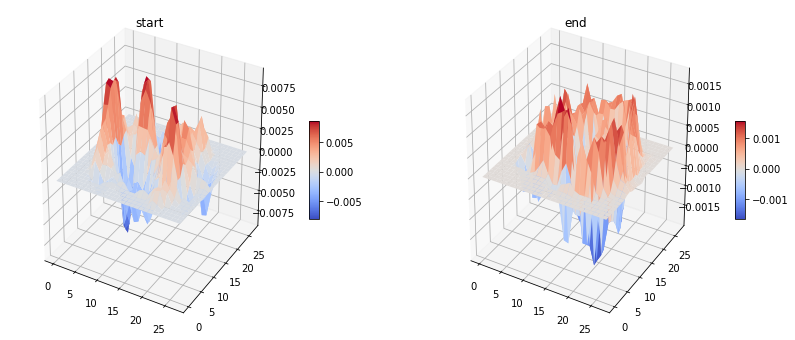

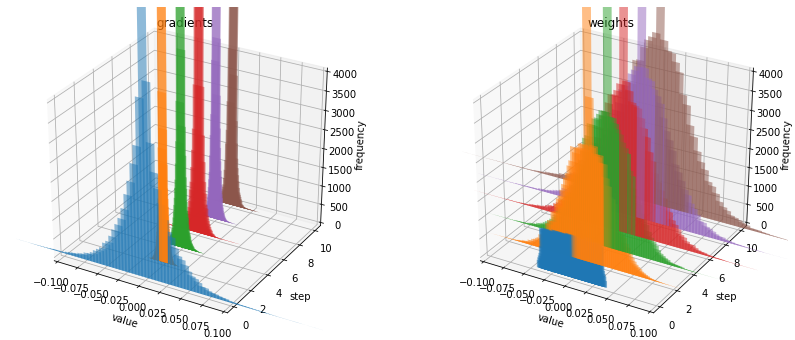

activation:  LeakyReLU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.202567 |  ACC: 0.250000
[0201/0936]	 Loss: 0.728546 |  ACC: 0.878171
[0401/0936]	 Loss: 0.595906 |  ACC: 0.906367
[0601/0936]	 Loss: 0.516246 |  ACC: 0.920603
[0801/0936]	 Loss: 0.462033 |  ACC: 0.928558
[0936/0936]	 Loss: 0.433041 |  ACC: 0.932764
validation:	Loss: 0.184177 | ACC: 0.970600
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.232474 |  ACC: 0.953125
[0201/0936]	 Loss: 0.223917 |  ACC: 0.965114
[0401/0936]	 Loss: 0.213758 |  ACC: 0.964980
[0601/0936]	 Loss: 0.205468 |  ACC: 0.965220
[0801/0936]	 Loss: 0.196760 |  ACC: 0.965009
[0936/0936]	 Loss: 0.191778 |  ACC: 0.965465
validation:	Loss: 0.112442 | ACC: 0.975700
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.127324 |  ACC: 0.976562
[0201/0936]	 Loss: 0.140813 |  ACC: 0.971689
[0401/0936]	 Loss: 0.136491 |  ACC: 0.971976
[0601/0936]	 Loss: 0.135372 |  ACC: 0.971605
[0801/0936]	 Loss: 0.131491 |  ACC: 0.972043
[0936/0936]	 Loss: 0.129783 |  ACC

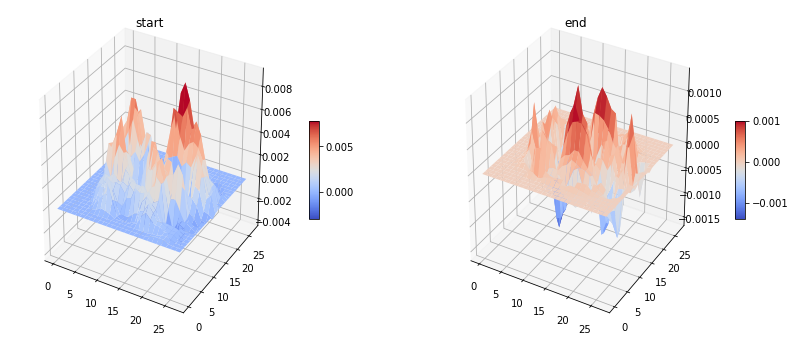

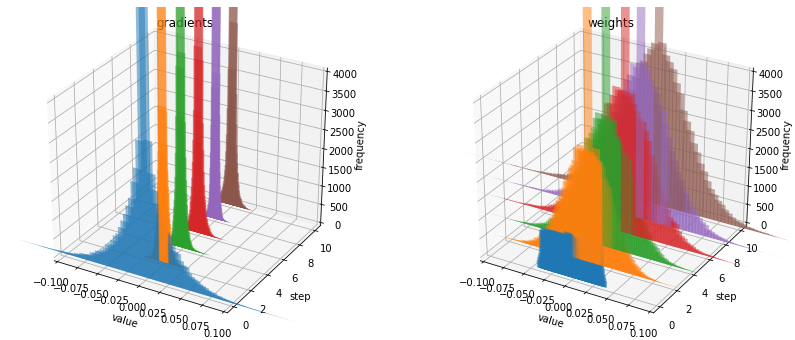

activation:  ReLU6
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.339091 |  ACC: 0.171875
[0201/0936]	 Loss: 0.728659 |  ACC: 0.877785
[0401/0936]	 Loss: 0.587265 |  ACC: 0.909787
[0601/0936]	 Loss: 0.513183 |  ACC: 0.921771
[0801/0936]	 Loss: 0.460336 |  ACC: 0.929045
[0936/0936]	 Loss: 0.432956 |  ACC: 0.932347
validation:	Loss: 0.196519 | ACC: 0.970500
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.283354 |  ACC: 0.960938
[0201/0936]	 Loss: 0.227594 |  ACC: 0.962175
[0401/0936]	 Loss: 0.213052 |  ACC: 0.964630
[0601/0936]	 Loss: 0.204528 |  ACC: 0.964961
[0801/0936]	 Loss: 0.199030 |  ACC: 0.964737
[0936/0936]	 Loss: 0.195184 |  ACC: 0.964881
validation:	Loss: 0.123491 | ACC: 0.975700
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.200150 |  ACC: 0.945312
[0201/0936]	 Loss: 0.145724 |  ACC: 0.972231
[0401/0936]	 Loss: 0.143660 |  ACC: 0.972676
[0601/0936]	 Loss: 0.141058 |  ACC: 0.972228
[0801/0936]	 Loss: 0.139229 |  ACC: 0.972198
[0936/0936]	 Loss: 0.138124 |  ACC: 0.

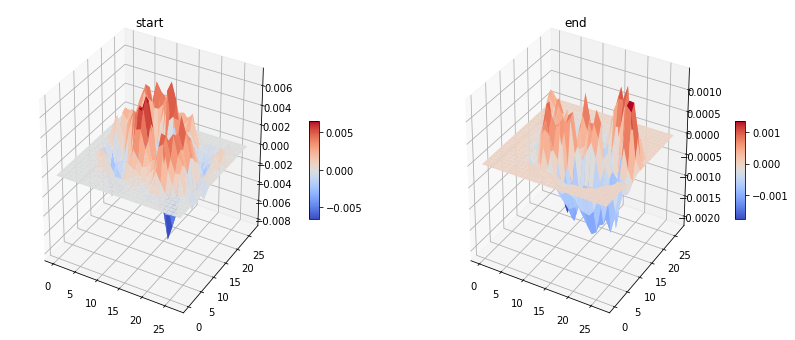

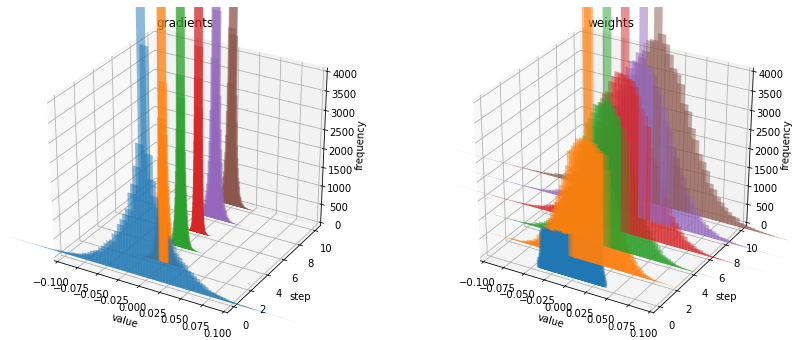

activation:  SELU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.303394 |  ACC: 0.250000
[0201/0936]	 Loss: 0.735072 |  ACC: 0.854270
[0401/0936]	 Loss: 0.617644 |  ACC: 0.880325
[0601/0936]	 Loss: 0.543844 |  ACC: 0.894908
[0801/0936]	 Loss: 0.490038 |  ACC: 0.904769
[0936/0936]	 Loss: 0.461383 |  ACC: 0.909869
validation:	Loss: 0.217089 | ACC: 0.955200
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.290189 |  ACC: 0.898438
[0201/0936]	 Loss: 0.251586 |  ACC: 0.948793
[0401/0936]	 Loss: 0.246429 |  ACC: 0.949083
[0601/0936]	 Loss: 0.235500 |  ACC: 0.950893
[0801/0936]	 Loss: 0.226682 |  ACC: 0.951820
[0936/0936]	 Loss: 0.222072 |  ACC: 0.952008
validation:	Loss: 0.150519 | ACC: 0.965900
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.134462 |  ACC: 0.976562
[0201/0936]	 Loss: 0.168367 |  ACC: 0.962175
[0401/0936]	 Loss: 0.169303 |  ACC: 0.961443
[0601/0936]	 Loss: 0.169159 |  ACC: 0.960730
[0801/0936]	 Loss: 0.165777 |  ACC: 0.960489
[0936/0936]	 Loss: 0.163867 |  ACC: 0.9

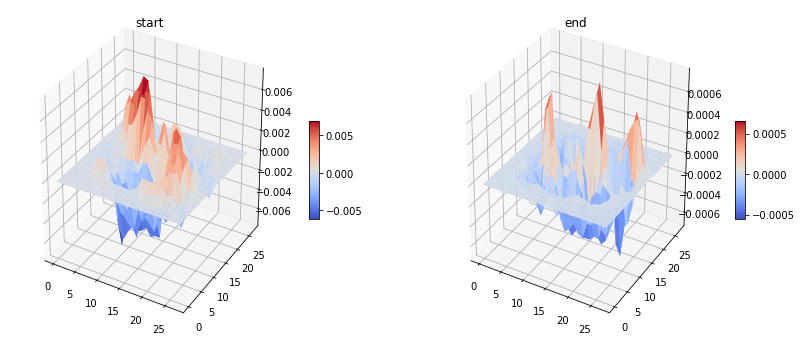

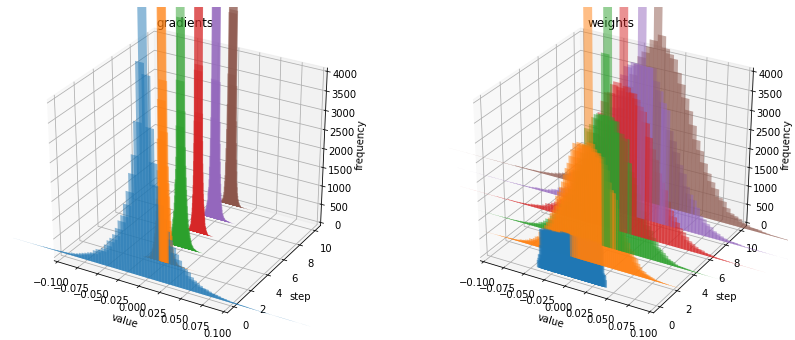

activation:  GELU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.234373 |  ACC: 0.218750
[0201/0936]	 Loss: 0.690199 |  ACC: 0.889078
[0401/0936]	 Loss: 0.565659 |  ACC: 0.914140
[0601/0936]	 Loss: 0.491159 |  ACC: 0.926677
[0801/0936]	 Loss: 0.440909 |  ACC: 0.933798
[0936/0936]	 Loss: 0.413367 |  ACC: 0.937600
validation:	Loss: 0.174624 | ACC: 0.974400
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.192215 |  ACC: 0.984375
[0201/0936]	 Loss: 0.210729 |  ACC: 0.966584
[0401/0936]	 Loss: 0.200801 |  ACC: 0.967351
[0601/0936]	 Loss: 0.194062 |  ACC: 0.967452
[0801/0936]	 Loss: 0.189046 |  ACC: 0.967016
[0936/0936]	 Loss: 0.185461 |  ACC: 0.966932
validation:	Loss: 0.113906 | ACC: 0.977400
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.118824 |  ACC: 0.976562
[0201/0936]	 Loss: 0.135714 |  ACC: 0.974474
[0401/0936]	 Loss: 0.132302 |  ACC: 0.973764
[0601/0936]	 Loss: 0.130020 |  ACC: 0.973656
[0801/0936]	 Loss: 0.129039 |  ACC: 0.973192
[0936/0936]	 Loss: 0.128720 |  ACC: 0.9

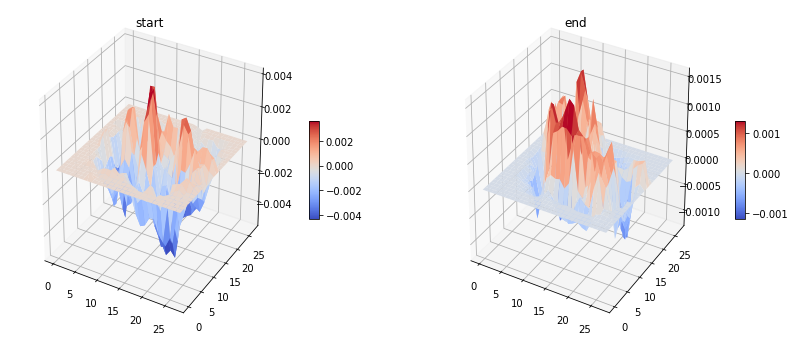

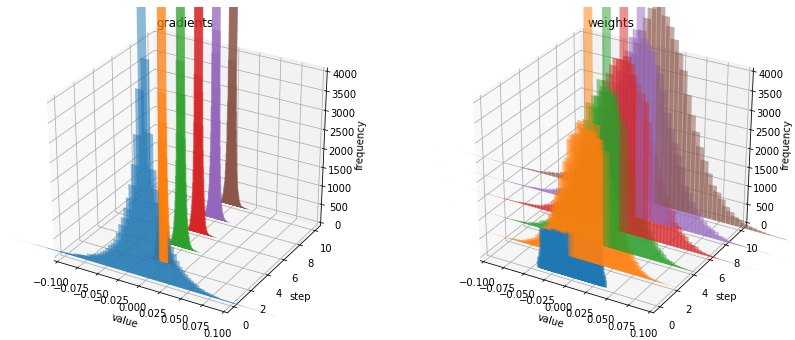

activation:  SiLU
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.179209 |  ACC: 0.242188
[0201/0936]	 Loss: 0.744944 |  ACC: 0.882503
[0401/0936]	 Loss: 0.612199 |  ACC: 0.909204
[0601/0936]	 Loss: 0.532429 |  ACC: 0.921486
[0801/0936]	 Loss: 0.477435 |  ACC: 0.928441
[0936/0936]	 Loss: 0.448111 |  ACC: 0.932264
validation:	Loss: 0.197729 | ACC: 0.972400
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.303828 |  ACC: 0.929688
[0201/0936]	 Loss: 0.230229 |  ACC: 0.963954
[0401/0936]	 Loss: 0.219687 |  ACC: 0.964008
[0601/0936]	 Loss: 0.212151 |  ACC: 0.964286
[0801/0936]	 Loss: 0.203791 |  ACC: 0.964892
[0936/0936]	 Loss: 0.198322 |  ACC: 0.964981
validation:	Loss: 0.114934 | ACC: 0.975400
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.140942 |  ACC: 0.976562
[0201/0936]	 Loss: 0.148911 |  ACC: 0.969291
[0401/0936]	 Loss: 0.145408 |  ACC: 0.969411
[0601/0936]	 Loss: 0.140887 |  ACC: 0.970489
[0801/0936]	 Loss: 0.136267 |  ACC: 0.970990
[0936/0936]	 Loss: 0.135170 |  ACC: 0.9

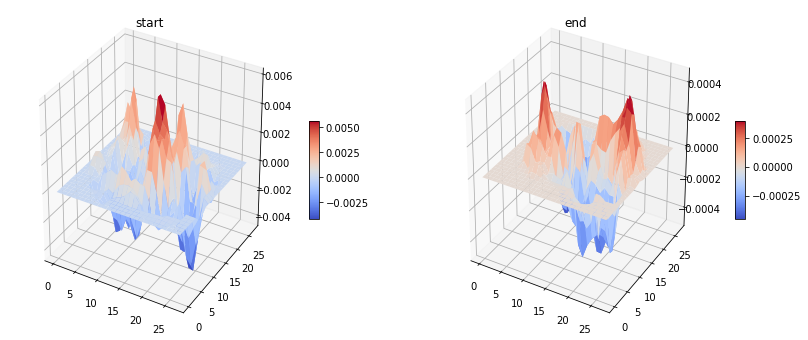

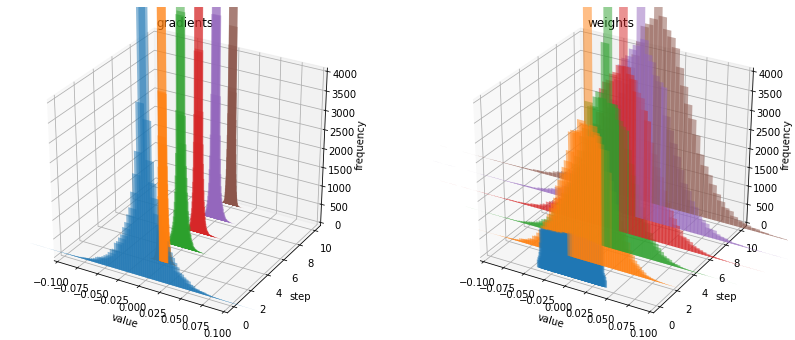

activation:  Hardswish
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.211627 |  ACC: 0.226562
[0201/0936]	 Loss: 0.758932 |  ACC: 0.879564
[0401/0936]	 Loss: 0.623610 |  ACC: 0.906250
[0601/0936]	 Loss: 0.545701 |  ACC: 0.917255
[0801/0936]	 Loss: 0.488964 |  ACC: 0.925557
[0936/0936]	 Loss: 0.458111 |  ACC: 0.929896
validation:	Loss: 0.212961 | ACC: 0.964600
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.241230 |  ACC: 0.960938
[0201/0936]	 Loss: 0.244515 |  ACC: 0.959236
[0401/0936]	 Loss: 0.230326 |  ACC: 0.961093
[0601/0936]	 Loss: 0.219575 |  ACC: 0.961327
[0801/0936]	 Loss: 0.210528 |  ACC: 0.962301
[0936/0936]	 Loss: 0.205199 |  ACC: 0.962563
validation:	Loss: 0.129071 | ACC: 0.974000
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.143015 |  ACC: 0.968750
[0201/0936]	 Loss: 0.149560 |  ACC: 0.972308
[0401/0936]	 Loss: 0.147665 |  ACC: 0.972481
[0601/0936]	 Loss: 0.145907 |  ACC: 0.971371
[0801/0936]	 Loss: 0.145065 |  ACC: 0.971049
[0936/0936]	 Loss: 0.142863 |  ACC

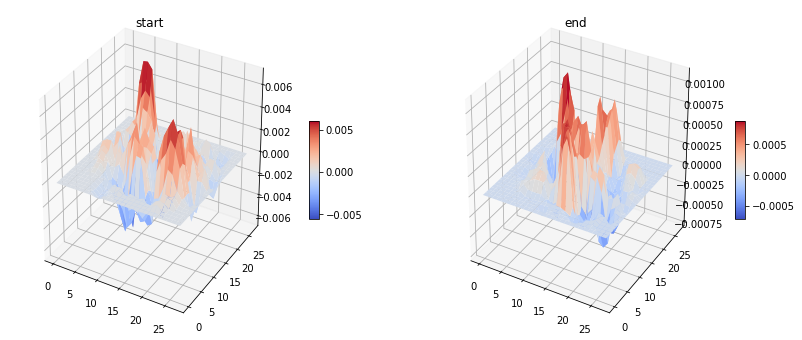

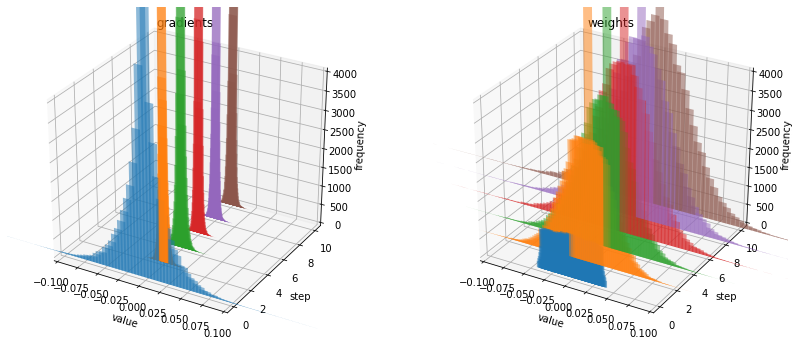

activation:  Mish
optimizer:  Adam
Train Epoch: 000
[0001/0936]	 Loss: 2.194478 |  ACC: 0.242188
[0201/0936]	 Loss: 0.708589 |  ACC: 0.878249
[0401/0936]	 Loss: 0.583140 |  ACC: 0.906172
[0601/0936]	 Loss: 0.509770 |  ACC: 0.919072
[0801/0936]	 Loss: 0.458145 |  ACC: 0.927155
[0936/0936]	 Loss: 0.429419 |  ACC: 0.931880
validation:	Loss: 0.182481 | ACC: 0.971100
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.209299 |  ACC: 0.968750
[0201/0936]	 Loss: 0.221968 |  ACC: 0.965347
[0401/0936]	 Loss: 0.217496 |  ACC: 0.963464
[0601/0936]	 Loss: 0.208506 |  ACC: 0.963974
[0801/0936]	 Loss: 0.201866 |  ACC: 0.963840
[0936/0936]	 Loss: 0.197779 |  ACC: 0.963764
validation:	Loss: 0.133860 | ACC: 0.972000
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.203132 |  ACC: 0.968750
[0201/0936]	 Loss: 0.137953 |  ACC: 0.974861
[0401/0936]	 Loss: 0.140761 |  ACC: 0.973064
[0601/0936]	 Loss: 0.139497 |  ACC: 0.972150
[0801/0936]	 Loss: 0.137725 |  ACC: 0.971614
[0936/0936]	 Loss: 0.135225 |  ACC: 0.9

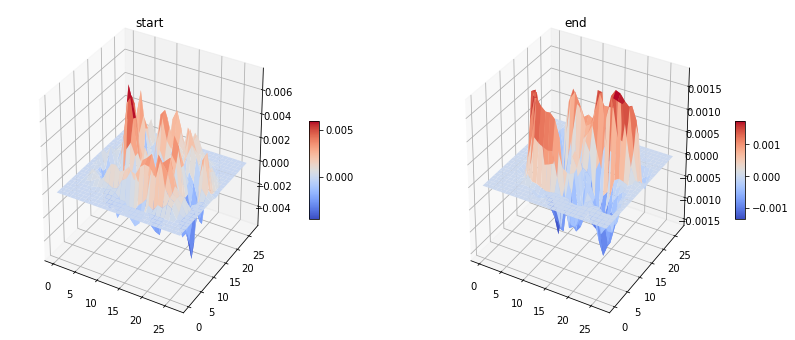

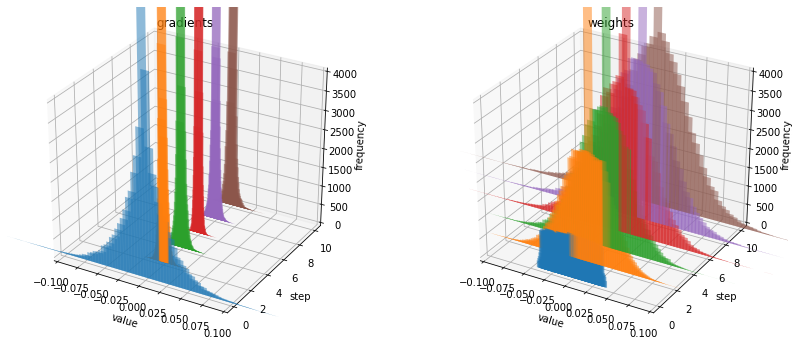

activation:  Sigmoid
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.236429 |  ACC: 0.296875
[0201/0936]	 Loss: 1.919856 |  ACC: 0.840656
[0401/0936]	 Loss: 1.887347 |  ACC: 0.856149
[0601/0936]	 Loss: 1.858584 |  ACC: 0.868641
[0801/0936]	 Loss: 1.832859 |  ACC: 0.878741
[0936/0936]	 Loss: 1.816550 |  ACC: 0.885005
validation:	Loss: 1.705173 | ACC: 0.925600
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 1.711059 |  ACC: 0.929688
[0201/0936]	 Loss: 1.692710 |  ACC: 0.927058
[0401/0936]	 Loss: 1.681442 |  ACC: 0.927200
[0601/0936]	 Loss: 1.670031 |  ACC: 0.930103
[0801/0936]	 Loss: 1.659910 |  ACC: 0.931792
[0936/0936]	 Loss: 1.653879 |  ACC: 0.933164
validation:	Loss: 1.600829 | ACC: 0.951100
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 1.596094 |  ACC: 0.984375
[0201/0936]	 Loss: 1.603943 |  ACC: 0.945467
[0401/0936]	 Loss: 1.598742 |  ACC: 0.946712
[0601/0936]	 Loss: 1.593705 |  ACC: 0.946740
[0801/0936]	 Loss: 1.588907 |  ACC: 0.947650
[0936/0936]	 Loss: 1.585862 |  ACC:

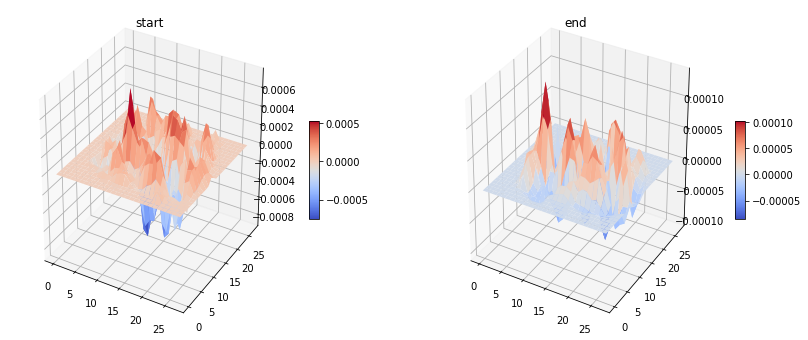

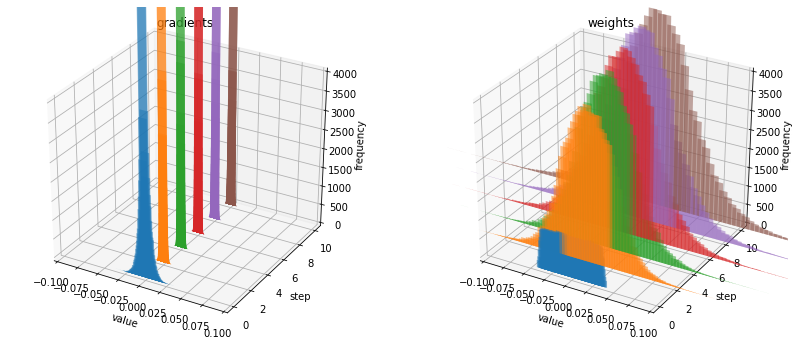

activation:  Tanh
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.186088 |  ACC: 0.265625
[0201/0936]	 Loss: 1.414332 |  ACC: 0.838026
[0401/0936]	 Loss: 1.325696 |  ACC: 0.866721
[0601/0936]	 Loss: 1.262003 |  ACC: 0.882397
[0801/0936]	 Loss: 1.214389 |  ACC: 0.892671
[0936/0936]	 Loss: 1.187427 |  ACC: 0.898913
validation:	Loss: 0.991232 | ACC: 0.950900
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 1.026314 |  ACC: 0.937500
[0201/0936]	 Loss: 1.000096 |  ACC: 0.939279
[0401/0936]	 Loss: 0.987210 |  ACC: 0.942048
[0601/0936]	 Loss: 0.976758 |  ACC: 0.944456
[0801/0936]	 Loss: 0.968505 |  ACC: 0.945137
[0936/0936]	 Loss: 0.963685 |  ACC: 0.945754
validation:	Loss: 0.905949 | ACC: 0.963800
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.889289 |  ACC: 0.992188
[0201/0936]	 Loss: 0.916186 |  ACC: 0.958385
[0401/0936]	 Loss: 0.913167 |  ACC: 0.958294
[0601/0936]	 Loss: 0.909865 |  ACC: 0.958783
[0801/0936]	 Loss: 0.907517 |  ACC: 0.959184
[0936/0936]	 Loss: 0.907203 |  ACC: 0.

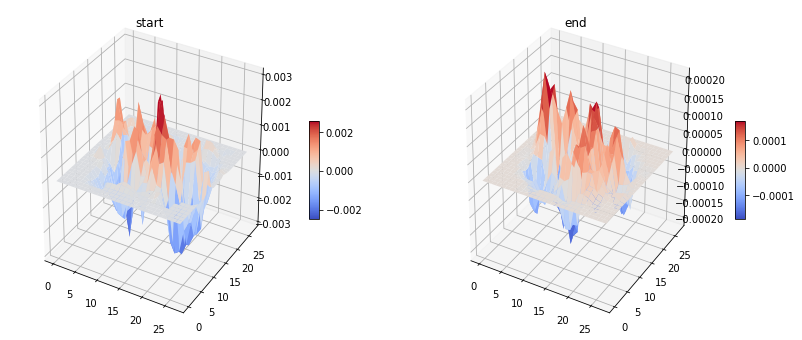

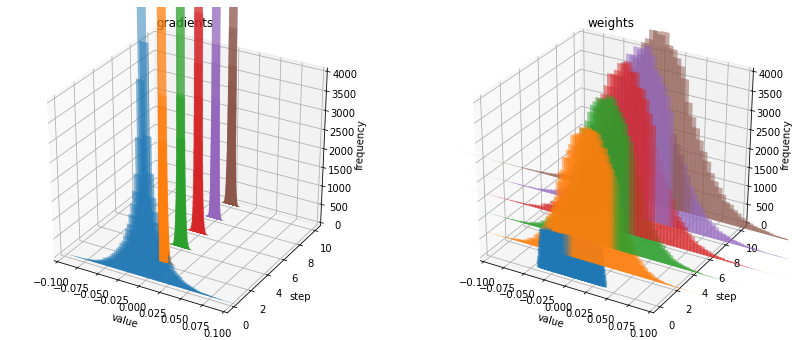

activation:  ReLU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.398660 |  ACC: 0.125000
[0201/0936]	 Loss: 0.739104 |  ACC: 0.875541
[0401/0936]	 Loss: 0.599944 |  ACC: 0.906328
[0601/0936]	 Loss: 0.520591 |  ACC: 0.919046
[0801/0936]	 Loss: 0.466379 |  ACC: 0.926940
[0936/0936]	 Loss: 0.437878 |  ACC: 0.931263
validation:	Loss: 0.180803 | ACC: 0.969900
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.186063 |  ACC: 0.976562
[0201/0936]	 Loss: 0.217589 |  ACC: 0.965269
[0401/0936]	 Loss: 0.210352 |  ACC: 0.964397
[0601/0936]	 Loss: 0.203882 |  ACC: 0.963663
[0801/0936]	 Loss: 0.196609 |  ACC: 0.964191
[0936/0936]	 Loss: 0.191924 |  ACC: 0.964648
validation:	Loss: 0.107873 | ACC: 0.977500
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.133191 |  ACC: 0.984375
[0201/0936]	 Loss: 0.143295 |  ACC: 0.970916
[0401/0936]	 Loss: 0.141205 |  ACC: 0.970888
[0601/0936]	 Loss: 0.138316 |  ACC: 0.971242
[0801/0936]	 Loss: 0.135248 |  ACC: 0.971594
[0936/0936]	 Loss: 0.133020 |  ACC: 0.

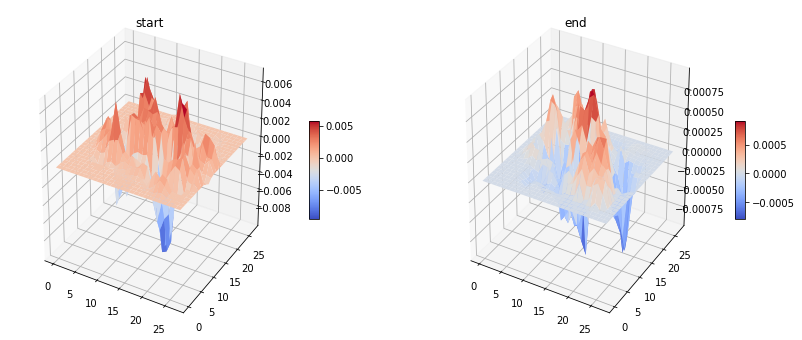

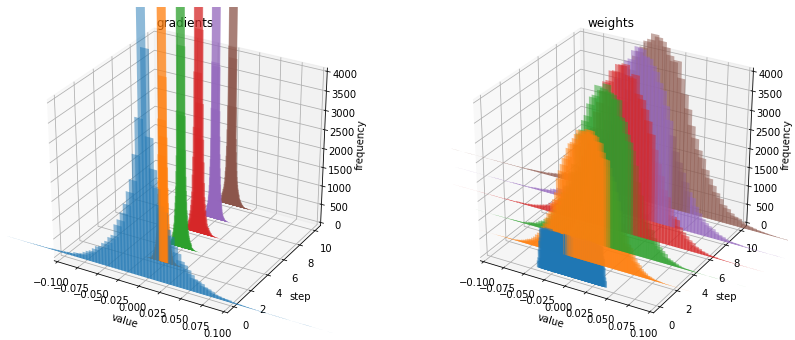

activation:  LeakyReLU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.250423 |  ACC: 0.179688
[0201/0936]	 Loss: 0.720719 |  ACC: 0.884669
[0401/0936]	 Loss: 0.591497 |  ACC: 0.909942
[0601/0936]	 Loss: 0.514144 |  ACC: 0.922031
[0801/0936]	 Loss: 0.460029 |  ACC: 0.929785
[0936/0936]	 Loss: 0.431728 |  ACC: 0.933581
validation:	Loss: 0.201064 | ACC: 0.966600
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.269958 |  ACC: 0.953125
[0201/0936]	 Loss: 0.222768 |  ACC: 0.964341
[0401/0936]	 Loss: 0.212819 |  ACC: 0.965174
[0601/0936]	 Loss: 0.206209 |  ACC: 0.964156
[0801/0936]	 Loss: 0.198902 |  ACC: 0.964776
[0936/0936]	 Loss: 0.193927 |  ACC: 0.965048
validation:	Loss: 0.113619 | ACC: 0.975400
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.151826 |  ACC: 0.968750
[0201/0936]	 Loss: 0.150805 |  ACC: 0.968131
[0401/0936]	 Loss: 0.146427 |  ACC: 0.968284
[0601/0936]	 Loss: 0.139300 |  ACC: 0.970100
[0801/0936]	 Loss: 0.136068 |  ACC: 0.970503
[0936/0936]	 Loss: 0.134262 |  AC

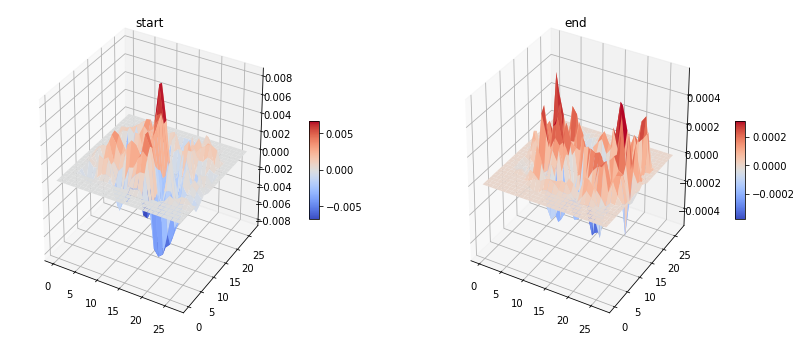

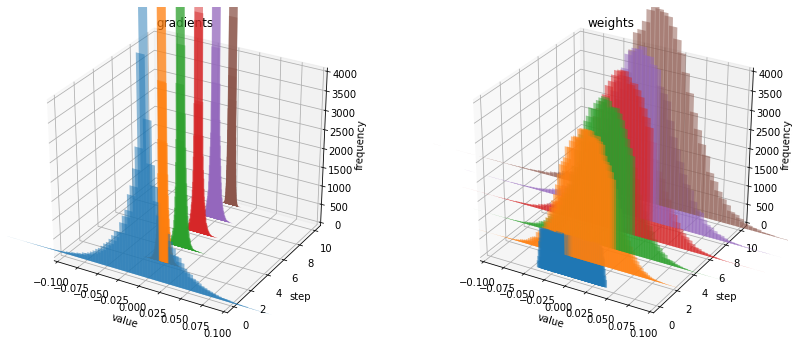

activation:  ReLU6
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.133247 |  ACC: 0.234375
[0201/0936]	 Loss: 0.723823 |  ACC: 0.879564
[0401/0936]	 Loss: 0.593929 |  ACC: 0.907805
[0601/0936]	 Loss: 0.513920 |  ACC: 0.921122
[0801/0936]	 Loss: 0.459214 |  ACC: 0.929571
[0936/0936]	 Loss: 0.430581 |  ACC: 0.933748
validation:	Loss: 0.184857 | ACC: 0.969300
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.213117 |  ACC: 0.976562
[0201/0936]	 Loss: 0.224976 |  ACC: 0.962407
[0401/0936]	 Loss: 0.216870 |  ACC: 0.962764
[0601/0936]	 Loss: 0.205507 |  ACC: 0.964415
[0801/0936]	 Loss: 0.199224 |  ACC: 0.964386
[0936/0936]	 Loss: 0.192927 |  ACC: 0.965415
validation:	Loss: 0.123481 | ACC: 0.974500
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.130025 |  ACC: 0.976562
[0201/0936]	 Loss: 0.145819 |  ACC: 0.972927
[0401/0936]	 Loss: 0.146845 |  ACC: 0.971821
[0601/0936]	 Loss: 0.144592 |  ACC: 0.972098
[0801/0936]	 Loss: 0.142640 |  ACC: 0.971867
[0936/0936]	 Loss: 0.141067 |  ACC: 0

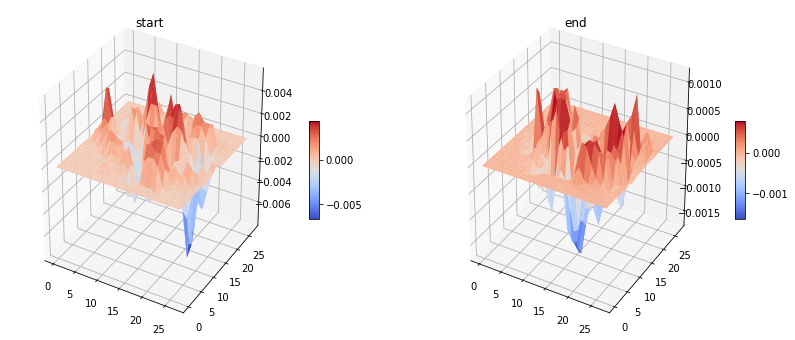

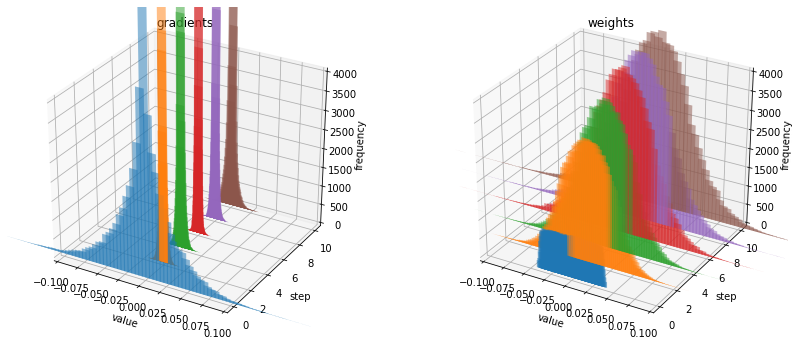

activation:  SELU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.361510 |  ACC: 0.242188
[0201/0936]	 Loss: 0.726512 |  ACC: 0.855739
[0401/0936]	 Loss: 0.619411 |  ACC: 0.880092
[0601/0936]	 Loss: 0.543630 |  ACC: 0.895660
[0801/0936]	 Loss: 0.491229 |  ACC: 0.904516
[0936/0936]	 Loss: 0.462293 |  ACC: 0.909985
validation:	Loss: 0.231817 | ACC: 0.952000
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.225884 |  ACC: 0.960938
[0201/0936]	 Loss: 0.260524 |  ACC: 0.946627
[0401/0936]	 Loss: 0.243901 |  ACC: 0.949588
[0601/0936]	 Loss: 0.231915 |  ACC: 0.951386
[0801/0936]	 Loss: 0.222840 |  ACC: 0.952599
[0936/0936]	 Loss: 0.218985 |  ACC: 0.952908
validation:	Loss: 0.157920 | ACC: 0.965600
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.142354 |  ACC: 0.992188
[0201/0936]	 Loss: 0.172826 |  ACC: 0.961324
[0401/0936]	 Loss: 0.168423 |  ACC: 0.961987
[0601/0936]	 Loss: 0.165490 |  ACC: 0.962080
[0801/0936]	 Loss: 0.163807 |  ACC: 0.961541
[0936/0936]	 Loss: 0.161675 |  ACC: 0.

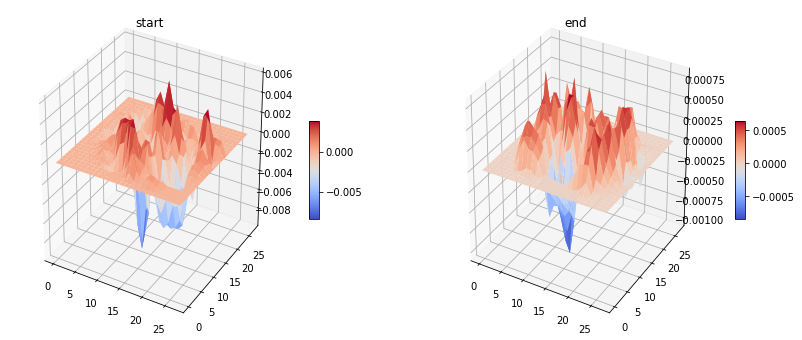

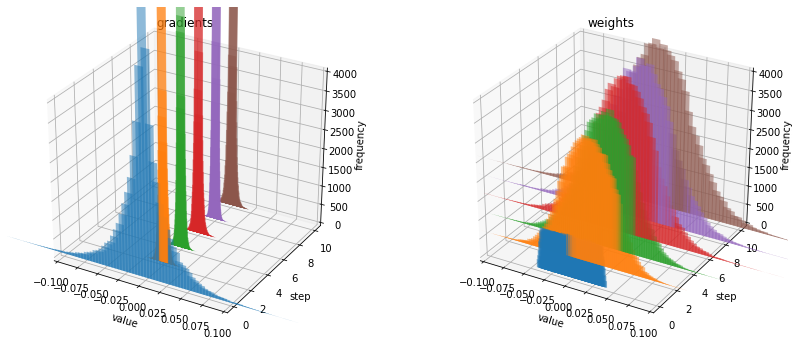

activation:  GELU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.326165 |  ACC: 0.164062
[0201/0936]	 Loss: 0.700101 |  ACC: 0.884669
[0401/0936]	 Loss: 0.569895 |  ACC: 0.912041
[0601/0936]	 Loss: 0.497102 |  ACC: 0.923692
[0801/0936]	 Loss: 0.443665 |  ACC: 0.931753
[0936/0936]	 Loss: 0.416723 |  ACC: 0.935232
validation:	Loss: 0.176645 | ACC: 0.972100
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.244242 |  ACC: 0.960938
[0201/0936]	 Loss: 0.213963 |  ACC: 0.965347
[0401/0936]	 Loss: 0.208135 |  ACC: 0.964747
[0601/0936]	 Loss: 0.200294 |  ACC: 0.964675
[0801/0936]	 Loss: 0.193600 |  ACC: 0.964386
[0936/0936]	 Loss: 0.188009 |  ACC: 0.964981
validation:	Loss: 0.119123 | ACC: 0.975300
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.164236 |  ACC: 0.960938
[0201/0936]	 Loss: 0.135102 |  ACC: 0.973468
[0401/0936]	 Loss: 0.130519 |  ACC: 0.973647
[0601/0936]	 Loss: 0.127790 |  ACC: 0.973604
[0801/0936]	 Loss: 0.127798 |  ACC: 0.973075
[0936/0936]	 Loss: 0.126895 |  ACC: 0.

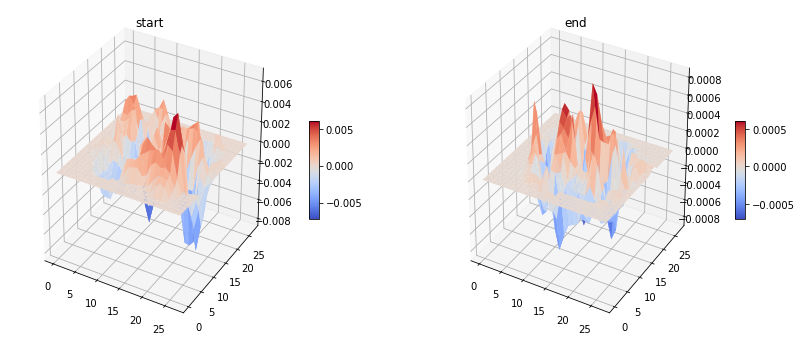

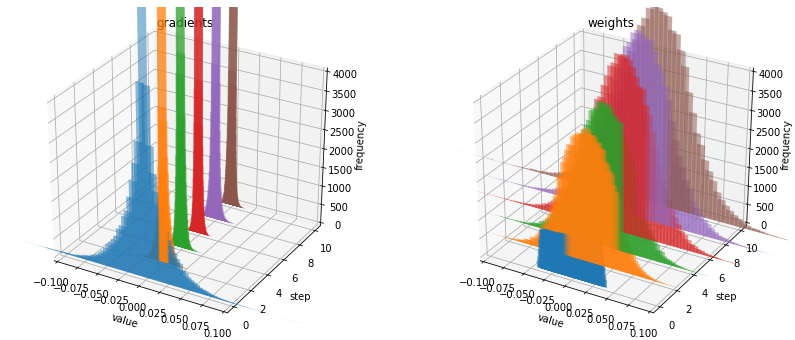

activation:  SiLU
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.408227 |  ACC: 0.132812
[0201/0936]	 Loss: 0.745653 |  ACC: 0.880956
[0401/0936]	 Loss: 0.609183 |  ACC: 0.909126
[0601/0936]	 Loss: 0.530697 |  ACC: 0.921512
[0801/0936]	 Loss: 0.475782 |  ACC: 0.928947
[0936/0936]	 Loss: 0.446951 |  ACC: 0.932597
validation:	Loss: 0.198461 | ACC: 0.969200
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.264490 |  ACC: 0.945312
[0201/0936]	 Loss: 0.234309 |  ACC: 0.963026
[0401/0936]	 Loss: 0.221544 |  ACC: 0.963114
[0601/0936]	 Loss: 0.209352 |  ACC: 0.965168
[0801/0936]	 Loss: 0.203421 |  ACC: 0.964892
[0936/0936]	 Loss: 0.198589 |  ACC: 0.965098
validation:	Loss: 0.136220 | ACC: 0.970800
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.142140 |  ACC: 0.984375
[0201/0936]	 Loss: 0.138392 |  ACC: 0.975402
[0401/0936]	 Loss: 0.139353 |  ACC: 0.973103
[0601/0936]	 Loss: 0.138088 |  ACC: 0.972488
[0801/0936]	 Loss: 0.135575 |  ACC: 0.972276
[0936/0936]	 Loss: 0.133924 |  ACC: 0.

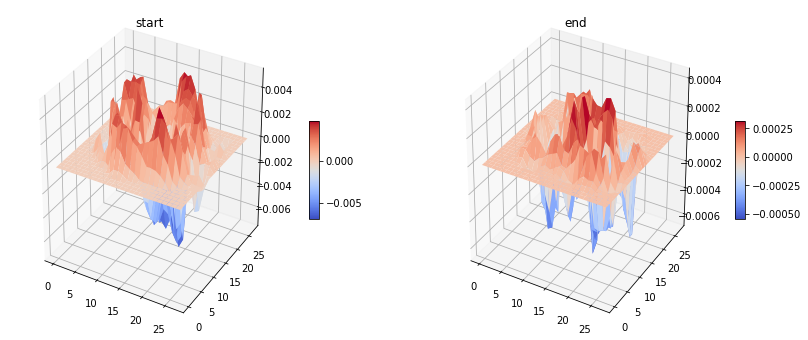

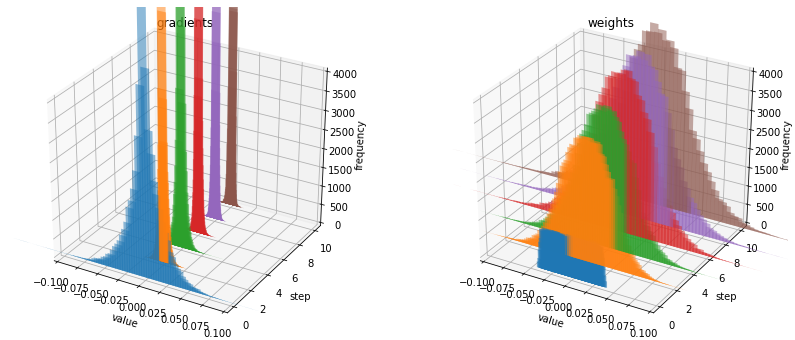

activation:  Hardswish
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.183920 |  ACC: 0.296875
[0201/0936]	 Loss: 0.755712 |  ACC: 0.883895
[0401/0936]	 Loss: 0.619641 |  ACC: 0.909359
[0601/0936]	 Loss: 0.539547 |  ACC: 0.920889
[0801/0936]	 Loss: 0.484030 |  ACC: 0.928285
[0936/0936]	 Loss: 0.454121 |  ACC: 0.932064
validation:	Loss: 0.190444 | ACC: 0.967900
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.217794 |  ACC: 0.976562
[0201/0936]	 Loss: 0.236977 |  ACC: 0.960009
[0401/0936]	 Loss: 0.224395 |  ACC: 0.961015
[0601/0936]	 Loss: 0.217051 |  ACC: 0.961197
[0801/0936]	 Loss: 0.212471 |  ACC: 0.960665
[0936/0936]	 Loss: 0.206932 |  ACC: 0.961396
validation:	Loss: 0.122256 | ACC: 0.975200
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.183159 |  ACC: 0.960938
[0201/0936]	 Loss: 0.151515 |  ACC: 0.970374
[0401/0936]	 Loss: 0.148354 |  ACC: 0.970344
[0601/0936]	 Loss: 0.145395 |  ACC: 0.970229
[0801/0936]	 Loss: 0.144716 |  ACC: 0.969529
[0936/0936]	 Loss: 0.142478 |  AC

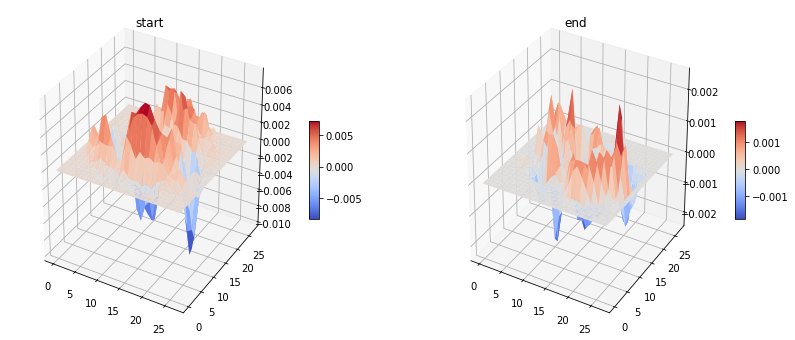

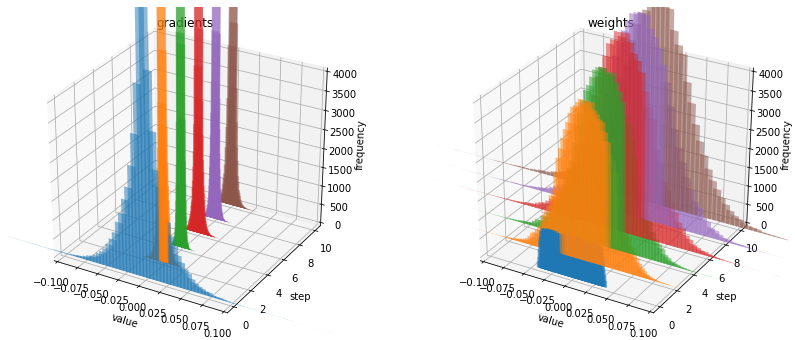

activation:  Mish
optimizer:  AdamW
Train Epoch: 000
[0001/0936]	 Loss: 2.390174 |  ACC: 0.148438
[0201/0936]	 Loss: 0.689521 |  ACC: 0.885752
[0401/0936]	 Loss: 0.567093 |  ACC: 0.912702
[0601/0936]	 Loss: 0.496651 |  ACC: 0.924600
[0801/0936]	 Loss: 0.448376 |  ACC: 0.931519
[0936/0936]	 Loss: 0.421262 |  ACC: 0.935282
validation:	Loss: 0.184613 | ACC: 0.968900
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.273905 |  ACC: 0.945312
[0201/0936]	 Loss: 0.228983 |  ACC: 0.961634
[0401/0936]	 Loss: 0.215083 |  ACC: 0.963581
[0601/0936]	 Loss: 0.205729 |  ACC: 0.964571
[0801/0936]	 Loss: 0.196805 |  ACC: 0.965263
[0936/0936]	 Loss: 0.192627 |  ACC: 0.965348
validation:	Loss: 0.142404 | ACC: 0.966900
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.113125 |  ACC: 1.000000
[0201/0936]	 Loss: 0.137311 |  ACC: 0.974165
[0401/0936]	 Loss: 0.138483 |  ACC: 0.972520
[0601/0936]	 Loss: 0.135701 |  ACC: 0.973007
[0801/0936]	 Loss: 0.134349 |  ACC: 0.972802
[0936/0936]	 Loss: 0.131503 |  ACC: 0.

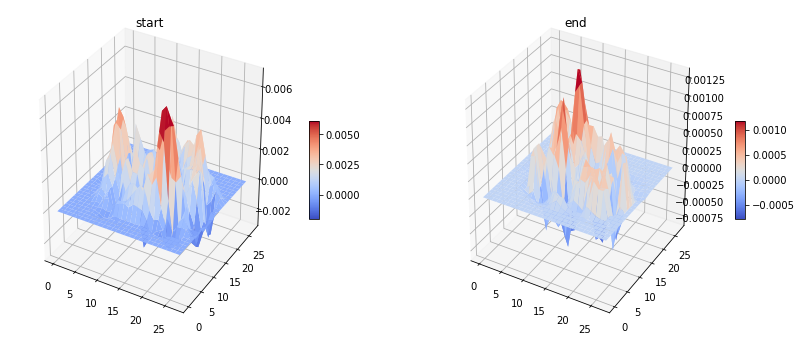

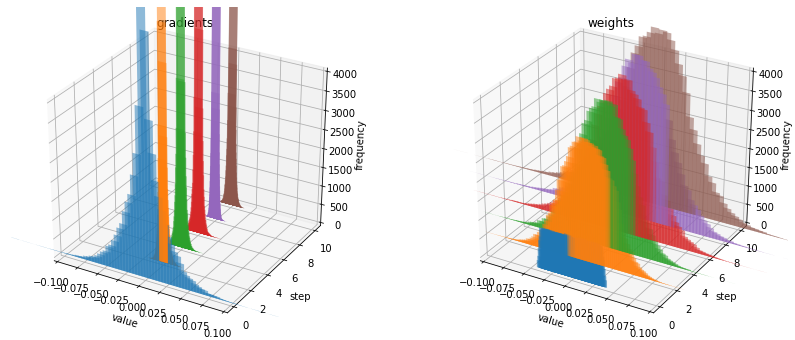

activation:  Sigmoid
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.320544 |  ACC: 0.093750
[0201/0936]	 Loss: 2.025658 |  ACC: 0.662670
[0401/0936]	 Loss: 1.978611 |  ACC: 0.755519
[0601/0936]	 Loss: 1.956063 |  ACC: 0.791450
[0801/0936]	 Loss: 1.940414 |  ACC: 0.811000
[0936/0936]	 Loss: 1.931013 |  ACC: 0.820738
validation:	Loss: 1.857713 | ACC: 0.905300
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 1.869019 |  ACC: 0.890625
[0201/0936]	 Loss: 1.855389 |  ACC: 0.894028
[0401/0936]	 Loss: 1.844713 |  ACC: 0.899642
[0601/0936]	 Loss: 1.834051 |  ACC: 0.903966
[0801/0936]	 Loss: 1.823409 |  ACC: 0.908627
[0936/0936]	 Loss: 1.816714 |  ACC: 0.910702
validation:	Loss: 1.754609 | ACC: 0.939600
time: 0:15

Train Epoch: 002
[0001/0936]	 Loss: 1.775496 |  ACC: 0.937500
[0201/0936]	 Loss: 1.758041 |  ACC: 0.935025
[0401/0936]	 Loss: 1.749677 |  ACC: 0.934857
[0601/0936]	 Loss: 1.741753 |  ACC: 0.936021
[0801/0936]	 Loss: 1.734184 |  ACC: 0.936175
[0936/0936]	 Loss: 1.729307 |  ACC

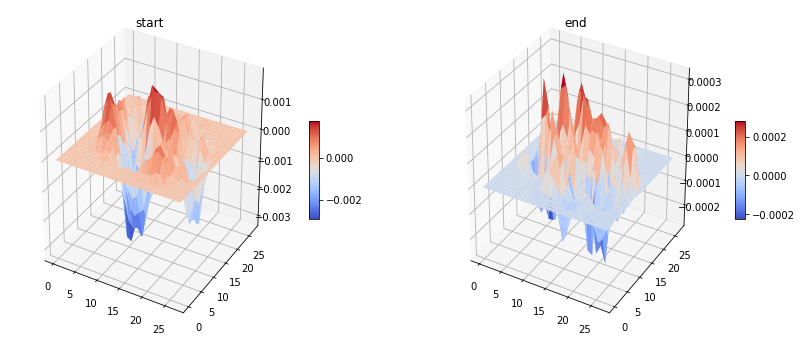

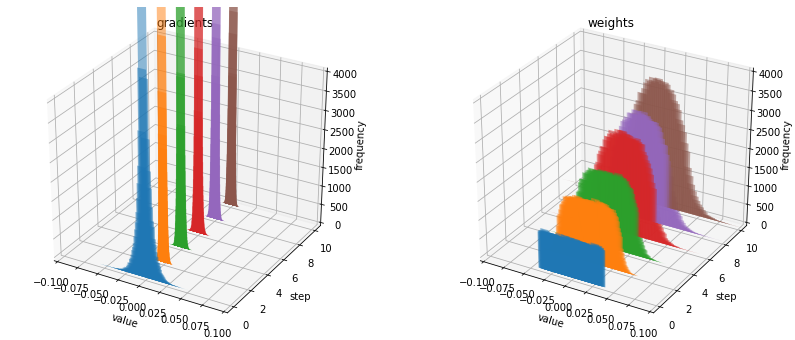

activation:  Tanh
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.384988 |  ACC: 0.156250
[0201/0936]	 Loss: 1.691292 |  ACC: 0.647277
[0401/0936]	 Loss: 1.572086 |  ACC: 0.747163
[0601/0936]	 Loss: 1.509793 |  ACC: 0.789608
[0801/0936]	 Loss: 1.464512 |  ACC: 0.814312
[0936/0936]	 Loss: 1.439106 |  ACC: 0.825941
validation:	Loss: 1.239614 | ACC: 0.920900
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 1.263609 |  ACC: 0.929688
[0201/0936]	 Loss: 1.240895 |  ACC: 0.906173
[0401/0936]	 Loss: 1.219965 |  ACC: 0.911458
[0601/0936]	 Loss: 1.199612 |  ACC: 0.915827
[0801/0936]	 Loss: 1.180300 |  ACC: 0.919186
[0936/0936]	 Loss: 1.168375 |  ACC: 0.921525
validation:	Loss: 1.059964 | ACC: 0.952700
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 1.084711 |  ACC: 0.937500
[0201/0936]	 Loss: 1.072838 |  ACC: 0.939743
[0401/0936]	 Loss: 1.062594 |  ACC: 0.939715
[0601/0936]	 Loss: 1.051431 |  ACC: 0.941679
[0801/0936]	 Loss: 1.041876 |  ACC: 0.942858
[0936/0936]	 Loss: 1.035895 |  ACC: 0

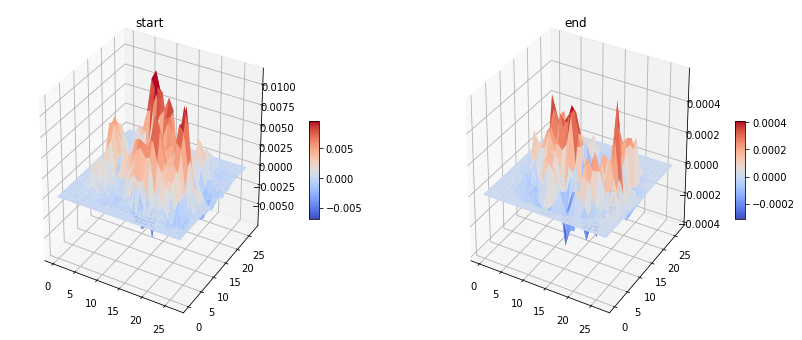

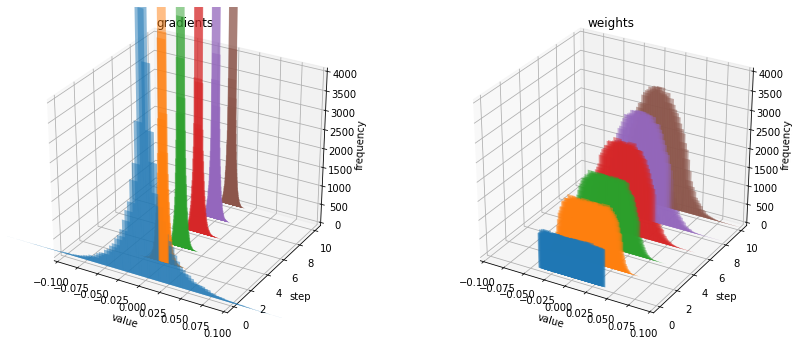

activation:  ReLU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.535545 |  ACC: 0.093750
[0201/0936]	 Loss: 1.416046 |  ACC: 0.626160
[0401/0936]	 Loss: 1.101771 |  ACC: 0.756530
[0601/0936]	 Loss: 0.949839 |  ACC: 0.811566
[0801/0936]	 Loss: 0.854200 |  ACC: 0.841295
[0936/0936]	 Loss: 0.806411 |  ACC: 0.854823
validation:	Loss: 0.405853 | ACC: 0.960700
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.403778 |  ACC: 0.968750
[0201/0936]	 Loss: 0.465631 |  ACC: 0.946086
[0401/0936]	 Loss: 0.439645 |  ACC: 0.948655
[0601/0936]	 Loss: 0.420325 |  ACC: 0.949258
[0801/0936]	 Loss: 0.402541 |  ACC: 0.950748
[0936/0936]	 Loss: 0.389068 |  ACC: 0.952791
validation:	Loss: 0.238640 | ACC: 0.971100
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.352762 |  ACC: 0.937500
[0201/0936]	 Loss: 0.289975 |  ACC: 0.963877
[0401/0936]	 Loss: 0.279467 |  ACC: 0.965446
[0601/0936]	 Loss: 0.271923 |  ACC: 0.964441
[0801/0936]	 Loss: 0.261127 |  ACC: 0.965185
[0936/0936]	 Loss: 0.255528 |  ACC: 0

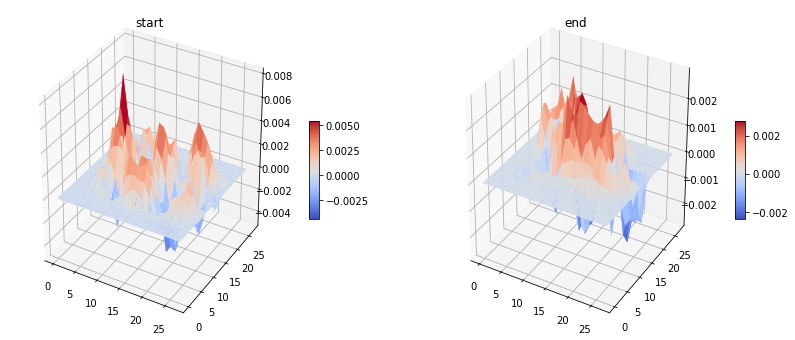

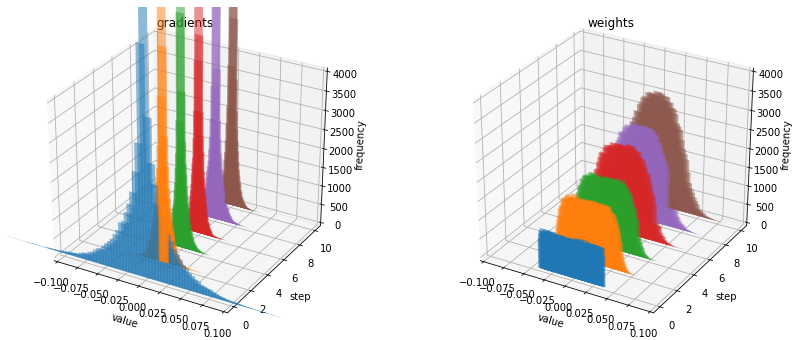

activation:  LeakyReLU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.442883 |  ACC: 0.148438
[0201/0936]	 Loss: 1.344614 |  ACC: 0.653388
[0401/0936]	 Loss: 1.061447 |  ACC: 0.770289
[0601/0936]	 Loss: 0.924641 |  ACC: 0.818963
[0801/0936]	 Loss: 0.836912 |  ACC: 0.846984
[0936/0936]	 Loss: 0.791508 |  ACC: 0.859959
validation:	Loss: 0.413400 | ACC: 0.954800
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 0.585666 |  ACC: 0.921875
[0201/0936]	 Loss: 0.465086 |  ACC: 0.946782
[0401/0936]	 Loss: 0.440403 |  ACC: 0.948616
[0601/0936]	 Loss: 0.419169 |  ACC: 0.950426
[0801/0936]	 Loss: 0.402730 |  ACC: 0.951216
[0936/0936]	 Loss: 0.390912 |  ACC: 0.952058
validation:	Loss: 0.245186 | ACC: 0.972300
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.240335 |  ACC: 0.984375
[0201/0936]	 Loss: 0.291948 |  ACC: 0.962330
[0401/0936]	 Loss: 0.282148 |  ACC: 0.963270
[0601/0936]	 Loss: 0.271550 |  ACC: 0.964078
[0801/0936]	 Loss: 0.262701 |  ACC: 0.964795
[0936/0936]	 Loss: 0.257367 |  A

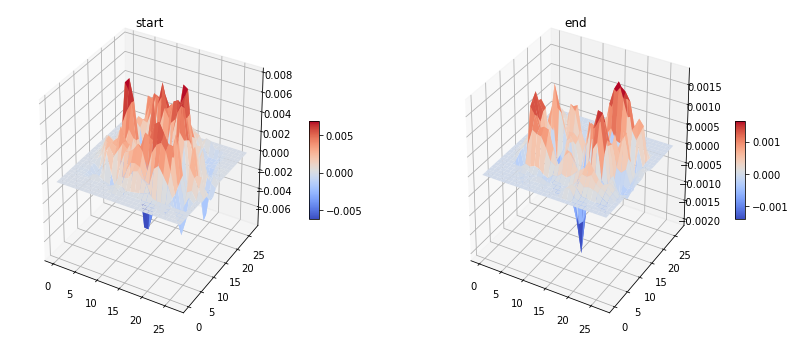

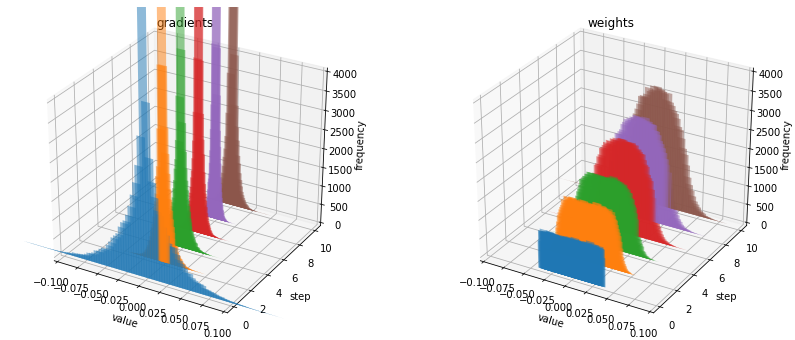

activation:  ReLU6
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.467459 |  ACC: 0.109375
[0201/0936]	 Loss: 1.369450 |  ACC: 0.645575
[0401/0936]	 Loss: 1.081589 |  ACC: 0.763099
[0601/0936]	 Loss: 0.938209 |  ACC: 0.814550
[0801/0936]	 Loss: 0.843405 |  ACC: 0.845192
[0936/0936]	 Loss: 0.796331 |  ACC: 0.858975
validation:	Loss: 0.401153 | ACC: 0.960000
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.533100 |  ACC: 0.945312
[0201/0936]	 Loss: 0.465495 |  ACC: 0.945931
[0401/0936]	 Loss: 0.440372 |  ACC: 0.948888
[0601/0936]	 Loss: 0.420954 |  ACC: 0.949673
[0801/0936]	 Loss: 0.402475 |  ACC: 0.951683
[0936/0936]	 Loss: 0.389820 |  ACC: 0.952858
validation:	Loss: 0.245132 | ACC: 0.969700
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.297940 |  ACC: 0.968750
[0201/0936]	 Loss: 0.283957 |  ACC: 0.966352
[0401/0936]	 Loss: 0.275844 |  ACC: 0.965019
[0601/0936]	 Loss: 0.268661 |  ACC: 0.964727
[0801/0936]	 Loss: 0.261130 |  ACC: 0.964639
[0936/0936]	 Loss: 0.255744 |  ACC: 

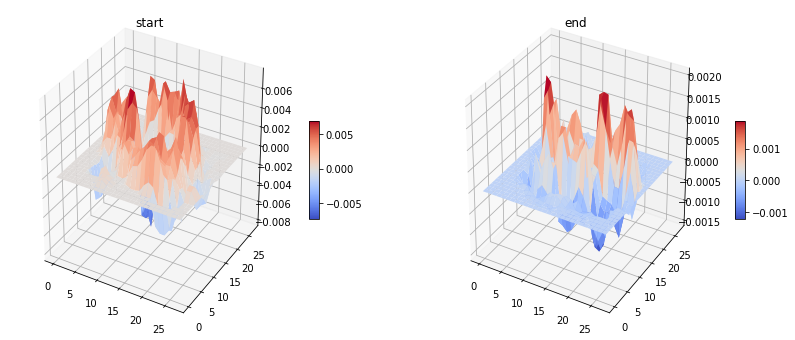

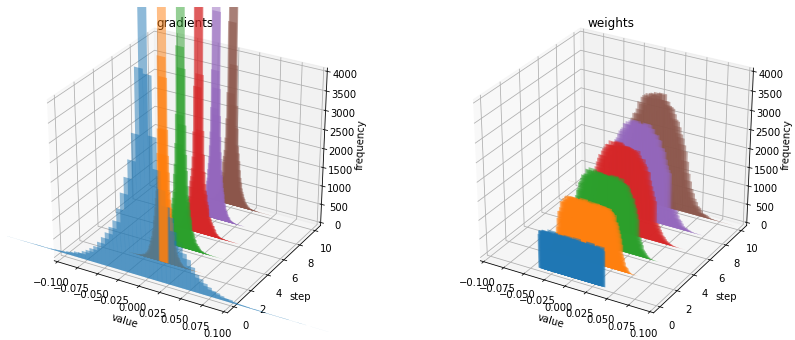

activation:  SELU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.346216 |  ACC: 0.171875
[0201/0936]	 Loss: 1.133813 |  ACC: 0.705832
[0401/0936]	 Loss: 0.939041 |  ACC: 0.784709
[0601/0936]	 Loss: 0.845844 |  ACC: 0.817925
[0801/0936]	 Loss: 0.775879 |  ACC: 0.840399
[0936/0936]	 Loss: 0.737732 |  ACC: 0.851387
validation:	Loss: 0.432181 | ACC: 0.942600
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.443441 |  ACC: 0.929688
[0201/0936]	 Loss: 0.451856 |  ACC: 0.929920
[0401/0936]	 Loss: 0.431716 |  ACC: 0.931864
[0601/0936]	 Loss: 0.412792 |  ACC: 0.934308
[0801/0936]	 Loss: 0.393710 |  ACC: 0.937578
[0936/0936]	 Loss: 0.383556 |  ACC: 0.938567
validation:	Loss: 0.250133 | ACC: 0.962800
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.344898 |  ACC: 0.929688
[0201/0936]	 Loss: 0.285522 |  ACC: 0.954672
[0401/0936]	 Loss: 0.279556 |  ACC: 0.954213
[0601/0936]	 Loss: 0.272895 |  ACC: 0.954319
[0801/0936]	 Loss: 0.264861 |  ACC: 0.954956
[0936/0936]	 Loss: 0.259231 |  ACC: 0

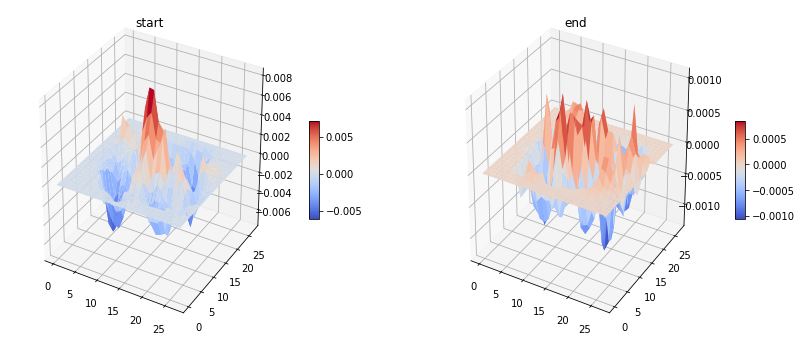

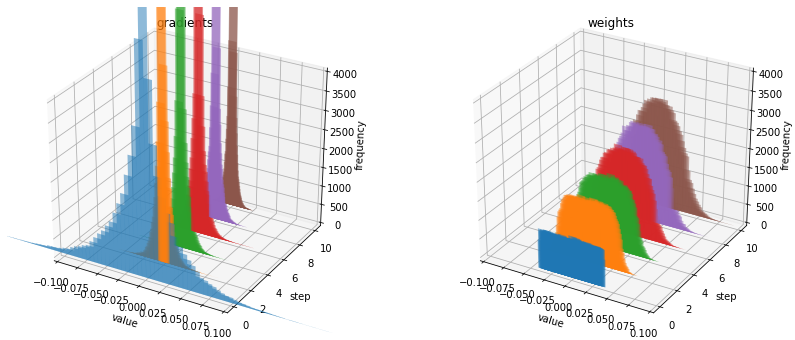

activation:  GELU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.475537 |  ACC: 0.101562
[0201/0936]	 Loss: 1.352857 |  ACC: 0.645808
[0401/0936]	 Loss: 1.056901 |  ACC: 0.766947
[0601/0936]	 Loss: 0.912978 |  ACC: 0.816627
[0801/0936]	 Loss: 0.820843 |  ACC: 0.846263
[0936/0936]	 Loss: 0.773109 |  ACC: 0.860409
validation:	Loss: 0.388029 | ACC: 0.958600
time: 0:15

Train Epoch: 001
[0001/0936]	 Loss: 0.482108 |  ACC: 0.937500
[0201/0936]	 Loss: 0.440586 |  ACC: 0.948097
[0401/0936]	 Loss: 0.426055 |  ACC: 0.948033
[0601/0936]	 Loss: 0.405454 |  ACC: 0.950244
[0801/0936]	 Loss: 0.386315 |  ACC: 0.952463
[0936/0936]	 Loss: 0.376305 |  ACC: 0.953058
validation:	Loss: 0.223526 | ACC: 0.971700
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.346499 |  ACC: 0.953125
[0201/0936]	 Loss: 0.282561 |  ACC: 0.964418
[0401/0936]	 Loss: 0.271306 |  ACC: 0.964941
[0601/0936]	 Loss: 0.260391 |  ACC: 0.966154
[0801/0936]	 Loss: 0.251784 |  ACC: 0.966860
[0936/0936]	 Loss: 0.247631 |  ACC: 0

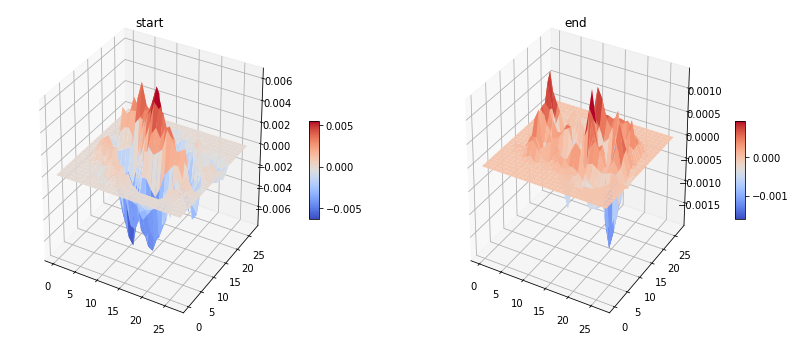

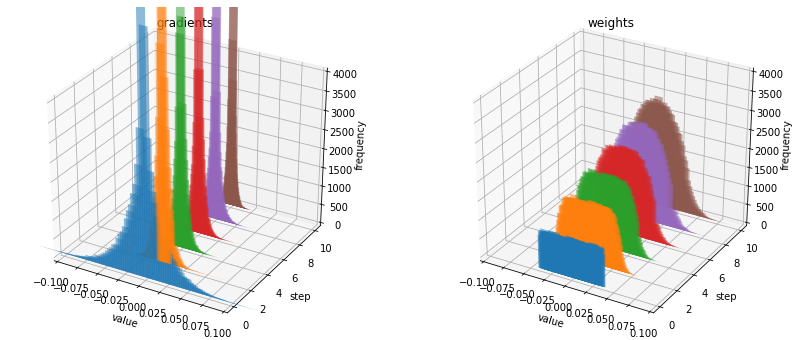

activation:  SiLU
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.526730 |  ACC: 0.078125
[0201/0936]	 Loss: 1.368986 |  ACC: 0.644493
[0401/0936]	 Loss: 1.084620 |  ACC: 0.766014
[0601/0936]	 Loss: 0.945460 |  ACC: 0.817380
[0801/0936]	 Loss: 0.855028 |  ACC: 0.845990
[0936/0936]	 Loss: 0.806678 |  ACC: 0.860075
validation:	Loss: 0.408345 | ACC: 0.957100
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.450649 |  ACC: 0.968750
[0201/0936]	 Loss: 0.469657 |  ACC: 0.948561
[0401/0936]	 Loss: 0.451766 |  ACC: 0.949355
[0601/0936]	 Loss: 0.429374 |  ACC: 0.951879
[0801/0936]	 Loss: 0.410511 |  ACC: 0.953300
[0936/0936]	 Loss: 0.398510 |  ACC: 0.954059
validation:	Loss: 0.253141 | ACC: 0.970200
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.285418 |  ACC: 0.968750
[0201/0936]	 Loss: 0.301797 |  ACC: 0.961788
[0401/0936]	 Loss: 0.290063 |  ACC: 0.962609
[0601/0936]	 Loss: 0.279767 |  ACC: 0.962625
[0801/0936]	 Loss: 0.270152 |  ACC: 0.963529
[0936/0936]	 Loss: 0.263876 |  ACC: 0

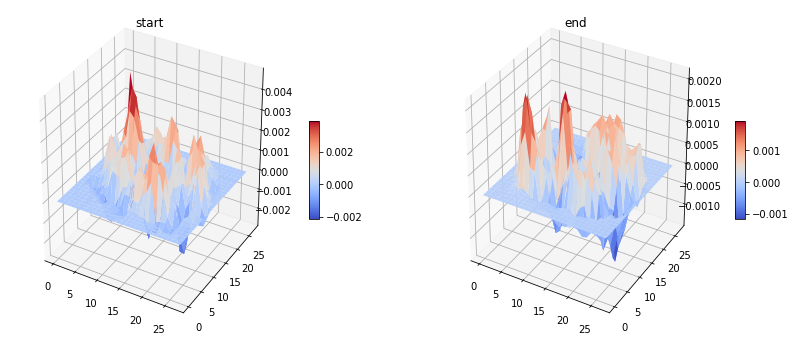

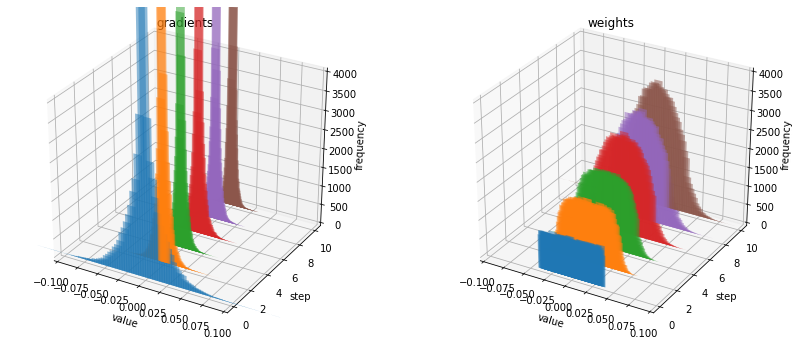

activation:  Hardswish
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.350740 |  ACC: 0.171875
[0201/0936]	 Loss: 1.341594 |  ACC: 0.669400
[0401/0936]	 Loss: 1.078814 |  ACC: 0.775964
[0601/0936]	 Loss: 0.945537 |  ACC: 0.822726
[0801/0936]	 Loss: 0.857069 |  ACC: 0.849868
[0936/0936]	 Loss: 0.809444 |  ACC: 0.862927
validation:	Loss: 0.419880 | ACC: 0.957000
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.466843 |  ACC: 0.976562
[0201/0936]	 Loss: 0.466950 |  ACC: 0.949025
[0401/0936]	 Loss: 0.446730 |  ACC: 0.949899
[0601/0936]	 Loss: 0.427696 |  ACC: 0.951490
[0801/0936]	 Loss: 0.409369 |  ACC: 0.952190
[0936/0936]	 Loss: 0.399448 |  ACC: 0.952391
validation:	Loss: 0.256803 | ACC: 0.969200
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.283501 |  ACC: 0.968750
[0201/0936]	 Loss: 0.301235 |  ACC: 0.962871
[0401/0936]	 Loss: 0.288472 |  ACC: 0.962920
[0601/0936]	 Loss: 0.280486 |  ACC: 0.963118
[0801/0936]	 Loss: 0.273295 |  ACC: 0.963081
[0936/0936]	 Loss: 0.267979 |  A

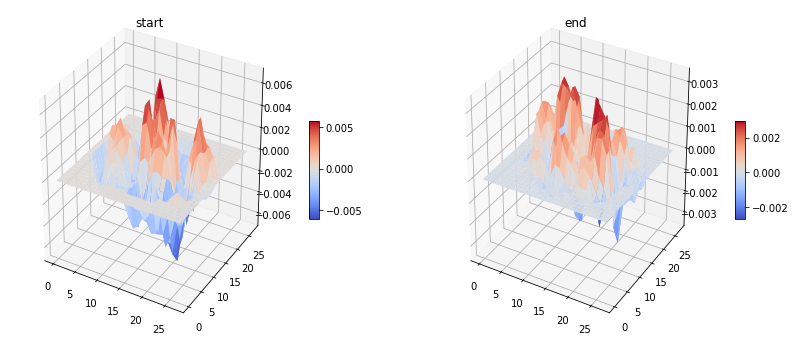

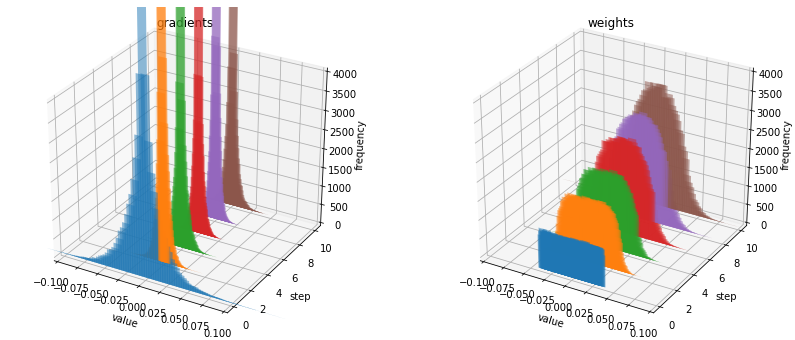

activation:  Mish
optimizer:  Ranger
Train Epoch: 000
[0001/0936]	 Loss: 2.552588 |  ACC: 0.062500
[0201/0936]	 Loss: 1.306545 |  ACC: 0.662902
[0401/0936]	 Loss: 1.024348 |  ACC: 0.775731
[0601/0936]	 Loss: 0.887704 |  ACC: 0.824673
[0801/0936]	 Loss: 0.802188 |  ACC: 0.851699
[0936/0936]	 Loss: 0.757813 |  ACC: 0.864228
validation:	Loss: 0.395833 | ACC: 0.960700
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.480362 |  ACC: 0.937500
[0201/0936]	 Loss: 0.444262 |  ACC: 0.949722
[0401/0936]	 Loss: 0.425351 |  ACC: 0.950987
[0601/0936]	 Loss: 0.406769 |  ACC: 0.952762
[0801/0936]	 Loss: 0.388816 |  ACC: 0.954294
[0936/0936]	 Loss: 0.378319 |  ACC: 0.954926
validation:	Loss: 0.244912 | ACC: 0.971400
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.269011 |  ACC: 0.968750
[0201/0936]	 Loss: 0.281621 |  ACC: 0.965037
[0401/0936]	 Loss: 0.276622 |  ACC: 0.964669
[0601/0936]	 Loss: 0.268094 |  ACC: 0.965194
[0801/0936]	 Loss: 0.259984 |  ACC: 0.965087
[0936/0936]	 Loss: 0.255759 |  ACC: 0

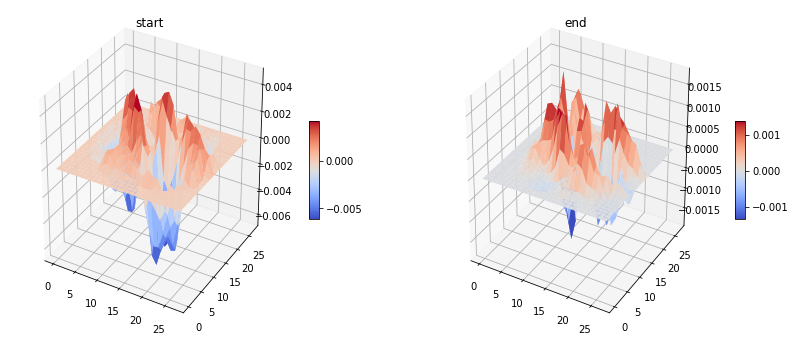

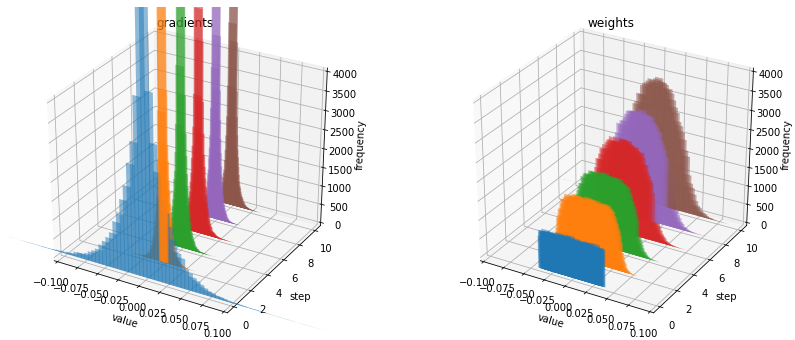

activation:  Sigmoid
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.220983 |  ACC: 0.226562
[0201/0936]	 Loss: 1.909172 |  ACC: 0.834468
[0401/0936]	 Loss: 1.863893 |  ACC: 0.848336
[0601/0936]	 Loss: 1.829167 |  ACC: 0.856987
[0801/0936]	 Loss: 1.800462 |  ACC: 0.865512
[0936/0936]	 Loss: 1.783920 |  ACC: 0.869964
validation:	Loss: 1.665194 | ACC: 0.913900
time: 0:13

Train Epoch: 001
[0001/0936]	 Loss: 1.671149 |  ACC: 0.882812
[0201/0936]	 Loss: 1.659683 |  ACC: 0.911433
[0401/0936]	 Loss: 1.649672 |  ACC: 0.913479
[0601/0936]	 Loss: 1.641539 |  ACC: 0.915049
[0801/0936]	 Loss: 1.632830 |  ACC: 0.918660
[0936/0936]	 Loss: 1.627825 |  ACC: 0.919674
validation:	Loss: 1.582166 | ACC: 0.942400
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 1.601780 |  ACC: 0.914062
[0201/0936]	 Loss: 1.587256 |  ACC: 0.934329
[0401/0936]	 Loss: 1.583920 |  ACC: 0.935518
[0601/0936]	 Loss: 1.580146 |  ACC: 0.937526
[0801/0936]	 Loss: 1.577233 |  ACC: 0.938455
[0936/0936]	 Loss: 1.575246 |  

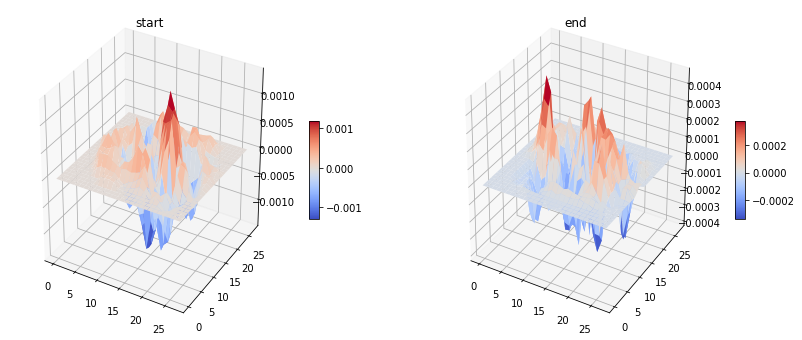

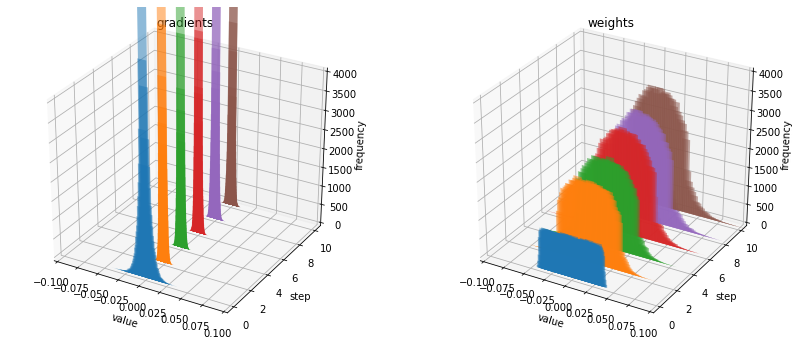

activation:  Tanh
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.210474 |  ACC: 0.203125
[0201/0936]	 Loss: 1.371314 |  ACC: 0.839728
[0401/0936]	 Loss: 1.252550 |  ACC: 0.870452
[0601/0936]	 Loss: 1.185927 |  ACC: 0.886524
[0801/0936]	 Loss: 1.141160 |  ACC: 0.897074
[0936/0936]	 Loss: 1.118815 |  ACC: 0.902415
validation:	Loss: 0.945132 | ACC: 0.951100
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.967672 |  ACC: 0.937500
[0201/0936]	 Loss: 0.963309 |  ACC: 0.939743
[0401/0936]	 Loss: 0.953773 |  ACC: 0.943136
[0601/0936]	 Loss: 0.948081 |  ACC: 0.944145
[0801/0936]	 Loss: 0.942134 |  ACC: 0.946248
[0936/0936]	 Loss: 0.939188 |  ACC: 0.946705
validation:	Loss: 0.894811 | ACC: 0.960800
time: 0:15

Train Epoch: 002
[0001/0936]	 Loss: 0.925967 |  ACC: 0.953125
[0201/0936]	 Loss: 0.914054 |  ACC: 0.954595
[0401/0936]	 Loss: 0.907925 |  ACC: 0.956701
[0601/0936]	 Loss: 0.906166 |  ACC: 0.957252
[0801/0936]	 Loss: 0.902807 |  ACC: 0.958288
[0936/0936]	 Loss: 0.900941 |  ACC

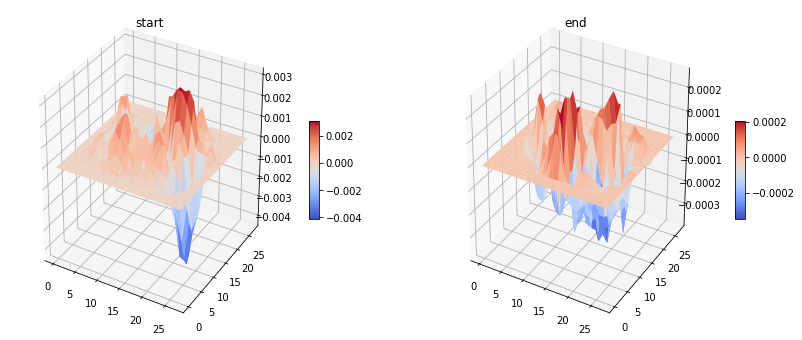

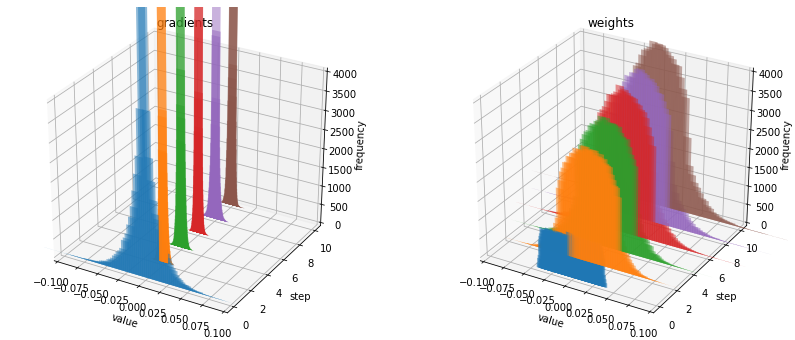

activation:  ReLU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.344266 |  ACC: 0.156250
[0201/0936]	 Loss: 0.684338 |  ACC: 0.883741
[0401/0936]	 Loss: 0.541710 |  ACC: 0.909554
[0601/0936]	 Loss: 0.462534 |  ACC: 0.921953
[0801/0936]	 Loss: 0.409705 |  ACC: 0.930038
[0936/0936]	 Loss: 0.381608 |  ACC: 0.934065
validation:	Loss: 0.149063 | ACC: 0.972400
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.100405 |  ACC: 0.992188
[0201/0936]	 Loss: 0.183678 |  ACC: 0.963490
[0401/0936]	 Loss: 0.179449 |  ACC: 0.963658
[0601/0936]	 Loss: 0.174463 |  ACC: 0.963741
[0801/0936]	 Loss: 0.169422 |  ACC: 0.963762
[0936/0936]	 Loss: 0.165751 |  ACC: 0.963964
validation:	Loss: 0.097708 | ACC: 0.977400
time: 0:13

Train Epoch: 002
[0001/0936]	 Loss: 0.086938 |  ACC: 0.968750
[0201/0936]	 Loss: 0.126699 |  ACC: 0.970529
[0401/0936]	 Loss: 0.120993 |  ACC: 0.971937
[0601/0936]	 Loss: 0.120882 |  ACC: 0.971709
[0801/0936]	 Loss: 0.118626 |  ACC: 0.971828
[0936/0936]	 Loss: 0.116914 |  ACC

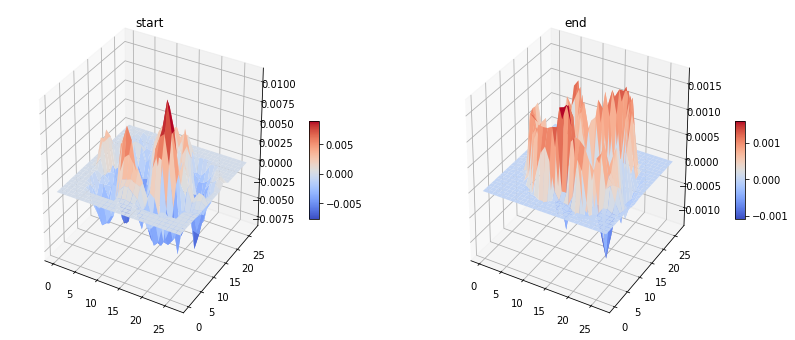

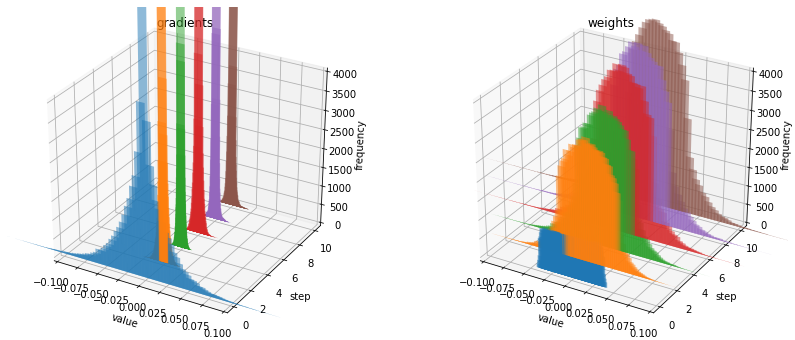

activation:  LeakyReLU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.383008 |  ACC: 0.156250
[0201/0936]	 Loss: 0.693280 |  ACC: 0.882116
[0401/0936]	 Loss: 0.551541 |  ACC: 0.906911
[0601/0936]	 Loss: 0.470283 |  ACC: 0.920344
[0801/0936]	 Loss: 0.417344 |  ACC: 0.928070
[0936/0936]	 Loss: 0.388892 |  ACC: 0.932431
validation:	Loss: 0.143944 | ACC: 0.971700
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.136905 |  ACC: 0.984375
[0201/0936]	 Loss: 0.186669 |  ACC: 0.963026
[0401/0936]	 Loss: 0.181226 |  ACC: 0.963308
[0601/0936]	 Loss: 0.175179 |  ACC: 0.964078
[0801/0936]	 Loss: 0.168590 |  ACC: 0.965263
[0936/0936]	 Loss: 0.165907 |  ACC: 0.965231
validation:	Loss: 0.104102 | ACC: 0.976000
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.088479 |  ACC: 0.976562
[0201/0936]	 Loss: 0.114793 |  ACC: 0.976330
[0401/0936]	 Loss: 0.117755 |  ACC: 0.974308
[0601/0936]	 Loss: 0.118492 |  ACC: 0.973292
[0801/0936]	 Loss: 0.117851 |  ACC: 0.972627
[0936/0936]	 Loss: 0.115742 |

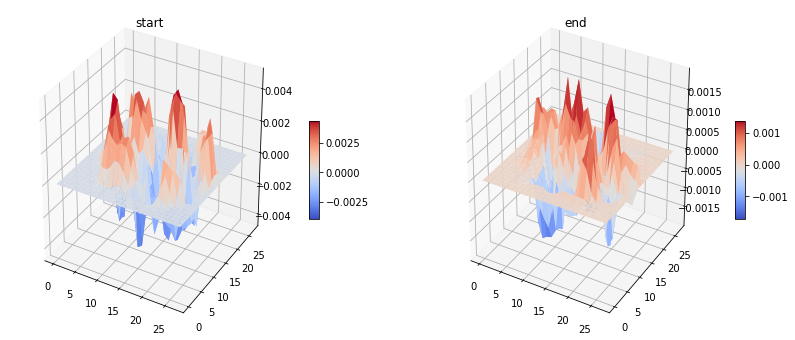

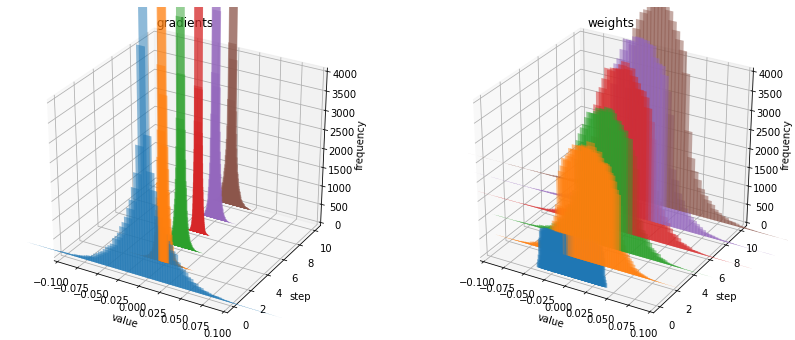

activation:  ReLU6
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.305916 |  ACC: 0.195312
[0201/0936]	 Loss: 0.699116 |  ACC: 0.880028
[0401/0936]	 Loss: 0.549239 |  ACC: 0.907960
[0601/0936]	 Loss: 0.466351 |  ACC: 0.921252
[0801/0936]	 Loss: 0.412153 |  ACC: 0.929142
[0936/0936]	 Loss: 0.385185 |  ACC: 0.932981
validation:	Loss: 0.156335 | ACC: 0.970700
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.229440 |  ACC: 0.953125
[0201/0936]	 Loss: 0.193182 |  ACC: 0.961866
[0401/0936]	 Loss: 0.187915 |  ACC: 0.961754
[0601/0936]	 Loss: 0.180939 |  ACC: 0.963092
[0801/0936]	 Loss: 0.174063 |  ACC: 0.963801
[0936/0936]	 Loss: 0.170234 |  ACC: 0.964448
validation:	Loss: 0.108821 | ACC: 0.977800
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.073836 |  ACC: 0.984375
[0201/0936]	 Loss: 0.133641 |  ACC: 0.972076
[0401/0936]	 Loss: 0.131182 |  ACC: 0.972870
[0601/0936]	 Loss: 0.132362 |  ACC: 0.971813
[0801/0936]	 Loss: 0.131426 |  ACC: 0.971497
[0936/0936]	 Loss: 0.131903 |  AC

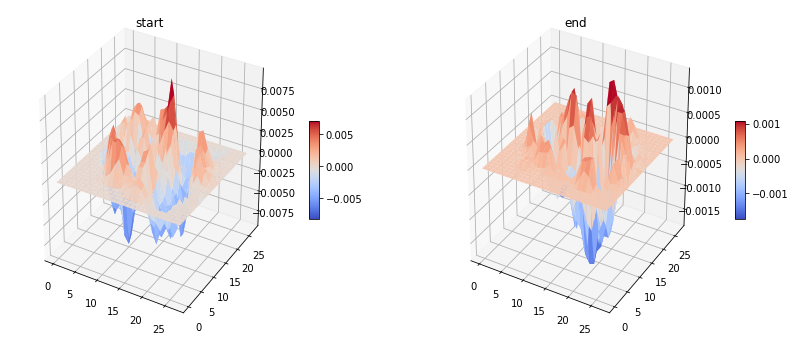

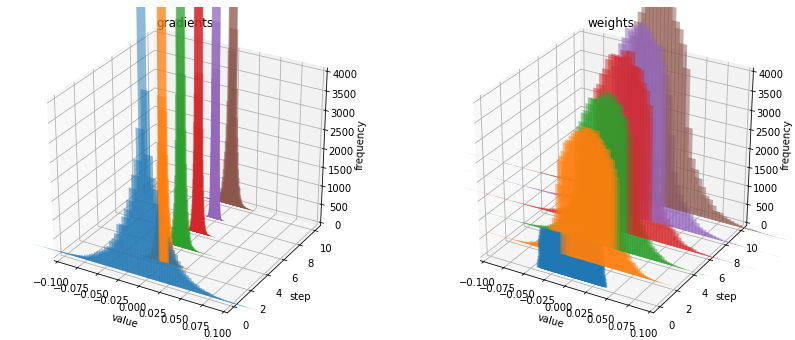

activation:  SELU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.426835 |  ACC: 0.234375
[0201/0936]	 Loss: 0.725265 |  ACC: 0.847076
[0401/0936]	 Loss: 0.603504 |  ACC: 0.873912
[0601/0936]	 Loss: 0.527032 |  ACC: 0.888704
[0801/0936]	 Loss: 0.471310 |  ACC: 0.899860
[0936/0936]	 Loss: 0.441080 |  ACC: 0.905883
validation:	Loss: 0.204623 | ACC: 0.952900
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.234267 |  ACC: 0.937500
[0201/0936]	 Loss: 0.240709 |  ACC: 0.942605
[0401/0936]	 Loss: 0.232078 |  ACC: 0.945040
[0601/0936]	 Loss: 0.224630 |  ACC: 0.946532
[0801/0936]	 Loss: 0.218472 |  ACC: 0.947709
[0936/0936]	 Loss: 0.213552 |  ACC: 0.948723
validation:	Loss: 0.143990 | ACC: 0.962500
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.132984 |  ACC: 0.968750
[0201/0936]	 Loss: 0.161588 |  ACC: 0.958926
[0401/0936]	 Loss: 0.165388 |  ACC: 0.958333
[0601/0936]	 Loss: 0.166843 |  ACC: 0.957408
[0801/0936]	 Loss: 0.161576 |  ACC: 0.958405
[0936/0936]	 Loss: 0.160361 |  ACC

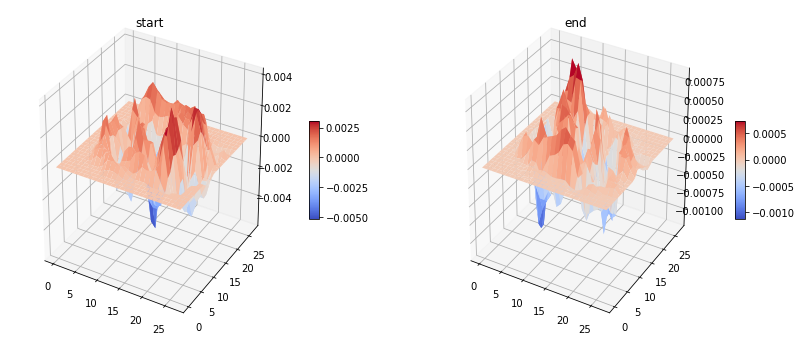

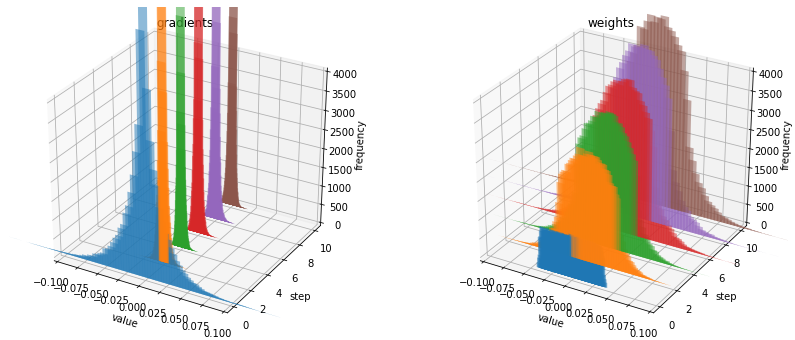

activation:  GELU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.333436 |  ACC: 0.156250
[0201/0936]	 Loss: 0.681063 |  ACC: 0.879254
[0401/0936]	 Loss: 0.534096 |  ACC: 0.909321
[0601/0936]	 Loss: 0.458013 |  ACC: 0.920837
[0801/0936]	 Loss: 0.404014 |  ACC: 0.929551
[0936/0936]	 Loss: 0.377257 |  ACC: 0.933398
validation:	Loss: 0.147285 | ACC: 0.971700
time: 0:15

Train Epoch: 001
[0001/0936]	 Loss: 0.226083 |  ACC: 0.960938
[0201/0936]	 Loss: 0.180368 |  ACC: 0.963954
[0401/0936]	 Loss: 0.173682 |  ACC: 0.964669
[0601/0936]	 Loss: 0.167292 |  ACC: 0.965220
[0801/0936]	 Loss: 0.162670 |  ACC: 0.965418
[0936/0936]	 Loss: 0.159882 |  ACC: 0.965682
validation:	Loss: 0.098993 | ACC: 0.976400
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.122954 |  ACC: 0.960938
[0201/0936]	 Loss: 0.122010 |  ACC: 0.972695
[0401/0936]	 Loss: 0.120289 |  ACC: 0.972637
[0601/0936]	 Loss: 0.117274 |  ACC: 0.973085
[0801/0936]	 Loss: 0.114871 |  ACC: 0.973738
[0936/0936]	 Loss: 0.114458 |  ACC

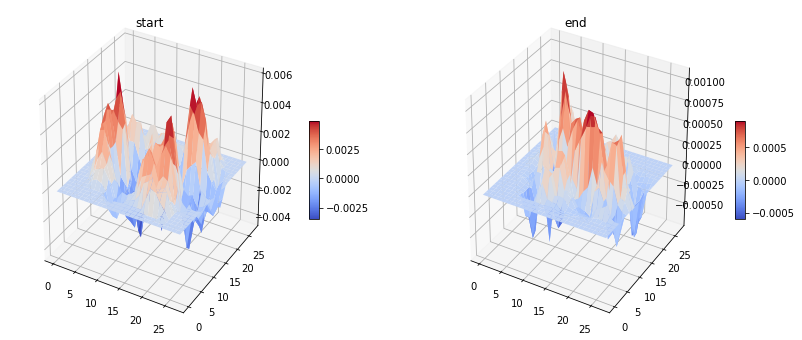

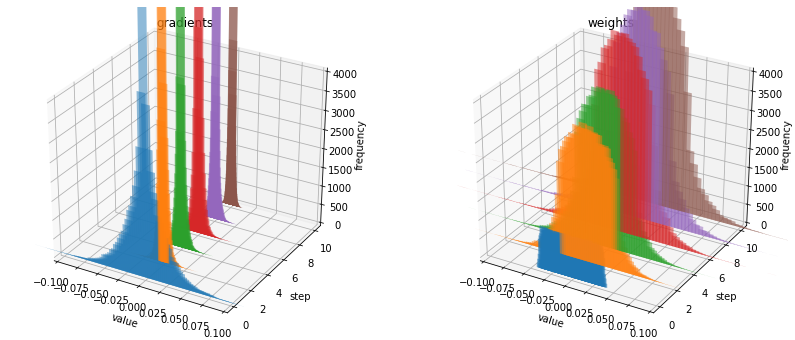

activation:  SiLU
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.282544 |  ACC: 0.195312
[0201/0936]	 Loss: 0.704392 |  ACC: 0.885442
[0401/0936]	 Loss: 0.555091 |  ACC: 0.910914
[0601/0936]	 Loss: 0.472419 |  ACC: 0.922965
[0801/0936]	 Loss: 0.419250 |  ACC: 0.929902
[0936/0936]	 Loss: 0.390693 |  ACC: 0.933565
validation:	Loss: 0.149296 | ACC: 0.970800
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.120910 |  ACC: 0.984375
[0201/0936]	 Loss: 0.189145 |  ACC: 0.962098
[0401/0936]	 Loss: 0.179942 |  ACC: 0.963464
[0601/0936]	 Loss: 0.176391 |  ACC: 0.962728
[0801/0936]	 Loss: 0.170227 |  ACC: 0.963704
[0936/0936]	 Loss: 0.167512 |  ACC: 0.963797
validation:	Loss: 0.103539 | ACC: 0.974900
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.144551 |  ACC: 0.953125
[0201/0936]	 Loss: 0.127138 |  ACC: 0.968441
[0401/0936]	 Loss: 0.123886 |  ACC: 0.969916
[0601/0936]	 Loss: 0.121626 |  ACC: 0.970619
[0801/0936]	 Loss: 0.120675 |  ACC: 0.970718
[0936/0936]	 Loss: 0.120011 |  ACC

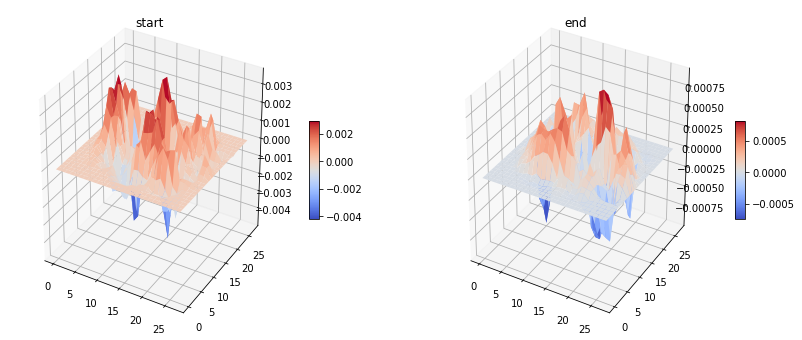

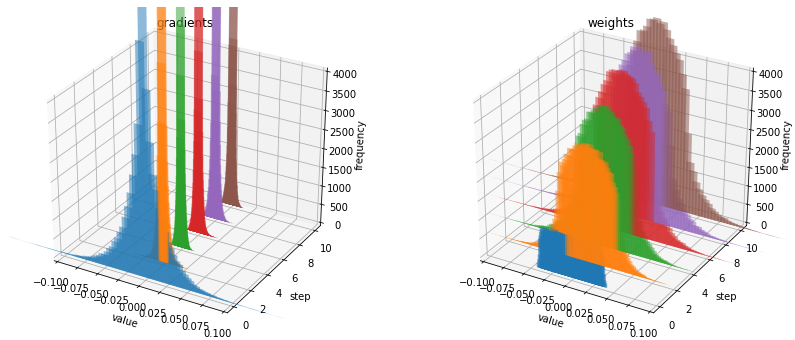

activation:  Hardswish
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.192501 |  ACC: 0.242188
[0201/0936]	 Loss: 0.734992 |  ACC: 0.873144
[0401/0936]	 Loss: 0.577371 |  ACC: 0.902907
[0601/0936]	 Loss: 0.491637 |  ACC: 0.916450
[0801/0936]	 Loss: 0.436787 |  ACC: 0.924077
[0936/0936]	 Loss: 0.407695 |  ACC: 0.928178
validation:	Loss: 0.174564 | ACC: 0.969100
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.184024 |  ACC: 0.976562
[0201/0936]	 Loss: 0.207604 |  ACC: 0.959777
[0401/0936]	 Loss: 0.197047 |  ACC: 0.960238
[0601/0936]	 Loss: 0.186969 |  ACC: 0.961379
[0801/0936]	 Loss: 0.181848 |  ACC: 0.961444
[0936/0936]	 Loss: 0.178210 |  ACC: 0.961529
validation:	Loss: 0.104815 | ACC: 0.976400
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.139347 |  ACC: 0.968750
[0201/0936]	 Loss: 0.136055 |  ACC: 0.970684
[0401/0936]	 Loss: 0.133913 |  ACC: 0.970266
[0601/0936]	 Loss: 0.132988 |  ACC: 0.970281
[0801/0936]	 Loss: 0.131076 |  ACC: 0.970270
[0936/0936]	 Loss: 0.129135 |

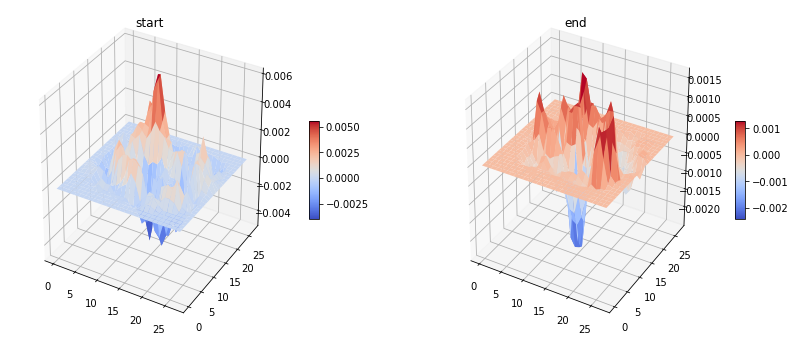

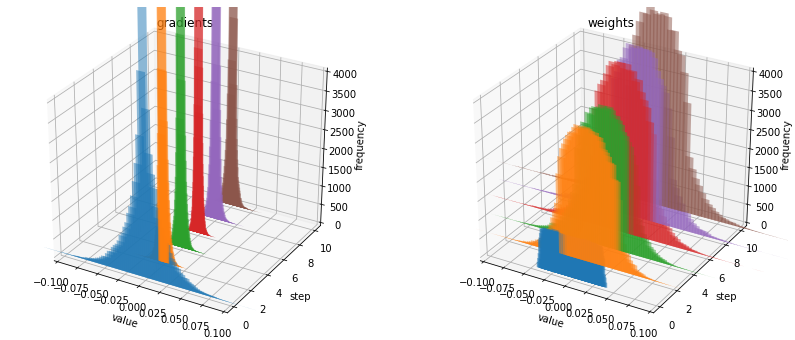

activation:  Mish
optimizer:  AdaBelief
Train Epoch: 000
[0001/0936]	 Loss: 2.143252 |  ACC: 0.281250
[0201/0936]	 Loss: 0.662473 |  ACC: 0.886061
[0401/0936]	 Loss: 0.531094 |  ACC: 0.909709
[0601/0936]	 Loss: 0.456857 |  ACC: 0.921460
[0801/0936]	 Loss: 0.408455 |  ACC: 0.928655
[0936/0936]	 Loss: 0.381415 |  ACC: 0.932714
validation:	Loss: 0.149385 | ACC: 0.970600
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.267424 |  ACC: 0.937500
[0201/0936]	 Loss: 0.197723 |  ACC: 0.960009
[0401/0936]	 Loss: 0.182059 |  ACC: 0.963270
[0601/0936]	 Loss: 0.178164 |  ACC: 0.963222
[0801/0936]	 Loss: 0.173278 |  ACC: 0.963431
[0936/0936]	 Loss: 0.169341 |  ACC: 0.963847
validation:	Loss: 0.110831 | ACC: 0.974000
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.106988 |  ACC: 0.992188
[0201/0936]	 Loss: 0.130527 |  ACC: 0.969678
[0401/0936]	 Loss: 0.123568 |  ACC: 0.970421
[0601/0936]	 Loss: 0.120940 |  ACC: 0.971138
[0801/0936]	 Loss: 0.121702 |  ACC: 0.970425
[0936/0936]	 Loss: 0.120635 |  ACC

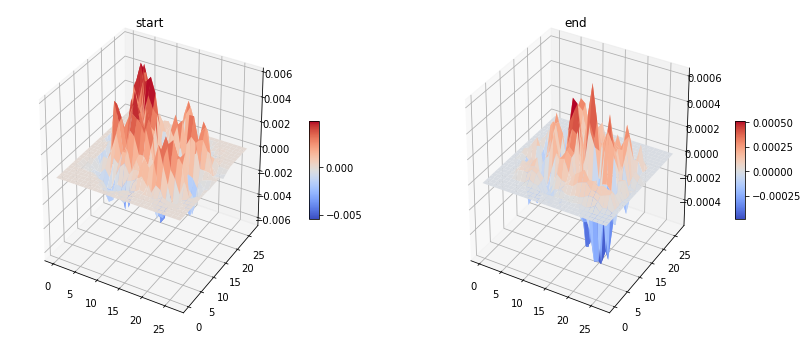

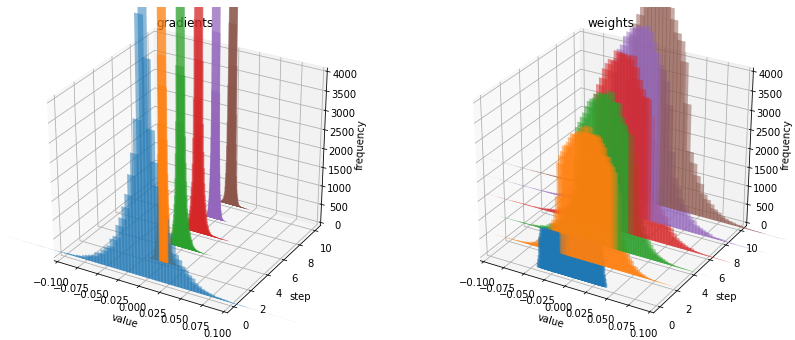

activation:  Sigmoid
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.207102 |  ACC: 0.273438
[0201/0936]	 Loss: 1.918932 |  ACC: 0.838258
[0401/0936]	 Loss: 1.888086 |  ACC: 0.854672
[0601/0936]	 Loss: 1.861945 |  ACC: 0.865397
[0801/0936]	 Loss: 1.839836 |  ACC: 0.871727
[0936/0936]	 Loss: 1.825939 |  ACC: 0.876784
validation:	Loss: 1.723715 | ACC: 0.923000
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 1.727415 |  ACC: 0.906250
[0201/0936]	 Loss: 1.716810 |  ACC: 0.913057
[0401/0936]	 Loss: 1.705456 |  ACC: 0.913518
[0601/0936]	 Loss: 1.695095 |  ACC: 0.915594
[0801/0936]	 Loss: 1.684834 |  ACC: 0.918875
[0936/0936]	 Loss: 1.678616 |  ACC: 0.920591
validation:	Loss: 1.626195 | ACC: 0.939800
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 1.642517 |  ACC: 0.921875
[0201/0936]	 Loss: 1.630359 |  ACC: 0.930925
[0401/0936]	 Loss: 1.625181 |  ACC: 0.931048
[0601/0936]	 Loss: 1.618299 |  ACC: 0.934204
[0801/0936]	 Loss: 1.613272 |  ACC: 0.935825
[0936/0936]	 Loss: 1.610397 |  A

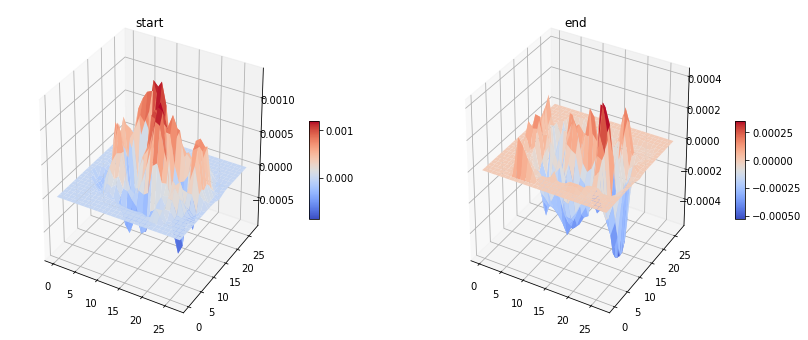

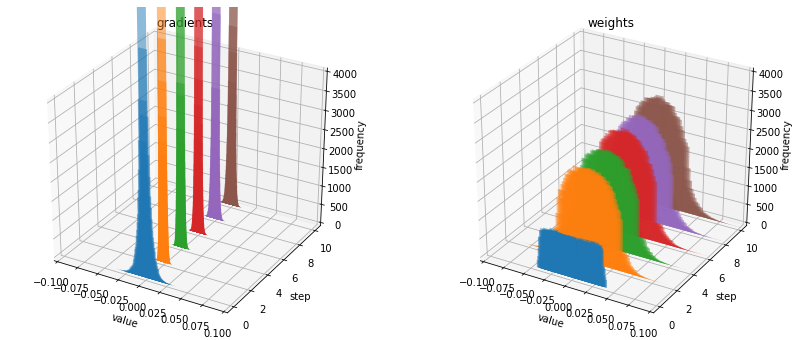

activation:  Tanh
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.413231 |  ACC: 0.101562
[0201/0936]	 Loss: 1.423797 |  ACC: 0.833772
[0401/0936]	 Loss: 1.335551 |  ACC: 0.861435
[0601/0936]	 Loss: 1.270421 |  ACC: 0.877388
[0801/0936]	 Loss: 1.218898 |  ACC: 0.888677
[0936/0936]	 Loss: 1.190202 |  ACC: 0.894961
validation:	Loss: 0.975852 | ACC: 0.948500
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 1.012472 |  ACC: 0.929688
[0201/0936]	 Loss: 0.990058 |  ACC: 0.939202
[0401/0936]	 Loss: 0.976425 |  ACC: 0.941892
[0601/0936]	 Loss: 0.968115 |  ACC: 0.942821
[0801/0936]	 Loss: 0.960416 |  ACC: 0.944241
[0936/0936]	 Loss: 0.955764 |  ACC: 0.945521
validation:	Loss: 0.902466 | ACC: 0.960500
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.888021 |  ACC: 0.968750
[0201/0936]	 Loss: 0.914998 |  ACC: 0.955678
[0401/0936]	 Loss: 0.913918 |  ACC: 0.955302
[0601/0936]	 Loss: 0.911311 |  ACC: 0.956188
[0801/0936]	 Loss: 0.909063 |  ACC: 0.956281
[0936/0936]	 Loss: 0.907791 |  ACC:

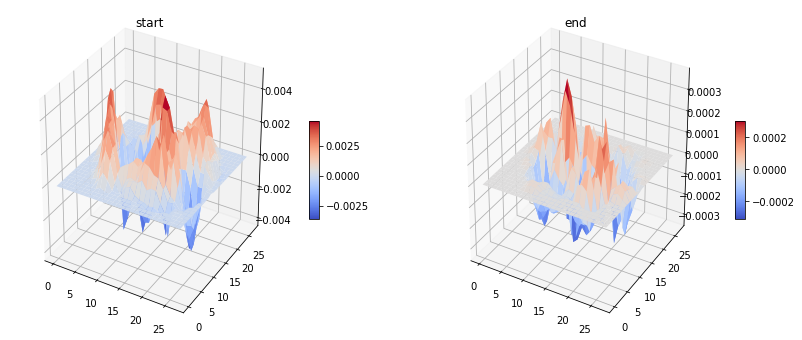

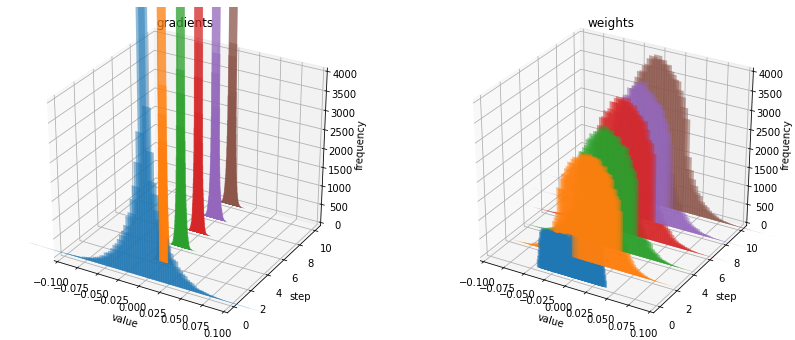

activation:  ReLU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.365240 |  ACC: 0.156250
[0201/0936]	 Loss: 0.731787 |  ACC: 0.873762
[0401/0936]	 Loss: 0.581806 |  ACC: 0.905861
[0601/0936]	 Loss: 0.492098 |  ACC: 0.919150
[0801/0936]	 Loss: 0.432939 |  ACC: 0.926570
[0936/0936]	 Loss: 0.399989 |  ACC: 0.931630
validation:	Loss: 0.139969 | ACC: 0.971300
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.194365 |  ACC: 0.945312
[0201/0936]	 Loss: 0.180225 |  ACC: 0.962252
[0401/0936]	 Loss: 0.173050 |  ACC: 0.961443
[0601/0936]	 Loss: 0.163762 |  ACC: 0.963144
[0801/0936]	 Loss: 0.158954 |  ACC: 0.963840
[0936/0936]	 Loss: 0.155363 |  ACC: 0.964531
validation:	Loss: 0.089095 | ACC: 0.977800
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.177573 |  ACC: 0.953125
[0201/0936]	 Loss: 0.112883 |  ACC: 0.972231
[0401/0936]	 Loss: 0.112846 |  ACC: 0.972015
[0601/0936]	 Loss: 0.111159 |  ACC: 0.972176
[0801/0936]	 Loss: 0.108114 |  ACC: 0.972958
[0936/0936]	 Loss: 0.107759 |  ACC:

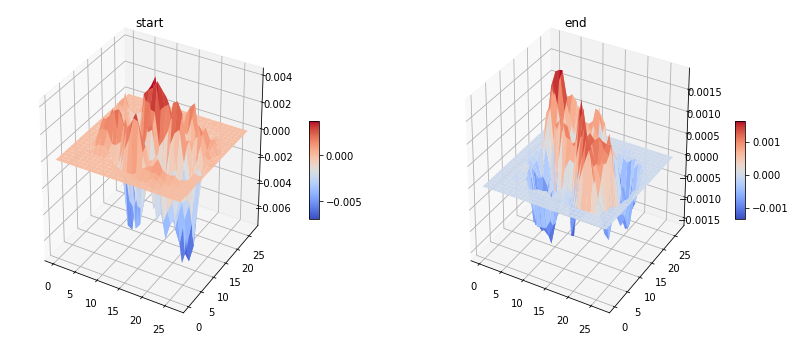

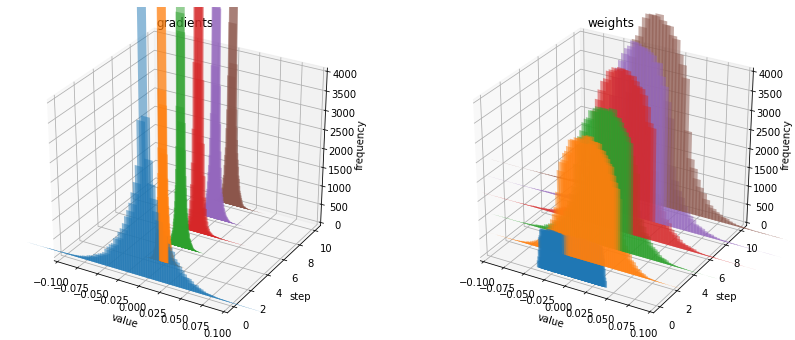

activation:  LeakyReLU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.312938 |  ACC: 0.203125
[0201/0936]	 Loss: 0.742063 |  ACC: 0.872679
[0401/0936]	 Loss: 0.590242 |  ACC: 0.905978
[0601/0936]	 Loss: 0.495467 |  ACC: 0.921226
[0801/0936]	 Loss: 0.435429 |  ACC: 0.928382
[0936/0936]	 Loss: 0.403341 |  ACC: 0.932447
validation:	Loss: 0.135199 | ACC: 0.970300
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.191387 |  ACC: 0.984375
[0201/0936]	 Loss: 0.179253 |  ACC: 0.964573
[0401/0936]	 Loss: 0.169072 |  ACC: 0.964513
[0601/0936]	 Loss: 0.163797 |  ACC: 0.963870
[0801/0936]	 Loss: 0.157265 |  ACC: 0.964503
[0936/0936]	 Loss: 0.153373 |  ACC: 0.964681
validation:	Loss: 0.086903 | ACC: 0.979400
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.046283 |  ACC: 1.000000
[0201/0936]	 Loss: 0.110202 |  ACC: 0.974242
[0401/0936]	 Loss: 0.109620 |  ACC: 0.973919
[0601/0936]	 Loss: 0.110917 |  ACC: 0.972695
[0801/0936]	 Loss: 0.108270 |  ACC: 0.973738
[0936/0936]	 Loss: 0.106762 | 

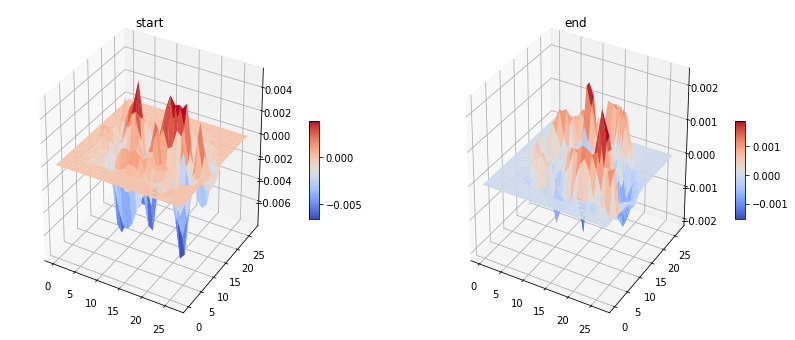

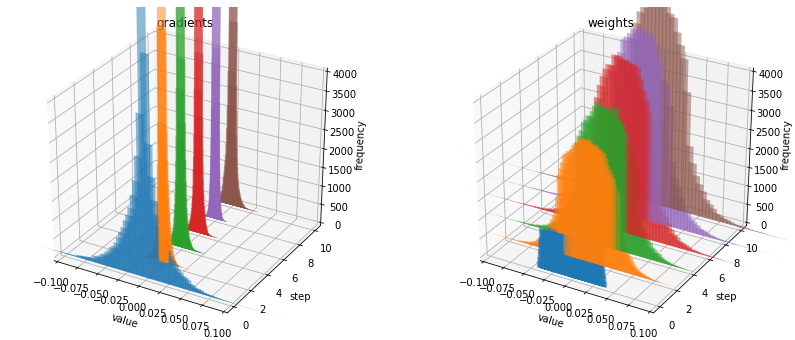

activation:  ReLU6
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.266229 |  ACC: 0.179688
[0201/0936]	 Loss: 0.722577 |  ACC: 0.880028
[0401/0936]	 Loss: 0.581546 |  ACC: 0.908193
[0601/0936]	 Loss: 0.494260 |  ACC: 0.919902
[0801/0936]	 Loss: 0.432203 |  ACC: 0.928421
[0936/0936]	 Loss: 0.402060 |  ACC: 0.932014
validation:	Loss: 0.147518 | ACC: 0.970800
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.165150 |  ACC: 0.968750
[0201/0936]	 Loss: 0.178873 |  ACC: 0.964186
[0401/0936]	 Loss: 0.172791 |  ACC: 0.963347
[0601/0936]	 Loss: 0.171544 |  ACC: 0.962702
[0801/0936]	 Loss: 0.164372 |  ACC: 0.964113
[0936/0936]	 Loss: 0.161769 |  ACC: 0.964431
validation:	Loss: 0.105114 | ACC: 0.975900
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.100797 |  ACC: 0.968750
[0201/0936]	 Loss: 0.123105 |  ACC: 0.974242
[0401/0936]	 Loss: 0.120469 |  ACC: 0.973997
[0601/0936]	 Loss: 0.121406 |  ACC: 0.973811
[0801/0936]	 Loss: 0.121467 |  ACC: 0.973796
[0936/0936]	 Loss: 0.120549 |  ACC

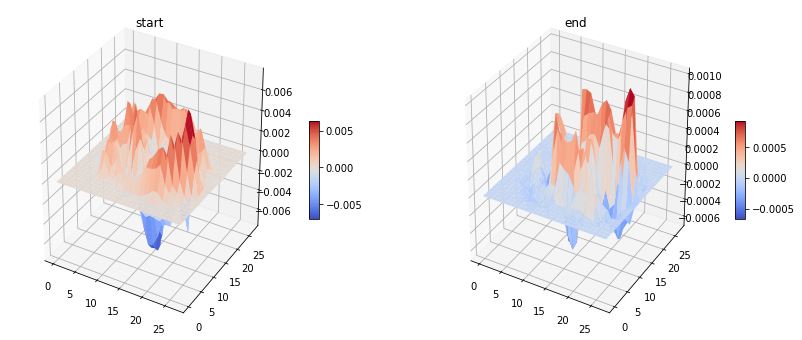

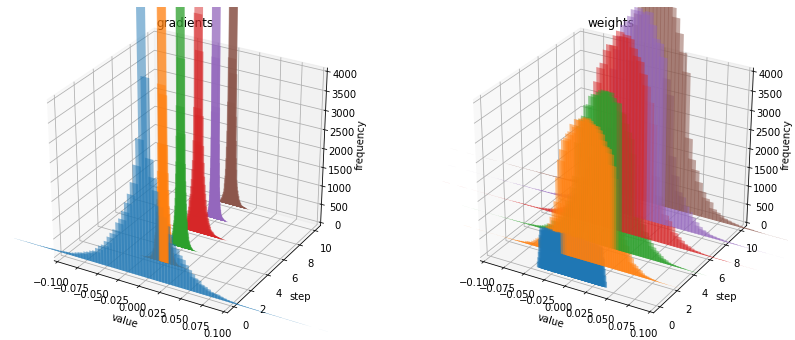

activation:  SELU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.426893 |  ACC: 0.226562
[0201/0936]	 Loss: 0.732830 |  ACC: 0.853496
[0401/0936]	 Loss: 0.606989 |  ACC: 0.881530
[0601/0936]	 Loss: 0.529610 |  ACC: 0.895089
[0801/0936]	 Loss: 0.471018 |  ACC: 0.904380
[0936/0936]	 Loss: 0.442709 |  ACC: 0.908801
validation:	Loss: 0.194685 | ACC: 0.956500
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.204679 |  ACC: 0.960938
[0201/0936]	 Loss: 0.225751 |  ACC: 0.944462
[0401/0936]	 Loss: 0.216902 |  ACC: 0.945585
[0601/0936]	 Loss: 0.211823 |  ACC: 0.946818
[0801/0936]	 Loss: 0.205988 |  ACC: 0.948079
[0936/0936]	 Loss: 0.200711 |  ACC: 0.949223
validation:	Loss: 0.130927 | ACC: 0.964400
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.157343 |  ACC: 0.953125
[0201/0936]	 Loss: 0.152579 |  ACC: 0.960319
[0401/0936]	 Loss: 0.156914 |  ACC: 0.958372
[0601/0936]	 Loss: 0.153931 |  ACC: 0.959173
[0801/0936]	 Loss: 0.151595 |  ACC: 0.960041
[0936/0936]	 Loss: 0.150652 |  ACC:

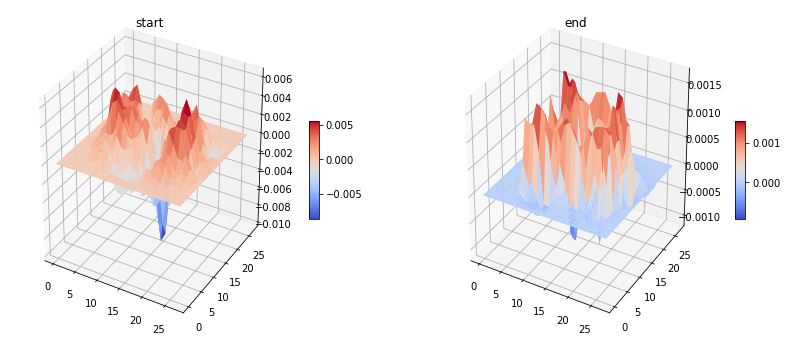

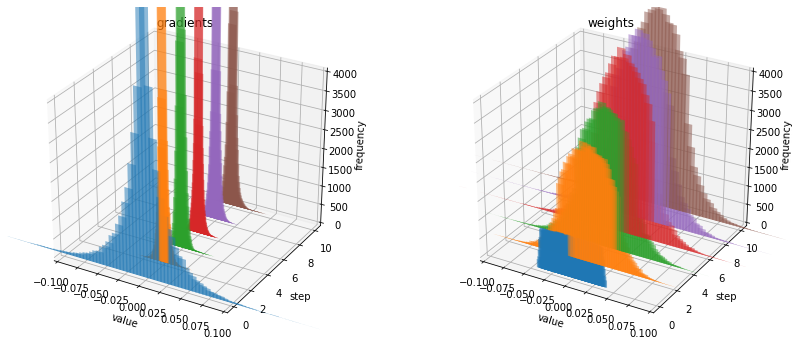

activation:  GELU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.367177 |  ACC: 0.171875
[0201/0936]	 Loss: 0.688594 |  ACC: 0.884978
[0401/0936]	 Loss: 0.555124 |  ACC: 0.911109
[0601/0936]	 Loss: 0.471969 |  ACC: 0.922939
[0801/0936]	 Loss: 0.416132 |  ACC: 0.929882
[0936/0936]	 Loss: 0.385919 |  ACC: 0.933748
validation:	Loss: 0.148431 | ACC: 0.967400
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.163588 |  ACC: 0.968750
[0201/0936]	 Loss: 0.172233 |  ACC: 0.965579
[0401/0936]	 Loss: 0.166205 |  ACC: 0.965252
[0601/0936]	 Loss: 0.159713 |  ACC: 0.965713
[0801/0936]	 Loss: 0.153700 |  ACC: 0.965828
[0936/0936]	 Loss: 0.149234 |  ACC: 0.966532
validation:	Loss: 0.084772 | ACC: 0.978400
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.060964 |  ACC: 0.992188
[0201/0936]	 Loss: 0.104707 |  ACC: 0.975866
[0401/0936]	 Loss: 0.104746 |  ACC: 0.975474
[0601/0936]	 Loss: 0.105925 |  ACC: 0.974642
[0801/0936]	 Loss: 0.104996 |  ACC: 0.974244
[0936/0936]	 Loss: 0.103413 |  ACC:

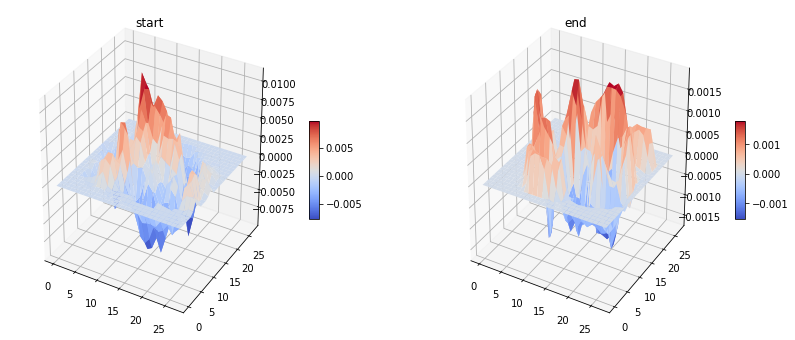

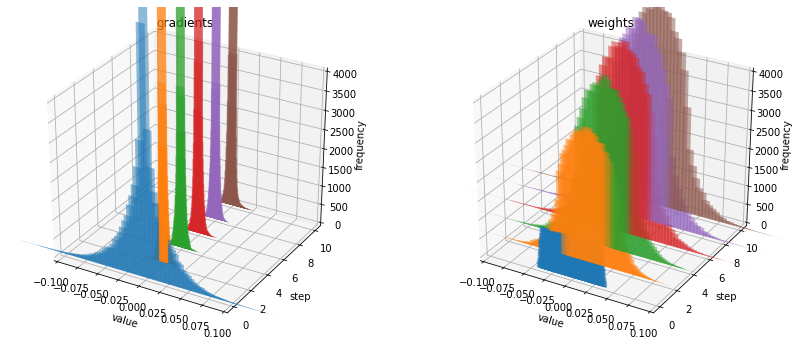

activation:  SiLU
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.200284 |  ACC: 0.187500
[0201/0936]	 Loss: 0.736584 |  ACC: 0.884669
[0401/0936]	 Loss: 0.595511 |  ACC: 0.908699
[0601/0936]	 Loss: 0.502145 |  ACC: 0.920655
[0801/0936]	 Loss: 0.435746 |  ACC: 0.929239
[0936/0936]	 Loss: 0.404695 |  ACC: 0.933014
validation:	Loss: 0.140178 | ACC: 0.972300
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.191743 |  ACC: 0.968750
[0201/0936]	 Loss: 0.174124 |  ACC: 0.964573
[0401/0936]	 Loss: 0.170594 |  ACC: 0.963581
[0601/0936]	 Loss: 0.165497 |  ACC: 0.963715
[0801/0936]	 Loss: 0.159287 |  ACC: 0.964133
[0936/0936]	 Loss: 0.155984 |  ACC: 0.964281
validation:	Loss: 0.086812 | ACC: 0.977900
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.100231 |  ACC: 0.984375
[0201/0936]	 Loss: 0.107341 |  ACC: 0.974397
[0401/0936]	 Loss: 0.109826 |  ACC: 0.971976
[0601/0936]	 Loss: 0.109972 |  ACC: 0.971891
[0801/0936]	 Loss: 0.108108 |  ACC: 0.972120
[0936/0936]	 Loss: 0.108700 |  ACC:

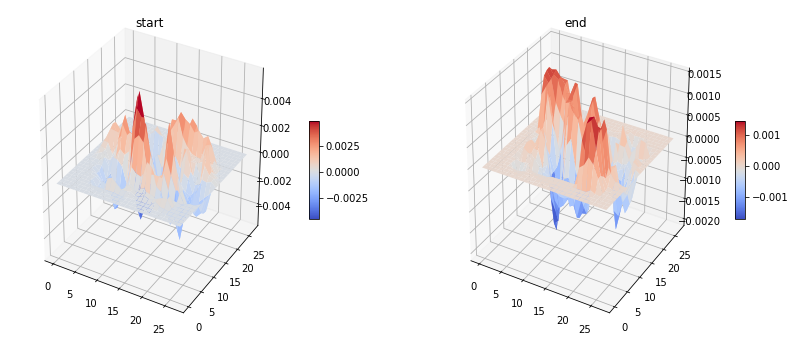

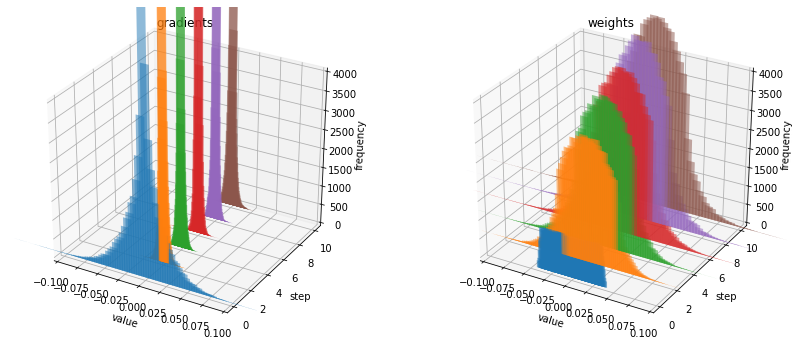

activation:  Hardswish
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.339423 |  ACC: 0.171875
[0201/0936]	 Loss: 0.756725 |  ACC: 0.877707
[0401/0936]	 Loss: 0.595950 |  ACC: 0.906716
[0601/0936]	 Loss: 0.504993 |  ACC: 0.918060
[0801/0936]	 Loss: 0.442423 |  ACC: 0.925479
[0936/0936]	 Loss: 0.411935 |  ACC: 0.928862
validation:	Loss: 0.149462 | ACC: 0.966500
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.179467 |  ACC: 0.960938
[0201/0936]	 Loss: 0.179238 |  ACC: 0.961170
[0401/0936]	 Loss: 0.176203 |  ACC: 0.960938
[0601/0936]	 Loss: 0.169368 |  ACC: 0.961223
[0801/0936]	 Loss: 0.162466 |  ACC: 0.962321
[0936/0936]	 Loss: 0.158644 |  ACC: 0.962713
validation:	Loss: 0.098551 | ACC: 0.976700
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.156269 |  ACC: 0.960938
[0201/0936]	 Loss: 0.116176 |  ACC: 0.973855
[0401/0936]	 Loss: 0.117669 |  ACC: 0.972248
[0601/0936]	 Loss: 0.117512 |  ACC: 0.971605
[0801/0936]	 Loss: 0.115883 |  ACC: 0.971517
[0936/0936]	 Loss: 0.114158 | 

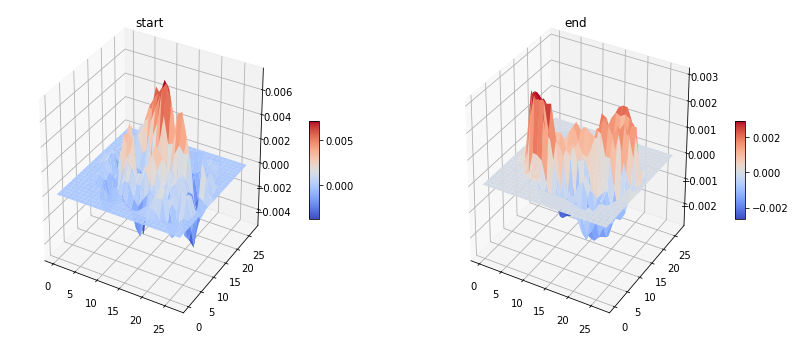

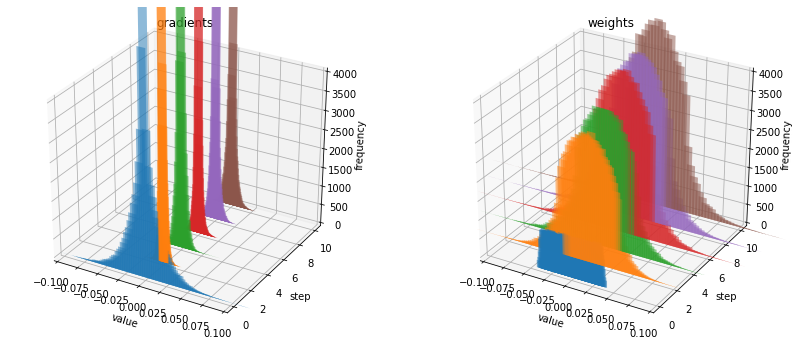

activation:  Mish
optimizer:  AdaBound
Train Epoch: 000
[0001/0936]	 Loss: 2.121304 |  ACC: 0.265625
[0201/0936]	 Loss: 0.697160 |  ACC: 0.883895
[0401/0936]	 Loss: 0.563512 |  ACC: 0.910525
[0601/0936]	 Loss: 0.478512 |  ACC: 0.923121
[0801/0936]	 Loss: 0.420393 |  ACC: 0.930272
[0936/0936]	 Loss: 0.390640 |  ACC: 0.934031
validation:	Loss: 0.152456 | ACC: 0.970000
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.259279 |  ACC: 0.953125
[0201/0936]	 Loss: 0.179861 |  ACC: 0.962252
[0401/0936]	 Loss: 0.172585 |  ACC: 0.963114
[0601/0936]	 Loss: 0.166663 |  ACC: 0.963533
[0801/0936]	 Loss: 0.159870 |  ACC: 0.964308
[0936/0936]	 Loss: 0.157299 |  ACC: 0.964164
validation:	Loss: 0.094992 | ACC: 0.976800
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.138356 |  ACC: 0.953125
[0201/0936]	 Loss: 0.119399 |  ACC: 0.971380
[0401/0936]	 Loss: 0.110652 |  ACC: 0.972987
[0601/0936]	 Loss: 0.108479 |  ACC: 0.973162
[0801/0936]	 Loss: 0.108607 |  ACC: 0.972861
[0936/0936]	 Loss: 0.108209 |  ACC:

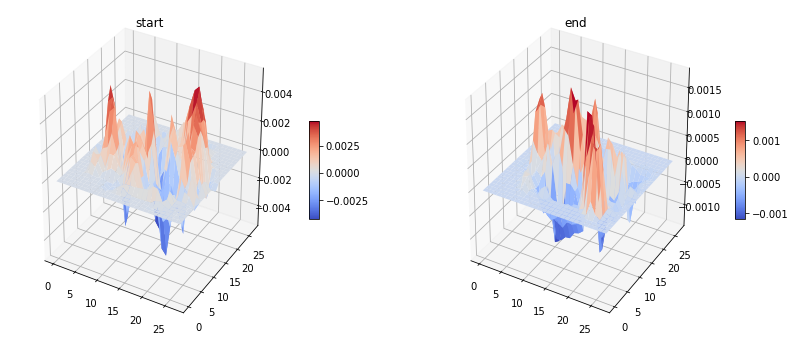

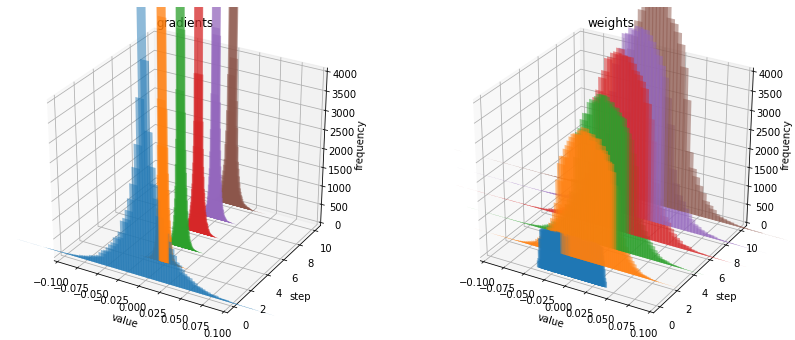

activation:  Sigmoid
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.296954 |  ACC: 0.093750
[0201/0936]	 Loss: 2.009765 |  ACC: 0.700650
[0401/0936]	 Loss: 1.964863 |  ACC: 0.774992
[0601/0936]	 Loss: 1.938509 |  ACC: 0.805388
[0801/0936]	 Loss: 1.918238 |  ACC: 0.821579
[0936/0936]	 Loss: 1.905709 |  ACC: 0.829442
validation:	Loss: 1.824351 | ACC: 0.900200
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 1.813693 |  ACC: 0.921875
[0201/0936]	 Loss: 1.802858 |  ACC: 0.893100
[0401/0936]	 Loss: 1.786826 |  ACC: 0.899059
[0601/0936]	 Loss: 1.771942 |  ACC: 0.904459
[0801/0936]	 Loss: 1.757413 |  ACC: 0.908958
[0936/0936]	 Loss: 1.748382 |  ACC: 0.911169
validation:	Loss: 1.673768 | ACC: 0.932700
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 1.676853 |  ACC: 0.945312
[0201/0936]	 Loss: 1.672390 |  ACC: 0.934793
[0401/0936]	 Loss: 1.664857 |  ACC: 0.934818
[0601/0936]	 Loss: 1.656172 |  ACC: 0.937422
[0801/0936]	 Loss: 1.648694 |  ACC: 0.937734
[0936/0936]	 Loss: 1.643685 |  ACC

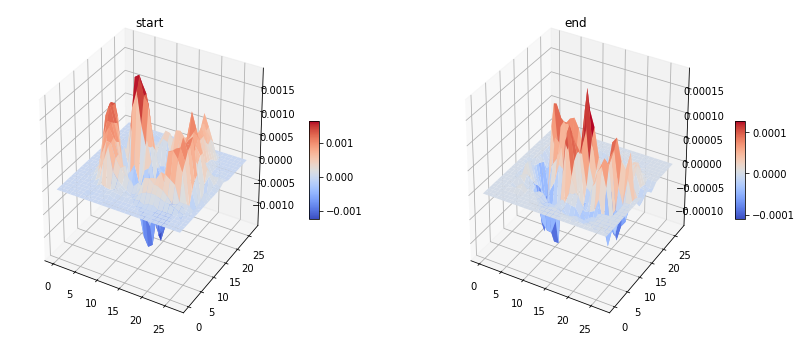

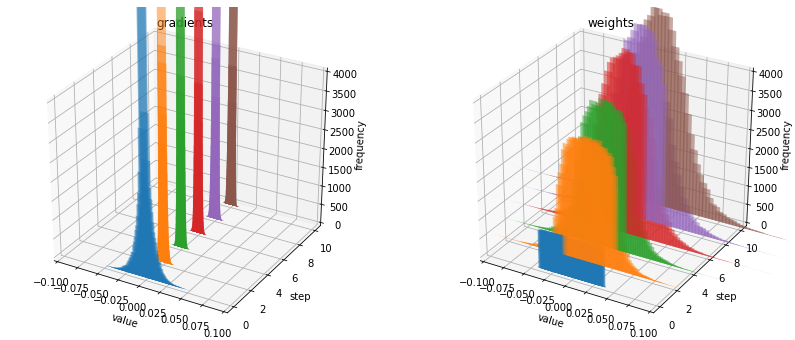

activation:  Tanh
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.599009 |  ACC: 0.078125
[0201/0936]	 Loss: 1.671547 |  ACC: 0.671488
[0401/0936]	 Loss: 1.551146 |  ACC: 0.756919
[0601/0936]	 Loss: 1.482111 |  ACC: 0.794850
[0801/0936]	 Loss: 1.427581 |  ACC: 0.818462
[0936/0936]	 Loss: 1.394837 |  ACC: 0.830276
validation:	Loss: 1.176790 | ACC: 0.914900
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 1.159110 |  ACC: 0.929688
[0201/0936]	 Loss: 1.150411 |  ACC: 0.912748
[0401/0936]	 Loss: 1.125662 |  ACC: 0.917677
[0601/0936]	 Loss: 1.103043 |  ACC: 0.923121
[0801/0936]	 Loss: 1.085081 |  ACC: 0.926434
[0936/0936]	 Loss: 1.073855 |  ACC: 0.928112
validation:	Loss: 0.981261 | ACC: 0.952400
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.984738 |  ACC: 0.968750
[0201/0936]	 Loss: 0.984924 |  ACC: 0.946395
[0401/0936]	 Loss: 0.979097 |  ACC: 0.946362
[0601/0936]	 Loss: 0.971634 |  ACC: 0.947960
[0801/0936]	 Loss: 0.965878 |  ACC: 0.948060
[0936/0936]	 Loss: 0.962639 |  ACC: 0

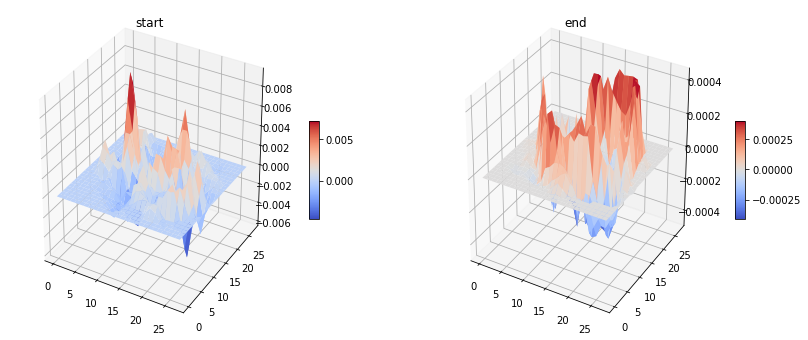

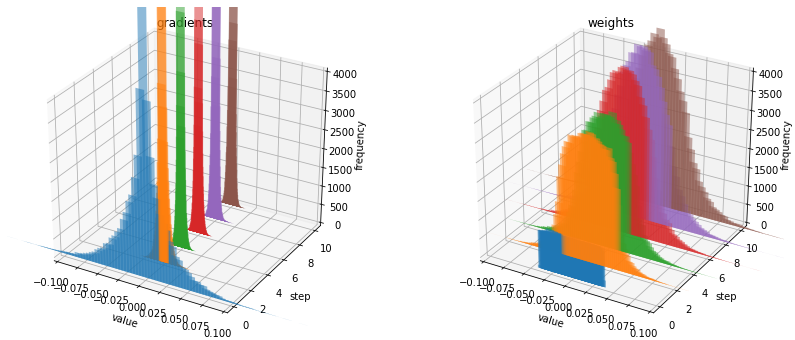

activation:  ReLU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.487412 |  ACC: 0.101562
[0201/0936]	 Loss: 1.259566 |  ACC: 0.695699
[0401/0936]	 Loss: 0.996706 |  ACC: 0.795165
[0601/0936]	 Loss: 0.858826 |  ACC: 0.838170
[0801/0936]	 Loss: 0.764018 |  ACC: 0.863388
[0936/0936]	 Loss: 0.713370 |  ACC: 0.875083
validation:	Loss: 0.320672 | ACC: 0.958300
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.408420 |  ACC: 0.945312
[0201/0936]	 Loss: 0.363351 |  ACC: 0.952351
[0401/0936]	 Loss: 0.341023 |  ACC: 0.953514
[0601/0936]	 Loss: 0.325216 |  ACC: 0.953670
[0801/0936]	 Loss: 0.308644 |  ACC: 0.955015
[0936/0936]	 Loss: 0.298881 |  ACC: 0.955593
validation:	Loss: 0.173043 | ACC: 0.972700
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.208777 |  ACC: 0.968750
[0201/0936]	 Loss: 0.209945 |  ACC: 0.966429
[0401/0936]	 Loss: 0.205422 |  ACC: 0.965602
[0601/0936]	 Loss: 0.197531 |  ACC: 0.966103
[0801/0936]	 Loss: 0.192227 |  ACC: 0.966217
[0936/0936]	 Loss: 0.189125 |  ACC: 0

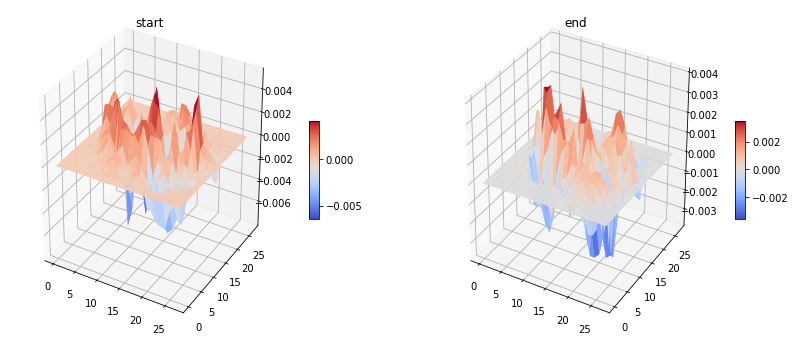

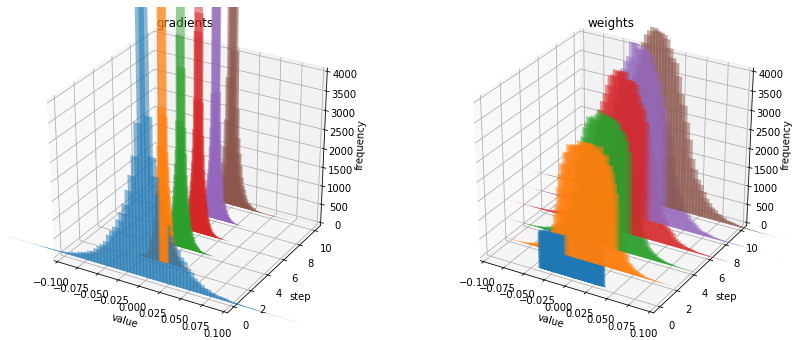

activation:  LeakyReLU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.447468 |  ACC: 0.093750
[0201/0936]	 Loss: 1.227865 |  ACC: 0.703821
[0401/0936]	 Loss: 0.965265 |  ACC: 0.801695
[0601/0936]	 Loss: 0.829559 |  ACC: 0.842686
[0801/0936]	 Loss: 0.736807 |  ACC: 0.866330
[0936/0936]	 Loss: 0.689208 |  ACC: 0.877101
validation:	Loss: 0.307144 | ACC: 0.958200
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.383695 |  ACC: 0.953125
[0201/0936]	 Loss: 0.353921 |  ACC: 0.949335
[0401/0936]	 Loss: 0.331787 |  ACC: 0.951842
[0601/0936]	 Loss: 0.316747 |  ACC: 0.952606
[0801/0936]	 Loss: 0.300625 |  ACC: 0.953963
[0936/0936]	 Loss: 0.289411 |  ACC: 0.955426
validation:	Loss: 0.171582 | ACC: 0.969500
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.198858 |  ACC: 0.960938
[0201/0936]	 Loss: 0.201527 |  ACC: 0.967822
[0401/0936]	 Loss: 0.197801 |  ACC: 0.966262
[0601/0936]	 Loss: 0.192433 |  ACC: 0.966518
[0801/0936]	 Loss: 0.186322 |  ACC: 0.967406
[0936/0936]	 Loss: 0.182423 |  A

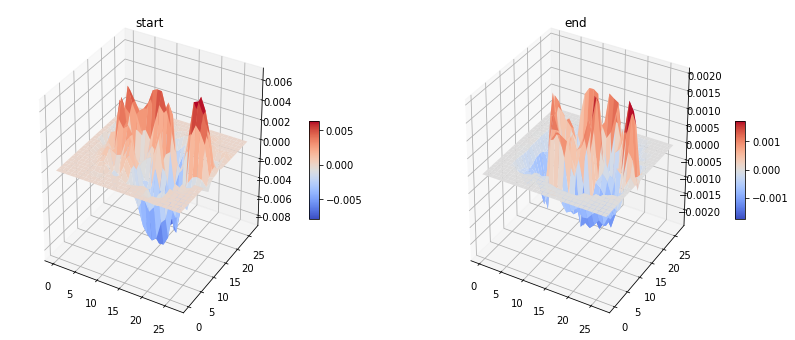

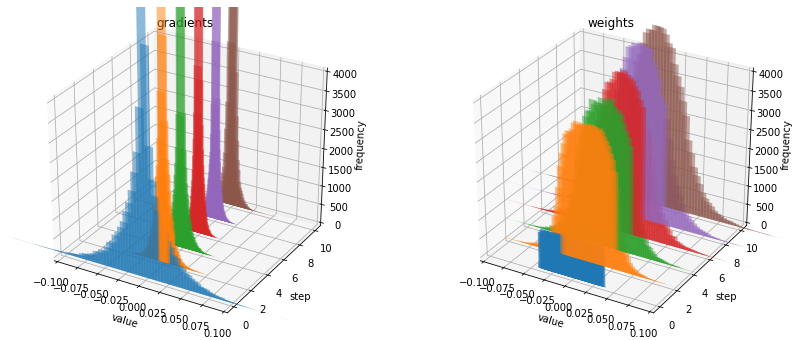

activation:  ReLU6
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.571041 |  ACC: 0.039062
[0201/0936]	 Loss: 1.284602 |  ACC: 0.680152
[0401/0936]	 Loss: 1.009353 |  ACC: 0.786381
[0601/0936]	 Loss: 0.868019 |  ACC: 0.831058
[0801/0936]	 Loss: 0.773459 |  ACC: 0.856862
[0936/0936]	 Loss: 0.723825 |  ACC: 0.868997
validation:	Loss: 0.318725 | ACC: 0.960200
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.462667 |  ACC: 0.937500
[0201/0936]	 Loss: 0.382111 |  ACC: 0.946627
[0401/0936]	 Loss: 0.354847 |  ACC: 0.949938
[0601/0936]	 Loss: 0.334926 |  ACC: 0.952606
[0801/0936]	 Loss: 0.316572 |  ACC: 0.954197
[0936/0936]	 Loss: 0.306606 |  ACC: 0.955243
validation:	Loss: 0.180436 | ACC: 0.971100
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.226160 |  ACC: 0.960938
[0201/0936]	 Loss: 0.219279 |  ACC: 0.963490
[0401/0936]	 Loss: 0.213205 |  ACC: 0.964241
[0601/0936]	 Loss: 0.206286 |  ACC: 0.965428
[0801/0936]	 Loss: 0.199815 |  ACC: 0.965691
[0936/0936]	 Loss: 0.196337 |  ACC: 

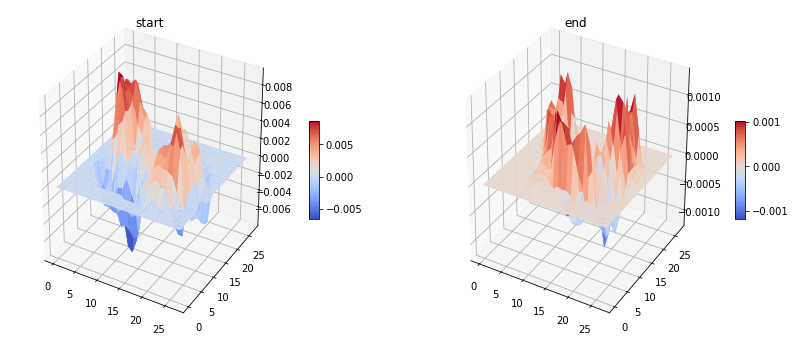

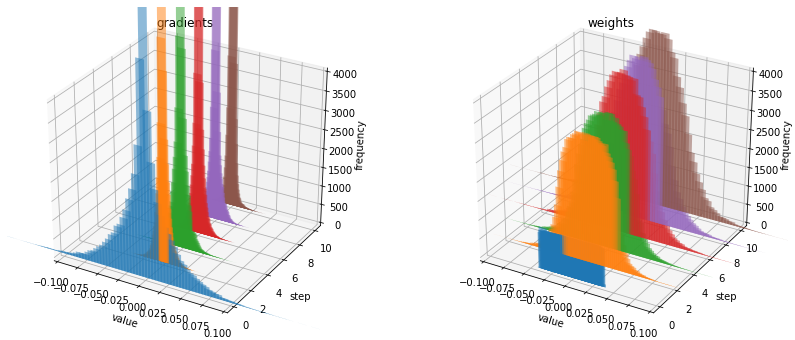

activation:  SELU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.712887 |  ACC: 0.132812
[0201/0936]	 Loss: 1.112070 |  ACC: 0.717822
[0401/0936]	 Loss: 0.914641 |  ACC: 0.794349
[0601/0936]	 Loss: 0.817722 |  ACC: 0.825296
[0801/0936]	 Loss: 0.745097 |  ACC: 0.845952
[0936/0936]	 Loss: 0.703991 |  ACC: 0.856857
validation:	Loss: 0.391063 | ACC: 0.934900
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.425217 |  ACC: 0.906250
[0201/0936]	 Loss: 0.402426 |  ACC: 0.929765
[0401/0936]	 Loss: 0.374949 |  ACC: 0.935557
[0601/0936]	 Loss: 0.355166 |  ACC: 0.937915
[0801/0936]	 Loss: 0.339954 |  ACC: 0.939137
[0936/0936]	 Loss: 0.329295 |  ACC: 0.940552
validation:	Loss: 0.218747 | ACC: 0.959300
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.231100 |  ACC: 0.968750
[0201/0936]	 Loss: 0.231031 |  ACC: 0.956296
[0401/0936]	 Loss: 0.233566 |  ACC: 0.954252
[0601/0936]	 Loss: 0.230128 |  ACC: 0.953255
[0801/0936]	 Loss: 0.223383 |  ACC: 0.954002
[0936/0936]	 Loss: 0.218162 |  ACC: 0

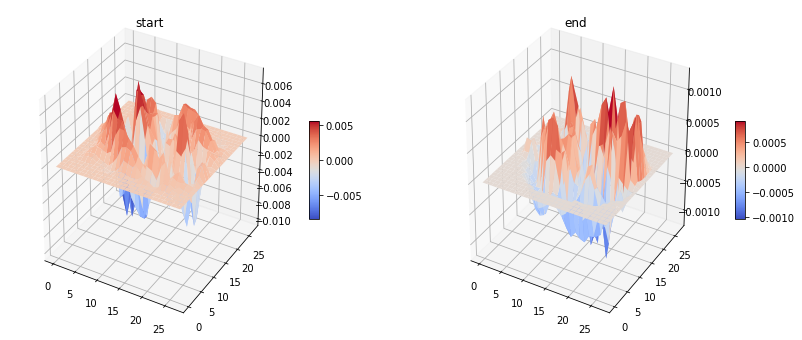

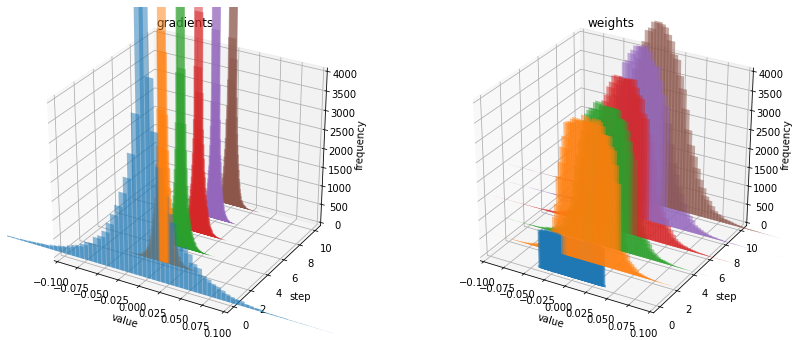

activation:  GELU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.591065 |  ACC: 0.054688
[0201/0936]	 Loss: 1.225655 |  ACC: 0.703744
[0401/0936]	 Loss: 0.959361 |  ACC: 0.803483
[0601/0936]	 Loss: 0.824343 |  ACC: 0.845178
[0801/0936]	 Loss: 0.734712 |  ACC: 0.868882
[0936/0936]	 Loss: 0.688653 |  ACC: 0.879686
validation:	Loss: 0.311541 | ACC: 0.960500
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.321606 |  ACC: 0.960938
[0201/0936]	 Loss: 0.355617 |  ACC: 0.954208
[0401/0936]	 Loss: 0.331236 |  ACC: 0.956973
[0601/0936]	 Loss: 0.315880 |  ACC: 0.956785
[0801/0936]	 Loss: 0.300565 |  ACC: 0.958229
[0936/0936]	 Loss: 0.290741 |  ACC: 0.958795
validation:	Loss: 0.169673 | ACC: 0.975100
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.268607 |  ACC: 0.929688
[0201/0936]	 Loss: 0.208540 |  ACC: 0.966971
[0401/0936]	 Loss: 0.201067 |  ACC: 0.966729
[0601/0936]	 Loss: 0.195658 |  ACC: 0.967297
[0801/0936]	 Loss: 0.190471 |  ACC: 0.967113
[0936/0936]	 Loss: 0.185653 |  ACC: 0

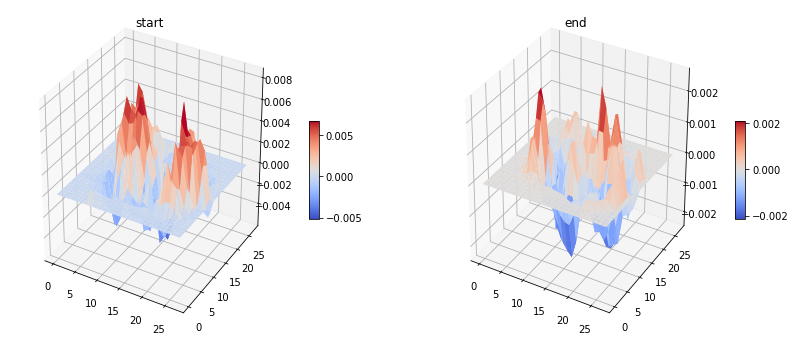

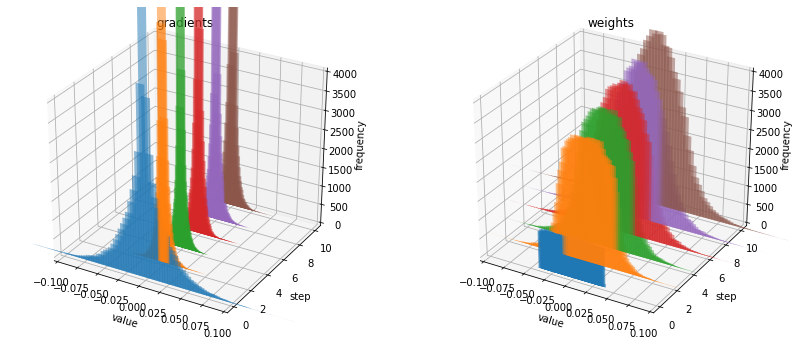

activation:  SiLU
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.478022 |  ACC: 0.117188
[0201/0936]	 Loss: 1.231805 |  ACC: 0.718673
[0401/0936]	 Loss: 0.982992 |  ACC: 0.811567
[0601/0936]	 Loss: 0.853986 |  ACC: 0.848630
[0801/0936]	 Loss: 0.765743 |  ACC: 0.870850
[0936/0936]	 Loss: 0.717240 |  ACC: 0.881420
validation:	Loss: 0.339029 | ACC: 0.960800
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.386536 |  ACC: 0.953125
[0201/0936]	 Loss: 0.377345 |  ACC: 0.949644
[0401/0936]	 Loss: 0.353138 |  ACC: 0.951298
[0601/0936]	 Loss: 0.333196 |  ACC: 0.953203
[0801/0936]	 Loss: 0.316452 |  ACC: 0.954508
[0936/0936]	 Loss: 0.306399 |  ACC: 0.955426
validation:	Loss: 0.181714 | ACC: 0.971400
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.235999 |  ACC: 0.953125
[0201/0936]	 Loss: 0.217899 |  ACC: 0.964418
[0401/0936]	 Loss: 0.210892 |  ACC: 0.964164
[0601/0936]	 Loss: 0.204670 |  ACC: 0.964545
[0801/0936]	 Loss: 0.199775 |  ACC: 0.964464
[0936/0936]	 Loss: 0.196348 |  ACC: 0

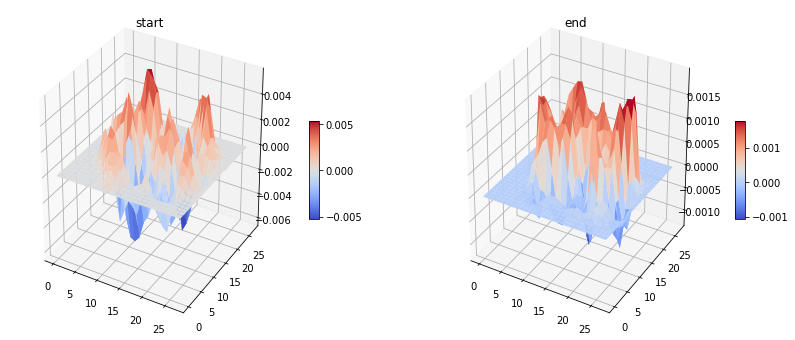

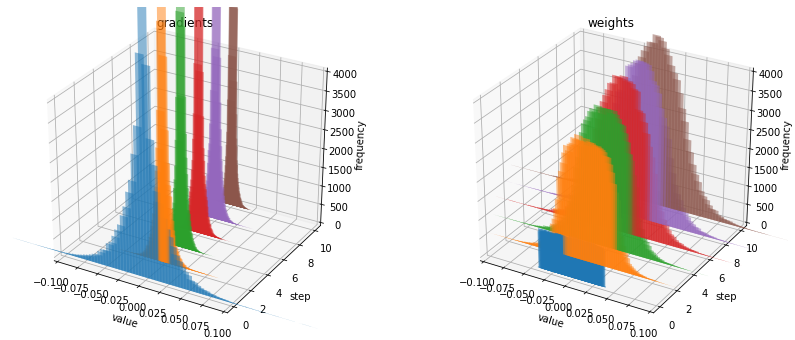

activation:  Hardswish
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.533565 |  ACC: 0.062500
[0201/0936]	 Loss: 1.241752 |  ACC: 0.716120
[0401/0936]	 Loss: 0.994406 |  ACC: 0.807991
[0601/0936]	 Loss: 0.861952 |  ACC: 0.846346
[0801/0936]	 Loss: 0.768210 |  ACC: 0.869584
[0936/0936]	 Loss: 0.718935 |  ACC: 0.879969
validation:	Loss: 0.309584 | ACC: 0.956700
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.380431 |  ACC: 0.968750
[0201/0936]	 Loss: 0.363937 |  ACC: 0.952893
[0401/0936]	 Loss: 0.349291 |  ACC: 0.952542
[0601/0936]	 Loss: 0.332842 |  ACC: 0.952736
[0801/0936]	 Loss: 0.318705 |  ACC: 0.953378
[0936/0936]	 Loss: 0.308085 |  ACC: 0.954642
validation:	Loss: 0.182430 | ACC: 0.971000
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.269434 |  ACC: 0.937500
[0201/0936]	 Loss: 0.209158 |  ACC: 0.968827
[0401/0936]	 Loss: 0.209581 |  ACC: 0.966884
[0601/0936]	 Loss: 0.208343 |  ACC: 0.964701
[0801/0936]	 Loss: 0.204386 |  ACC: 0.964581
[0936/0936]	 Loss: 0.201257 |  A

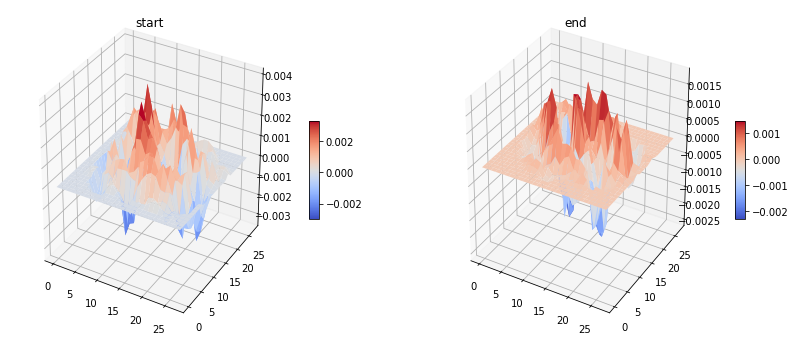

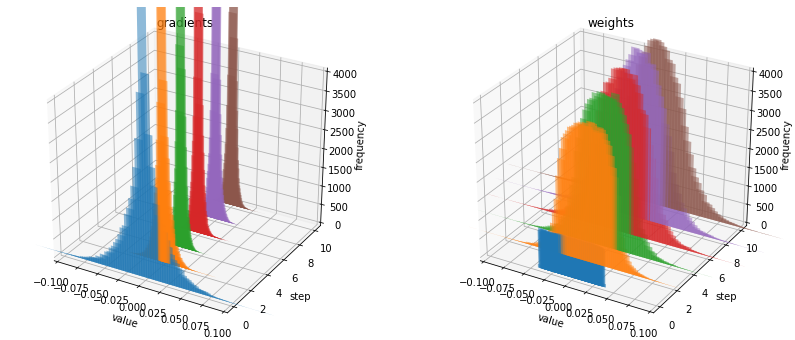

activation:  Mish
optimizer:  AdaMod
Train Epoch: 000
[0001/0936]	 Loss: 2.521329 |  ACC: 0.117188
[0201/0936]	 Loss: 1.190758 |  ACC: 0.714109
[0401/0936]	 Loss: 0.944014 |  ACC: 0.806553
[0601/0936]	 Loss: 0.814526 |  ACC: 0.846891
[0801/0936]	 Loss: 0.726853 |  ACC: 0.870675
[0936/0936]	 Loss: 0.682723 |  ACC: 0.880636
validation:	Loss: 0.308104 | ACC: 0.960400
time: 0:14

Train Epoch: 001
[0001/0936]	 Loss: 0.424447 |  ACC: 0.937500
[0201/0936]	 Loss: 0.355084 |  ACC: 0.954827
[0401/0936]	 Loss: 0.337459 |  ACC: 0.955068
[0601/0936]	 Loss: 0.320050 |  ACC: 0.955435
[0801/0936]	 Loss: 0.307301 |  ACC: 0.955930
[0936/0936]	 Loss: 0.297845 |  ACC: 0.956644
validation:	Loss: 0.180319 | ACC: 0.972100
time: 0:14

Train Epoch: 002
[0001/0936]	 Loss: 0.252324 |  ACC: 0.937500
[0201/0936]	 Loss: 0.210387 |  ACC: 0.967280
[0401/0936]	 Loss: 0.203073 |  ACC: 0.967895
[0601/0936]	 Loss: 0.198810 |  ACC: 0.967478
[0801/0936]	 Loss: 0.195178 |  ACC: 0.966665
[0936/0936]	 Loss: 0.191385 |  ACC: 0

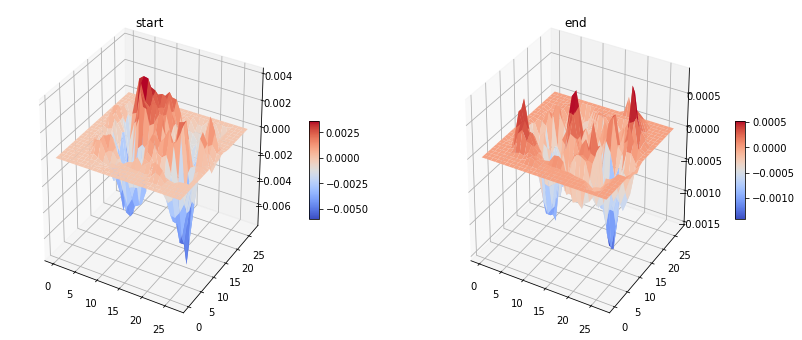

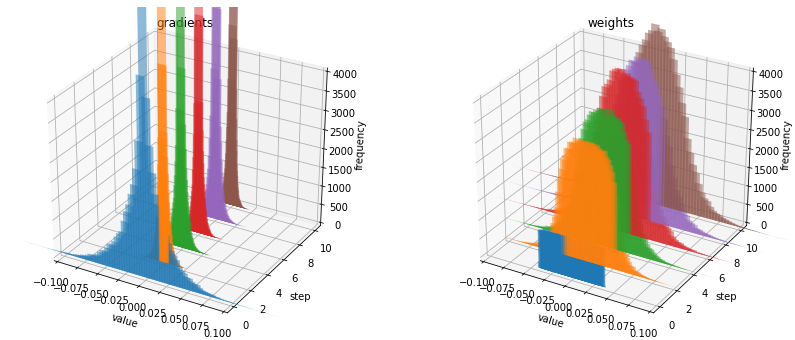

,optimizer,activation,time (ms),loss,accuracy
0,SGD,Sigmoid,0.6125,1.767080,0.9064
0,SGD,Tanh,0.5993,0.952479,0.9542
0,SGD,ReLU,0.6060,0.103967,0.9759
0,SGD,LeakyReLU,0.6128,0.108982,0.9753
0,SGD,ReLU6,0.6133,0.115725,0.9771
...,...,...,...,...,...
0,AdaMod,SELU,0.6304,0.151921,0.9677
0,AdaMod,GELU,0.6164,0.123333,0.9772
0,AdaMod,SiLU,0.6198,0.124308,0.9764
0,AdaMod,Hardswish,0.6237,0.144549,0.9725


In [15]:
activations = [
    nn.Sigmoid,
    nn.Tanh,
    
    nn.ReLU,
    nn.LeakyReLU,
    nn.ReLU6,
    
    nn.SELU,
    nn.GELU,
    
    nn.SiLU,
    nn.Hardswish,
    nn.Mish,
]
optimizers = [
    optim.SGD,
    optim.Adam,
    optim.AdamW,
    torch_optimizer.Ranger,
    torch_optimizer.AdaBelief,
    torch_optimizer.AdaBound,
    torch_optimizer.AdaMod,
]

epochs = 3

recoder2 = pd.DataFrame(columns=['optimizer', 'activation', 'time (ms)', 'loss', 'accuracy'])

for opt in optimizers:
    for act in activations:
        recoder2 = test_act_opt(recoder2, act, opt)
        
recoder2

In [23]:
recoder2 = recoder2.sort_values('loss')
display(recoder2.head(35))
display(recoder2.tail(35))

,optimizer,activation,time (ms),loss,accuracy
0,AdaBound,LeakyReLU,0.6466,0.073400,0.9787
0,AdaBound,Mish,0.6127,0.073543,0.9801
0,AdaBelief,GELU,0.6605,0.073818,0.9816
0,AdaBound,GELU,0.6260,0.073886,0.9814
0,AdaBound,ReLU,0.6217,0.076826,0.9791
0,AdaBound,SiLU,0.6255,0.078238,0.9778
0,AdamW,GELU,0.6082,0.078391,0.9828
0,AdaBelief,Mish,0.6441,0.080397,0.9789
0,AdaBelief,LeakyReLU,0.6104,0.081203,0.9797
0,AdaBound,Hardswish,0.6401,0.081571,0.9772


,optimizer,activation,time (ms),loss,accuracy
0,SGD,ReLU6,0.6133,0.115725,0.9771
0,AdaMod,LeakyReLU,0.6244,0.117032,0.9756
0,AdaBelief,SELU,0.6458,0.121822,0.9661
0,Adam,SELU,0.6668,0.122411,0.9688
0,AdamW,SELU,0.5970,0.122994,0.9696
0,AdaMod,ReLU,0.6388,0.123187,0.9772
0,AdaMod,GELU,0.6164,0.123333,0.9772
0,AdaMod,SiLU,0.6198,0.124308,0.9764
0,AdaMod,Mish,0.6157,0.126209,0.9761
0,AdaMod,ReLU6,0.6422,0.126906,0.9757


In [24]:
recoder2 = recoder2.sort_values('accuracy', ascending=False)
display(recoder2.head(35))
display(recoder2.tail(35))

,optimizer,activation,time (ms),loss,accuracy
0,AdamW,GELU,0.6082,0.078391,0.9828
0,AdaBelief,GELU,0.6605,0.073818,0.9816
0,AdaBound,GELU,0.6260,0.073886,0.9814
0,AdamW,ReLU,0.5986,0.085212,0.9805
0,AdamW,LeakyReLU,0.6088,0.084677,0.9804
0,AdamW,Hardswish,0.6018,0.093405,0.9803
0,AdaBound,Mish,0.6127,0.073543,0.9801
0,AdaBelief,LeakyReLU,0.6104,0.081203,0.9797
0,AdaBelief,ReLU6,0.6340,0.099779,0.9796
0,Adam,GELU,0.5971,0.084692,0.9796


,optimizer,activation,time (ms),loss,accuracy
0,AdaBelief,SiLU,0.6450,0.091967,0.9763
0,AdaMod,Mish,0.6157,0.126209,0.9761
0,Ranger,LeakyReLU,0.6091,0.162073,0.9761
0,SGD,ReLU,0.6060,0.103967,0.9759
0,SGD,GELU,0.5980,0.102262,0.9758
0,AdaMod,ReLU6,0.6422,0.126906,0.9757
0,AdaMod,LeakyReLU,0.6244,0.117032,0.9756
0,SGD,LeakyReLU,0.6128,0.108982,0.9753
0,Ranger,Mish,0.6016,0.164511,0.9752
0,Ranger,ReLU,0.6538,0.160956,0.9744


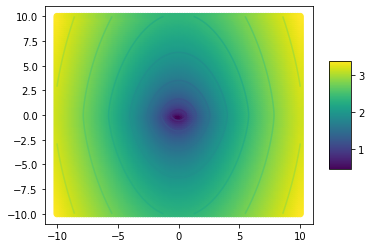

In [18]:
x = np.linspace(-10, 10, 100)
y = np.linspace(-10, 10, 100)

X, Y = np.meshgrid(x, y)
Z = (X**2 + abs(Y)**1.5)**0.25


fig = plt.figure()
cp = plt.scatter(x=X, y=Y, c=Z)
plt.contour(X, Y, Z)
fig.colorbar(cp, shrink=0.5, aspect=5)
plt.show()

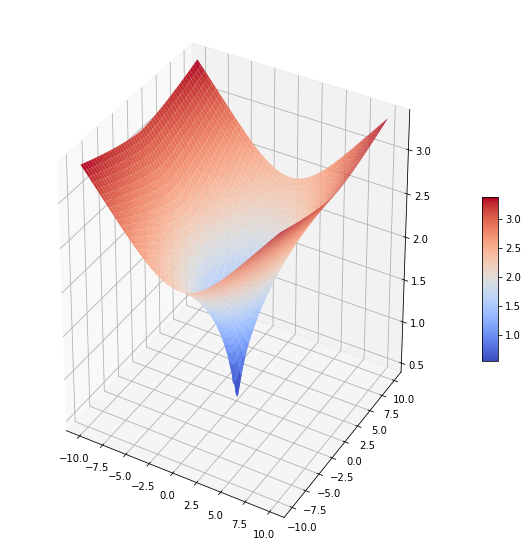

In [19]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 10))
ax = plt.axes(projection="3d")
ax = ax.plot_surface(X, Y, Z, cmap='coolwarm')
fig.colorbar(ax, shrink=0.3, aspect=10)

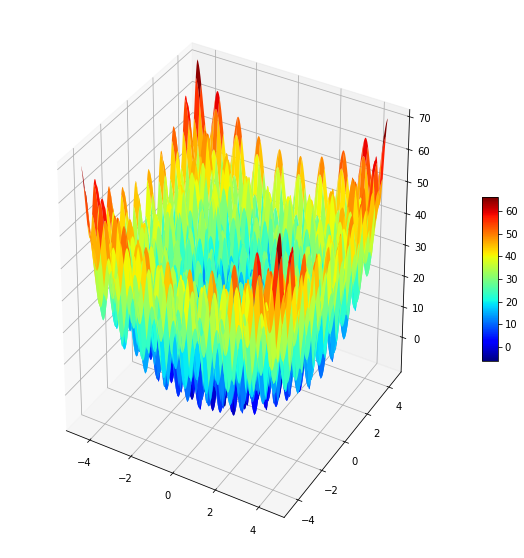

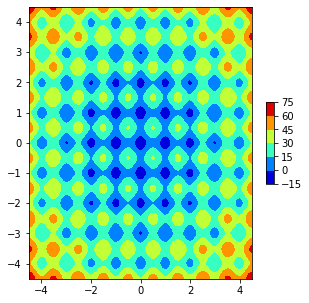

In [20]:
from mpl_toolkits.mplot3d import Axes3D
import math

def rastrigin(tensor, lib=np):
    # https://en.wikipedia.org/wiki/Test_functions_for_optimization
    x, y = tensor
    A = 10
    f = (
        A * 1
        + (x ** 2 - A * lib.cos(x * math.pi * 2))
        + (y ** 2 - A * lib.cos(y * math.pi * 2))
    )
    return f

x = np.linspace(-4.5, 4.5, 250)
y = np.linspace(-4.5, 4.5, 250)

X, Y = np.meshgrid(x, y)
Z = rastrigin([X, Y])




fig = plt.figure(figsize=(10, 10))
ax = plt.axes(projection='3d')
ax = ax.plot_surface(X, Y, Z, cmap='jet')
fig.colorbar(ax, shrink=0.3, aspect=10)

fig = plt.figure(figsize=(5, 5))
ax = plt.axes(projection=None)
ax = ax.contourf(X, Y, Z, cmap='jet')
fig.colorbar(ax, shrink=0.3, aspect=10)

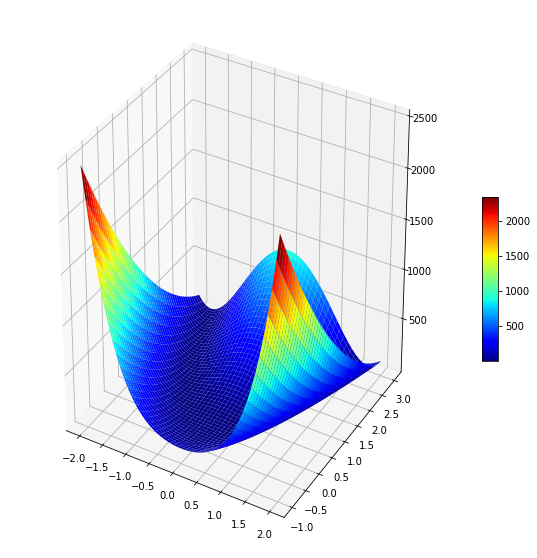

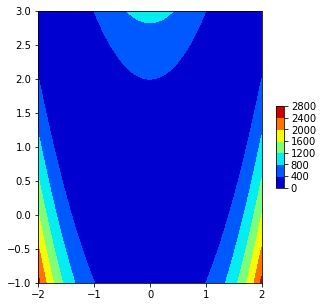

In [21]:
def rosenbrock(xy):
    # https://en.wikipedia.org/wiki/Test_functions_for_optimization
    x, y = xy
    return (1 - x) ** 2 + 100 * (y - x ** 2) ** 2

x = np.linspace(-2, 2, 250)
y = np.linspace(-1, 3, 250)

X, Y = np.meshgrid(x, y)
Z = rosenbrock([X, Y])

fig = plt.figure(figsize=(10, 10))
ax = plt.axes(projection="3d")
ax = ax.plot_surface(X, Y, Z, cmap='jet')
fig.colorbar(ax, shrink=0.3, aspect=10)

fig = plt.figure(figsize=(5, 5))
ax = plt.axes(projection=None)
ax = ax.contourf(X, Y, Z, cmap='jet')
fig.colorbar(ax, shrink=0.3, aspect=10)